In [2]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from math import tan,acos
import os
import matlab
import matlab.engine
def start_matlab():
    return matlab.engine.start_matlab()
def quit_matlab(matlab_engine):
    matlab_engine.quit()
    
def ieee_feeder_mapper(matlab_engine, IeeeFeeder):
    FeederMap, Z_in_ohm, Paths, NodeList, LoadList = matlab_engine.ieee_feeder_mapper(IeeeFeeder, nargout=5)
    FeederMap = np.array(FeederMap)
    Z_in_ohm = np.array(Z_in_ohm)
    Paths = np.array(Paths)
    NodeList = np.array(NodeList)
    LoadList = np.array(LoadList)
    return FeederMap, Z_in_ohm, Paths, NodeList[0], LoadList[0]-1

"""def FBSfun(matlab_engine, V0, loads, Z, B):
    V, _, S, _ = matlab_engine.FBSfun(float(V0), matlab.double(loads.tolist(),is_complex=True), matlab.double(Z.tolist(), is_complex=True), matlab.double(B.tolist(),is_complex=True), nargout=4)
    V = np.array(V, dtype=np.complex).squeeze()
    S = np.array(S, dtype=np.complex).squeeze()
    return V, S"""

IeeeFeeder = 13
matlab_engine = start_matlab()  

LoadScalingFactor=2000
GenerationScalingFactor=50
SlackBusVoltage=1.02
power_factor=0.9
IncludeSolar=1

#Feeder parameters

LineNames = ('l_632_633','l_632_645','l_632_671','l_633_634','l_645_646','l_650_632','l_671_680','l_671_684',
             'l_671_692','l_684_611','l_684_652','l_692_675','l_u_650')

AllBusNames = ('sourcebus',
               'load_611','load_634','load_645','load_646','load_652','load_671','load_675','load_692',
               'bus_611','bus_634','bus_645','bus_646','bus_652','bus_671','bus_675','bus_692','bus_632',
               'bus_633','bus_650','bus_680','bus_684')

LoadBusNames = AllBusNames[1:9]
BusNames = AllBusNames[9:22]
IeeeFeeder = 13

LoadList = np.array([6,7,8,13,3,12,11,10])-1
NodeList = np.array([650,632,671,680,633,634,645,646,684,611,692,675,652])
BusesWithControl = NodeList[LoadList]

NumberOfLoads=len(LoadBusNames)
NumberOfNodes=len(BusNames)

FeederMap, Z_in_ohm, Paths, _, _ = ieee_feeder_mapper(matlab_engine, IeeeFeeder)

#Base value calculation
Vbase = 4.16e3 #4.16 kV
Sbase = 1.0 #500 kVA
Zbase = Vbase**2/Sbase
Ibase = Sbase/Vbase
Z = Z_in_ohm/Zbase

#Load Data Pertaining to Loads to create a profile
PV_Feeder_model = 10
FileDirectoryBase = 'C:\\Users\\Sy-Toan\\ceds-cigar\\LBNL_Simulations\\testpvnum10\\'
Time = list(range(1441))
TotalTimeSteps = len(Time)
QSTS_Data = np.zeros((TotalTimeSteps,4,IeeeFeeder))
for node in range(NumberOfLoads):
    FileDirectoryExtenstion = 'node_' + str(node+1) + '_pv_' + str(PV_Feeder_model) + '_minute.csv'
    FileName = FileDirectoryBase + FileDirectoryExtenstion
    MatFile = np.genfromtxt(FileName, delimiter=',')
    QSTS_Data[:,:,int(LoadList[node])] = MatFile

#Seperate PV Generation Data
Generation = QSTS_Data[:,1,:]*GenerationScalingFactor
Load = QSTS_Data[:,3,:]*LoadScalingFactor
Generation = np.squeeze(Generation)/Sbase
Load = np.squeeze(Load)/Sbase
MaxGenerationPossible = np.max(Generation, axis=0)

#Voltage Observer Parameters and related variable initialization
LowPassFilterFrequency = 0.1
HighPassFilterFrequency = 1.0
Gain_Energy = 1e5
TimeStep = 1
FilteredOutput_vqvp = np.zeros((TotalTimeSteps,NumberOfNodes))
IntermediateOutput_vqvp= np.zeros((TotalTimeSteps,NumberOfNodes))
Epsilon_vqvp = np.zeros((TotalTimeSteps,NumberOfNodes))

#ZIP load modeling
ConstantImpedanceFraction = 0.2
ConstantCurrentFraction = 0.05
ConstantPowerFraction = 0.75
ZIP_demand = np.zeros((TotalTimeSteps,IeeeFeeder,3), dtype=np.complex)

for node in range(1,IeeeFeeder):
    ZIP_demand[:,node,:] = np.array([ConstantPowerFraction*Load[:,node].astype(complex), 
                            ConstantCurrentFraction*Load[:,node].astype(complex), 
                            ConstantImpedanceFraction*Load[:,node].astype(complex)]).T*(1 + 1j*tan(acos(power_factor)))
    
#Power Flow with QVQP Control Case
Sbar =  MaxGenerationPossible * GenerationScalingFactor
V_vqvp = np.zeros((IeeeFeeder,TotalTimeSteps), dtype=np.complex)
S_vqvp = np.zeros((IeeeFeeder,TotalTimeSteps), dtype=np.complex)
IterationCounter_vqvp = np.zeros((IeeeFeeder,TotalTimeSteps))
PowerEachTimeStep_vqvp = np.zeros((IeeeFeeder,3), dtype=np.complex)
SolarGeneration_vqvp = Generation * GenerationScalingFactor
InverterReactivePower = np.zeros(Generation.shape)
InverterRealPower = np.zeros(Generation.shape)
InverterRateOfChangeLimit = 100 
InverterRateOfChangeActivate = 0

#Drop Control Parameters
VQ_start = 1.01
VQ_end = 1.015
VP_start = 1.015
VP_end = 1.02
#VBP is this the config of the control at each time step?
VBP = np.full([IeeeFeeder, 4, TotalTimeSteps], np.nan)
VBP[:,0,0] = VQ_start
VBP[:,1,0] = VQ_end
VBP[:,2,0] = VP_start
VBP[:,3,0] = VP_end
FilteredVoltage = np.zeros(Generation.shape)
FilteredVoltageCalc = np.zeros(Generation.shape)
InverterLPF = 1
ThreshHold_vqvp = 0.25
V0 = np.full((TotalTimeSteps, 1), SlackBusVoltage)
#Adaptive controller parameters
upk = np.zeros(IntermediateOutput_vqvp.shape)
uqk = upk
kq = 100
kp = 100

#Delays                 [  1   2   3*  4   5   6*  7*  8*  9* 10* 11* 12* 13*
Delay_VoltageSampling = [0, 0,  1, 0, 0,  1,  1,  1,  1,  1,  1,  1,  1]
Delay_VBPCurveShift =   [0 ,0 ,2 ,0 ,0 ,2 ,2 ,2 ,2 ,2 ,2 ,2 ,2] 

In [3]:
def FBSfun(V0,loads,Z,B):
    n=len(Z)
    V=np.zeros(shape=(n,1),dtype=complex)
    s=np.copy(V)
    V[0,0]=V0
    I = np.zeros(shape=(n, 1),dtype=complex)
    I[0,0] = 0

    T=[]
    J=[1]

    for k in range(2,n+1):
        t=np.sum(B[k-1,:])
        if (t==-1):
            T.append(k)
        elif (t>=1):
            J.append(k)
    tol = 0.0001
    itera = 0
    Vtest = 0

    T=np.array(T)-1
    J=np.array(J)-1
    
    while(abs(Vtest-V0) >=tol):
        V[0,0]=V0
        for k in range(0, n - 1):
            idx = np.where(B[k, :] > 0)
            V[idx,0]=V[k,0]-np.multiply(Z[idx,0],I[idx,0])

        for i in range(len(T)-1,-1,-1):
            t=T[i]
            v=np.array([1, abs(V[t,0]), abs(V[t,0])**2])
            s[t,0]=np.dot(loads[t,:],np.transpose(v))
            I[t,0]=np.conj(s[t,0]/V[t,0])
            flag=True
            idx= np.where(B[t,:] == -1)[0]
            while(flag):
                V[idx,0] = V[t,0] + Z[t,0]*I[t,0]
                v=np.array([1, abs(V[idx,0]),abs(V[idx,0])**2])
                s[idx,0]=np.dot(loads[idx,:],np.transpose(v))
                I[idx,0]=np.conj(s[idx,0]/V[idx,0])+I[t,0]
                if (len(np.where(J==idx)[0])==0):
                    t=idx
                    idx=np.where(B[idx,:][0]==-1)[0]
                else:
                    flag=False
        
        for k in range(len(J)-1,0,-1):
            t=J[k]
            v = np.array([1, abs(V[t, 0]), abs(V[t, 0]) ** 2])
            s[t, 0] = np.dot(loads[t, :], np.transpose(v))
            load_current=np.conj(s[t, 0] / V[t, 0])
            #print(load_current)
            idx=np.where(B[t,:] > 0)[0]
            Itot = load_current
            #print(load_current)
            #print("this is the len of idx: ", len(idx))
            for y in range(0,len(idx)):
                Itot=Itot+I[idx[y],0]
                #print(Itot)
                
            I[t,0]= Itot
            flag= True
            #print(I[t,0])
            idx = np.where(B[t, :] == -1)[0][0]
            while flag:
                V[idx, 0] = V[t, 0] + Z[t, 0] * I[t, 0]
                v = np.array([1, abs(V[idx, 0]), abs(V[idx, 0]) ** 2])
                s[idx, 0] = np.dot(loads[idx, :], np.transpose(v))
                I[idx, 0] = np.conj(s[idx, 0] / V[idx, 0]) + I[t, 0]
                #print("idx: ", idx)
                #print(I[idx,0])
                if (len(np.where(J==idx)[0])==0):
                    t=idx
                    #print(t)
                    idx=np.where(B[idx,:][0]==-1)[0]
                    #print(idx)
                else:
                    flag=False

        Vtest=V[0,0]
        itera +=1

    V[0,0] = V0
    S=np.multiply(V,np.conj(I))
    
    return np.array(V, dtype=np.complex).squeeze(),np.array(S, dtype=np.complex).squeeze()

Useful functions

In [4]:
def voltage_observer(vk, vkm1, psikm1, epsilonkm1, ykm1, f_hp, f_lp, gain, T):
    Vmagk = abs(vk)
    Vmagkm1 = abs(vkm1)
    psik = (Vmagk - Vmagkm1 - (f_hp*T/2-1)*psikm1)/(1+f_hp*T/2)
    epsilonk = gain*(psik**2)
    yk = (T*f_lp*(epsilonk + epsilonkm1) - (T*f_lp - 2)*ykm1)/(2 + T*f_lp)
    return yk, psik, epsilonk

def inverter_VoltVarVoltWatt_model(gammakm1,solar_irr,Vk,Vkm1,VBP,T,lpf,Sbar,pkm1,qkm1,ROC_lim,InverterRateOfChangeActivate,ksim,Delay_VoltageSampling):
    Vmagk = abs(Vk)
    Vmagkm1 = abs(Vkm1) 
    gammakcalc = (T*lpf*(Vmagk + Vmagkm1) - (T*lpf - 2)*gammakm1)/(2 + T*lpf)
    if ksim % Delay_VoltageSampling == 0:
        gammakused = gammakcalc
    else: 
        gammakused = gammakm1
    
    pk = 0
    qk = 0
    c = 0
    q_avail = 0

    if solar_irr < 2500:
        pk = 0
        qk = 0
    elif solar_irr >= 2500:
        if gammakused <= VBP[2]:
            pk = -solar_irr
            q_avail = (Sbar**2 - pk**2)**(1/2)
            if gammakused <= VBP[0]:
                qk = 0
            elif gammakused > VBP[0] and gammakused <= VBP[0]:
                c = q_avail/(VBP[1] - VBP[0])
                qk = c*(gammakused - VBP[0])
            else:
                qk = q_avail       
        elif gammakused > VBP[2] and gammakused < VBP[3]:
            d = -solar_irr/(VBP[3] - VBP[2])
            pk = -(d*(gammakused - VBP[2]) + solar_irr);
            qk = (Sbar**2 - pk**2)**(1/2);      
        elif gammakused >= VBP[3]:
            qk = Sbar
            pk = 0
    return qk,pk,gammakused, gammakcalc, c, q_avail

Initialize PowerEachTimeStep

Set up the agent!!

# Define a state

In [5]:
class _state(object):
    def __init__(self, PET, V, S, InvReal, InvReact, FV, FVC, Fo, Io, Ep):
        self.PET = PET
        self.V = V
        self.S = S
        self.InvReal = InvReal
        self.InvReact = InvReact
        self.FV = FV
        self.FVC = FVC
        self.Fo = Fo
        self.Io = Io
        self.Ep = Ep
    
    def get_state_agent(self, agent):
        arg = (self.PET[agent], np.array([self.V[agent]]), np.array([self.S[agent]]), np.array([self.InvReal[agent]]), np.array([self.InvReact[agent]]),np.array([self.FV[agent]]),np.array([self.FVC[agent]]))
        return abs(np.concatenate(arg, axis = 0))

In [6]:
class env(object):
    
    ######### reset the env ####################
    def __init__(self):
        self.reset()
    
    def reset(self):
        # a state of env contain: state it is in, terminal or not, in which step it is in
        self.stage = 0
        PET, V, S = self._init_PET_VS()
        InvReal = np.zeros(NumberOfNodes)
        InvReact = np.zeros(NumberOfNodes)
        FV = np.zeros(NumberOfNodes)
        FVC = np.zeros(NumberOfNodes)
        Fo = np.zeros(NumberOfNodes)
        Io = np.zeros(NumberOfNodes)
        Ep = np.zeros(NumberOfNodes)
        self.state = _state(PET, V, S, InvReal, InvReact, FV, FVC, Fo, Io, Ep)
        self.terminal = False
        
            
        return self.state.get_state_agent(agent)
    #############################################
    # next state, execute an action #############
    #############################################
    def step(self, action):
        #return next state, reward, terminal or not, precise info
        nextPET = self._cal_next_PET()
        nextV, nextS = self._cal_next_VS(nextPET)
        nextInvReal, nextInvReact, nextFV, nextFVC = self._cal_next_Inv(nextV, action)
        nextFo, nextIo, nextEp = self._cal_next_FIE(nextV)
        nextState = _state(nextPET, nextV, nextS, nextInvReal, nextInvReact, nextFV, nextFVC, nextFo, nextIo, nextEp) 
        
        #update new state, reward and stage
        self.state = nextState
        if nextFo[agent] > 0.25:
            self.reward = -nextFo[agent]
        else:
            self.reward = 0
        self.stage += 1
        
        #check if terminal
        if (self.stage == TotalTimeSteps-1):
            self.terminal = True
        
        return self.state.get_state_agent(agent), self.reward, self.terminal, nextFo[agent], abs(nextV[agent])
   ################################################     
    def _init_PET_VS(self):
        for knode in LoadList:
            PowerEachTimeStep_vqvp[knode,:] = np.array([ZIP_demand[0,knode,0] - SolarGeneration_vqvp[0,knode],
                                                        ZIP_demand[0,knode,1],
                                                        ZIP_demand[0,knode,2]])
            
        V, S = FBSfun(V0[0,0], PowerEachTimeStep_vqvp, Z, FeederMap)
        return PowerEachTimeStep_vqvp, V, S       
    
    def _cal_next_PET(self):
        ksim = self.stage
        currentState = self.state
        for knode in LoadList:
            PowerEachTimeStep_vqvp[knode,:] = np.array([ZIP_demand[ksim+1,knode,0] + currentState.InvReal[knode]
                                                         + 1j*currentState.InvReact[knode], 
                                                        ZIP_demand[ksim+1,knode,1], 
                                                        ZIP_demand[ksim+1,knode,2]])
        return PowerEachTimeStep_vqvp
    
    def _cal_next_VS(self, nextPET):
        ksim = self.stage
        V, S = FBSfun(V0[ksim+1,0], nextPET, Z,FeederMap)
        return V, S  
    
    def _cal_next_Inv(self, nextV, action):
        ksim = self.stage
        currentState = self.state
        
        InvReal = np.zeros(NumberOfNodes)
        InvReact = np.zeros(NumberOfNodes)
        FV = np.zeros(NumberOfNodes)
        FVC = np.zeros(NumberOfNodes)
        
        for knode in LoadList:
            InvReact[knode], InvReal[knode], FV[knode], FVC[knode], _, _ = inverter_VoltVarVoltWatt_model(
                     currentState.FV[knode], SolarGeneration_vqvp[ksim+1,knode], 
                     abs(nextV[knode]), abs(currentState.V[knode]), 
                     action[knode], TimeStep, InverterLPF, 
                     Sbar[knode], currentState.InvReal[knode], 
                     currentState.InvReact[knode], InverterRateOfChangeLimit, 
                     InverterRateOfChangeActivate, ksim+1, Delay_VoltageSampling[knode])
        return InvReal, InvReact, FV, FVC
    
    # ok
    def _cal_next_FIE(self, nextV):
        currentState = self.state
        Fo = np.zeros(NumberOfNodes)
        Io = np.zeros(NumberOfNodes)
        Ep = np.zeros(NumberOfNodes)
        for knode in LoadList:
            Fo[knode], Io[knode], Ep[knode] = voltage_observer(nextV[knode], currentState.V[knode], 
                                                              currentState.Io[knode], currentState.Ep[knode],
                                                              currentState.Fo[knode], HighPassFilterFrequency,
                                                              LowPassFilterFrequency, Gain_Energy, TimeStep) 
        return Fo, Io, Ep


In [7]:
#create a buffer for training data

from collections import deque
import random
import numpy as np

class ReplayBuffer(object):

    def __init__(self, buffer_size, random_seed=123):
        """
        The right side of the deque contains the most recent experiences 
        """
        self.buffer_size = buffer_size
        self.count = 0
        self.buffer = deque()
        random.seed(random_seed)

    def add(self, s, a, r, t, s2):
        experience = (s, a, r, t, s2)
        if self.count < self.buffer_size: 
            self.buffer.append(experience)
            self.count += 1
        else:
            self.buffer.popleft()
            self.buffer.append(experience)

    def size(self):
        return self.count

    def sample_batch(self, batch_size):
        batch = []

        if self.count < batch_size:
            batch = random.sample(self.buffer, self.count)
        else:
            batch = random.sample(self.buffer, batch_size)

        s_batch = np.array([_[0] for _ in batch])
        a_batch = np.array([_[1] for _ in batch])
        r_batch = np.array([_[2] for _ in batch])
        t_batch = np.array([_[3] for _ in batch])
        s2_batch = np.array([_[4] for _ in batch])

        return s_batch, a_batch, r_batch, t_batch, s2_batch

    def clear(self):
        self.buffer.clear()
        self.count = 0

In [8]:
#testing action noise

In [9]:
class OrnsteinUhlenbeckActionNoise:
    def __init__(self, mu, sigma=0.02, theta=.15, dt=1e-2, x0=None):
        self.theta = theta
        self.mu = mu
        self.sigma = sigma
        self.dt = dt
        self.x0 = x0
        self.reset()

    def __call__(self):
        x = self.x_prev + self.theta * (self.mu - self.x_prev) * self.dt + \
                self.sigma * np.sqrt(self.dt) * np.random.normal(size=self.mu.shape)
        self.x_prev = x
        return x

    def reset(self):
        self.x_prev = self.x0 if self.x0 is not None else np.zeros_like(self.mu)

    def __repr__(self):
        return 'OrnsteinUhlenbeckActionNoise(mu={}, sigma={})'.format(self.mu, self.sigma)

In [10]:
class ActorNetwork(object):
    """
    Input to the network is the state, output is the action
    under a deterministic policy.

    The output layer activation is a tanh to keep the action
    between -action_bound and action_bound
    """

    def __init__(self, sess, state_dim, action_dim, action_bound, learning_rate, tau, batch_size):
        self.sess = sess
        self.s_dim = state_dim
        self.a_dim = action_dim
        self.action_bound = action_bound
        self.learning_rate = learning_rate
        self.tau = tau
        self.batch_size = batch_size


        # Actor Network
        self.inputs, self.out, self.scaled_out = self.create_actor_network()

        self.network_params = tf.trainable_variables()

        # Target Network
        self.target_inputs, self.target_out, self.target_scaled_out = self.create_actor_network()

        self.target_network_params = tf.trainable_variables()[len(self.network_params):]

        # Op for periodically updating target network with online network
        # weights
        self.update_target_network_params = \
            [self.target_network_params[i].assign(tf.multiply(self.network_params[i], self.tau) +
                                                  tf.multiply(self.target_network_params[i], 1. - self.tau))
                for i in range(len(self.target_network_params))]

        # This gradient will be provided by the critic network
        self.action_gradient = tf.placeholder(tf.float32, [None, self.a_dim])

        # Combine the gradients here
        self.unnormalized_actor_gradients = tf.gradients(
            self.scaled_out, self.network_params, -self.action_gradient)
        self.actor_gradients = list(map(lambda x: tf.div(x, self.batch_size), self.unnormalized_actor_gradients))

        # Optimization Op
        self.optimize = tf.train.AdamOptimizer(self.learning_rate).\
            apply_gradients(zip(self.actor_gradients, self.network_params))

        self.num_trainable_vars = len(
            self.network_params) + len(self.target_network_params)

    def create_actor_network(self):
        inputs = tflearn.input_data(shape=[None, self.s_dim])
        net = tflearn.fully_connected(inputs, 400)
        net = tflearn.layers.normalization.batch_normalization(net)
        net = tflearn.activations.relu(net)
        net = tflearn.fully_connected(net, 300)
        net = tflearn.layers.normalization.batch_normalization(net)
        net = tflearn.activations.relu(net)
        # Final layer weights are init to Uniform[-3e-3, 3e-3]
        w_init = tflearn.initializations.uniform(minval=-0.003, maxval=0.003)
        out = tflearn.fully_connected(
            net, self.a_dim, activation='sigmoid', weights_init=w_init)
        # Scale output to -action_bound to action_bound
        scaled_out = tf.multiply(out, self.action_bound)
        #scaled_out = out
        return inputs, out, scaled_out

    def train(self, inputs, a_gradient):
        self.sess.run(self.optimize, feed_dict={
            self.inputs: inputs,
            self.action_gradient: a_gradient
        })

    def predict(self, inputs):
        return self.sess.run(self.scaled_out, feed_dict={
            self.inputs: inputs
        })

    def predict_target(self, inputs):
        return self.sess.run(self.target_scaled_out, feed_dict={
            self.target_inputs: inputs
        })

    def update_target_network(self):
        self.sess.run(self.update_target_network_params)

    def get_num_trainable_vars(self):
        return self.num_trainable_vars

In [11]:
class CriticNetwork(object):
    """
    Input to the network is the state and action, output is Q(s,a).
    The action must be obtained from the output of the Actor network.

    """

    def __init__(self, sess, state_dim, action_dim, learning_rate, tau, gamma, num_actor_vars):
        self.sess = sess
        self.s_dim = state_dim
        self.a_dim = action_dim
        self.learning_rate = learning_rate
        self.tau = tau
        self.gamma = gamma

        # Create the critic network
        self.inputs, self.action, self.out = self.create_critic_network()

        self.network_params = tf.trainable_variables()[num_actor_vars:]

        # Target Network
        self.target_inputs, self.target_action, self.target_out = self.create_critic_network()

        self.target_network_params = tf.trainable_variables()[(len(self.network_params) + num_actor_vars):]

        # Op for periodically updating target network with online network
        # weights with regularization
        self.update_target_network_params = \
            [self.target_network_params[i].assign(tf.multiply(self.network_params[i], self.tau) \
            + tf.multiply(self.target_network_params[i], 1. - self.tau))
                for i in range(len(self.target_network_params))]

        # Network target (y_i)
        self.predicted_q_value = tf.placeholder(tf.float32, [None, 1])

        # Define loss and optimization Op
        self.loss = tflearn.mean_square(self.predicted_q_value, self.out)
        self.optimize = tf.train.AdamOptimizer(
            self.learning_rate).minimize(self.loss)

        # Get the gradient of the net w.r.t. the action.
        # For each action in the minibatch (i.e., for each x in xs),
        # this will sum up the gradients of each critic output in the minibatch
        # w.r.t. that action. Each output is independent of all
        # actions except for one.
        self.action_grads = tf.gradients(self.out, self.action)

    def create_critic_network(self):
        inputs = tflearn.input_data(shape=[None, self.s_dim])
        action = tflearn.input_data(shape=[None, self.a_dim])
        net = tflearn.fully_connected(inputs, 400)
        net = tflearn.layers.normalization.batch_normalization(net)
        net = tflearn.activations.relu(net)

        # Add the action tensor in the 2nd hidden layer
        # Use two temp layers to get the corresponding weights and biases
        t1 = tflearn.fully_connected(net, 300)
        t2 = tflearn.fully_connected(action, 300)

        net = tflearn.activation(
            tf.matmul(net, t1.W) + tf.matmul(action, t2.W) + t2.b, activation='relu')

        # linear layer connected to 1 output representing Q(s,a)
        # Weights are init to Uniform[-3e-3, 3e-3]
        w_init = tflearn.initializations.uniform(minval=-0.003, maxval=0.003)
        out = tflearn.fully_connected(net, 1, weights_init=w_init)
        return inputs, action, out

    def train(self, inputs, action, predicted_q_value):
        return self.sess.run([self.out, self.optimize], feed_dict={
            self.inputs: inputs,
            self.action: action,
            self.predicted_q_value: predicted_q_value
        })

    def predict(self, inputs, action):
        return self.sess.run(self.out, feed_dict={
            self.inputs: inputs,
            self.action: action
        })

    def predict_target(self, inputs, action):
        return self.sess.run(self.target_out, feed_dict={
            self.target_inputs: inputs,
            self.target_action: action
        })

    def action_gradients(self, inputs, actions):
        return self.sess.run(self.action_grads, feed_dict={
            self.inputs: inputs,
            self.action: actions
        })

    def update_target_network(self):
        self.sess.run(self.update_target_network_params)


In [12]:
def build_summaries():
    episode_reward = tf.Variable(0.)
    tf.summary.scalar("Reward", episode_reward)
    episode_ave_max_q = tf.Variable(0.)
    tf.summary.scalar("Qmax_value", episode_ave_max_q)
    
    summary_vars = [episode_reward, episode_ave_max_q]
    summary_ops = tf.summary.merge_all()
    
    return summary_ops, summary_vars

def plotting(y, action, voltage, reward):
    f = plt.figure()
    f.set_figheight(2)
    f.set_figwidth(15)
    f.add_subplot(1,4,1)
    plt.plot(y)
    f.add_subplot(1,4,2)
    plt.plot(action)
    f.add_subplot(1,4,3)
    plt.plot(voltage)
    f.add_subplot(1,4,4)
    plt.plot(reward)
    plt.show(block=True)

In [13]:
def train(sess, env, args, actor, critic, actor_noise):
    summary_ops, summary_vars = build_summaries()
    sess.run(tf.global_variables_initializer())
    writer = tf.summary.FileWriter(args['summary_dir'], sess.graph)
    actor.update_target_network()
    critic.update_target_network()
    replay_buffer = ReplayBuffer(int(args['buffer_size']), int(args['random_seed']))
    
    allReward = []
    for i in range(int(args['max_episodes'])):
        s = env.reset()
        
        #reset all action
        allAction = copy.deepcopy(VBP[:,:,0])
        #randomize action of the agent - we dont need to do this
        sampl = (np.random.uniform(low=0., high=1., size=(2,)), np.random.uniform(low=1., high=2., size=(2,)))
        allAction[agent] = np.concatenate(sampl, axis = 0)
        
        ep_reward = 0
        ep_ave_max_q = 0
        
        y = []
        action = []
        allV = []
        y_k = 0
        for j in range(int(args['max_episode_len'])):
            if y_k == 0:
                allAction[agent] = np.array([1.01,1.015,1.015,1.02])
                a = allAction[agent]
            else:
                a = actor.predict(np.reshape(s, (1, actor.s_dim))) + actor_noise()
                translate = np.array([0.9, 0.9, 0.9, 0.9])
                allAction[agent] = a + translate
                
            s2, r, terminal, y_k, voltage = env.step(allAction)
            y.append(y_k)
            action.append(copy.deepcopy(allAction[agent]))
            allV.append(voltage)
            replay_buffer.add(np.reshape(s, (actor.s_dim,)), np.reshape(a, (actor.a_dim,)), r,
                              terminal, np.reshape(s2, (actor.s_dim,)))
            
            # Keep adding experience to the memory until
            # there are at least minibatch size samples
            if replay_buffer.size() > int(args['minibatch_size']):
                s_batch, a_batch, r_batch, t_batch, s2_batch = \
                    replay_buffer.sample_batch(int(args['minibatch_size']))

                # Calculate targets
                target_q = critic.predict_target(
                    s2_batch, actor.predict_target(s2_batch))
                
                y_i = []
                for k in range(int(args['minibatch_size'])):
                    if t_batch[k]:
                        y_i.append(r_batch[k])
                    else:
                        y_i.append(r_batch[k] + critic.gamma * target_q[k])
                
                # Update the critic given the targets
                predicted_q_value, _ = critic.train(
                    s_batch, a_batch, np.reshape(y_i, (int(args['minibatch_size']), 1)))

                ep_ave_max_q += np.amax(predicted_q_value)

                # Update the actor policy using the sampled gradient
                a_outs = actor.predict(s_batch)
                grads = critic.action_gradients(s_batch, a_outs)
                actor.train(s_batch, grads[0])

                # Update target networks
                actor.update_target_network()
                critic.update_target_network()

            s = s2
            ep_reward += r

            if terminal:

                summary_str = sess.run(summary_ops, feed_dict={
                    summary_vars[0]: ep_reward,
                    summary_vars[1]: ep_ave_max_q / float(j)
                })

                writer.add_summary(summary_str, i)
                writer.flush()
                allReward.append(ep_reward)
                print('| Reward: {:d} | Episode: {:d} | Qmax: {:.4f} '.format(int(ep_reward), \
                        i, (ep_ave_max_q / float(j))), end="")
                print('| Action: ', end="")
                print(allAction[agent])
                plotting(y, action, allV, allReward)
                break
                
#main body

def main(args):
    with tf.Session() as sess:
        simulation = env()
        tf.set_random_seed(int(args['random_seed']))

        state_dim = 9
        action_dim = 4
        action_bound = 0.15
        # Ensure action bound is symmetric
        actor = ActorNetwork(sess, state_dim, action_dim, action_bound,
                             float(args['actor_lr']), float(args['tau']),
                             int(args['minibatch_size']))
        print("Created Actor!")
        critic = CriticNetwork(sess, state_dim, action_dim,
                               float(args['critic_lr']), float(args['tau']),
                               float(args['gamma']),
                               actor.get_num_trainable_vars())
        print("Created Critic!")
        actor_noise = OrnsteinUhlenbeckActionNoise(mu=np.zeros(action_dim))
        print("Begin to train the agent!")
        train(sess, simulation, args, actor, critic, actor_noise)

In [14]:
#run

In [15]:
VBP = np.full([IeeeFeeder, 4, TotalTimeSteps], np.nan)
for i in range(1441):
    VBP[:,0,i] = VQ_start
    VBP[:,1,i] = VQ_end
    VBP[:,2,i] = VP_start
    VBP[:,3,i] = VP_end

Created Actor!
Created Critic!
Begin to train the agent!
Type is unsupported, or the types of the items don't match field type in CollectionDef.
'NoneType' object has no attribute 'name'
Type is unsupported, or the types of the items don't match field type in CollectionDef.
'NoneType' object has no attribute 'name'
| Reward: -1669 | Episode: 0 | Qmax: 1612.9145 | Action: [1.01893207 1.03220698 1.07850171 1.08854216]


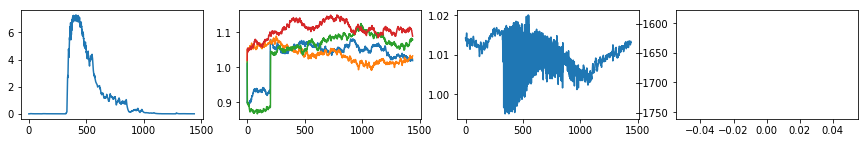

| Reward: -1669 | Episode: 1 | Qmax: 453.9734 | Action: [1.07847936 1.0785967  1.08970402 1.06727321]


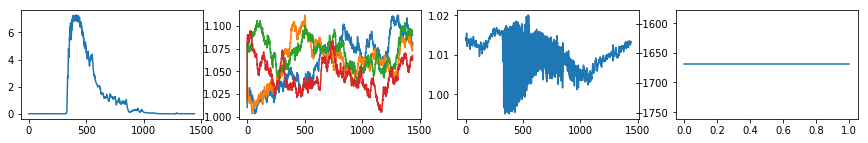

| Reward: -1626 | Episode: 2 | Qmax: 756.2035 | Action: [1.04113503 1.06699381 1.02420002 1.01257767]


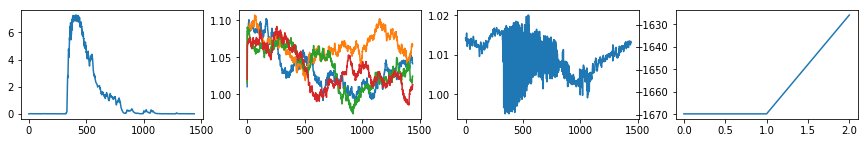

| Reward: -1669 | Episode: 3 | Qmax: 756.8047 | Action: [1.01979612 1.03716263 1.05866572 1.00769923]


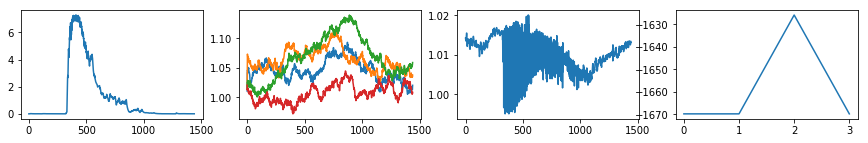

| Reward: -1673 | Episode: 4 | Qmax: 664.4590 | Action: [1.03880186 1.00653194 1.12484466 1.07042891]


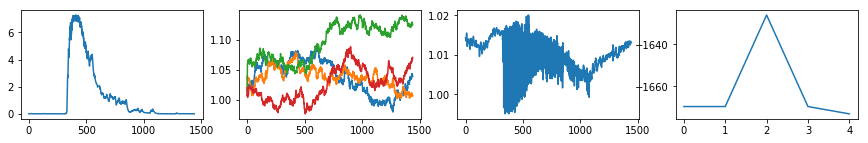

| Reward: -1669 | Episode: 5 | Qmax: 635.1734 | Action: [1.07875866 1.04064374 1.00383581 1.06430276]


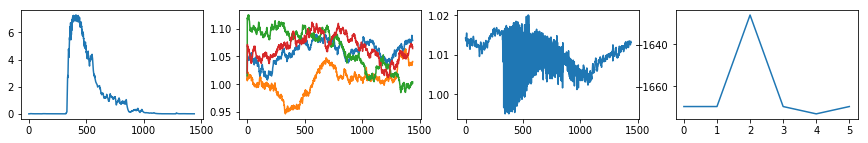

| Reward: -1684 | Episode: 6 | Qmax: 625.4262 | Action: [1.06455085 1.05404095 1.02686585 1.07356514]


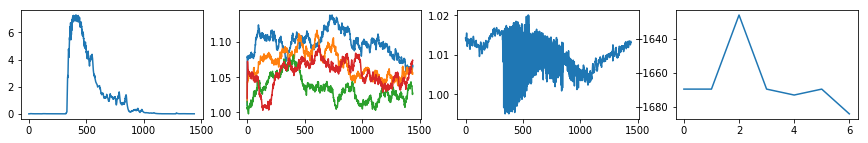

| Reward: -1669 | Episode: 7 | Qmax: 584.0085 | Action: [1.10074445 1.0330988  1.04422448 1.02664326]


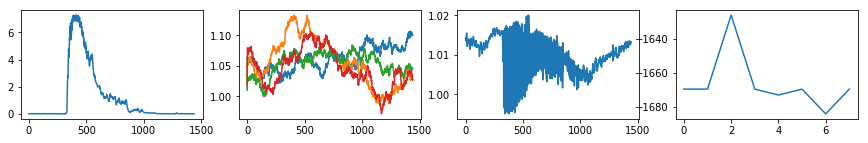

| Reward: -1658 | Episode: 8 | Qmax: 518.3248 | Action: [1.0869611  1.00992613 1.03065468 1.0061004 ]


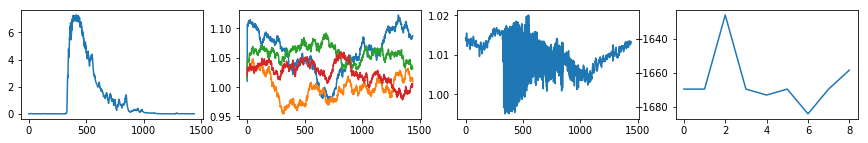

| Reward: -1696 | Episode: 9 | Qmax: 461.1589 | Action: [1.0695798  1.02342315 1.03263275 1.06494679]


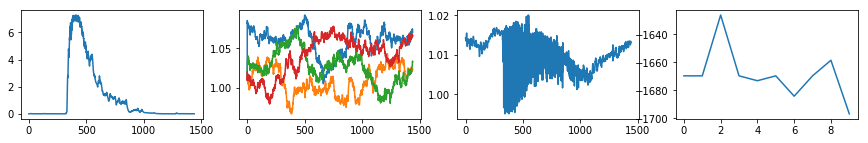

| Reward: -1653 | Episode: 10 | Qmax: 608.6724 | Action: [1.06975784 1.03823641 1.05132555 1.03421031]


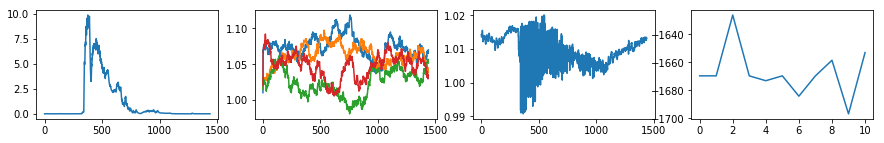

| Reward: -1159 | Episode: 11 | Qmax: 437.3236 | Action: [1.02140833 1.00881153 1.05489344 0.98526485]


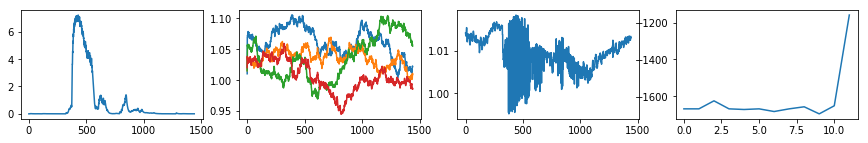

| Reward: -1535 | Episode: 12 | Qmax: 420.9156 | Action: [1.10633801 1.00612123 1.09213241 1.03921688]


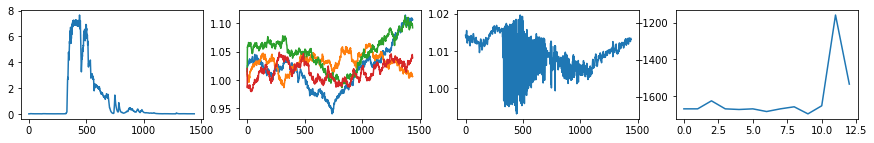

| Reward: -1669 | Episode: 13 | Qmax: 410.0356 | Action: [1.03762432 1.0925552  1.09738971 1.03470148]


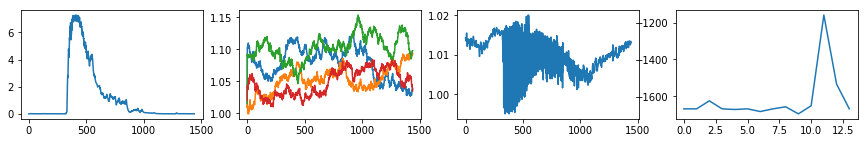

| Reward: -1629 | Episode: 14 | Qmax: 391.8458 | Action: [1.08043722 1.05931286 1.067758   1.04707326]


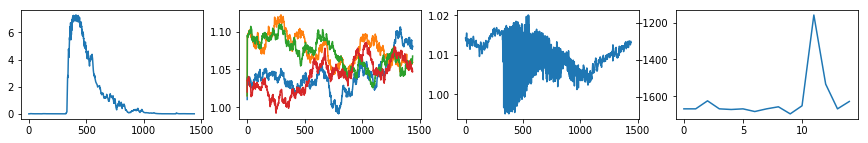

| Reward: -1669 | Episode: 15 | Qmax: 378.9593 | Action: [1.09917099 1.06647643 1.05479608 1.03256124]


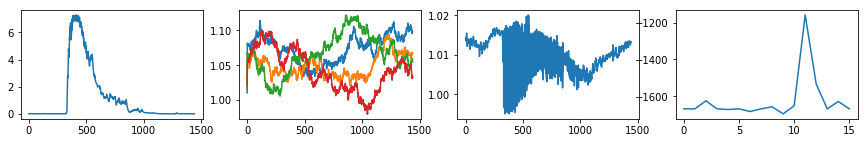

| Reward: -1855 | Episode: 16 | Qmax: 375.6797 | Action: [1.05188817 1.07922264 1.06733181 1.04542104]


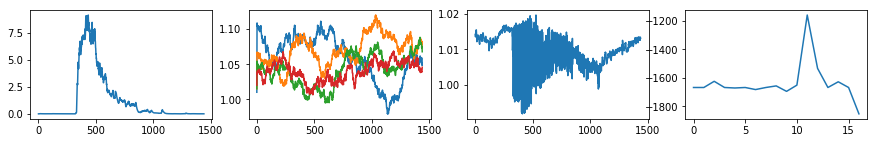

| Reward: -1677 | Episode: 17 | Qmax: 355.9051 | Action: [1.07486732 1.07807885 1.03144303 1.003834  ]


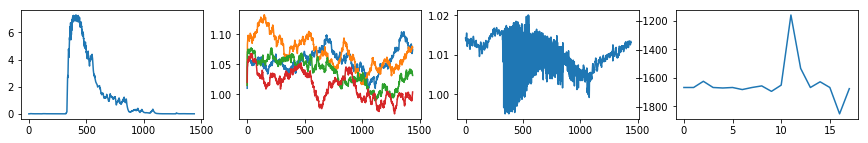

| Reward: -1744 | Episode: 18 | Qmax: 348.9789 | Action: [1.02718199 1.01334208 1.1117112  1.05395301]


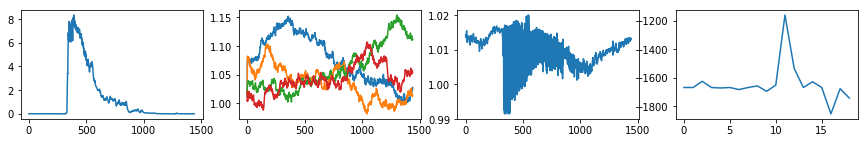

| Reward: -1669 | Episode: 19 | Qmax: 343.2862 | Action: [0.99261414 1.05039118 1.05145649 1.017292  ]


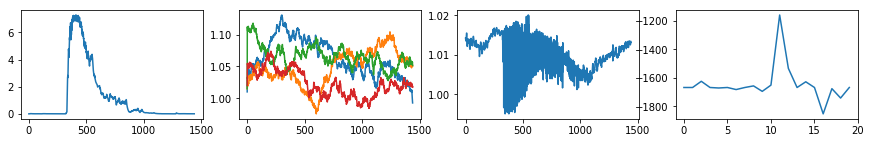

| Reward: -1607 | Episode: 20 | Qmax: 335.8409 | Action: [1.0237403  1.01589896 1.076547   1.06928963]


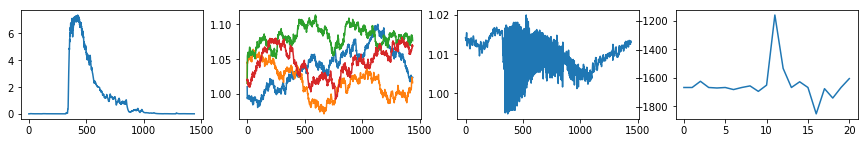

| Reward: -1465 | Episode: 21 | Qmax: 329.0518 | Action: [1.06233461 1.04411041 1.02355435 1.02917631]


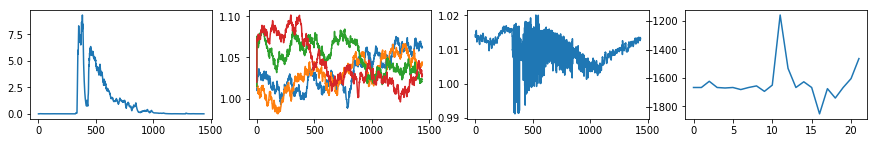

| Reward: -1696 | Episode: 22 | Qmax: 322.1029 | Action: [1.02540437 1.04945657 1.0844527  1.15297501]


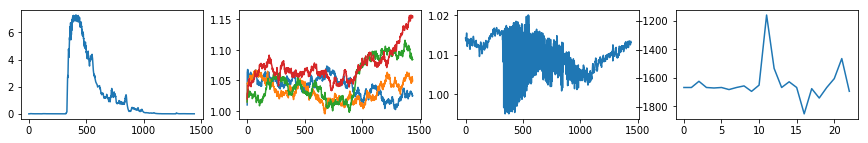

| Reward: -1669 | Episode: 23 | Qmax: 315.7395 | Action: [1.05440183 0.96656748 1.07358278 1.07360179]


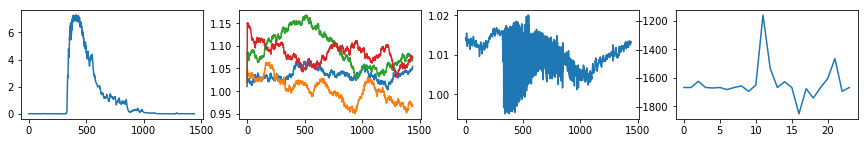

| Reward: -1669 | Episode: 24 | Qmax: 309.2835 | Action: [1.02733887 1.02856787 0.97018727 1.02167673]


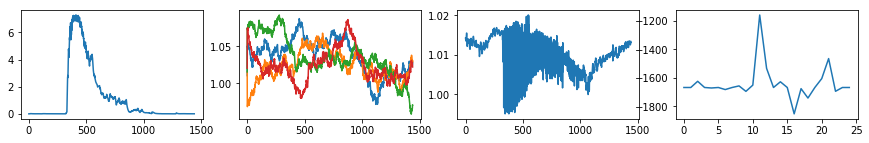

| Reward: -713 | Episode: 25 | Qmax: 303.3774 | Action: [1.00865437 1.07416448 1.04546765 1.05956645]


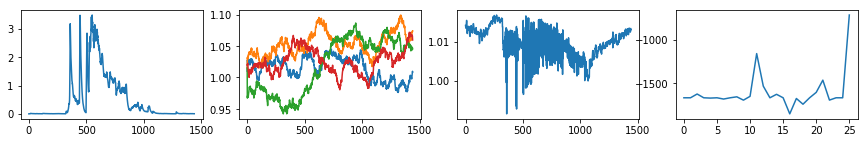

| Reward: -1535 | Episode: 26 | Qmax: 297.3754 | Action: [1.03335752 1.07160837 1.05939385 1.1007084 ]


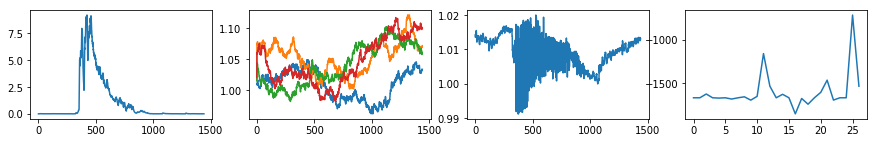

| Reward: -1664 | Episode: 27 | Qmax: 291.5469 | Action: [1.07943422 1.02986254 1.0762138  1.01252096]


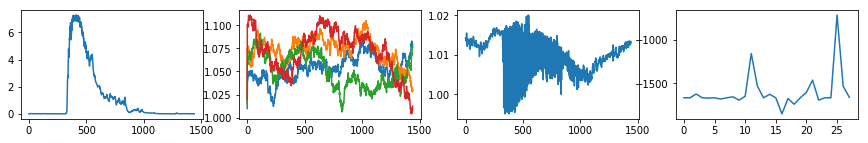

| Reward: -1669 | Episode: 28 | Qmax: 284.7304 | Action: [1.01997505 0.98242633 1.0551998  0.99588503]


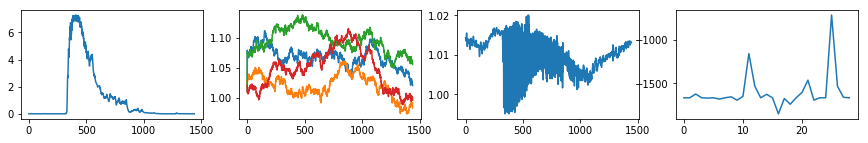

| Reward: -1617 | Episode: 29 | Qmax: 278.0662 | Action: [1.04178799 1.06126348 1.05270848 1.05965734]


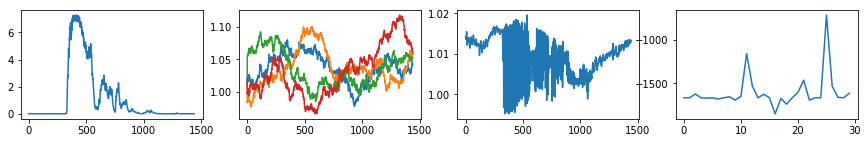

| Reward: -1669 | Episode: 30 | Qmax: 272.4837 | Action: [1.06509017 1.02964616 1.06492281 1.06492498]


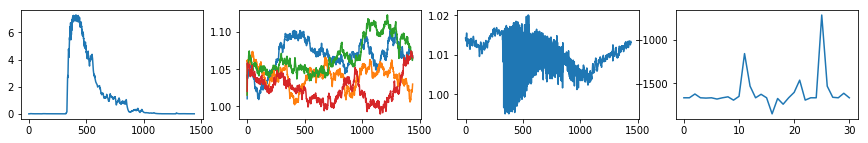

| Reward: -1538 | Episode: 31 | Qmax: 266.2434 | Action: [1.04949454 1.04195842 1.03001031 1.06408625]


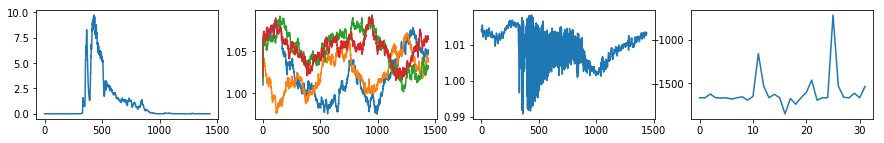

| Reward: -1669 | Episode: 32 | Qmax: 260.2751 | Action: [1.07866714 1.0271059  1.08694152 1.07732668]


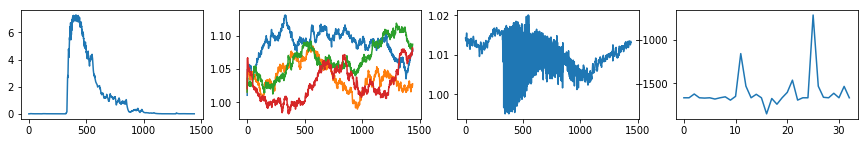

| Reward: -1690 | Episode: 33 | Qmax: 254.1305 | Action: [1.05036325 1.07246833 1.08069178 1.06931161]


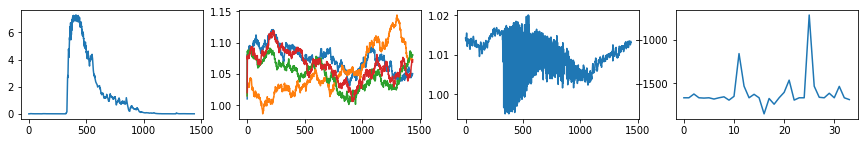

| Reward: -1827 | Episode: 34 | Qmax: 248.0609 | Action: [0.99447458 1.04517322 1.00696933 1.05234264]


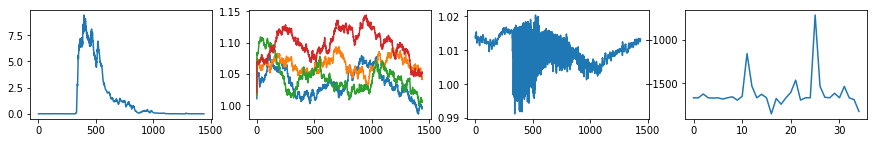

| Reward: -968 | Episode: 35 | Qmax: 242.6699 | Action: [0.99281743 1.02083946 1.0357002  1.13952918]


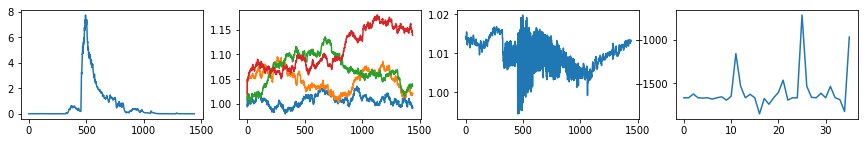

| Reward: -1669 | Episode: 36 | Qmax: 237.8569 | Action: [1.09501828 1.0115539  1.03284103 1.06771925]


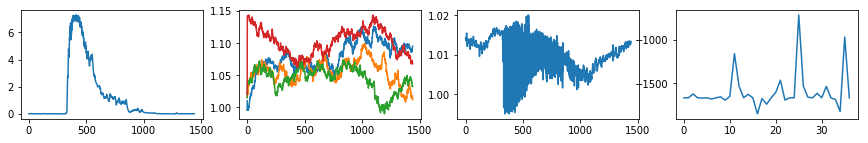

| Reward: -1669 | Episode: 37 | Qmax: 231.8136 | Action: [1.03158714 1.12256292 1.03941437 1.01487202]


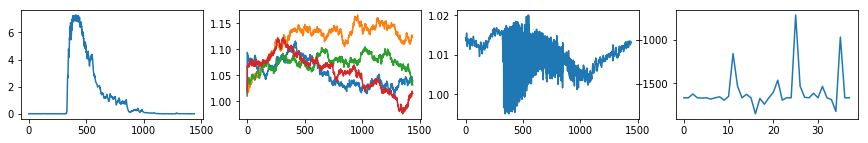

| Reward: -1727 | Episode: 38 | Qmax: 225.5812 | Action: [1.06469734 1.0801896  1.06433646 1.12262702]


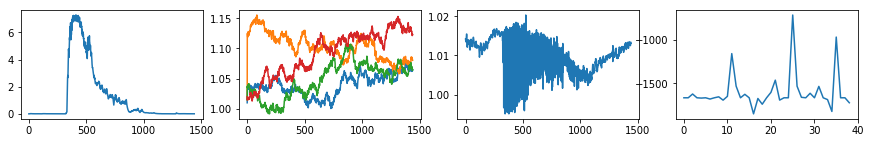

| Reward: -1625 | Episode: 39 | Qmax: 218.5878 | Action: [1.03818753 1.01764394 1.0573385  1.07718281]


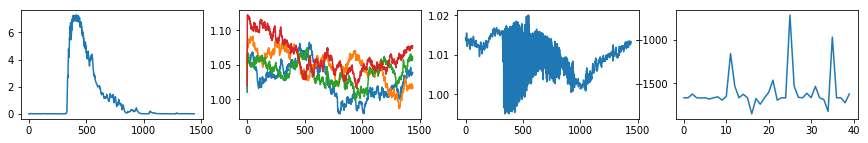

| Reward: -1669 | Episode: 40 | Qmax: 212.4484 | Action: [1.04890317 1.05027725 1.07688911 1.09062949]


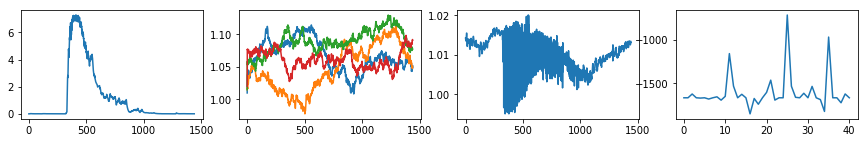

| Reward: -1681 | Episode: 41 | Qmax: 206.0329 | Action: [1.09302739 1.082799   1.01097605 1.02173553]


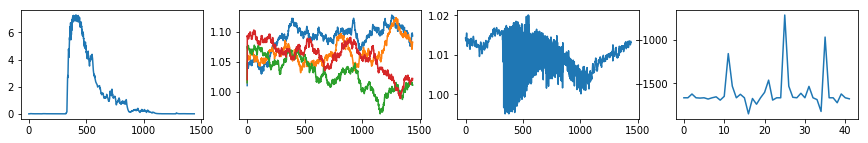

| Reward: -1702 | Episode: 42 | Qmax: 200.3969 | Action: [1.0605108  1.07990381 1.03091783 1.05938607]


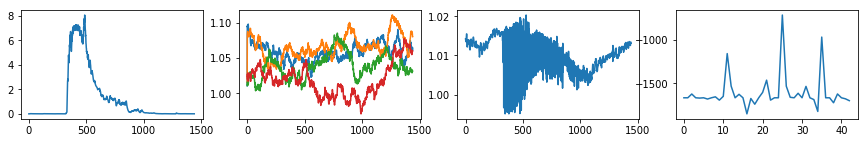

| Reward: -1669 | Episode: 43 | Qmax: 195.7958 | Action: [1.11258761 1.00622074 1.03466258 1.02730712]


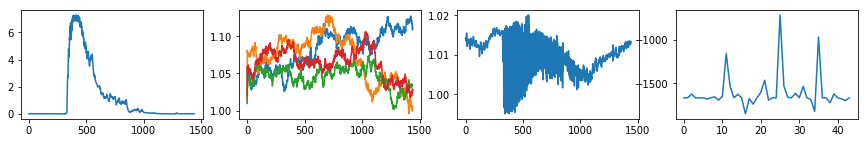

| Reward: -1831 | Episode: 44 | Qmax: 191.2014 | Action: [1.09379616 0.99045648 1.026862   1.0937511 ]


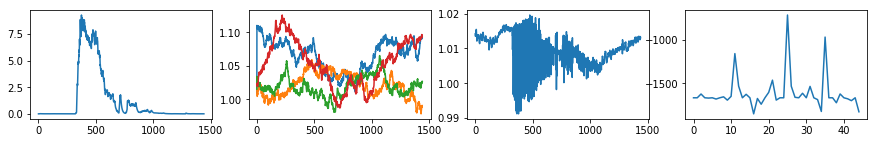

| Reward: -1332 | Episode: 45 | Qmax: 186.0213 | Action: [0.98829359 1.05315285 0.96105597 1.02311046]


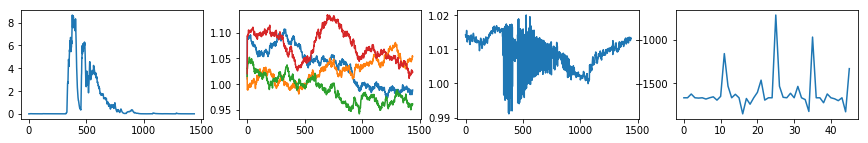

| Reward: -685 | Episode: 46 | Qmax: 181.5522 | Action: [1.04167535 1.04228653 1.03727123 1.07717826]


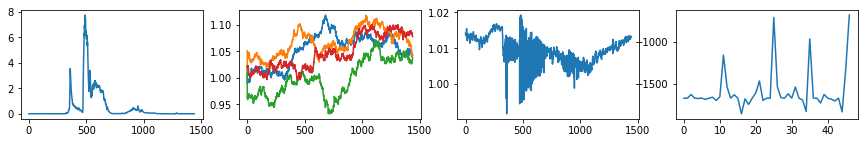

| Reward: -1764 | Episode: 47 | Qmax: 176.5531 | Action: [1.08664192 1.01482248 1.01835887 1.02152996]


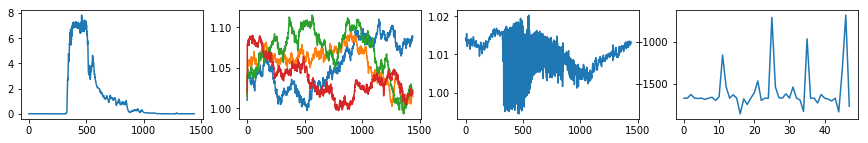

| Reward: -1669 | Episode: 48 | Qmax: 168.9913 | Action: [1.01580892 1.03300939 1.05840362 1.03763496]


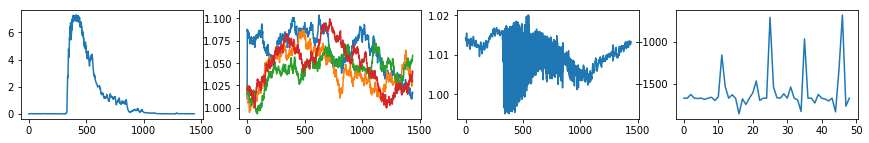

| Reward: -1711 | Episode: 49 | Qmax: 163.4025 | Action: [1.01435438 1.0229422  1.05557368 1.03231204]


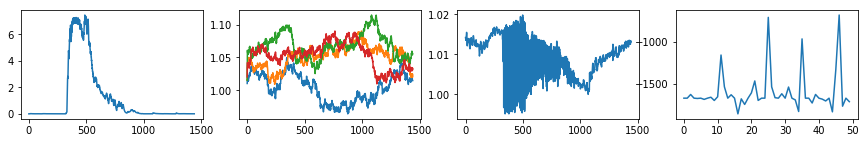

| Reward: -852 | Episode: 50 | Qmax: 158.0998 | Action: [1.00491865 0.97401658 1.03205989 1.09429154]


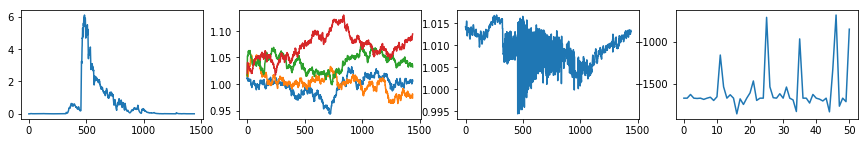

| Reward: -662 | Episode: 51 | Qmax: 153.6254 | Action: [1.01566256 1.00118626 1.05929655 1.06168054]


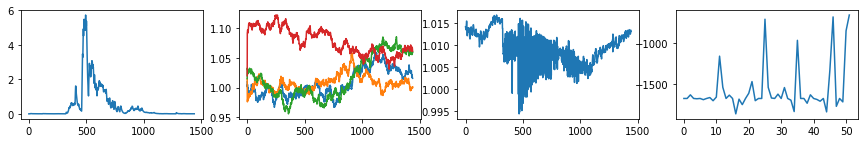

| Reward: -1707 | Episode: 52 | Qmax: 149.0893 | Action: [1.0365415  1.02605357 0.99867468 1.0002158 ]


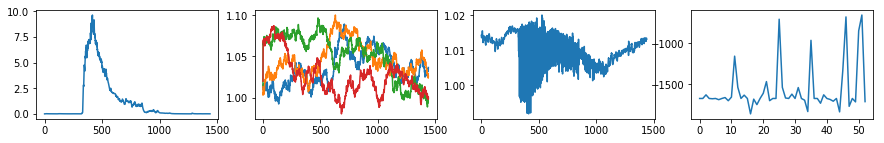

| Reward: -1625 | Episode: 53 | Qmax: 145.1932 | Action: [1.03461304 1.05173914 1.02621495 1.10532717]


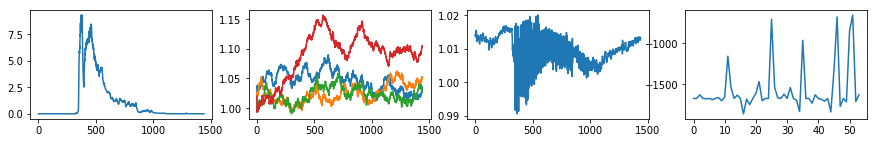

| Reward: -1746 | Episode: 54 | Qmax: 142.4132 | Action: [1.08442045 1.05400958 1.05882946 1.08024541]


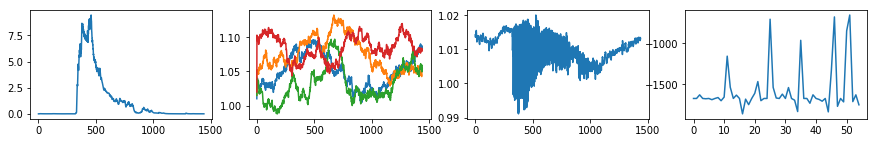

| Reward: -1658 | Episode: 55 | Qmax: 139.3980 | Action: [1.06509342 1.04357038 1.01793876 1.05704764]


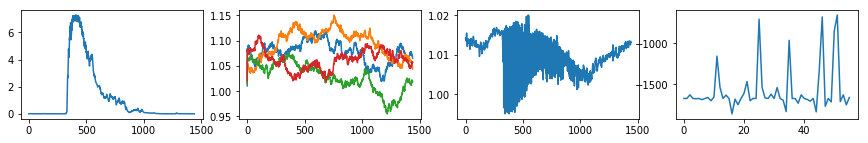

| Reward: -1677 | Episode: 56 | Qmax: 136.7663 | Action: [1.0882719  0.99615583 1.04560426 1.02959825]


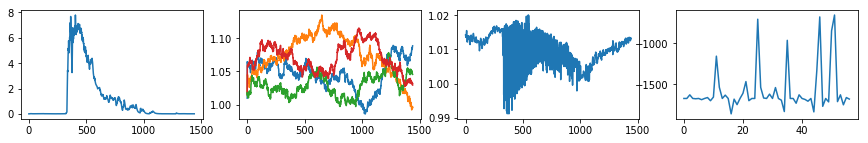

| Reward: -1681 | Episode: 57 | Qmax: 134.1409 | Action: [0.98562483 1.00257948 1.09247075 1.01315287]


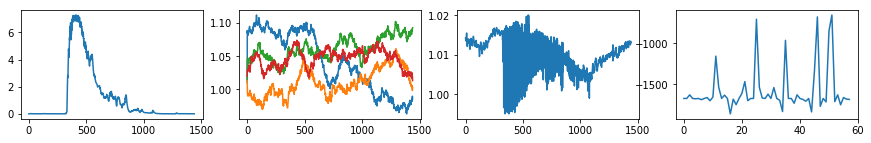

| Reward: -1033 | Episode: 58 | Qmax: 130.6220 | Action: [1.04949909 1.06963384 1.00049229 1.05744364]


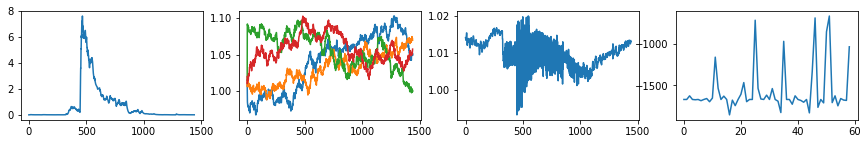

| Reward: -1665 | Episode: 59 | Qmax: 126.3398 | Action: [1.05017101 1.08497294 1.06552713 1.0815489 ]


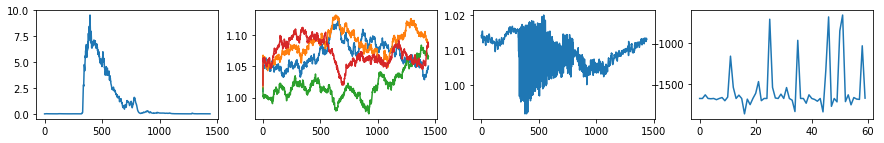

| Reward: -1681 | Episode: 60 | Qmax: 124.0565 | Action: [1.02394965 1.03343434 1.03041035 1.13689115]


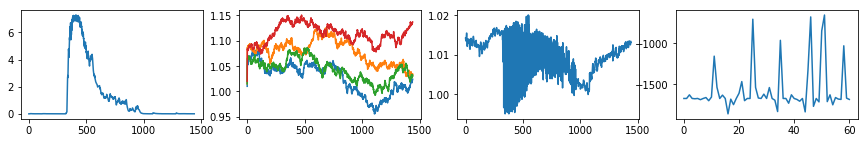

| Reward: -1051 | Episode: 61 | Qmax: 122.8562 | Action: [1.0321645  1.0256983  1.04526218 1.08867414]


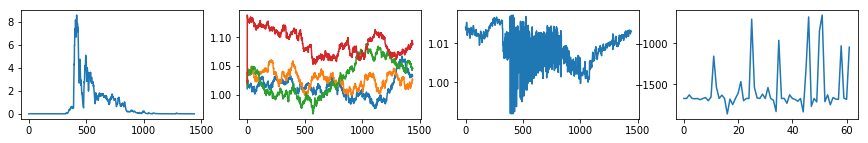

| Reward: -1669 | Episode: 62 | Qmax: 121.0525 | Action: [1.09385105 1.03795791 1.06136794 1.04464344]


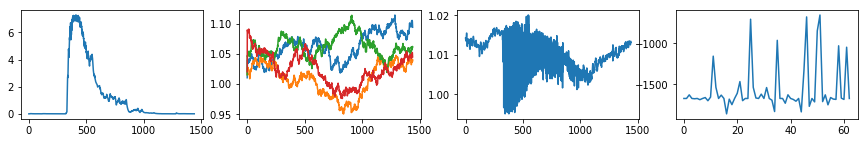

| Reward: -1669 | Episode: 63 | Qmax: 117.8371 | Action: [1.06744652 1.11421968 1.0507082  1.08088001]


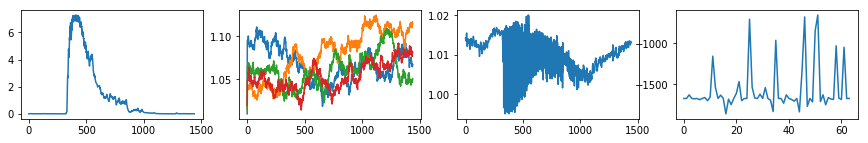

| Reward: -1728 | Episode: 64 | Qmax: 113.8578 | Action: [1.07503449 1.05219364 1.06506396 1.08276698]


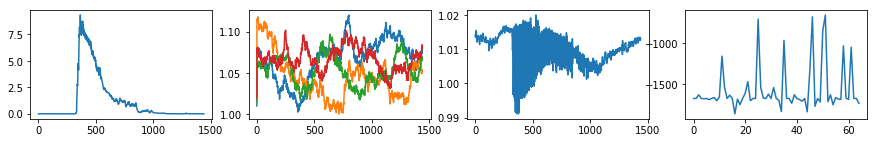

| Reward: -1628 | Episode: 65 | Qmax: 109.8393 | Action: [1.09720168 1.03912152 1.04969437 1.01026713]


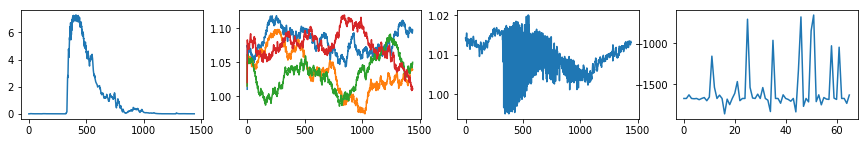

| Reward: -1669 | Episode: 66 | Qmax: 104.3926 | Action: [1.07022223 1.02639223 1.14859704 1.10932905]


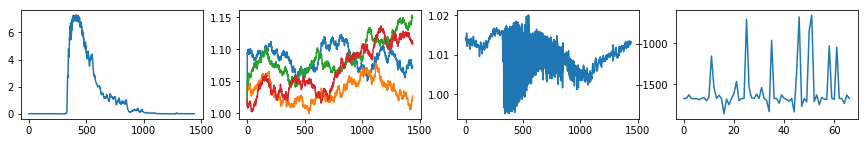

| Reward: -1669 | Episode: 67 | Qmax: 99.0910 | Action: [1.0901689  1.08737842 1.00948991 1.08453164]


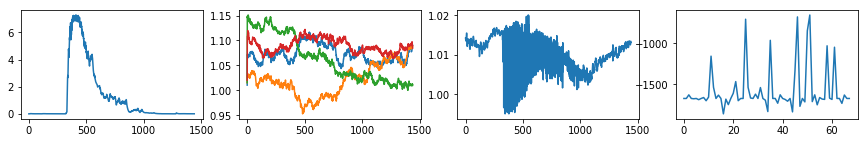

| Reward: -1560 | Episode: 68 | Qmax: 93.9534 | Action: [1.10272527 1.0375245  1.04099124 1.05246158]


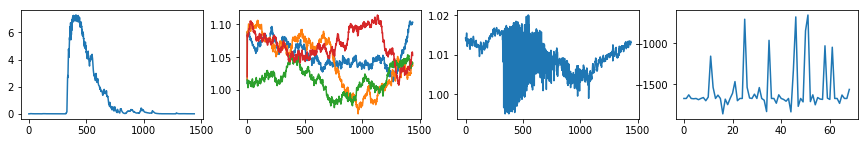

| Reward: -1669 | Episode: 69 | Qmax: 86.6104 | Action: [1.11283043 1.06844711 1.01575449 1.10949016]


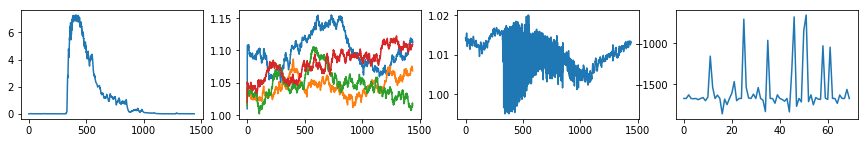

| Reward: -1663 | Episode: 70 | Qmax: 80.3905 | Action: [1.08653533 1.03806885 1.07919787 1.08261827]


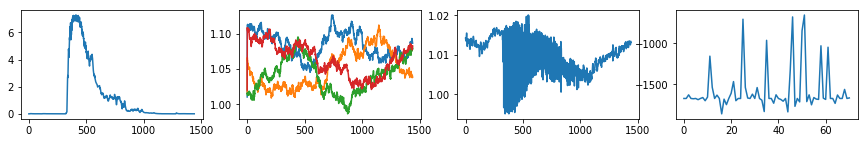

| Reward: -1669 | Episode: 71 | Qmax: 74.9157 | Action: [1.0522586  1.04163838 1.01110034 1.12982334]


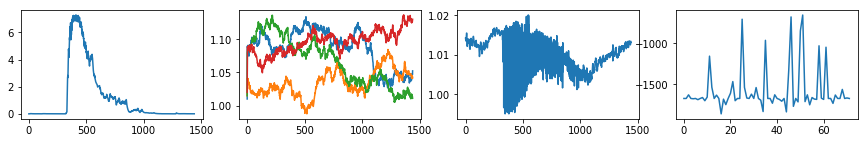

| Reward: -1047 | Episode: 72 | Qmax: 71.0693 | Action: [1.01056374 0.98242906 1.04130764 1.07691711]


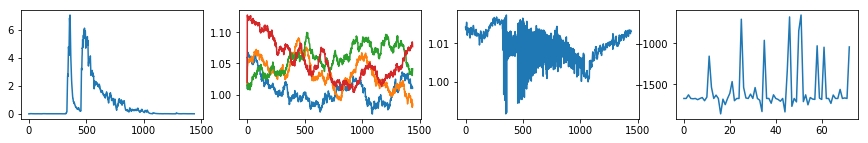

| Reward: -1689 | Episode: 73 | Qmax: 66.7232 | Action: [1.04459323 1.05819272 1.04674242 1.05467863]


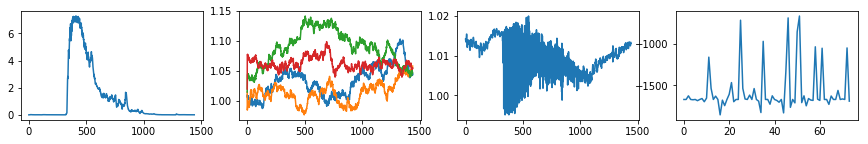

| Reward: -1671 | Episode: 74 | Qmax: 63.0427 | Action: [1.07516961 1.02798566 1.10433753 1.05111857]


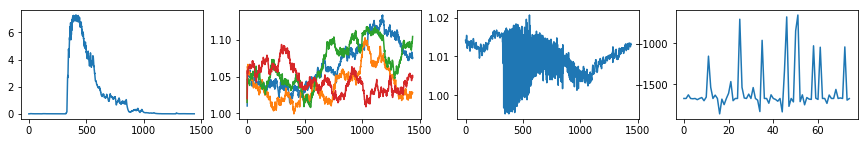

| Reward: -1660 | Episode: 75 | Qmax: 60.7370 | Action: [1.00655969 0.97658794 1.07841831 1.07402629]


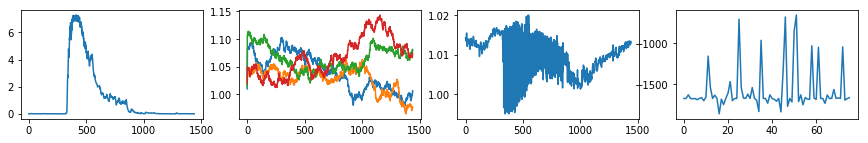

| Reward: -1669 | Episode: 76 | Qmax: 58.6265 | Action: [1.07195456 1.02882478 1.01968064 1.07764314]


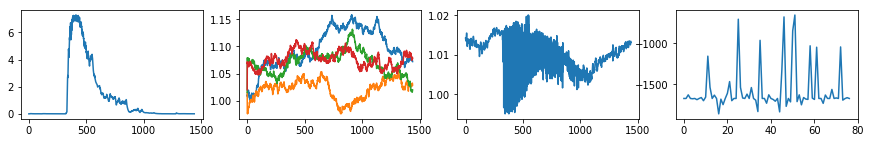

| Reward: -1801 | Episode: 77 | Qmax: 56.3431 | Action: [1.02529416 1.05313015 1.06864669 0.99596375]


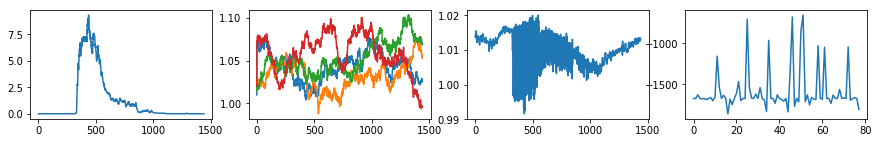

| Reward: -1200 | Episode: 78 | Qmax: 54.2293 | Action: [0.93561941 1.06964019 1.12865434 1.00502249]


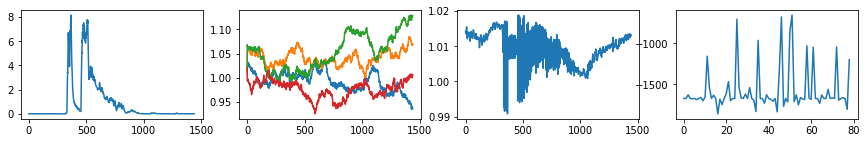

| Reward: -1669 | Episode: 79 | Qmax: 52.1750 | Action: [1.02569951 1.01125708 1.00502748 1.05178023]


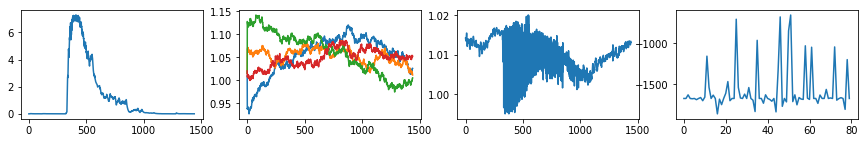

| Reward: -1669 | Episode: 80 | Qmax: 49.6554 | Action: [1.13178263 0.98912584 1.08529088 1.10318615]


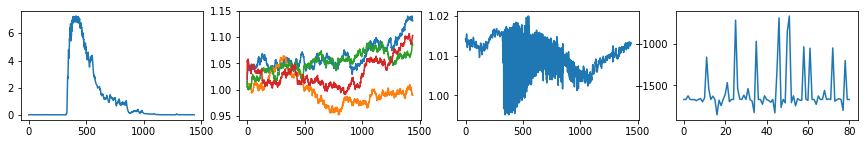

| Reward: -1669 | Episode: 81 | Qmax: 46.3085 | Action: [1.06019887 1.01503619 1.09359649 0.99956952]


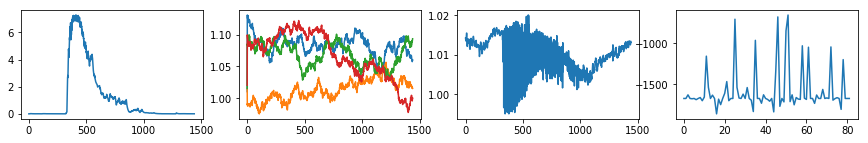

| Reward: -1669 | Episode: 82 | Qmax: 42.5012 | Action: [1.04999674 1.04887089 1.02701694 1.02921524]


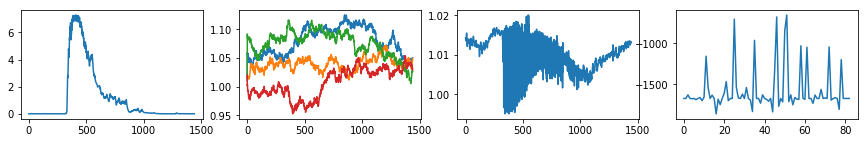

| Reward: -883 | Episode: 83 | Qmax: 40.9916 | Action: [1.04941416 1.02985077 1.04043187 1.00849541]


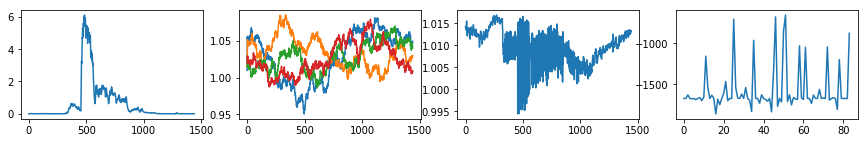

| Reward: -1820 | Episode: 84 | Qmax: 40.3800 | Action: [1.05060231 1.05617252 1.02445403 0.9972214 ]


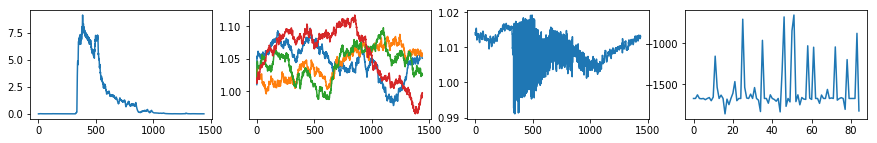

| Reward: -1351 | Episode: 85 | Qmax: 39.1901 | Action: [1.07987109 1.0868537  1.05307723 1.01782115]


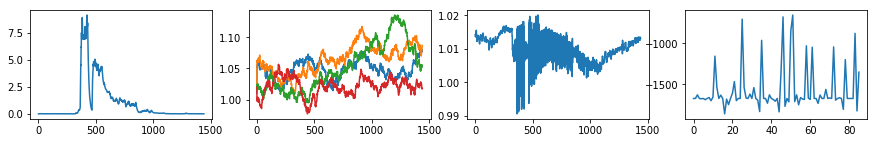

| Reward: -1607 | Episode: 86 | Qmax: 37.9265 | Action: [0.99556701 1.02440135 1.06781286 1.07287394]


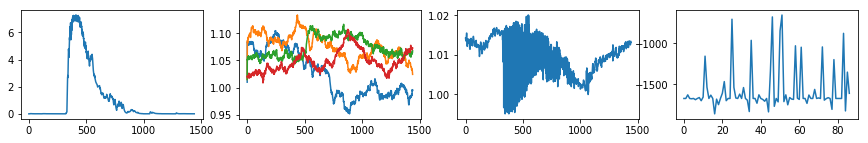

| Reward: -1564 | Episode: 87 | Qmax: 34.9279 | Action: [1.04862092 1.04459118 0.94626285 1.03413421]


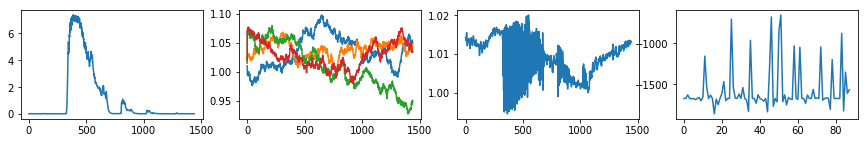

| Reward: -931 | Episode: 88 | Qmax: 31.7531 | Action: [1.05879039 1.03778963 1.07856822 0.99882297]


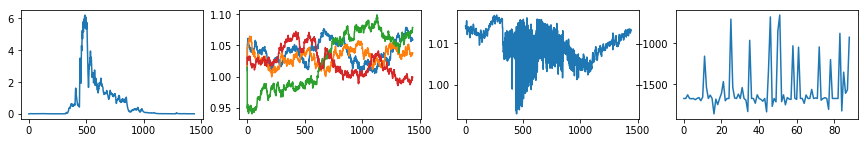

| Reward: -1669 | Episode: 89 | Qmax: 28.2332 | Action: [1.08142266 0.99986103 1.06072175 1.11738763]


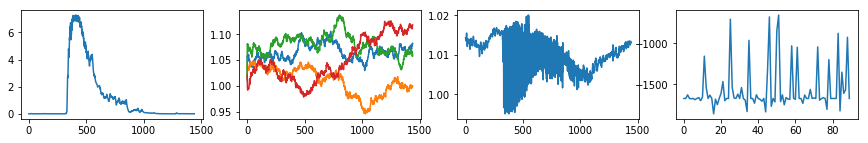

| Reward: -1670 | Episode: 90 | Qmax: 25.5431 | Action: [1.09353951 1.01897412 1.08990365 1.12014364]


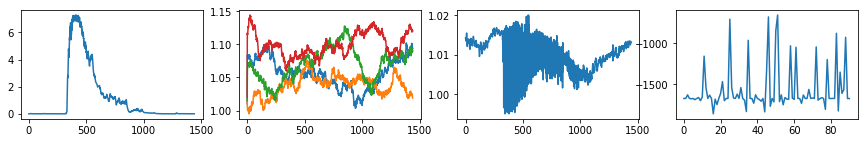

| Reward: -1669 | Episode: 91 | Qmax: 23.4784 | Action: [1.07364808 1.05466412 1.03339626 1.09929732]


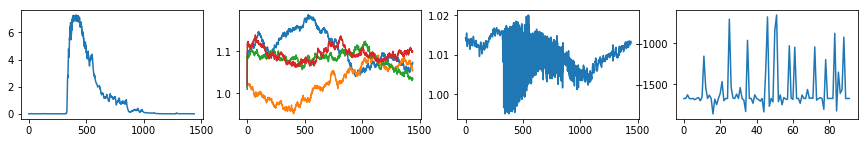

| Reward: -1519 | Episode: 92 | Qmax: 20.0612 | Action: [1.04372832 1.05245757 1.00516058 1.14106234]


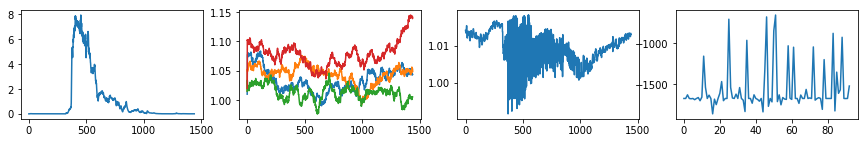

| Reward: -1669 | Episode: 93 | Qmax: 15.5911 | Action: [1.06982049 1.10088546 1.05508856 1.04151934]


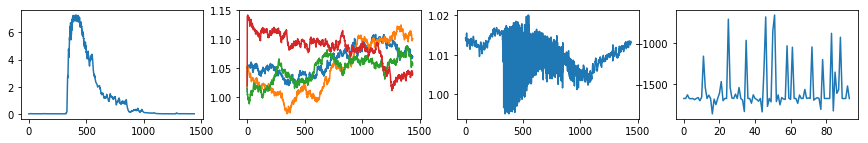

| Reward: -983 | Episode: 94 | Qmax: 12.5482 | Action: [1.01365443 1.05686169 1.07024487 1.00570077]


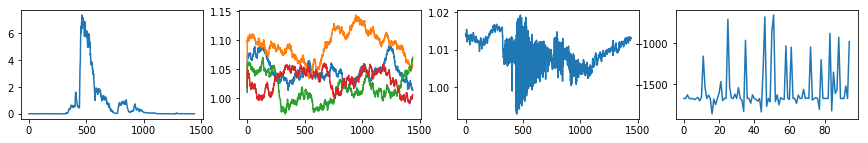

| Reward: -1652 | Episode: 95 | Qmax: 9.5034 | Action: [1.03623313 0.99942023 1.03182702 1.02528433]


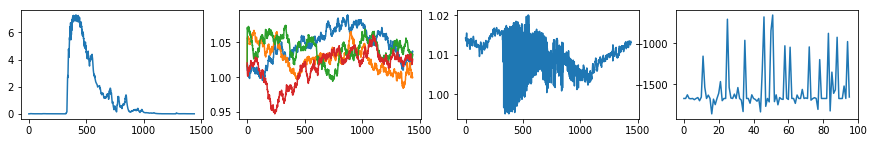

| Reward: -1526 | Episode: 96 | Qmax: 7.5211 | Action: [1.0185798  1.07575816 0.93972161 1.05416945]


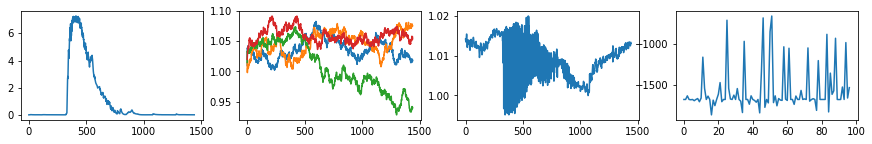

| Reward: -1619 | Episode: 97 | Qmax: 4.7924 | Action: [1.05000841 1.05892636 1.04984389 1.07345938]


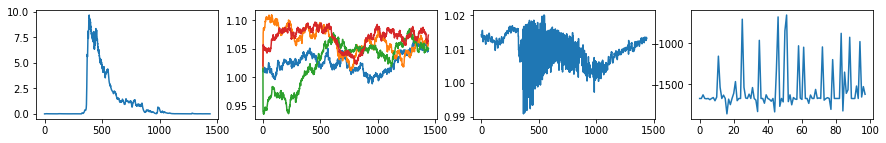

| Reward: -1003 | Episode: 98 | Qmax: 2.4931 | Action: [1.07621028 1.05313502 1.07109369 1.11610396]


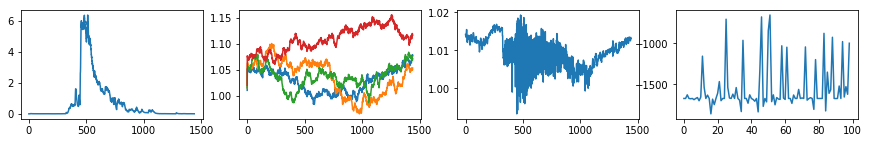

| Reward: -1760 | Episode: 99 | Qmax: 1.5820 | Action: [1.04095168 1.08878491 1.05371131 1.03707878]


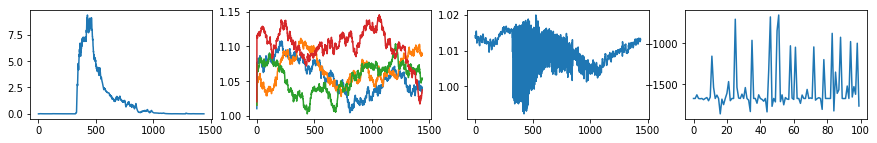

| Reward: -870 | Episode: 100 | Qmax: 1.9977 | Action: [1.0957735  1.0578041  0.95559244 1.04042817]


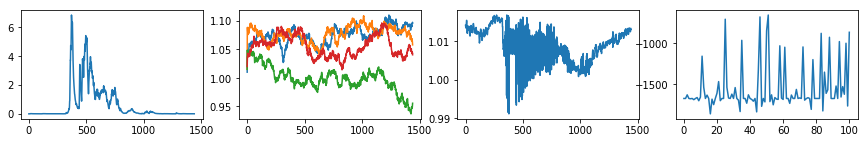

| Reward: -791 | Episode: 101 | Qmax: 2.0819 | Action: [1.04233548 1.01349193 1.0780074  1.06624572]


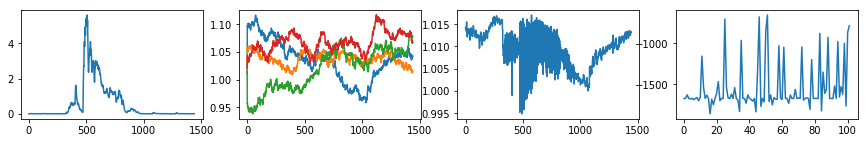

| Reward: -1686 | Episode: 102 | Qmax: 2.8034 | Action: [1.08426638 1.05842843 1.09111657 1.03613201]


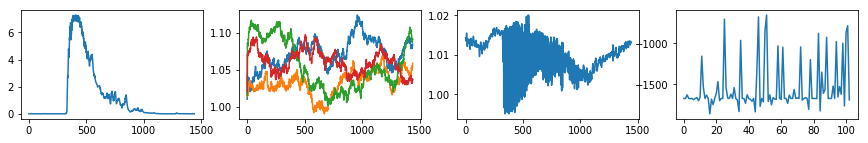

| Reward: -1669 | Episode: 103 | Qmax: 4.1540 | Action: [1.05359765 1.03136306 1.1007726  1.00768427]


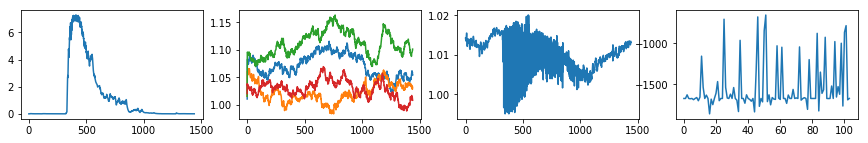

| Reward: -1669 | Episode: 104 | Qmax: 6.2215 | Action: [1.04889475 1.02381608 1.09464892 0.99349714]


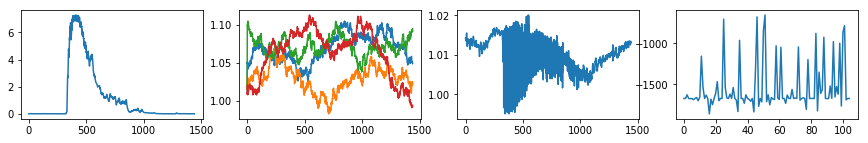

| Reward: -1672 | Episode: 105 | Qmax: 8.4913 | Action: [1.06006972 1.12658621 1.03527039 1.05103196]


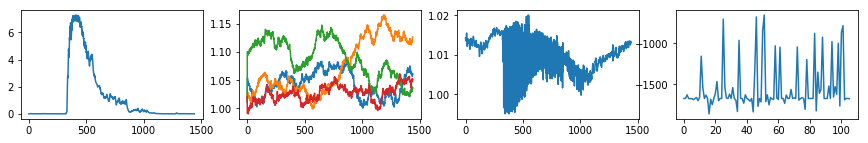

| Reward: -1669 | Episode: 106 | Qmax: 6.9469 | Action: [1.05200584 1.07529104 1.1036921  1.00109923]


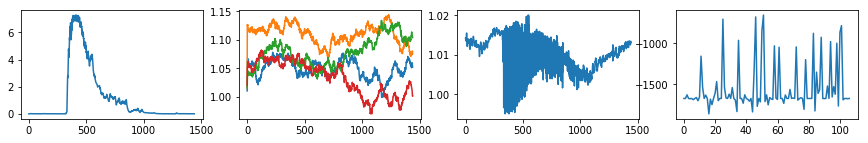

| Reward: -1661 | Episode: 107 | Qmax: 2.3992 | Action: [1.01768771 1.11867059 1.02583494 1.00756325]


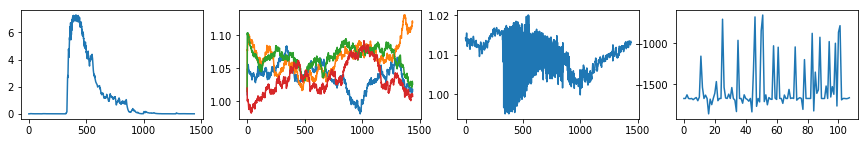

| Reward: -1496 | Episode: 108 | Qmax: -3.5837 | Action: [1.04374144 1.0682427  1.05221748 1.01441912]


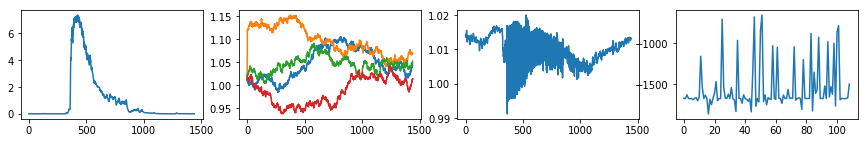

| Reward: -1669 | Episode: 109 | Qmax: -9.6166 | Action: [1.02984105 1.07636107 1.02498447 1.04312573]


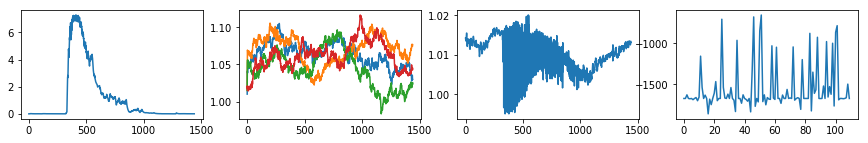

| Reward: -1673 | Episode: 110 | Qmax: -15.0633 | Action: [1.11232292 1.02083451 1.09374064 1.04276708]


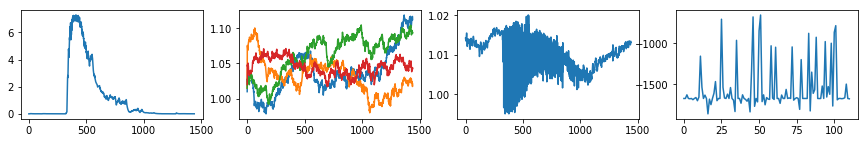

| Reward: -1618 | Episode: 111 | Qmax: -20.0987 | Action: [1.01664531 1.06486475 1.0537601  1.03895459]


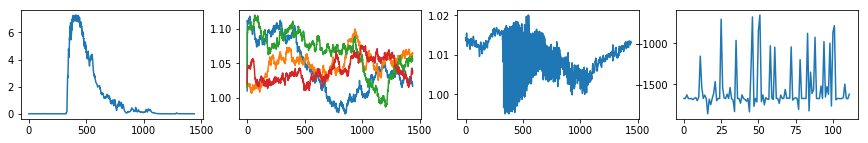

| Reward: -1006 | Episode: 112 | Qmax: -24.9337 | Action: [1.0592033  1.08993236 1.08086889 1.0106683 ]


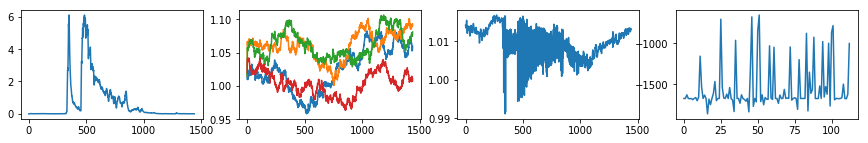

| Reward: -1669 | Episode: 113 | Qmax: -29.5282 | Action: [1.0285402  1.02648014 1.10778465 1.07752673]


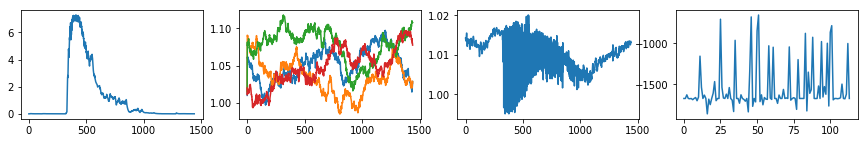

| Reward: -1635 | Episode: 114 | Qmax: -33.4015 | Action: [1.04359396 1.0494397  1.07980341 1.01582088]


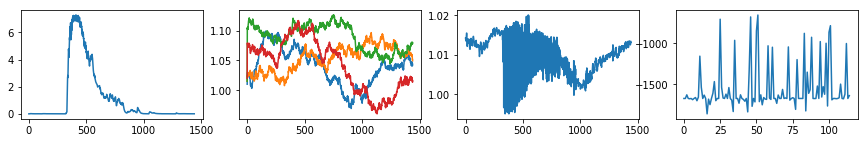

| Reward: -1669 | Episode: 115 | Qmax: -36.6020 | Action: [1.05823599 1.03324179 1.04570657 1.13762124]


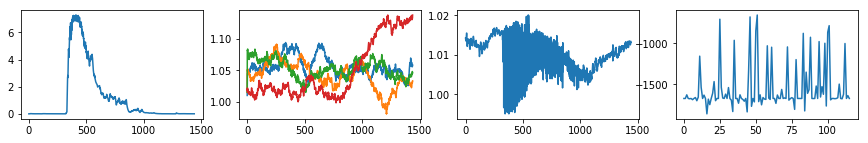

| Reward: -1154 | Episode: 116 | Qmax: -38.8474 | Action: [1.08648134 1.08977068 1.01876311 1.06874736]


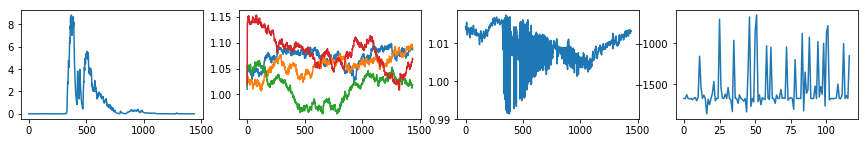

| Reward: -872 | Episode: 117 | Qmax: -39.9799 | Action: [1.09552581 1.00785692 1.03867626 1.07316125]


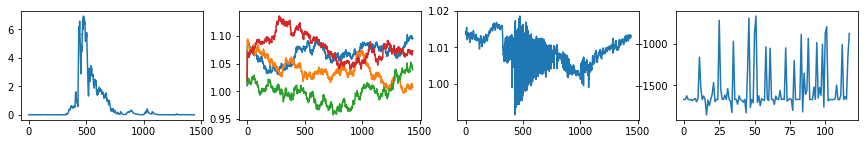

| Reward: -1672 | Episode: 118 | Qmax: -40.9831 | Action: [0.99445608 1.0516777  1.05385066 1.08476277]


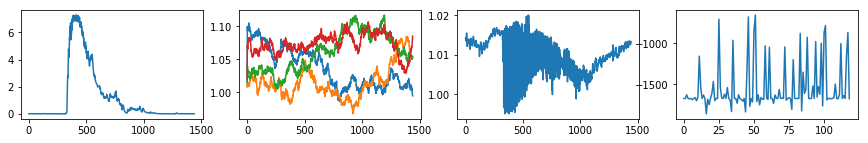

| Reward: -1669 | Episode: 119 | Qmax: -43.1413 | Action: [1.13012771 1.00420029 1.07888688 1.02980985]


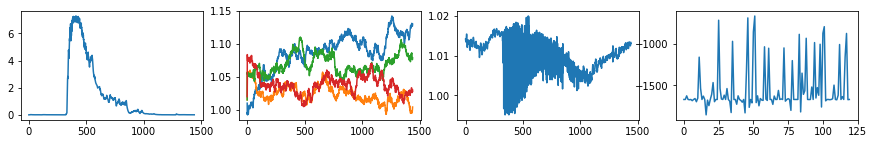

| Reward: -1669 | Episode: 120 | Qmax: -45.6623 | Action: [1.08759906 1.03811628 1.07884708 1.06099328]


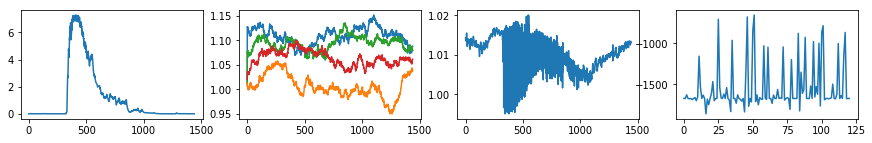

| Reward: -1688 | Episode: 121 | Qmax: -49.4702 | Action: [1.12555825 1.08345243 1.0088107  0.99356467]


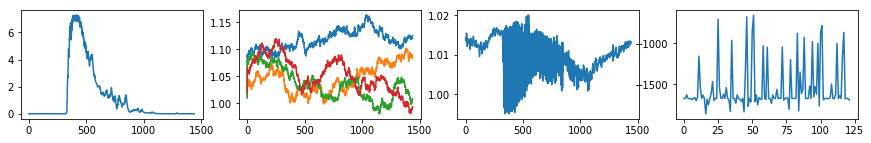

| Reward: -1681 | Episode: 122 | Qmax: -50.7290 | Action: [1.00224835 1.06648701 1.09659568 1.02619229]


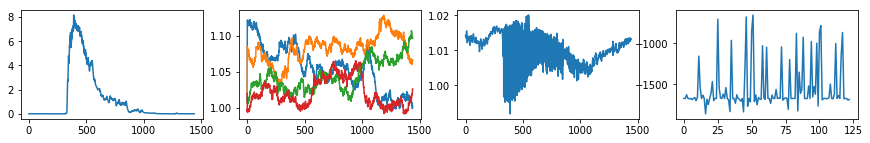

| Reward: -1269 | Episode: 123 | Qmax: -51.3093 | Action: [1.02229691 1.0517979  0.99222954 1.08274525]


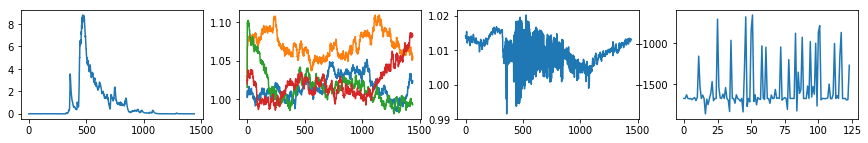

| Reward: -1079 | Episode: 124 | Qmax: -52.2098 | Action: [1.02058537 0.98151087 0.96724788 1.12158577]


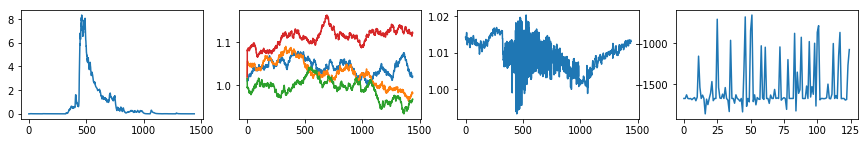

| Reward: -818 | Episode: 125 | Qmax: -52.8844 | Action: [1.03057455 1.0632705  1.035832   1.04016735]


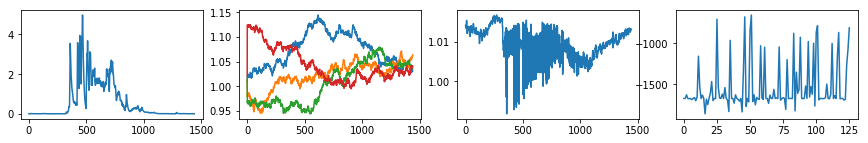

| Reward: -1700 | Episode: 126 | Qmax: -53.6465 | Action: [1.08858565 1.06903558 1.0627231  1.05846379]


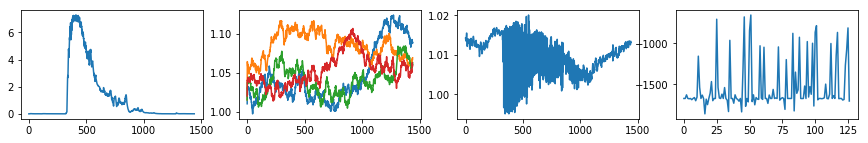

| Reward: -1628 | Episode: 127 | Qmax: -54.3305 | Action: [1.0293942  1.07980405 1.10820612 1.06882653]


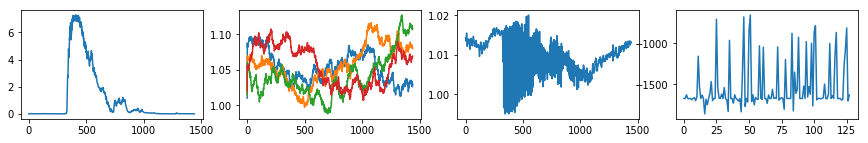

| Reward: -1669 | Episode: 128 | Qmax: -53.6303 | Action: [1.1055804  1.03505361 1.07182796 0.99379621]


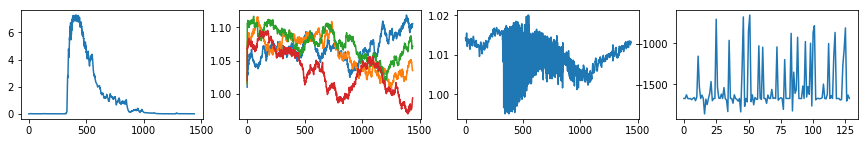

| Reward: -1616 | Episode: 129 | Qmax: -52.8091 | Action: [1.00198818 1.06347805 1.02985864 1.02783269]


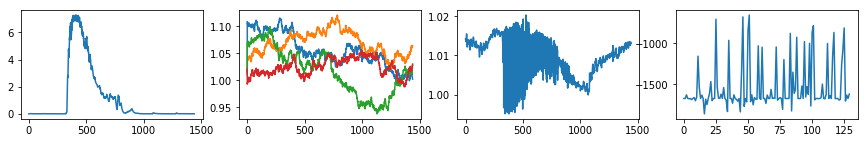

| Reward: -1669 | Episode: 130 | Qmax: -52.4552 | Action: [1.04596068 1.0561027  1.07862451 1.02891119]


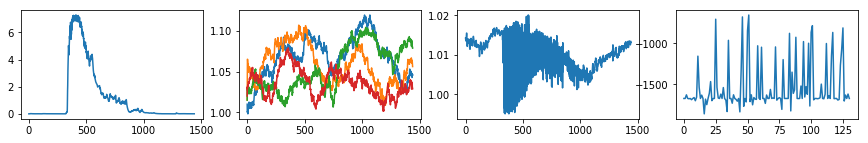

| Reward: -1669 | Episode: 131 | Qmax: -53.1625 | Action: [1.03643497 1.04516446 1.11929504 1.06200714]


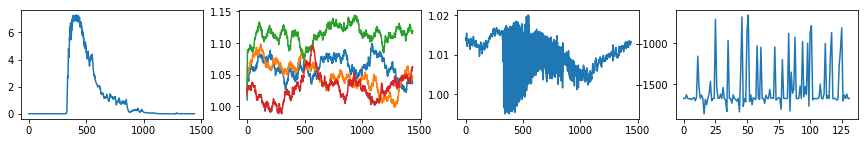

| Reward: -1669 | Episode: 132 | Qmax: -54.4593 | Action: [1.01510826 1.07571742 1.04265606 1.0126205 ]


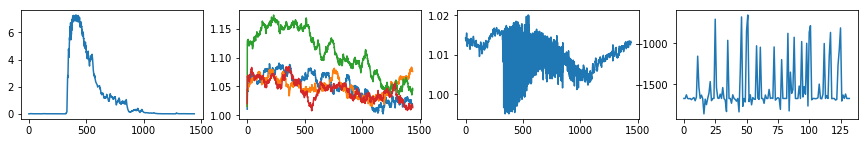

| Reward: -1669 | Episode: 133 | Qmax: -54.9908 | Action: [1.0026881  1.02832679 1.08397628 1.02444552]


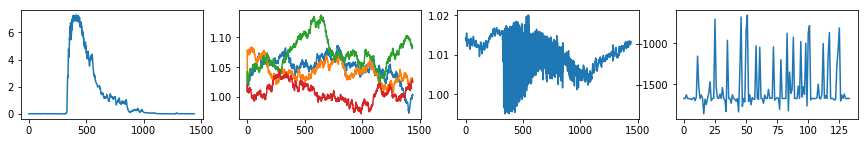

| Reward: -1669 | Episode: 134 | Qmax: -55.3296 | Action: [1.03771949 0.96921269 0.98127073 1.02290335]


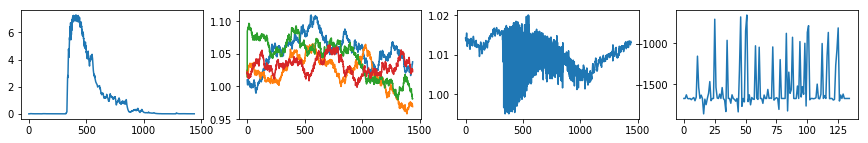

| Reward: -1669 | Episode: 135 | Qmax: -55.6899 | Action: [1.07717642 1.05193366 1.0936004  1.05185176]


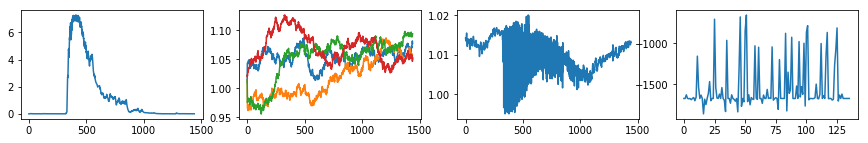

| Reward: -1669 | Episode: 136 | Qmax: -55.9245 | Action: [1.08143982 0.96192642 1.0346631  1.05070753]


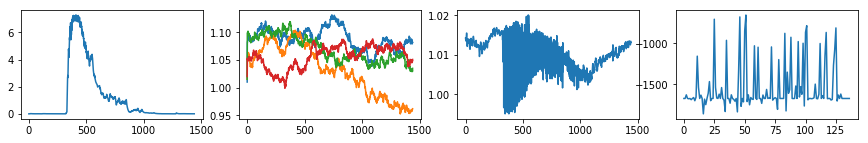

| Reward: -1362 | Episode: 137 | Qmax: -55.7495 | Action: [1.03403726 1.01843813 1.04622487 0.98640946]


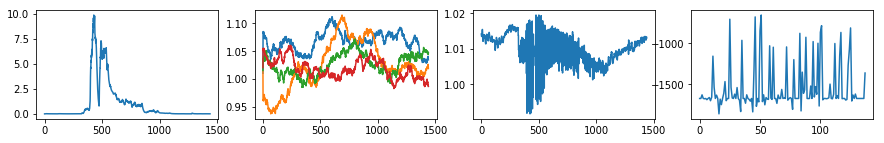

| Reward: -1669 | Episode: 138 | Qmax: -53.3011 | Action: [1.05169627 1.10164229 1.05794608 1.03103883]


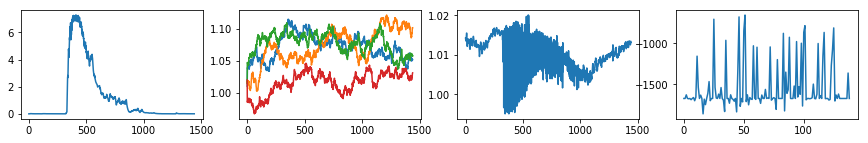

| Reward: -1674 | Episode: 139 | Qmax: -49.6694 | Action: [0.99928597 1.047002   1.09253061 1.0618534 ]


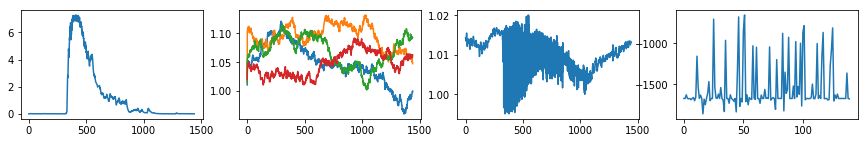

| Reward: -1679 | Episode: 140 | Qmax: -46.9803 | Action: [1.03294589 1.08213412 1.17709912 0.99181366]


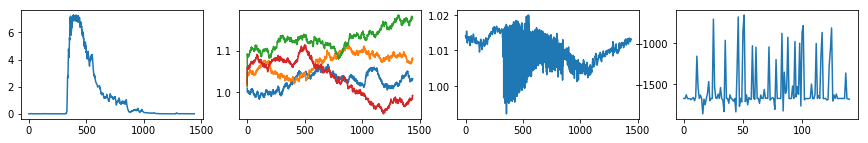

| Reward: -1669 | Episode: 141 | Qmax: -44.6754 | Action: [1.04183481 1.04338747 1.06823483 1.08379093]


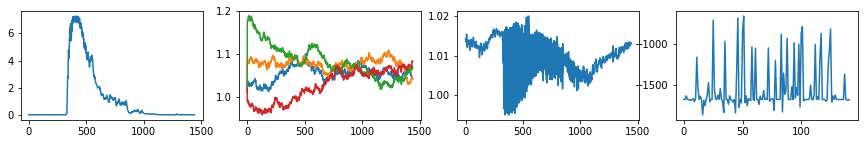

| Reward: -1403 | Episode: 142 | Qmax: -44.0707 | Action: [1.00502463 1.06049473 1.09190226 1.05934285]


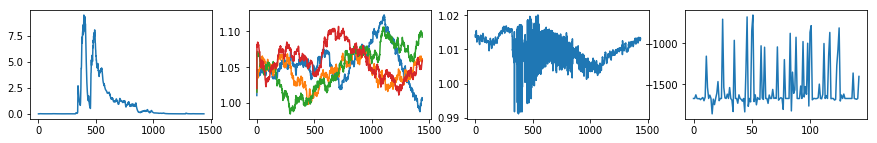

| Reward: -856 | Episode: 143 | Qmax: -44.0653 | Action: [1.05457866 1.03822257 1.09023538 1.05694879]


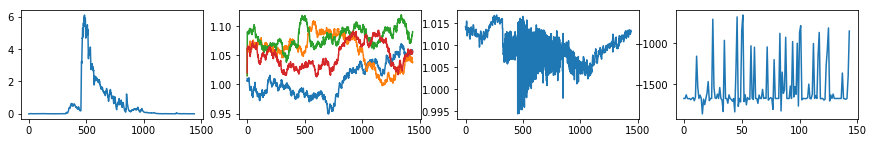

| Reward: -1669 | Episode: 144 | Qmax: -43.5090 | Action: [1.0546128  1.06850354 1.05587177 1.12968589]


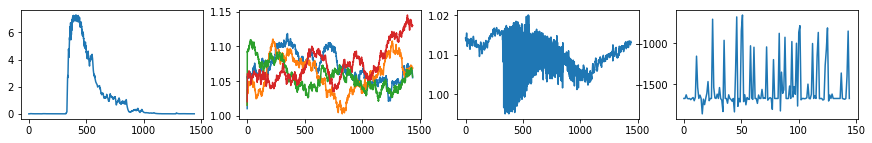

| Reward: -1710 | Episode: 145 | Qmax: -43.2955 | Action: [1.02723593 1.07776757 1.05243718 1.0516042 ]


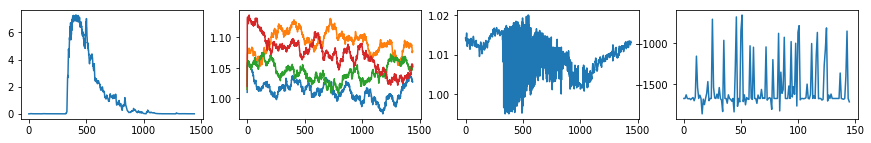

| Reward: -1785 | Episode: 146 | Qmax: -43.4459 | Action: [1.0528286  1.04700942 1.05156345 0.97875144]


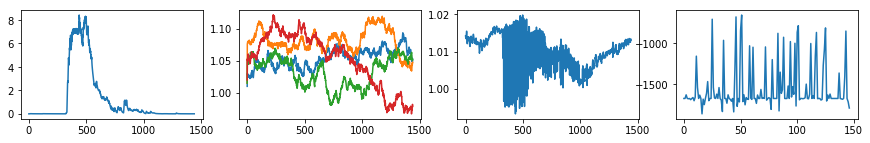

| Reward: -1699 | Episode: 147 | Qmax: -43.1633 | Action: [1.04590433 1.09570264 0.97649132 1.00242678]


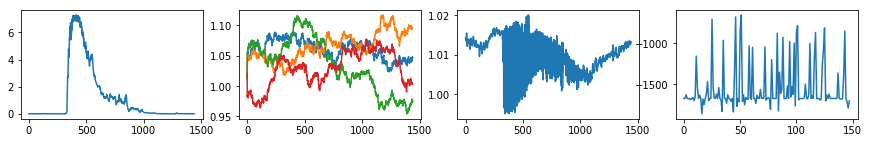

| Reward: -1669 | Episode: 148 | Qmax: -44.6273 | Action: [1.1013592  1.03491396 1.10087734 1.09978845]


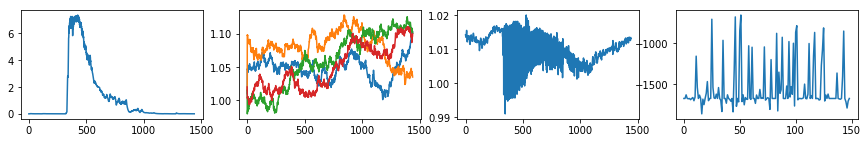

| Reward: -1669 | Episode: 149 | Qmax: -47.4687 | Action: [1.04103119 1.02450602 1.04919331 1.01133049]


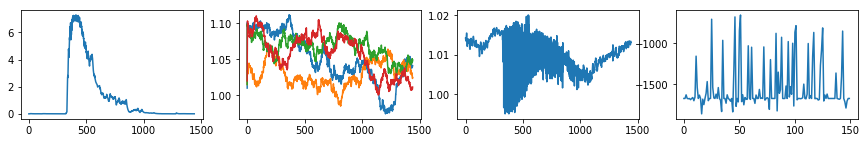

| Reward: -863 | Episode: 150 | Qmax: -49.6164 | Action: [1.03241171 0.96079998 1.07516712 1.01293765]


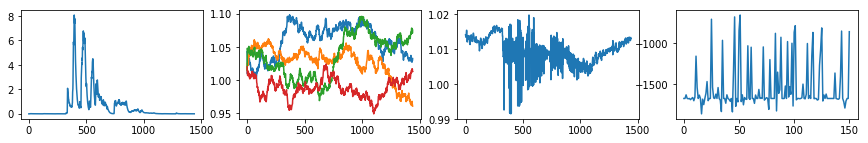

| Reward: -1329 | Episode: 151 | Qmax: -50.2120 | Action: [1.06272403 1.08879198 1.06675853 1.0904112 ]


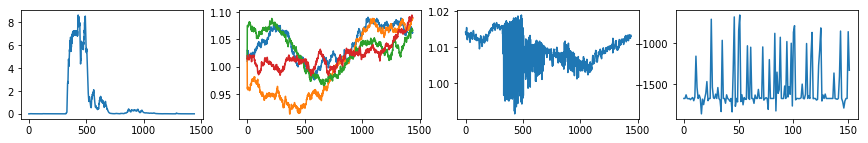

| Reward: -1658 | Episode: 152 | Qmax: -50.6052 | Action: [1.0651095  1.02733542 1.04683612 1.07647747]


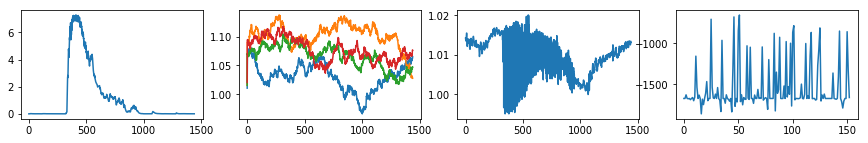

| Reward: -1669 | Episode: 153 | Qmax: -48.9711 | Action: [1.06302983 1.01673997 1.1326419  1.07362756]


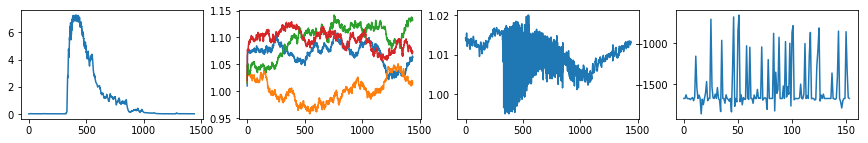

| Reward: -1669 | Episode: 154 | Qmax: -47.9425 | Action: [1.04127237 1.04837013 1.04198791 1.03764349]


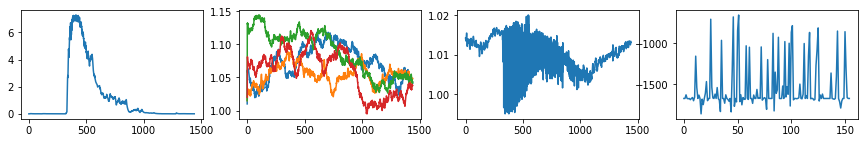

| Reward: -1687 | Episode: 155 | Qmax: -46.9803 | Action: [0.9900242  1.06072902 1.08377012 1.00217334]


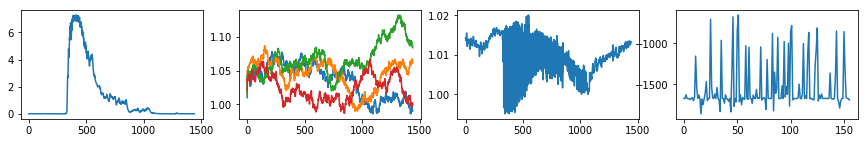

| Reward: -1741 | Episode: 156 | Qmax: -45.9143 | Action: [1.01914367 1.07346607 1.01939235 1.01066162]


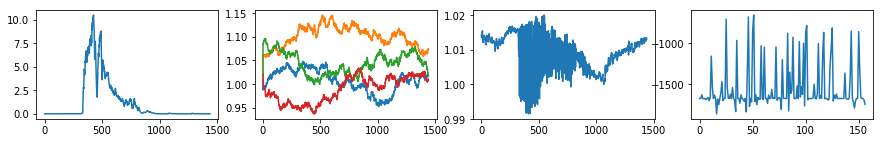

| Reward: -1131 | Episode: 157 | Qmax: -45.3705 | Action: [1.03614294 1.04312134 1.03372511 1.05970163]


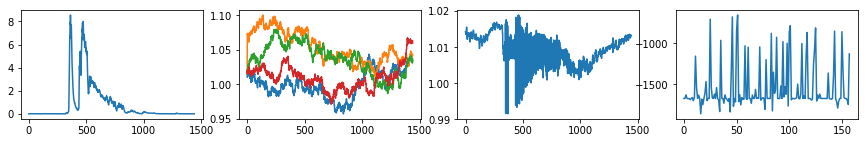

| Reward: -896 | Episode: 158 | Qmax: -45.3436 | Action: [1.06432073 1.08228269 1.08430485 0.98084097]


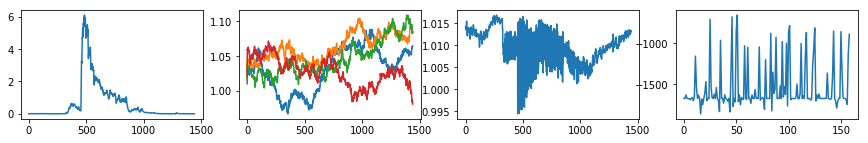

| Reward: -1669 | Episode: 159 | Qmax: -45.2147 | Action: [1.06936079 1.06405447 1.01506745 1.09756646]


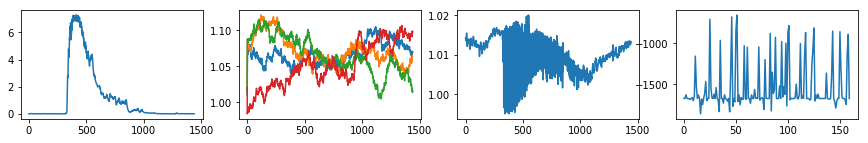

| Reward: -1246 | Episode: 160 | Qmax: -45.0805 | Action: [1.10884839 1.05428738 1.04537601 1.08792424]


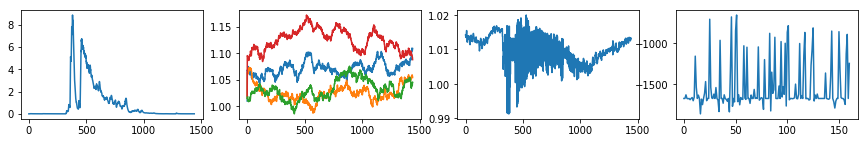

| Reward: -1688 | Episode: 161 | Qmax: -46.7489 | Action: [1.07316186 1.07137939 1.08598163 1.01618294]


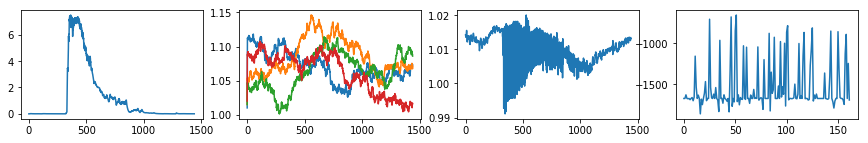

| Reward: -1778 | Episode: 162 | Qmax: -47.0678 | Action: [1.04260911 1.0939092  1.01571781 1.0529554 ]


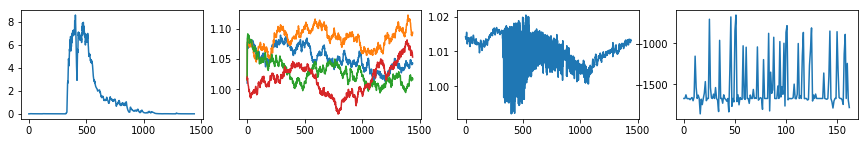

| Reward: -1733 | Episode: 163 | Qmax: -47.1163 | Action: [1.04536904 1.02803952 1.08205096 1.02670065]


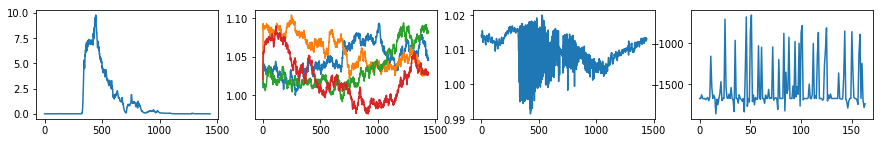

| Reward: -1707 | Episode: 164 | Qmax: -46.9955 | Action: [1.05477563 1.11891066 1.06207281 1.1323014 ]


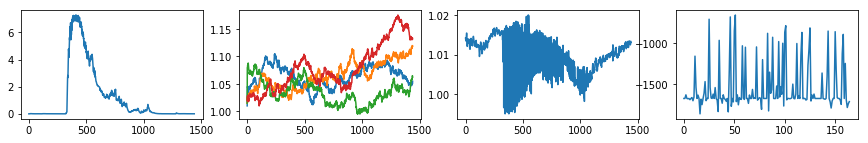

| Reward: -1669 | Episode: 165 | Qmax: -48.1415 | Action: [1.16129609 1.06344473 1.05719877 1.03971421]


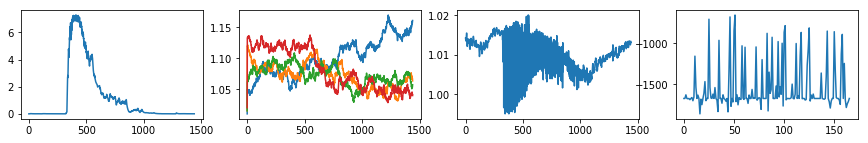

| Reward: -1669 | Episode: 166 | Qmax: -50.9067 | Action: [1.08827348 1.03432435 1.08075064 1.09625662]


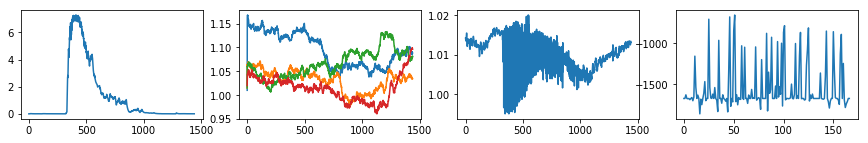

| Reward: -1669 | Episode: 167 | Qmax: -52.5198 | Action: [1.05016704 1.03079148 1.02240164 1.04607242]


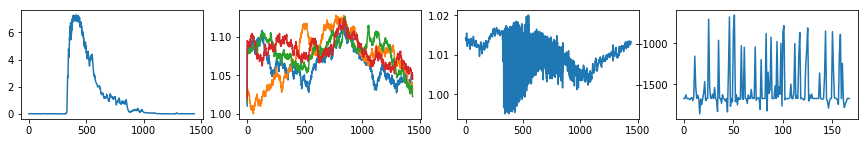

| Reward: -943 | Episode: 168 | Qmax: -52.7338 | Action: [1.07427813 1.07845091 1.03831263 1.10649788]


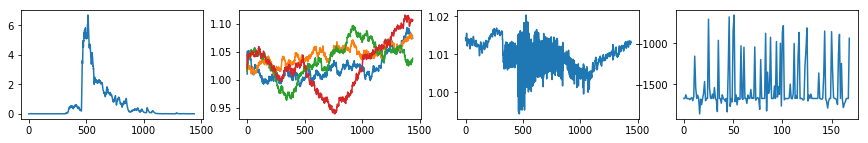

| Reward: -1669 | Episode: 169 | Qmax: -52.6947 | Action: [1.06760591 1.05727232 1.10327318 1.11522275]


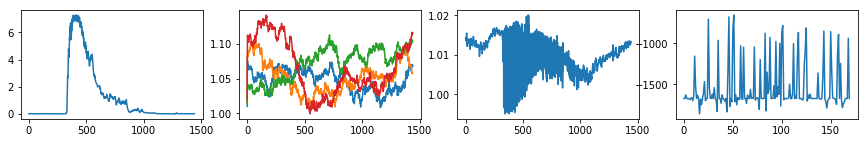

| Reward: -1643 | Episode: 170 | Qmax: -52.8458 | Action: [0.9753863  1.08992642 1.0948256  1.09583997]


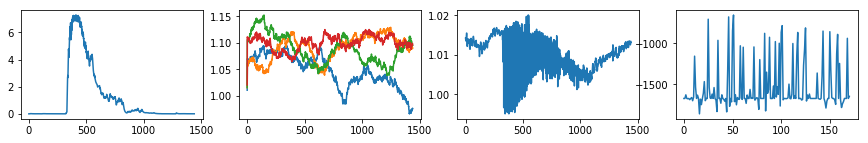

| Reward: -884 | Episode: 171 | Qmax: -53.2212 | Action: [1.0481129  1.0301372  1.05962138 1.09507541]


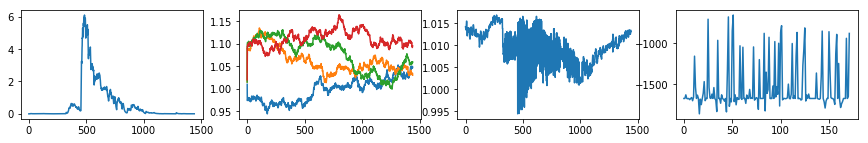

| Reward: -916 | Episode: 172 | Qmax: -54.0039 | Action: [1.02043079 1.05120578 1.04760544 1.0963753 ]


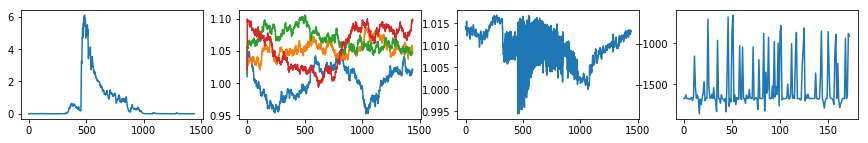

| Reward: -1759 | Episode: 173 | Qmax: -55.0988 | Action: [1.07370396 1.07843841 1.02970286 1.10265588]


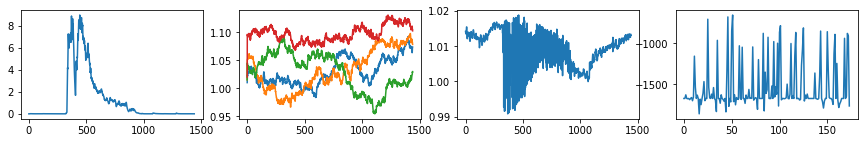

| Reward: -1678 | Episode: 174 | Qmax: -56.9150 | Action: [1.06730166 1.06495401 1.07610551 1.06560672]


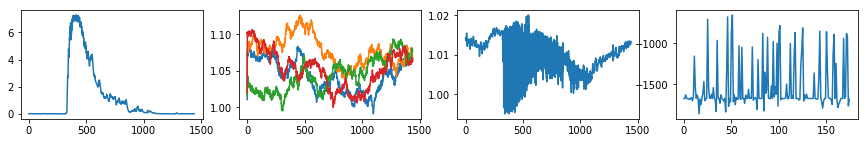

| Reward: -1732 | Episode: 175 | Qmax: -57.9804 | Action: [1.03434972 1.0309521  1.06954619 1.0596157 ]


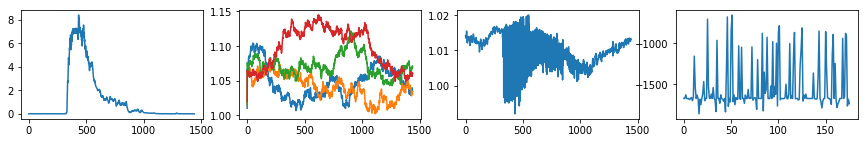

| Reward: -1671 | Episode: 176 | Qmax: -58.0598 | Action: [0.97377896 1.06459744 1.10018862 1.0527944 ]


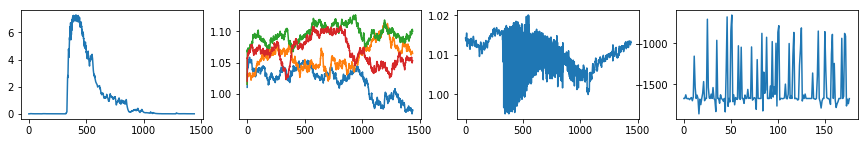

| Reward: -950 | Episode: 177 | Qmax: -58.9918 | Action: [1.03924831 1.03411792 1.06914812 1.0129247 ]


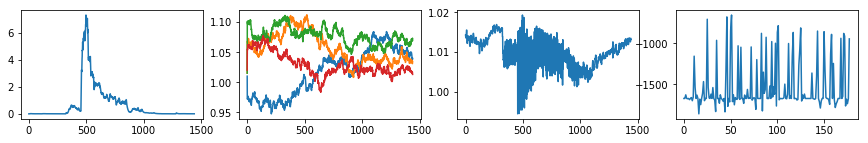

| Reward: -1669 | Episode: 178 | Qmax: -59.2406 | Action: [1.0314302  1.03654081 1.14935452 1.03589304]


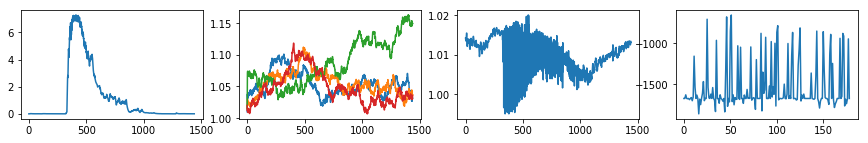

| Reward: -1720 | Episode: 179 | Qmax: -57.9097 | Action: [1.05150515 1.06049645 1.10206936 0.97850135]


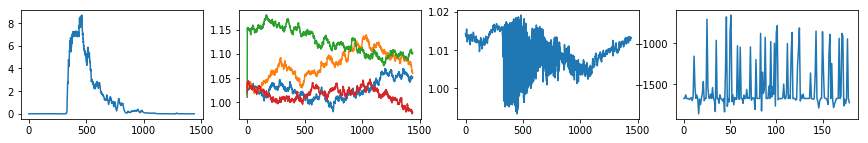

| Reward: -1669 | Episode: 180 | Qmax: -57.5187 | Action: [1.05869107 0.99430622 1.05782534 1.09133269]


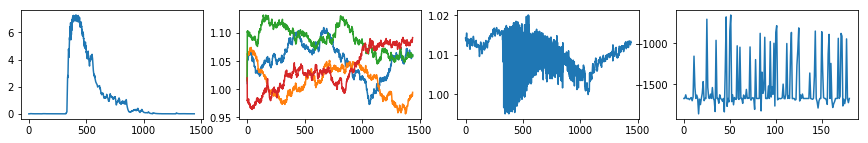

| Reward: -1291 | Episode: 181 | Qmax: -57.0668 | Action: [1.09824319 1.00981898 0.96935131 1.0721355 ]


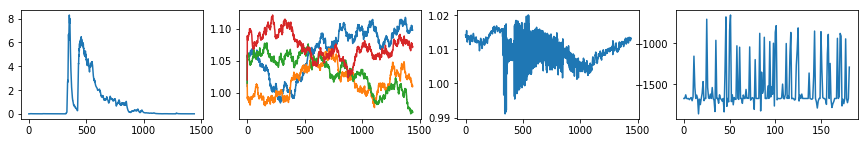

| Reward: -1535 | Episode: 182 | Qmax: -56.7960 | Action: [1.01569342 1.08501521 1.00172045 1.03296279]


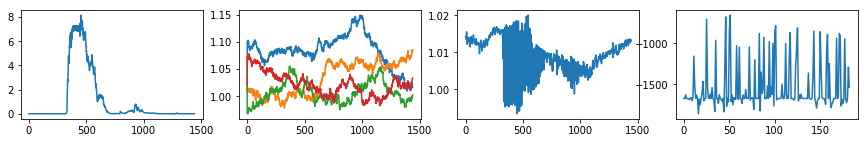

| Reward: -1027 | Episode: 183 | Qmax: -55.2106 | Action: [1.04747679 1.05665528 1.03379382 1.04312119]


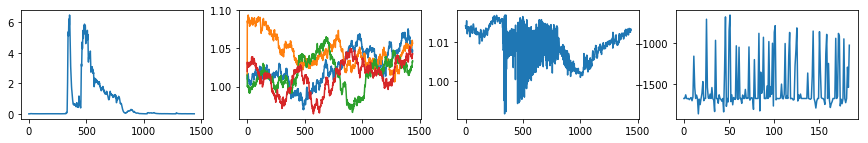

| Reward: -1065 | Episode: 184 | Qmax: -56.6891 | Action: [1.11846505 1.08986348 1.07995066 1.06275142]


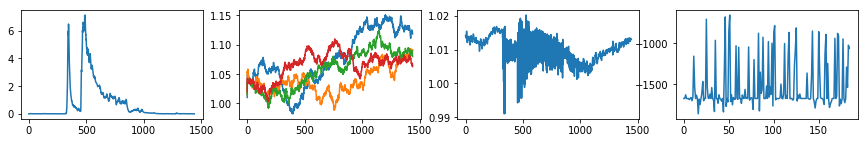

| Reward: -1671 | Episode: 185 | Qmax: -59.6341 | Action: [1.01990411 1.06075381 1.01100503 1.04994159]


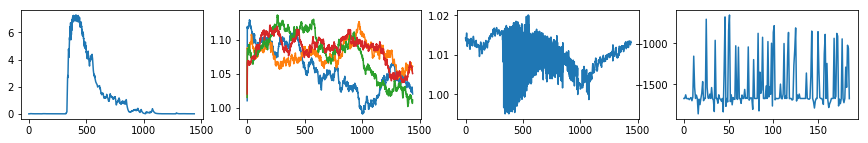

| Reward: -969 | Episode: 186 | Qmax: -61.1407 | Action: [1.06928373 1.06493624 1.11979013 1.06850838]


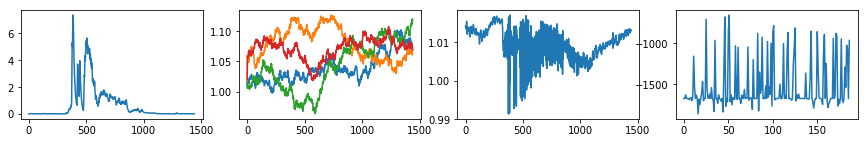

| Reward: -1511 | Episode: 187 | Qmax: -61.9452 | Action: [1.03403363 1.10215028 1.08594023 1.08095433]


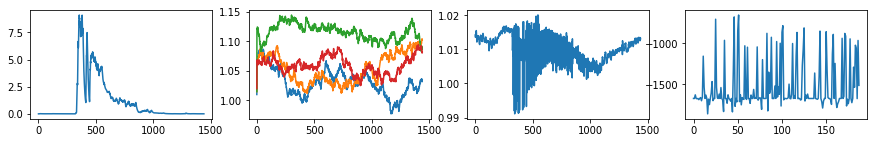

| Reward: -1666 | Episode: 188 | Qmax: -61.3236 | Action: [1.04314582 1.03937396 1.08504584 1.05927039]


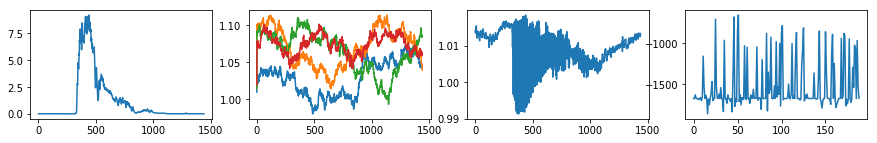

| Reward: -1756 | Episode: 189 | Qmax: -60.3195 | Action: [1.07266363 1.12398033 0.99876272 1.07553991]


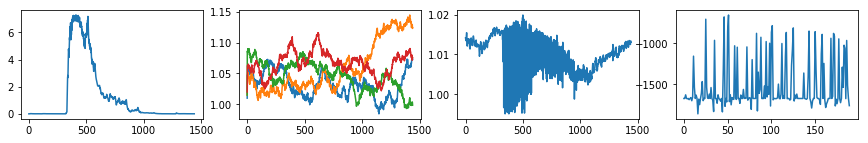

| Reward: -1017 | Episode: 190 | Qmax: -58.7243 | Action: [1.0230087  1.10891025 1.05518897 1.0528592 ]


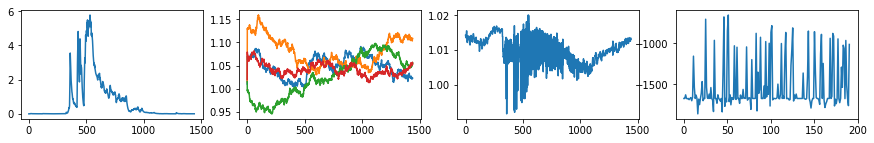

| Reward: -1676 | Episode: 191 | Qmax: -58.1366 | Action: [1.02425308 1.04368161 1.13114749 1.07813914]


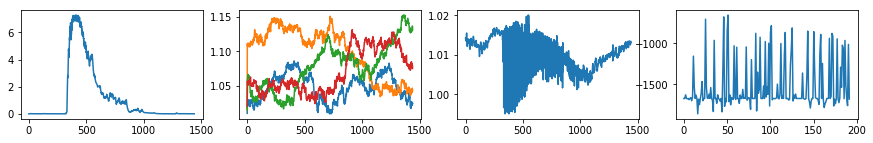

| Reward: -1669 | Episode: 192 | Qmax: -56.8368 | Action: [1.12493409 1.04492836 1.12585567 1.07025934]


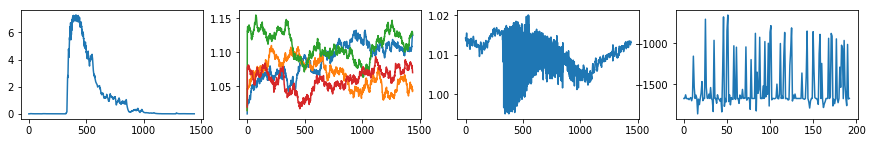

| Reward: -1304 | Episode: 193 | Qmax: -56.1521 | Action: [1.07807307 1.10518428 1.05652323 1.04494147]


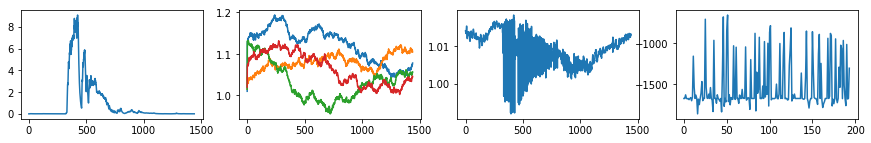

| Reward: -1692 | Episode: 194 | Qmax: -56.3203 | Action: [0.99978517 1.06263548 1.05584566 1.02784983]


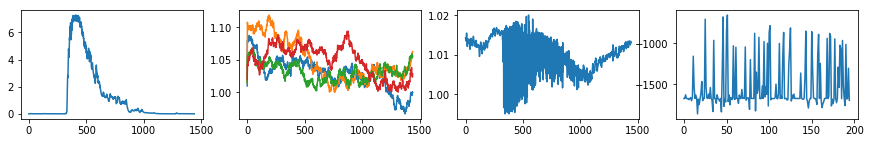

| Reward: -1732 | Episode: 195 | Qmax: -58.3878 | Action: [1.03063219 1.00243963 1.0267907  1.0276316 ]


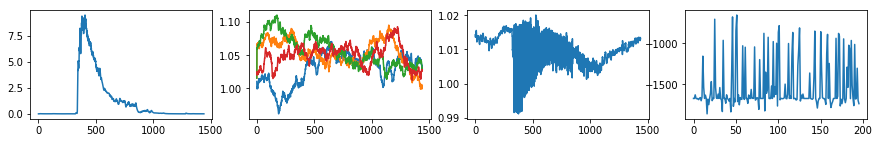

| Reward: -1669 | Episode: 196 | Qmax: -60.4777 | Action: [1.07988441 1.05877629 1.11670056 1.02031805]


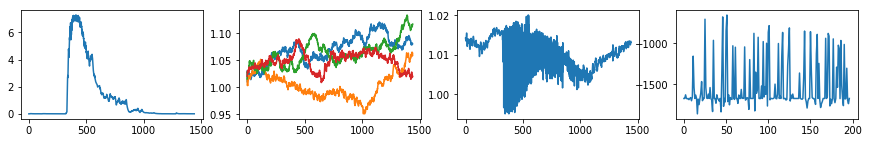

| Reward: -1669 | Episode: 197 | Qmax: -63.7026 | Action: [1.0531941  1.05641383 1.01814949 1.05068377]


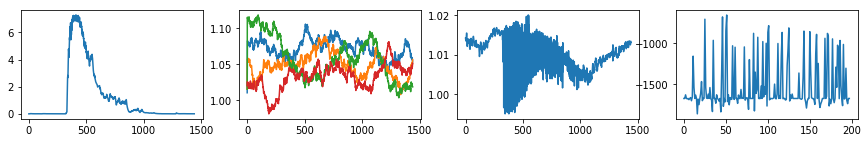

| Reward: -1833 | Episode: 198 | Qmax: -65.5997 | Action: [1.01413085 0.95525088 0.99813285 1.02926601]


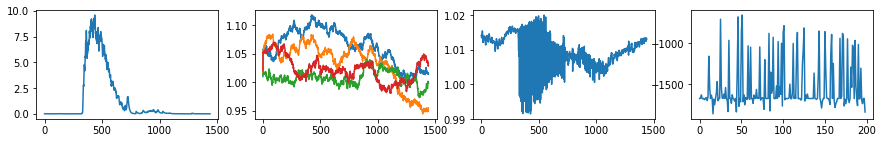

| Reward: -1722 | Episode: 199 | Qmax: -66.6458 | Action: [0.9989286  1.03728793 1.08229971 1.09952561]


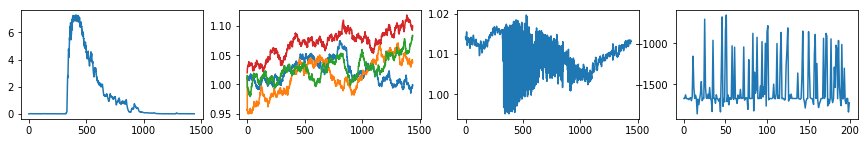

| Reward: -1727 | Episode: 200 | Qmax: -67.8324 | Action: [1.07192248 1.08518901 1.04380917 1.04583666]


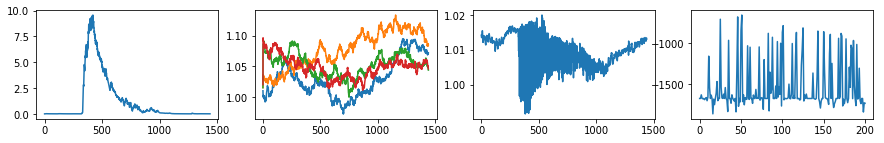

| Reward: -1669 | Episode: 201 | Qmax: -69.2110 | Action: [1.08378559 1.01336839 1.05797496 1.0481041 ]


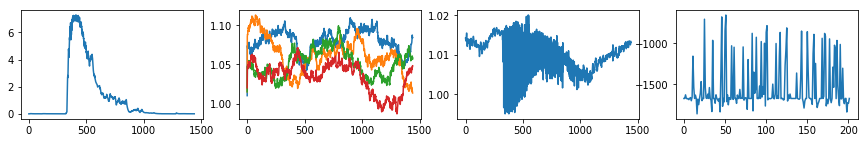

| Reward: -1627 | Episode: 202 | Qmax: -71.7124 | Action: [1.09798637 0.99866653 1.05161865 1.0262833 ]


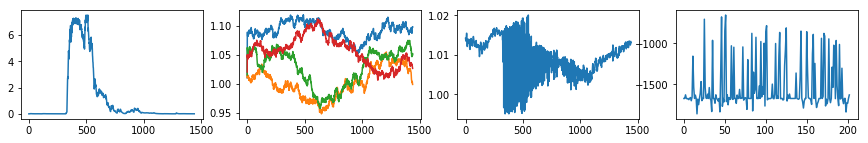

| Reward: -1669 | Episode: 203 | Qmax: -75.1285 | Action: [1.08448387 1.0099515  1.03951437 1.06327346]


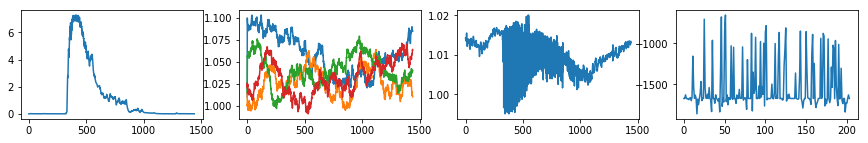

| Reward: -1669 | Episode: 204 | Qmax: -76.2838 | Action: [0.98050076 1.06217916 1.05553077 1.09157048]


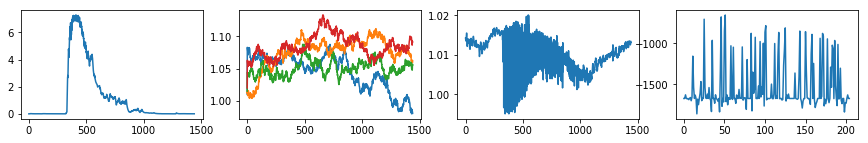

| Reward: -863 | Episode: 205 | Qmax: -75.6476 | Action: [1.03617063 1.00894483 1.10279304 1.00421669]


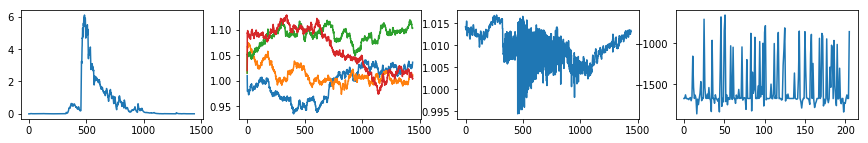

| Reward: -1669 | Episode: 206 | Qmax: -75.0157 | Action: [1.04051863 1.0440322  1.14460419 0.99172081]


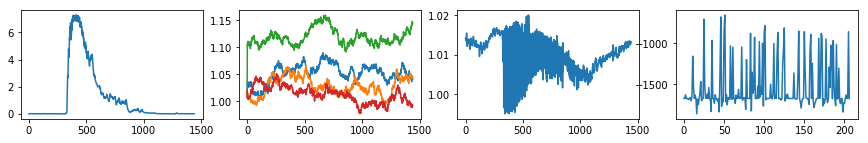

| Reward: -1669 | Episode: 207 | Qmax: -74.3946 | Action: [1.03597775 1.03311525 1.0360642  1.00942847]


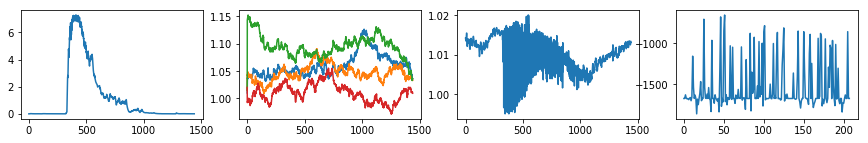

| Reward: -1770 | Episode: 208 | Qmax: -75.8392 | Action: [0.94182057 1.02883427 1.05386307 1.04801948]


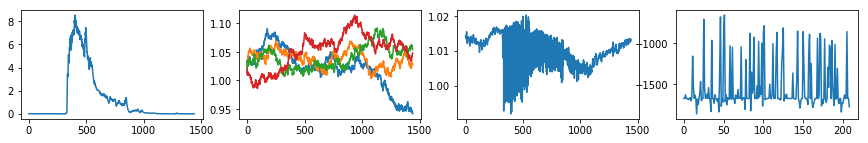

| Reward: -854 | Episode: 209 | Qmax: -78.6031 | Action: [0.98556978 1.05874598 1.01995322 1.01601354]


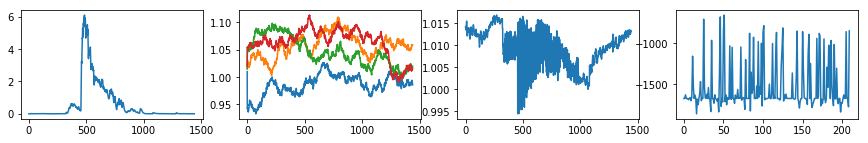

| Reward: -981 | Episode: 210 | Qmax: -81.0451 | Action: [1.09627744 1.04484281 1.12736323 1.02056358]


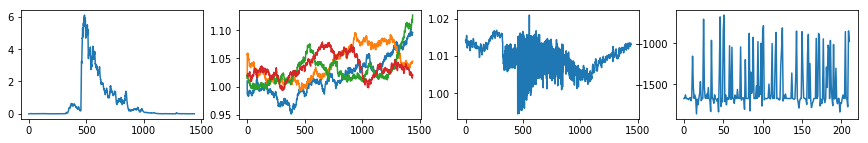

| Reward: -1634 | Episode: 211 | Qmax: -82.2442 | Action: [1.06804563 1.09078319 1.02612326 1.04841472]


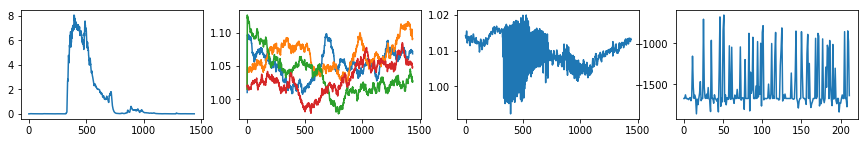

| Reward: -1669 | Episode: 212 | Qmax: -81.9973 | Action: [1.09315555 1.09734981 1.07434864 0.95387929]


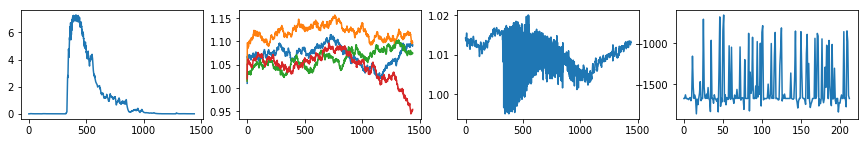

| Reward: -1669 | Episode: 213 | Qmax: -80.6661 | Action: [1.04039791 1.05783582 1.04266961 1.0841532 ]


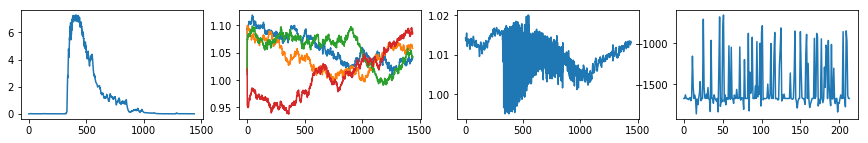

| Reward: -824 | Episode: 214 | Qmax: -79.0502 | Action: [1.03961163 1.01589288 1.01578354 1.05306073]


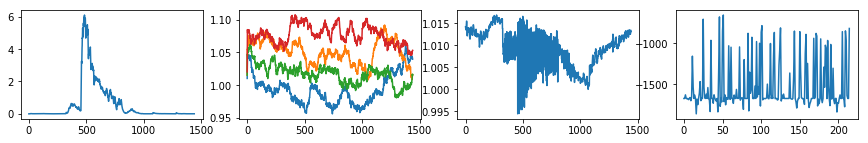

| Reward: -1681 | Episode: 215 | Qmax: -77.9060 | Action: [1.00976126 1.08304676 1.01957582 0.98784219]


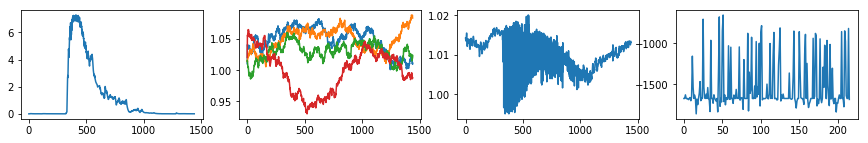

| Reward: -1669 | Episode: 216 | Qmax: -77.1307 | Action: [1.03009754 1.09109559 1.01093283 0.99803988]


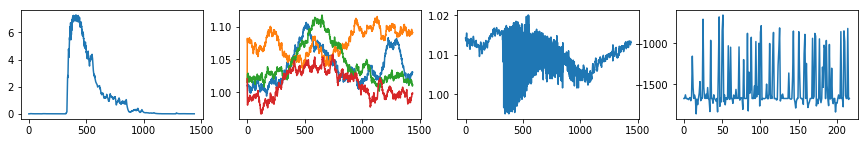

| Reward: -1182 | Episode: 217 | Qmax: -77.2464 | Action: [1.10612638 1.0690207  1.0650406  1.05222403]


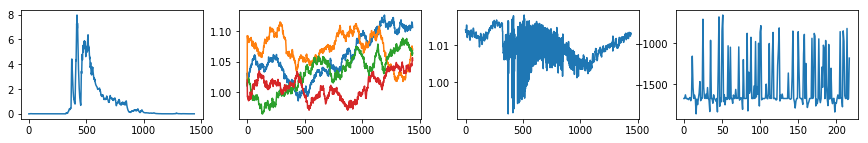

| Reward: -1669 | Episode: 218 | Qmax: -78.7968 | Action: [1.07267688 1.05890024 1.05774661 1.00882137]


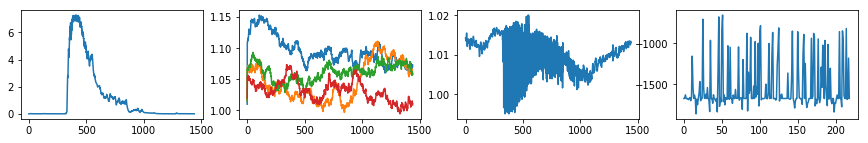

| Reward: -1669 | Episode: 219 | Qmax: -80.6450 | Action: [1.03700946 0.97236962 1.03705714 1.03717084]


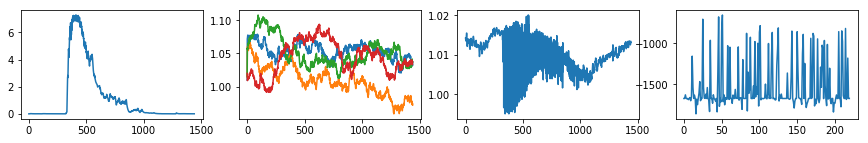

| Reward: -1805 | Episode: 220 | Qmax: -82.4781 | Action: [1.03918284 1.01224207 1.01470831 0.97502603]


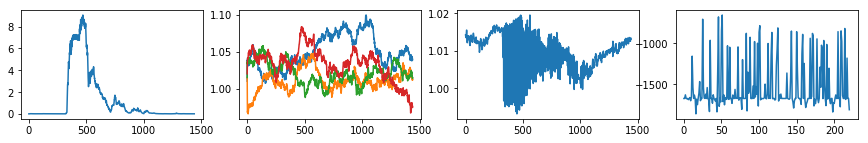

| Reward: -1667 | Episode: 221 | Qmax: -84.5083 | Action: [1.00000716 1.0967645  1.08552062 1.0893015 ]


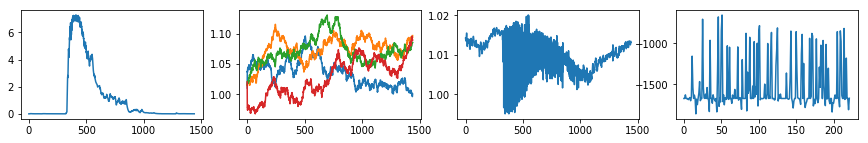

| Reward: -1798 | Episode: 222 | Qmax: -85.9006 | Action: [0.9853665  1.05807543 1.05437273 1.07417506]


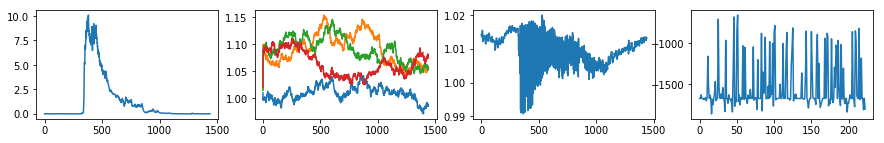

| Reward: -1807 | Episode: 223 | Qmax: -86.9367 | Action: [0.95793189 1.04369496 1.00741386 1.05234176]


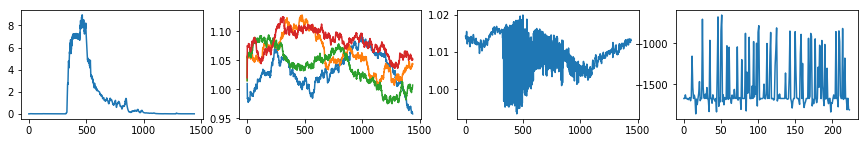

| Reward: -289 | Episode: 224 | Qmax: -87.2637 | Action: [1.08432262 1.06730466 1.06576226 1.02213298]


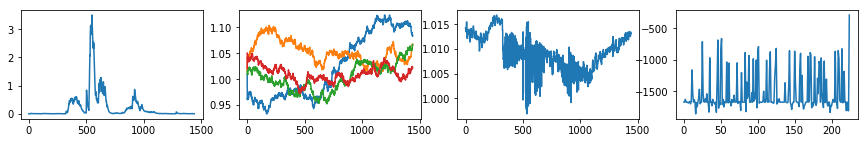

| Reward: -655 | Episode: 225 | Qmax: -87.0715 | Action: [1.05525808 1.02928634 1.05322572 1.03348966]


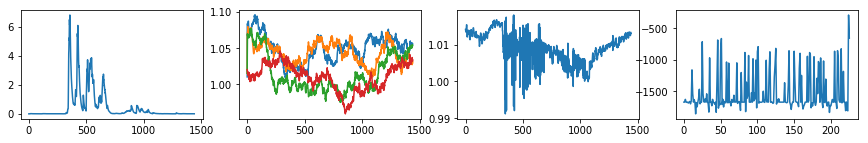

| Reward: -1675 | Episode: 226 | Qmax: -86.4483 | Action: [1.04206575 1.09834512 1.05673503 1.01283114]


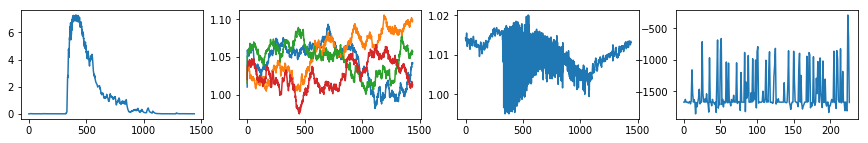

| Reward: -1638 | Episode: 227 | Qmax: -86.1892 | Action: [1.04989415 1.06309977 1.05779852 1.03429573]


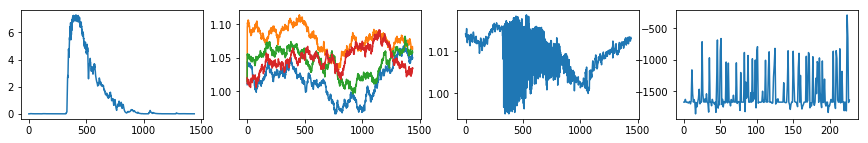

| Reward: -1669 | Episode: 228 | Qmax: -85.6346 | Action: [0.99269292 1.07278802 1.0452144  1.0078893 ]


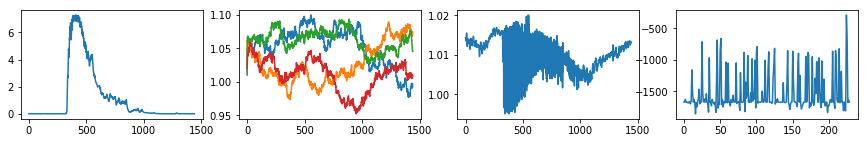

| Reward: -870 | Episode: 229 | Qmax: -85.1462 | Action: [0.94819608 1.00673647 1.07733346 1.10496243]


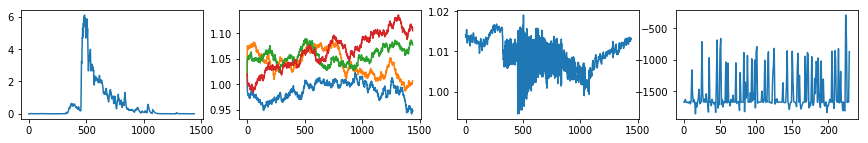

| Reward: -891 | Episode: 230 | Qmax: -84.1035 | Action: [1.03622849 1.01473943 1.08863753 1.0924171 ]


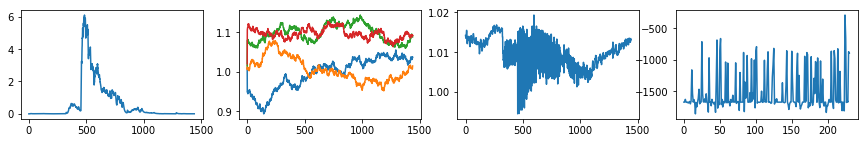

| Reward: -1580 | Episode: 231 | Qmax: -83.6468 | Action: [1.06438993 1.07658025 1.06902353 1.02685246]


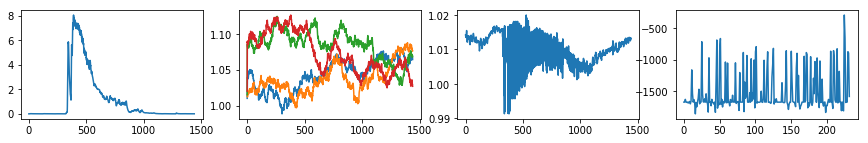

| Reward: -1675 | Episode: 232 | Qmax: -83.8901 | Action: [1.02841124 1.09900951 1.05183035 1.01137871]


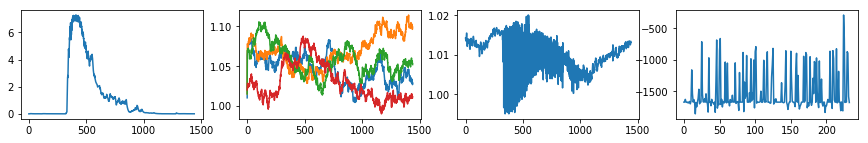

| Reward: -1089 | Episode: 233 | Qmax: -86.5911 | Action: [1.0929349  1.06343508 1.03927409 0.98861865]


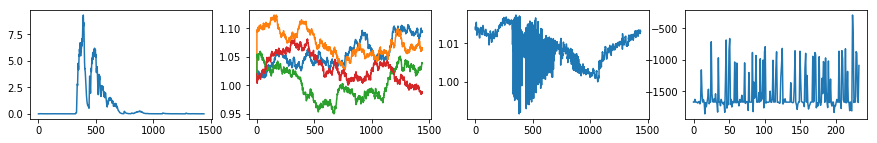

| Reward: -1402 | Episode: 234 | Qmax: -87.8108 | Action: [1.01008062 1.04416229 1.07940661 1.02386017]


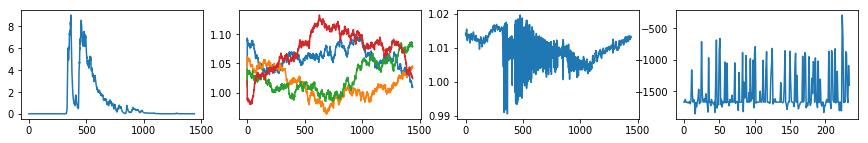

| Reward: -1752 | Episode: 235 | Qmax: -89.3541 | Action: [1.02789974 1.06634252 1.08729886 1.00319914]


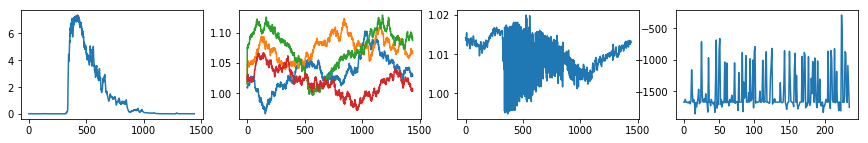

| Reward: -1783 | Episode: 236 | Qmax: -90.7417 | Action: [0.99321809 1.00879033 1.029372   1.02738013]


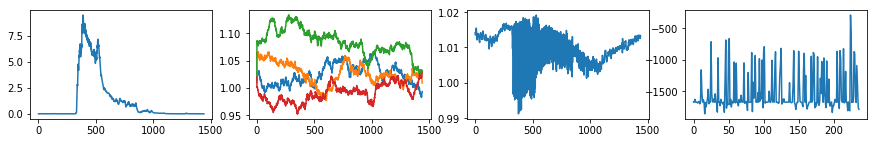

| Reward: -402 | Episode: 237 | Qmax: -91.4702 | Action: [0.97650045 1.03353858 0.9402992  1.00237595]


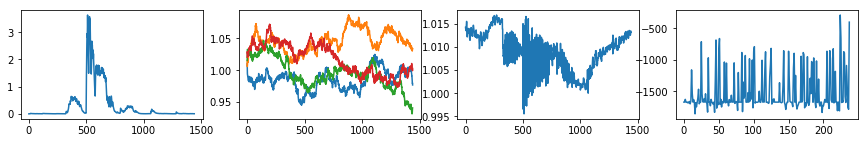

| Reward: -559 | Episode: 238 | Qmax: -93.8328 | Action: [1.08277922 1.04956619 1.06259219 1.0638724 ]


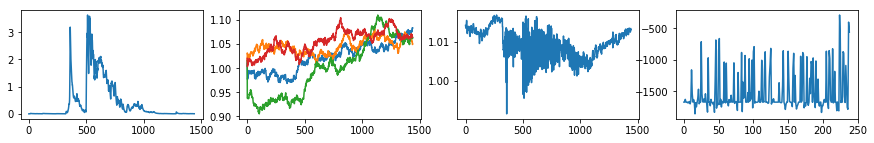

| Reward: -1686 | Episode: 239 | Qmax: -94.9234 | Action: [1.04060311 1.04202741 1.11599079 1.01186957]


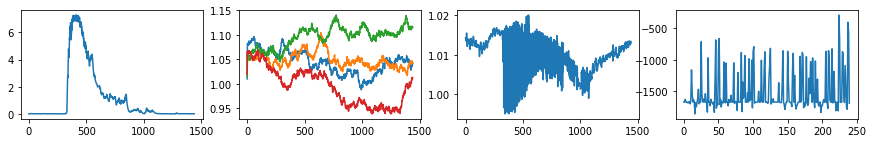

| Reward: -835 | Episode: 240 | Qmax: -95.0071 | Action: [1.03702831 1.05715994 1.07046206 1.02481702]


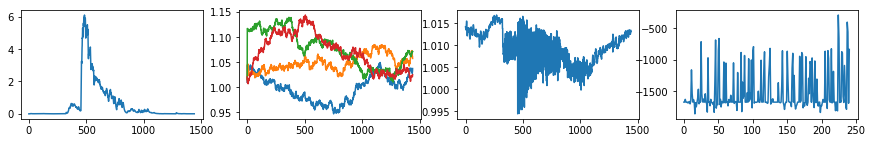

| Reward: -1544 | Episode: 241 | Qmax: -95.6642 | Action: [1.10943102 1.0298074  0.96257649 0.9989341 ]


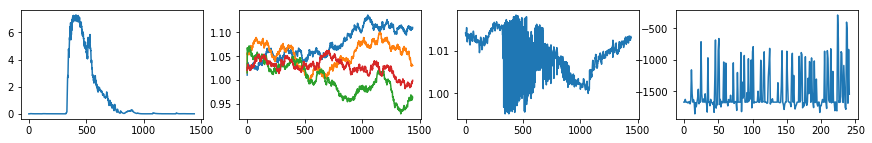

| Reward: -1684 | Episode: 242 | Qmax: -95.5560 | Action: [1.10071835 1.10125411 1.05699574 1.03885406]


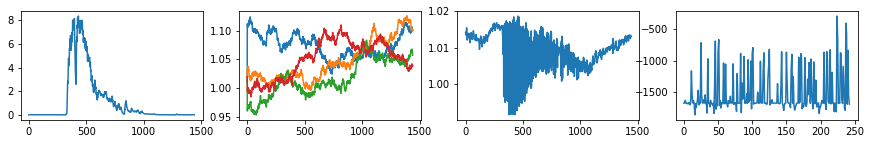

| Reward: -1673 | Episode: 243 | Qmax: -96.0311 | Action: [1.09198828 1.01393286 0.96755487 1.06796346]


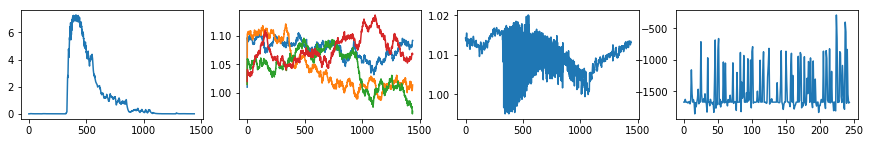

| Reward: -801 | Episode: 244 | Qmax: -97.0994 | Action: [1.02221276 1.00992314 1.02341558 1.00709468]


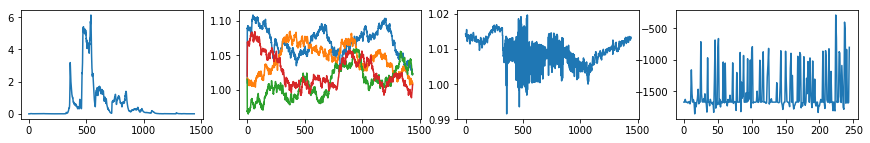

| Reward: -1669 | Episode: 245 | Qmax: -97.5128 | Action: [1.0520077  1.09120793 1.11116987 1.0505406 ]


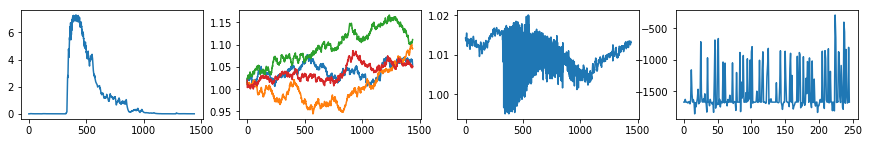

| Reward: -1669 | Episode: 246 | Qmax: -99.1880 | Action: [0.94406987 1.09165029 1.11830239 1.050559  ]


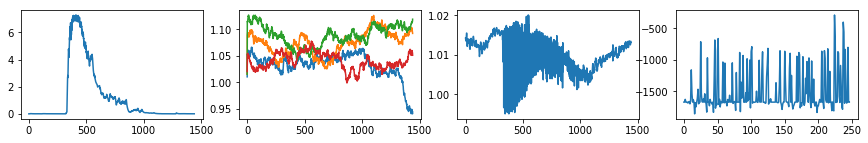

| Reward: -841 | Episode: 247 | Qmax: -100.9980 | Action: [1.00770563 1.02577791 1.06097386 1.07608117]


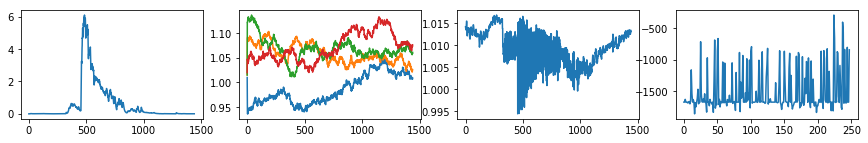

| Reward: -1841 | Episode: 248 | Qmax: -103.5372 | Action: [0.97973347 1.03500086 0.99792437 1.04573499]


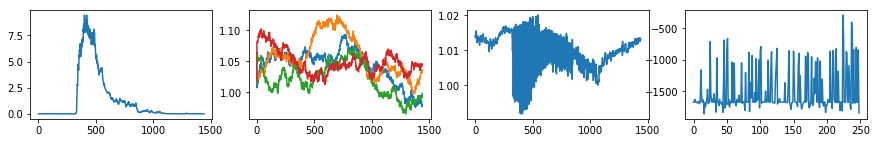

| Reward: -1669 | Episode: 249 | Qmax: -106.0541 | Action: [1.08791782 1.05415827 1.00068083 1.0840015 ]


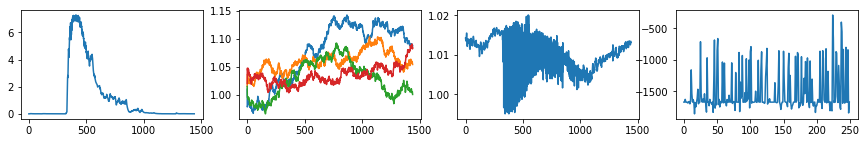

| Reward: -1620 | Episode: 250 | Qmax: -107.2415 | Action: [1.0164592  1.0173969  0.99       1.04050883]


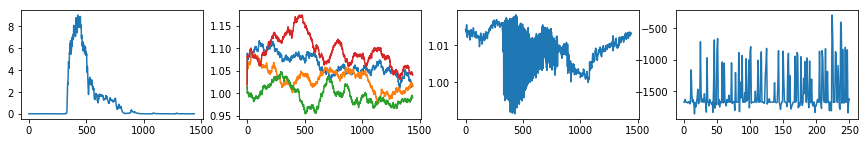

| Reward: -1625 | Episode: 251 | Qmax: -107.5155 | Action: [0.98800218 1.07323479 1.04078365 0.95961648]


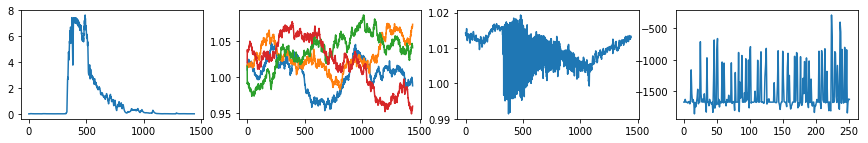

| Reward: -309 | Episode: 252 | Qmax: -108.3105 | Action: [1.01710966 1.04691287 1.0933496  1.06516636]


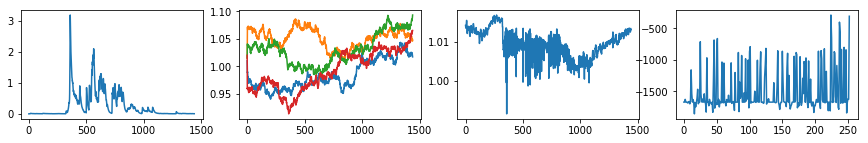

| Reward: -1739 | Episode: 253 | Qmax: -108.6683 | Action: [1.03797235 1.09106369 1.08507397 1.09496261]


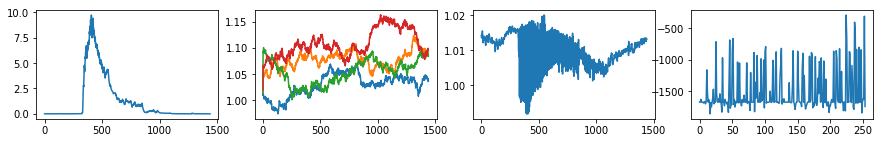

| Reward: -976 | Episode: 254 | Qmax: -107.4742 | Action: [1.0708287  1.06465463 1.02405586 0.981949  ]


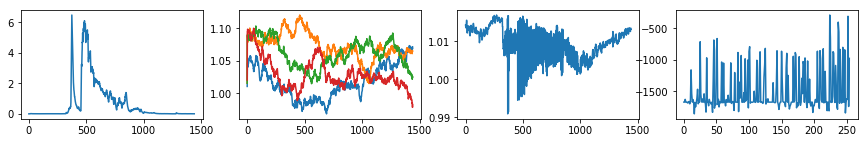

| Reward: -1691 | Episode: 255 | Qmax: -107.0044 | Action: [1.0130259  1.07304032 1.05005144 1.01437434]


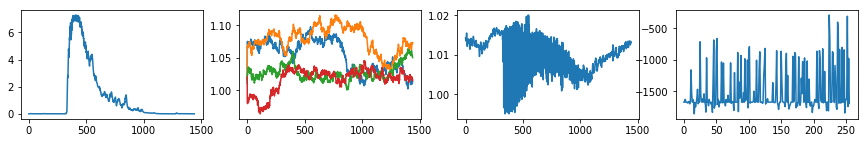

| Reward: -1669 | Episode: 256 | Qmax: -107.9450 | Action: [1.02585564 0.99206605 1.01730264 1.01226336]


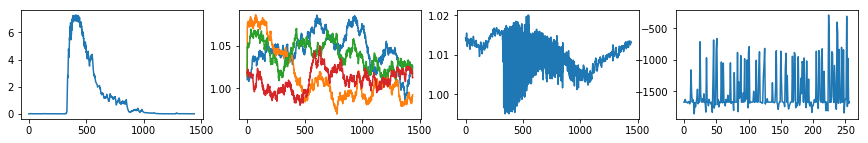

| Reward: -1344 | Episode: 257 | Qmax: -106.9421 | Action: [0.98723064 1.0192281  1.00717391 1.03809434]


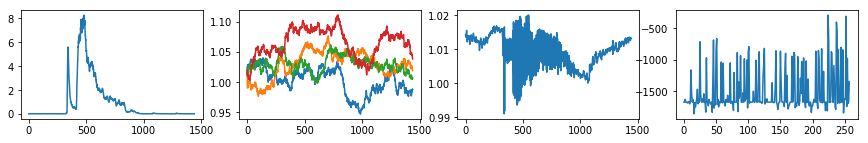

| Reward: -1669 | Episode: 258 | Qmax: -106.6292 | Action: [1.0377003  1.02384083 1.09236773 0.97898628]


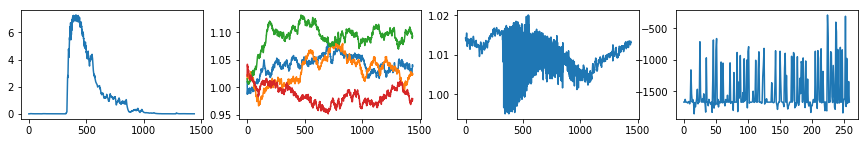

| Reward: -974 | Episode: 259 | Qmax: -108.1035 | Action: [0.97676535 1.03358716 1.04609996 0.9950156 ]


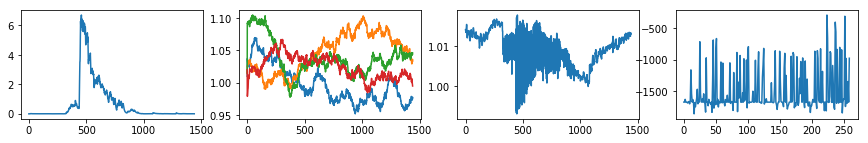

| Reward: -1759 | Episode: 260 | Qmax: -109.1361 | Action: [1.05468034 1.10404284 1.04800822 0.98384655]


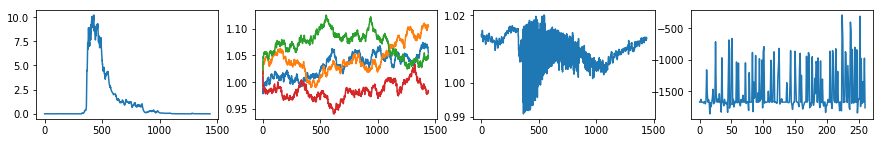

| Reward: -1699 | Episode: 261 | Qmax: -109.0084 | Action: [1.00471481 1.12571065 1.05909335 1.05848638]


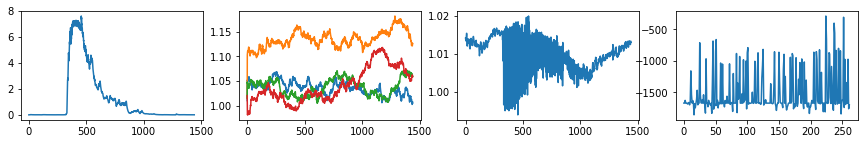

| Reward: -1725 | Episode: 262 | Qmax: -106.6390 | Action: [1.06544666 1.11228847 1.10210559 1.07163469]


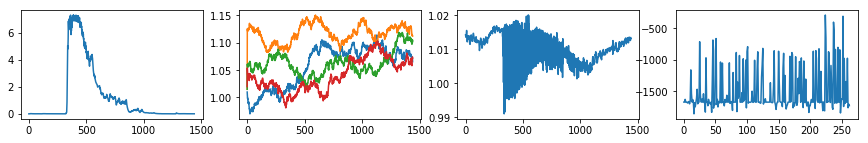

| Reward: -1728 | Episode: 263 | Qmax: -107.0172 | Action: [1.03226398 1.0731058  1.07143652 1.03518646]


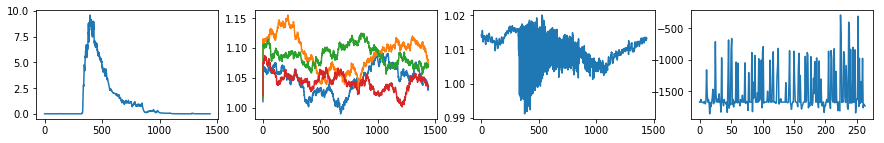

| Reward: -1063 | Episode: 264 | Qmax: -107.8100 | Action: [1.07828039 1.07072054 1.10499321 1.08322429]


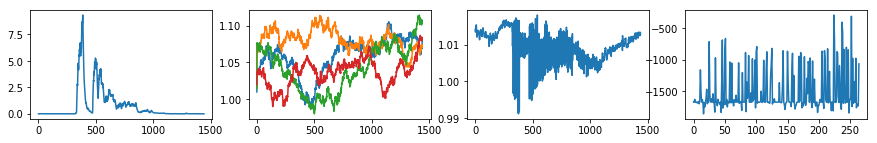

| Reward: -1669 | Episode: 265 | Qmax: -108.6646 | Action: [1.00526745 1.0965399  1.01058481 0.98006226]


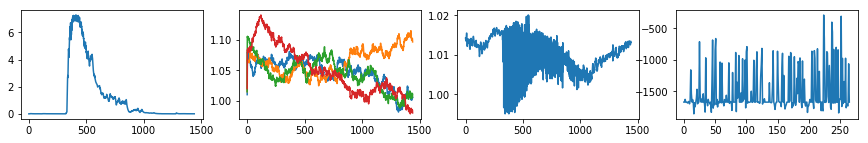

| Reward: -947 | Episode: 266 | Qmax: -109.9215 | Action: [1.02608528 1.04417015 1.02053626 1.0389486 ]


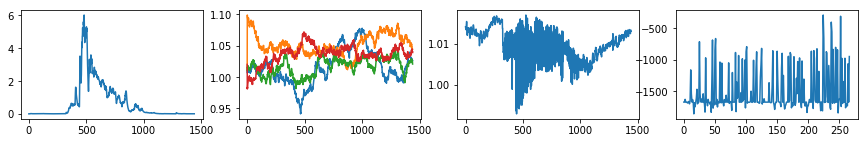

| Reward: -1709 | Episode: 267 | Qmax: -111.4471 | Action: [1.06803672 0.99709905 1.10452259 1.00849811]


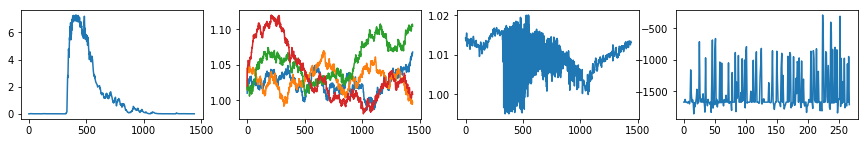

| Reward: -1669 | Episode: 268 | Qmax: -111.8599 | Action: [1.06394638 1.04781624 1.08613481 1.01376706]


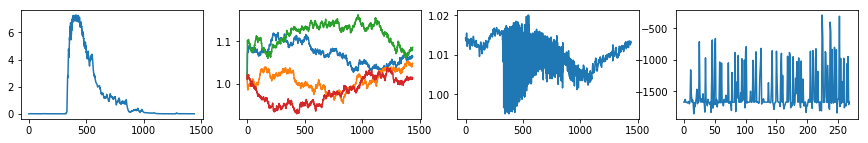

| Reward: -1648 | Episode: 269 | Qmax: -110.9918 | Action: [1.00141153 1.02008977 1.0111854  1.07640248]


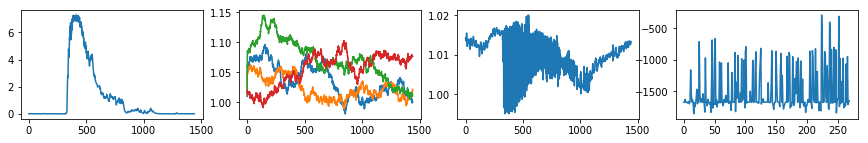

| Reward: -1540 | Episode: 270 | Qmax: -110.0472 | Action: [0.99118639 1.02667158 0.98358981 1.03368523]


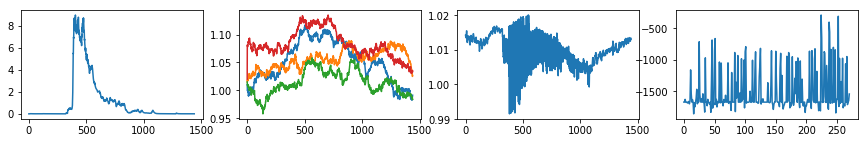

| Reward: -1669 | Episode: 271 | Qmax: -110.2188 | Action: [1.09553428 1.09401633 1.03567589 1.02611494]


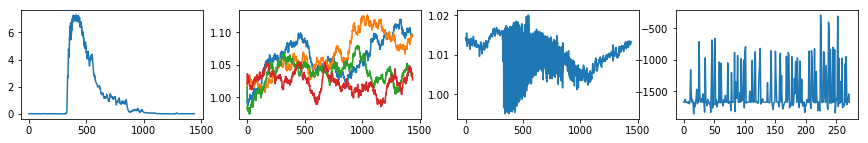

| Reward: -1660 | Episode: 272 | Qmax: -112.5815 | Action: [1.04657711 1.07381378 1.01489958 1.04472371]


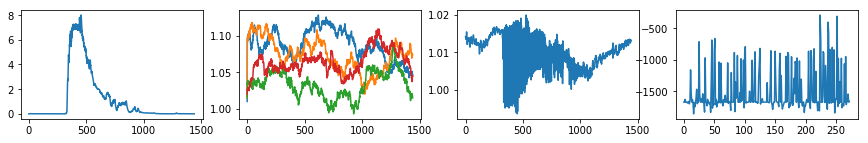

| Reward: -1669 | Episode: 273 | Qmax: -113.9395 | Action: [1.05908669 1.03019286 1.02212431 1.04126845]


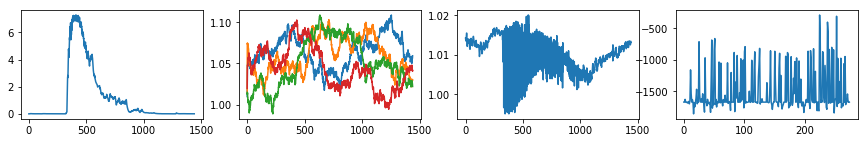

| Reward: -1694 | Episode: 274 | Qmax: -114.8313 | Action: [1.00039067 1.09834532 1.0371972  1.06081421]


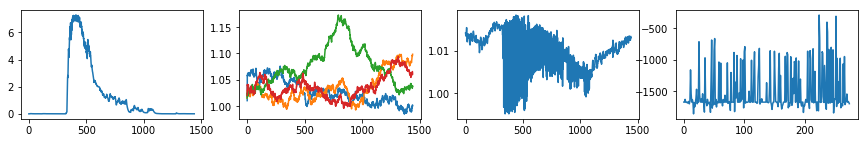

| Reward: -1718 | Episode: 275 | Qmax: -116.7029 | Action: [0.99165215 1.08004807 1.05672551 1.08725496]


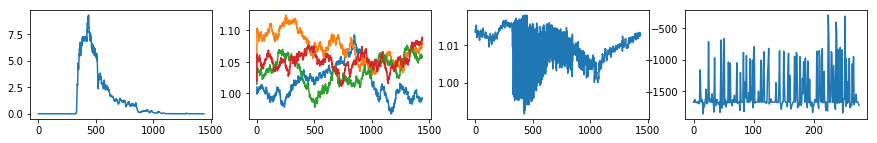

| Reward: -1669 | Episode: 276 | Qmax: -117.1268 | Action: [1.0537844  1.05795647 1.05627777 1.0055769 ]


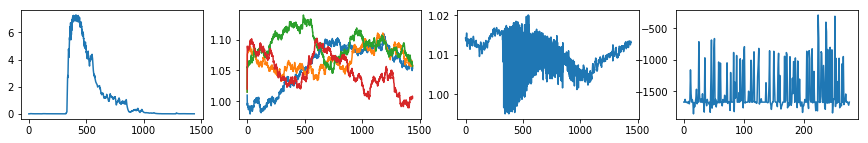

| Reward: -1743 | Episode: 277 | Qmax: -116.9874 | Action: [1.08681044 1.10144018 1.02284672 1.04851539]


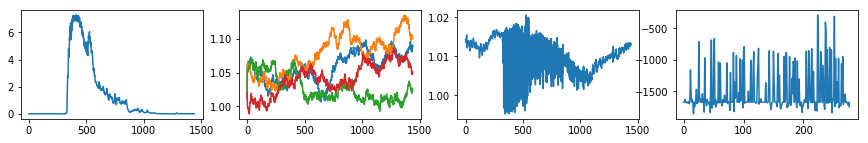

| Reward: -1688 | Episode: 278 | Qmax: -118.3845 | Action: [1.03686847 1.07214696 1.02208081 1.08600521]


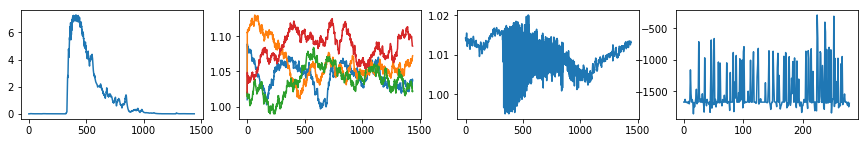

| Reward: -1857 | Episode: 279 | Qmax: -119.8599 | Action: [1.09275245 0.99084968 1.07693413 1.07696671]


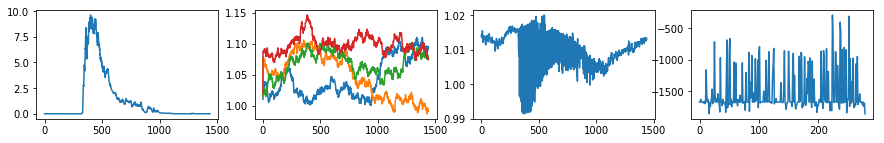

| Reward: -1669 | Episode: 280 | Qmax: -119.9870 | Action: [1.03842472 1.09979192 1.06223386 1.03131173]


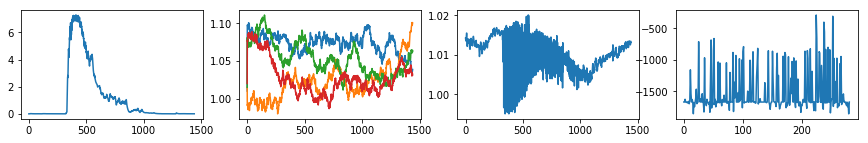

| Reward: -1746 | Episode: 281 | Qmax: -120.2880 | Action: [1.02082979 1.0416551  1.12793425 1.00884677]


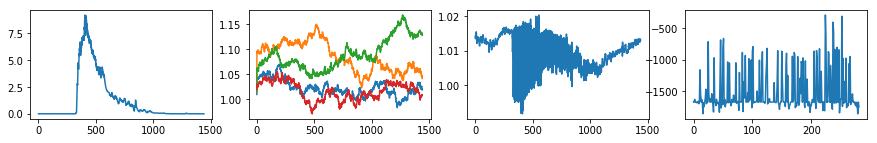

| Reward: -1669 | Episode: 282 | Qmax: -120.1176 | Action: [1.08213627 1.03959433 1.15067717 1.02283027]


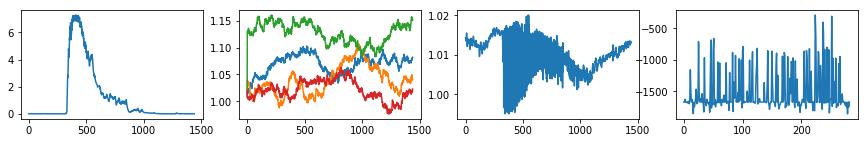

| Reward: -1669 | Episode: 283 | Qmax: -119.6836 | Action: [1.02255589 1.05707246 1.09467793 1.03867801]


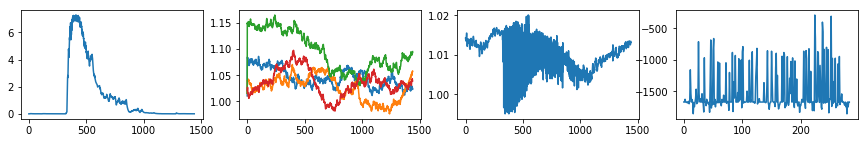

| Reward: -1667 | Episode: 284 | Qmax: -119.1327 | Action: [1.04717446 1.0360508  1.03796053 1.06362997]


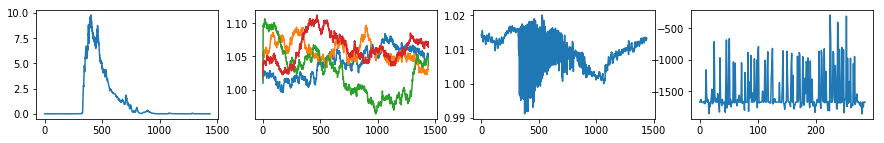

| Reward: -1778 | Episode: 285 | Qmax: -118.7537 | Action: [1.07828544 1.02819243 1.10685948 1.03418753]


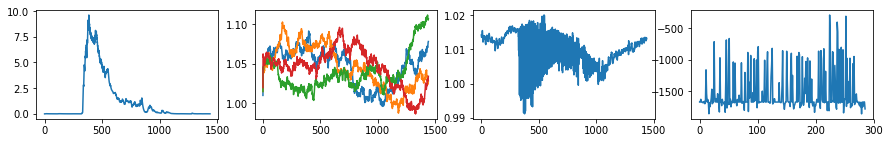

| Reward: -1669 | Episode: 286 | Qmax: -117.9140 | Action: [1.08317048 1.02059482 1.03025753 1.01131637]


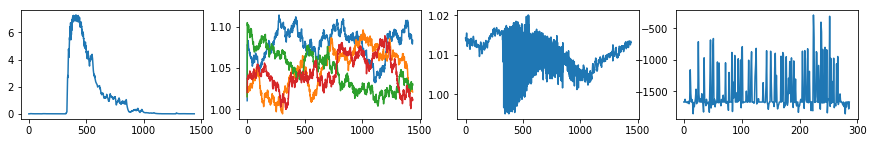

| Reward: -1631 | Episode: 287 | Qmax: -117.7412 | Action: [1.05232561 1.02914653 1.04369803 1.08205201]


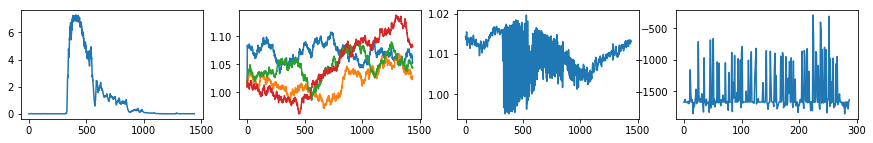

| Reward: -1655 | Episode: 288 | Qmax: -117.4158 | Action: [0.96995432 1.02836558 1.02746802 1.06367396]


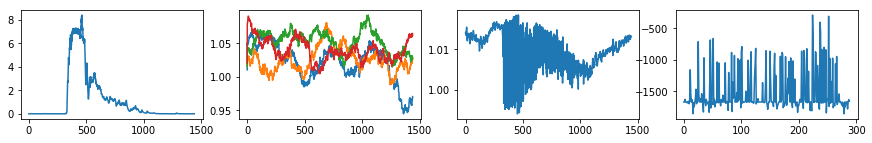

| Reward: -1672 | Episode: 289 | Qmax: -118.7832 | Action: [1.07645815 0.98117334 1.07987171 1.06224487]


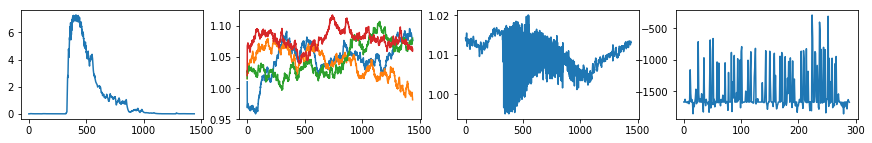

| Reward: -1696 | Episode: 290 | Qmax: -121.0017 | Action: [1.07262732 1.0042619  1.07020543 1.04862984]


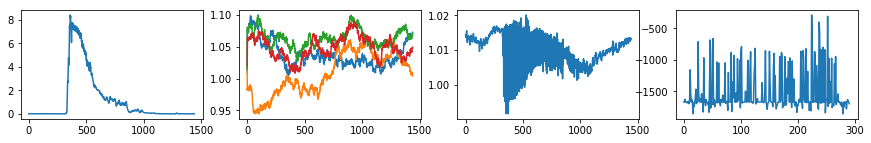

| Reward: -1669 | Episode: 291 | Qmax: -122.3346 | Action: [1.04809102 1.08226498 1.07131083 1.02792964]


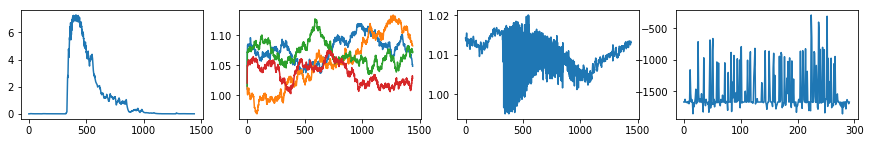

| Reward: -1669 | Episode: 292 | Qmax: -124.7247 | Action: [1.13884391 1.10610123 1.02516912 1.04151168]


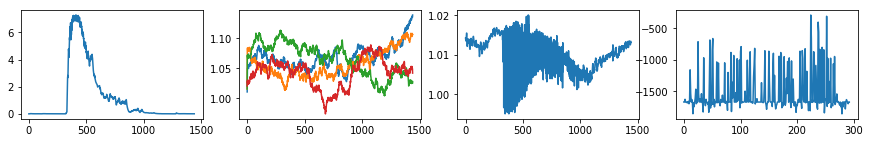

| Reward: -1669 | Episode: 293 | Qmax: -125.8822 | Action: [1.0697138  1.03996725 0.99543462 1.00372905]


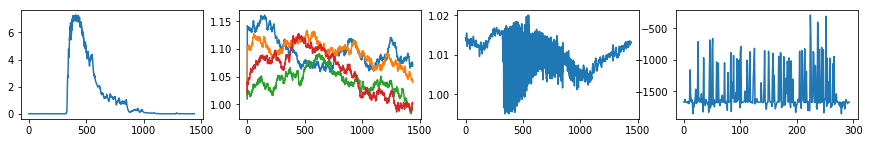

| Reward: -1669 | Episode: 294 | Qmax: -124.6448 | Action: [1.02665479 1.09185036 1.03916895 1.02906234]


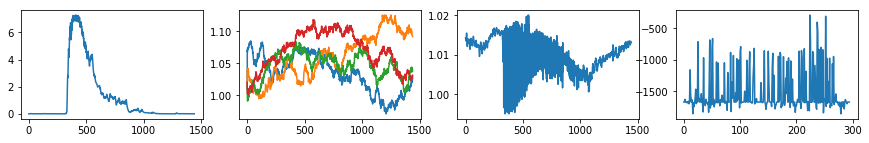

| Reward: -1669 | Episode: 295 | Qmax: -124.0023 | Action: [1.08073741 1.02843233 1.02536696 1.07328832]


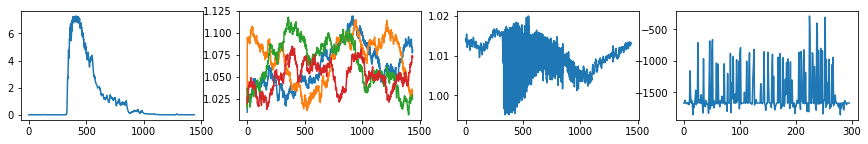

| Reward: -1862 | Episode: 296 | Qmax: -124.0061 | Action: [1.05080025 1.10575717 1.01685566 1.02345154]


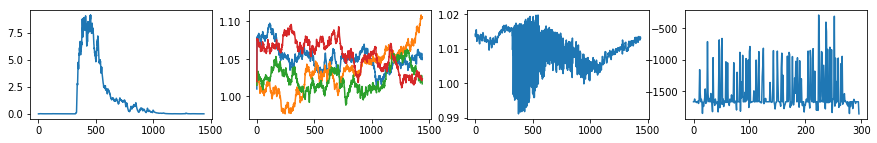

| Reward: -1637 | Episode: 297 | Qmax: -124.1384 | Action: [1.06776314 1.0868636  1.00042944 1.07323902]


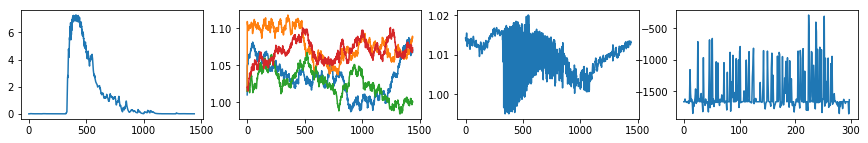

| Reward: -567 | Episode: 298 | Qmax: -123.8456 | Action: [1.11258682 1.01304984 1.07158251 1.04556774]


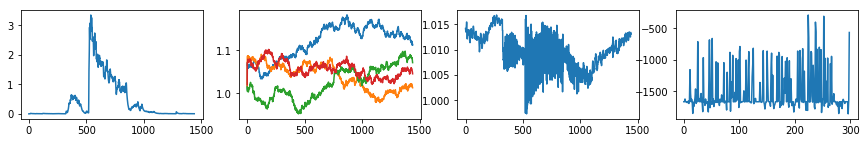

| Reward: -1664 | Episode: 299 | Qmax: -123.2700 | Action: [1.05080044 1.00519349 1.14927022 1.04402256]


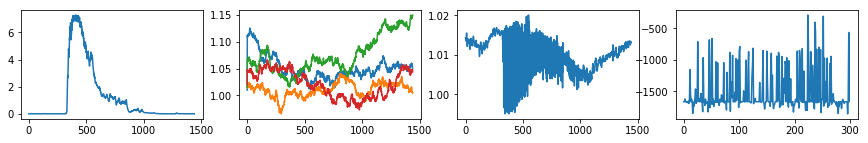

| Reward: -1669 | Episode: 300 | Qmax: -121.8768 | Action: [1.12598146 1.05621521 1.05856765 1.06116596]


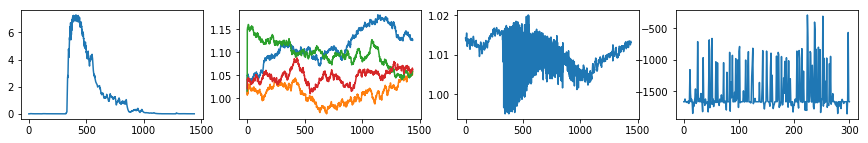

| Reward: -1669 | Episode: 301 | Qmax: -120.4027 | Action: [1.06977046 1.05608405 1.07350817 1.02828192]


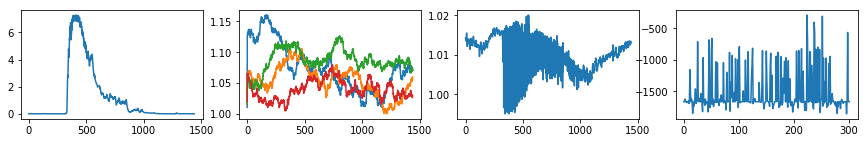

| Reward: -1681 | Episode: 302 | Qmax: -120.1392 | Action: [0.98338536 1.14734502 1.10699951 1.11231236]


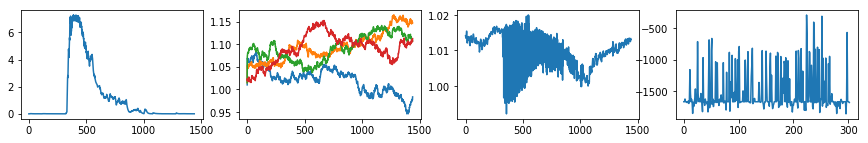

| Reward: -863 | Episode: 303 | Qmax: -119.3609 | Action: [1.02672768 1.01497515 1.06927449 1.08449166]


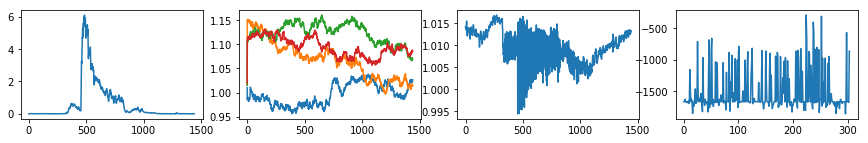

| Reward: -1621 | Episode: 304 | Qmax: -118.4528 | Action: [1.03849246 1.06298609 1.0618112  0.97805451]


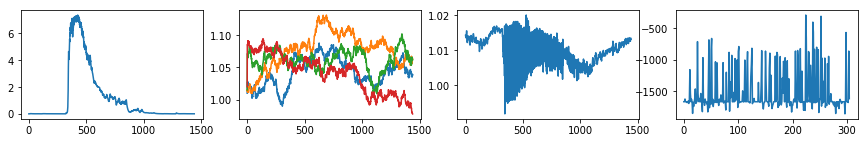

| Reward: -1669 | Episode: 305 | Qmax: -118.3846 | Action: [1.06548839 0.98197591 1.04640651 0.99269407]


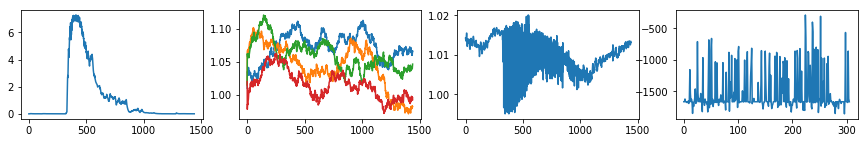

| Reward: -1638 | Episode: 306 | Qmax: -119.2695 | Action: [1.03952321 1.0444532  0.99422521 1.07365462]


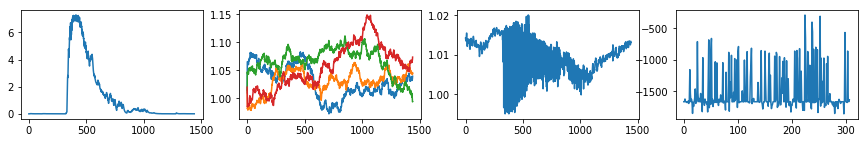

| Reward: -1669 | Episode: 307 | Qmax: -120.0677 | Action: [1.08506292 1.08155587 1.07267476 1.09615921]


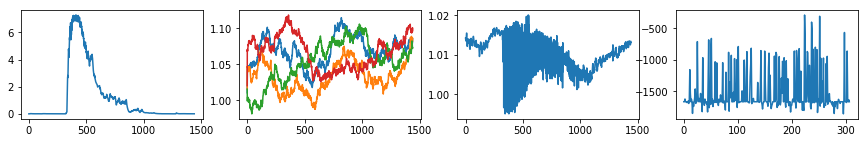

| Reward: -1684 | Episode: 308 | Qmax: -121.1708 | Action: [1.01932781 1.09434969 1.07041438 1.06407339]


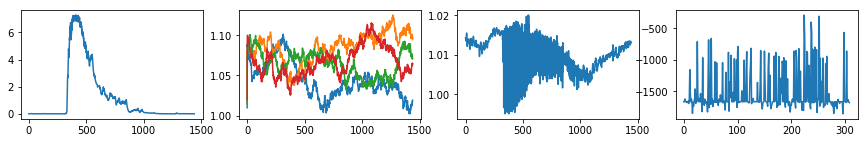

| Reward: -1669 | Episode: 309 | Qmax: -122.9331 | Action: [1.05207851 1.07253582 1.07626855 1.08087039]


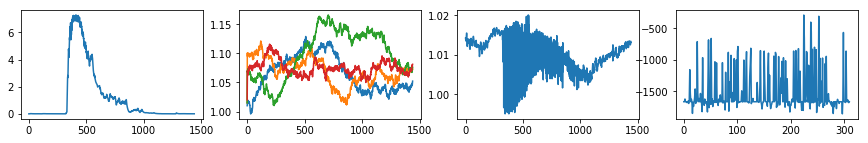

| Reward: -1669 | Episode: 310 | Qmax: -124.0223 | Action: [1.07611878 0.96551399 1.11317783 1.082892  ]


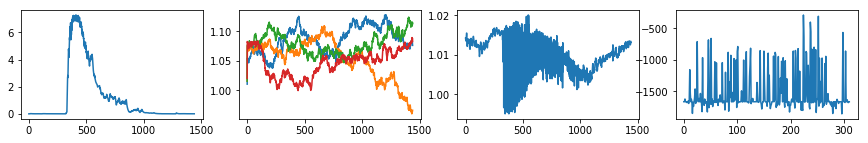

| Reward: -1791 | Episode: 311 | Qmax: -124.6961 | Action: [1.05694298 1.13261109 1.08822138 0.98857817]


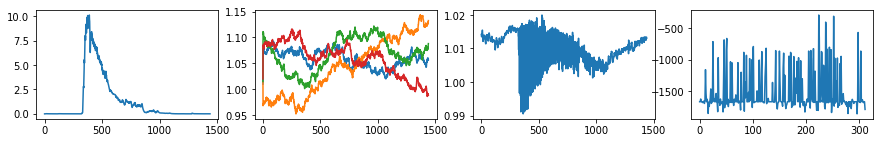

| Reward: -1677 | Episode: 312 | Qmax: -127.0205 | Action: [1.01496715 1.01342546 1.06153564 1.1131621 ]


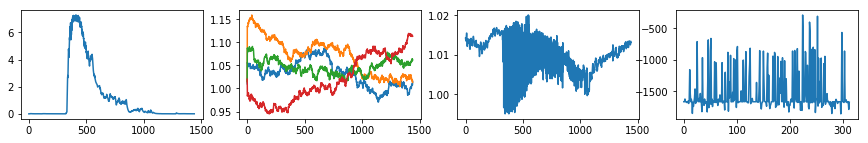

| Reward: -1673 | Episode: 313 | Qmax: -127.6290 | Action: [0.99246116 1.0699392  1.02515482 1.05473324]


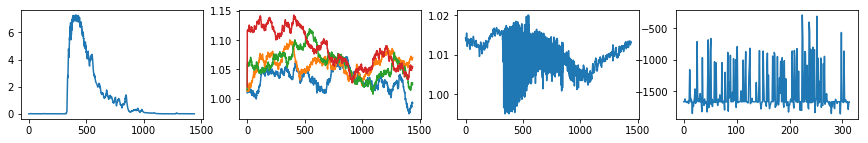

| Reward: -1778 | Episode: 314 | Qmax: -127.9529 | Action: [1.03981284 1.02628394 1.07183125 0.97375744]


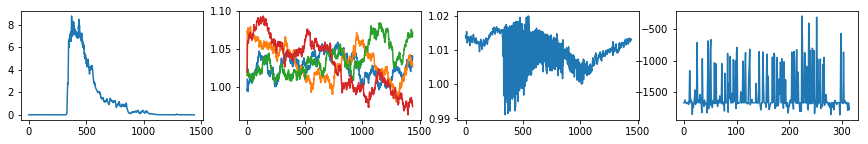

| Reward: -897 | Episode: 315 | Qmax: -128.8301 | Action: [1.06242612 1.06813899 1.08527895 1.02064089]


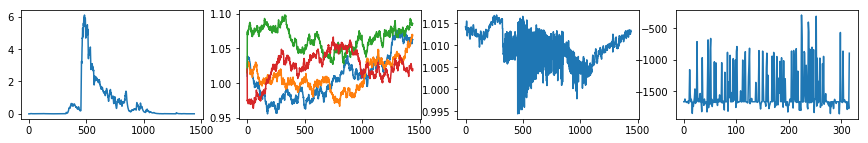

| Reward: -1669 | Episode: 316 | Qmax: -129.3793 | Action: [1.07774367 1.07636127 1.05393556 1.10931257]


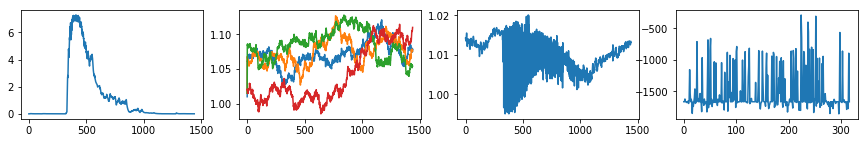

| Reward: -1674 | Episode: 317 | Qmax: -128.3472 | Action: [1.0607355  1.02513884 1.15993547 1.09990279]


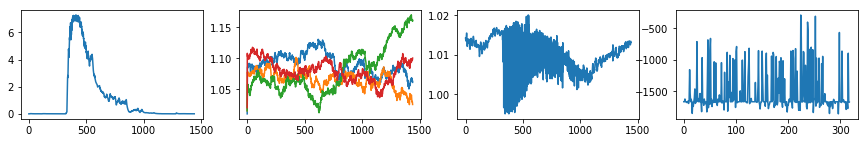

| Reward: -1646 | Episode: 318 | Qmax: -128.3984 | Action: [1.03721121 1.08066142 1.05742623 1.07238481]


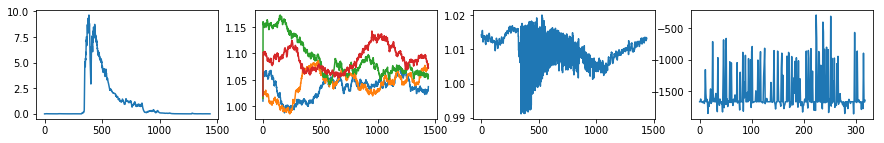

| Reward: -1681 | Episode: 319 | Qmax: -129.9868 | Action: [1.06264653 1.06968771 1.09786727 1.05362594]


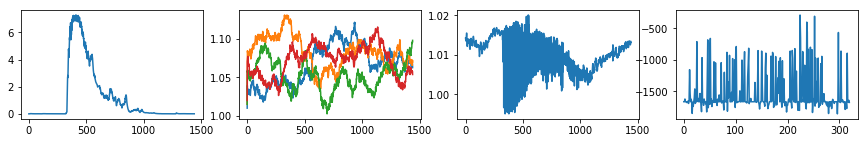

| Reward: -1669 | Episode: 320 | Qmax: -131.0283 | Action: [1.07810258 1.0514608  1.03875495 1.0796575 ]


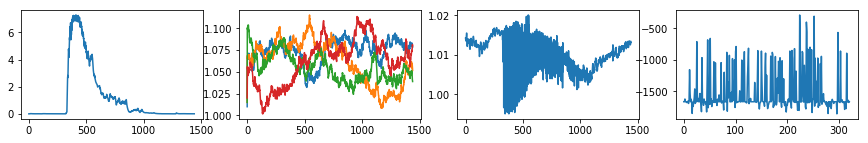

| Reward: -1669 | Episode: 321 | Qmax: -131.6176 | Action: [1.06109997 1.02477182 1.04096137 1.13995078]


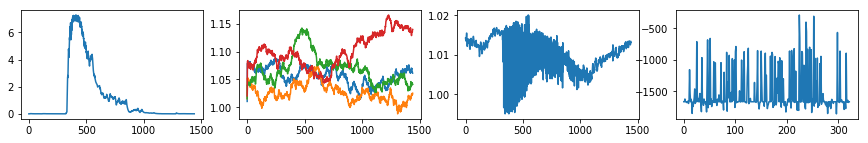

| Reward: -1706 | Episode: 322 | Qmax: -131.6315 | Action: [1.05538034 0.99434282 1.0468589  1.03203547]


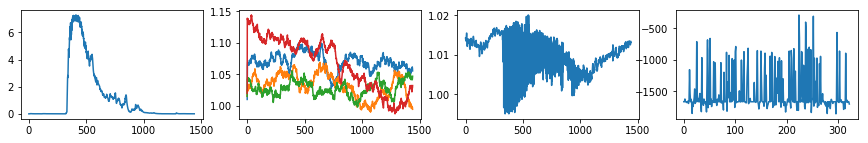

| Reward: -1669 | Episode: 323 | Qmax: -131.2751 | Action: [1.10825527 1.06114385 1.02922758 1.00159451]


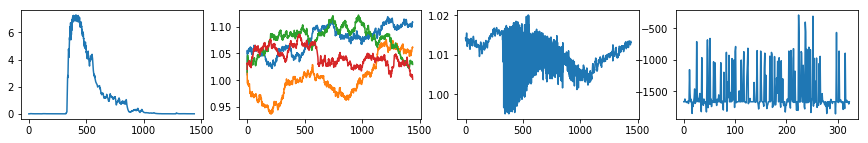

| Reward: -1653 | Episode: 324 | Qmax: -132.2864 | Action: [1.03024016 1.02811923 1.02878526 1.03996101]


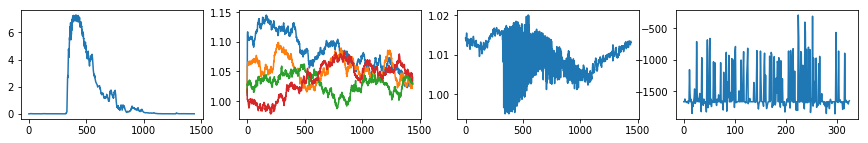

| Reward: -1084 | Episode: 325 | Qmax: -132.5166 | Action: [1.0927384  1.03962054 1.02422956 1.00286444]


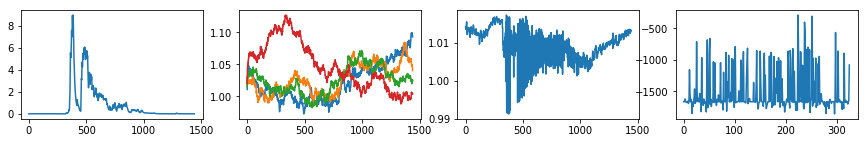

| Reward: -1669 | Episode: 326 | Qmax: -132.4658 | Action: [1.0284384  0.93590325 1.05446942 1.04527869]


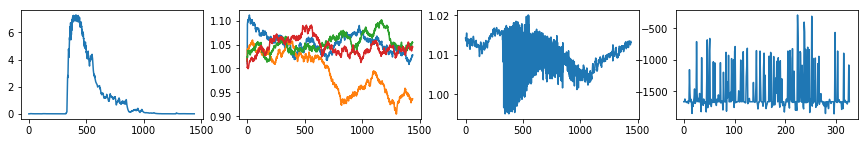

| Reward: -960 | Episode: 327 | Qmax: -132.6886 | Action: [1.06165126 1.02591803 1.05832756 1.05233139]


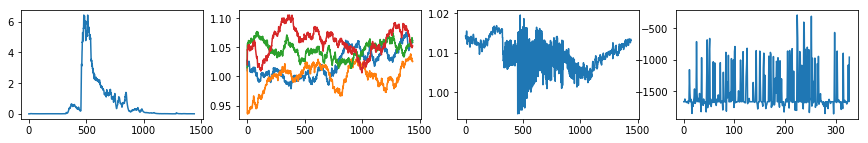

| Reward: -855 | Episode: 328 | Qmax: -132.5368 | Action: [0.99944893 1.05113521 1.06697855 1.03200349]


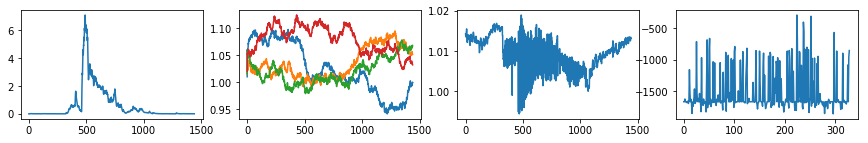

| Reward: -1669 | Episode: 329 | Qmax: -131.3039 | Action: [1.08131162 1.06941131 1.02794917 1.06488238]


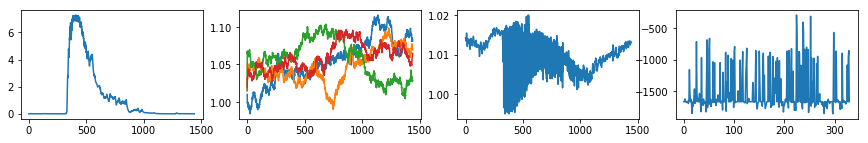

| Reward: -1669 | Episode: 330 | Qmax: -130.5122 | Action: [1.03475639 1.12681531 1.08748455 1.03259695]


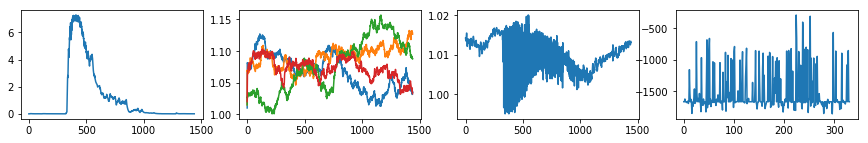

| Reward: -1683 | Episode: 331 | Qmax: -129.5116 | Action: [0.99871581 1.07356737 1.07509098 1.05224103]


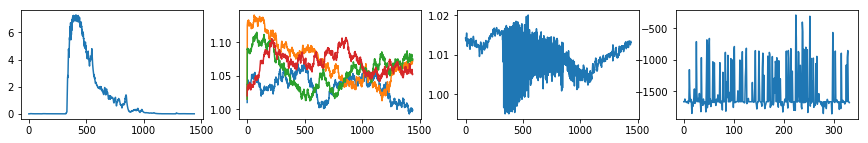

| Reward: -1848 | Episode: 332 | Qmax: -131.8346 | Action: [1.06678512 1.05159561 1.03640267 1.03808015]


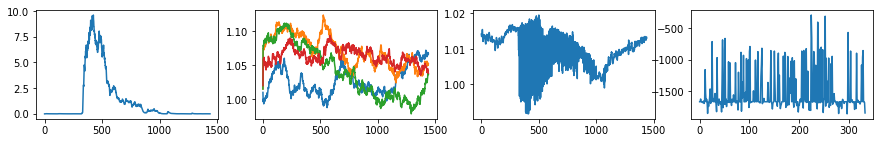

| Reward: -1669 | Episode: 333 | Qmax: -132.5035 | Action: [1.03631147 0.97040688 1.08651688 1.06941535]


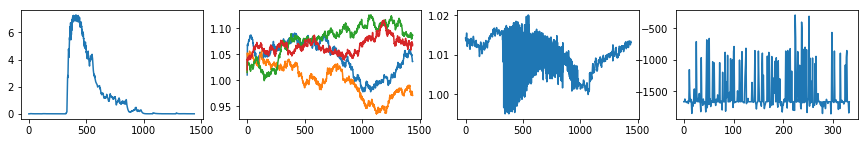

| Reward: -1726 | Episode: 334 | Qmax: -133.2189 | Action: [1.04026726 1.01101318 1.03123112 1.15170714]


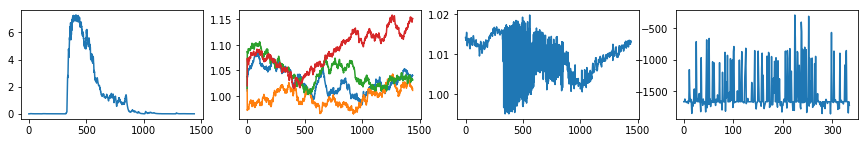

| Reward: -1669 | Episode: 335 | Qmax: -133.8858 | Action: [1.01353596 1.07661662 1.02515318 1.04674753]


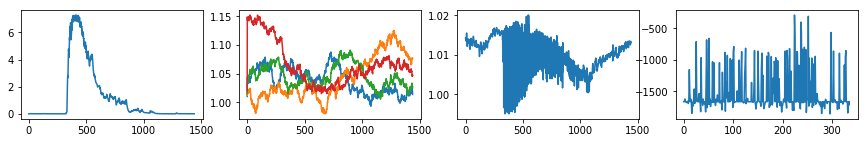

| Reward: -1669 | Episode: 336 | Qmax: -134.3030 | Action: [1.07971482 1.09197872 1.06550235 1.01755864]


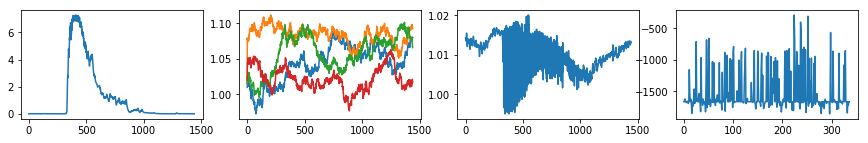

| Reward: -1641 | Episode: 337 | Qmax: -134.8402 | Action: [1.0414714  1.09310884 1.07570676 0.97922963]


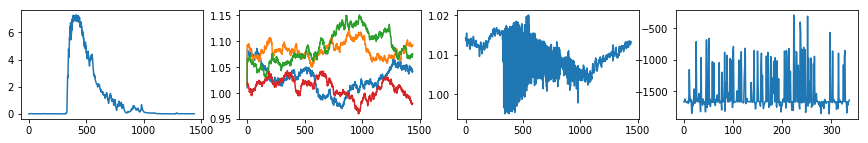

| Reward: -1670 | Episode: 338 | Qmax: -135.3791 | Action: [0.97747162 1.07363842 1.08409109 1.00955583]


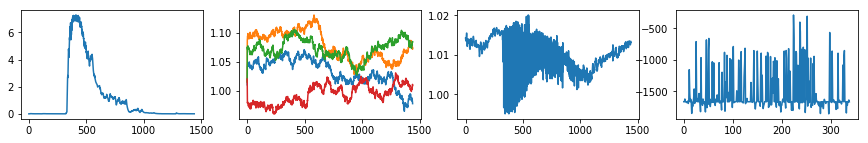

| Reward: -1669 | Episode: 339 | Qmax: -135.9436 | Action: [1.0397412  0.99443146 1.12517215 1.06109197]


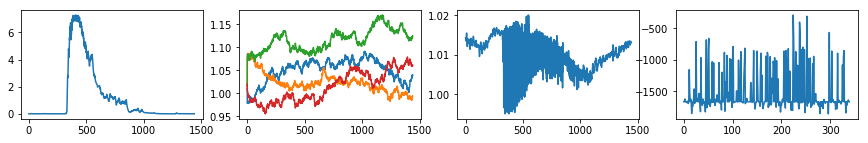

| Reward: -1669 | Episode: 340 | Qmax: -137.1404 | Action: [0.98178573 1.06906729 1.07037782 1.02067082]


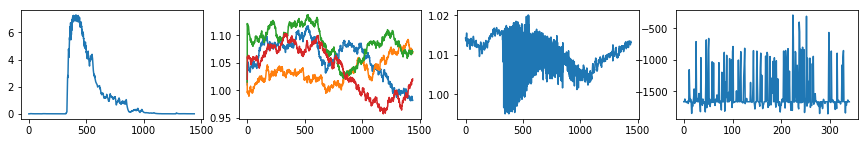

| Reward: -1010 | Episode: 341 | Qmax: -136.6276 | Action: [1.02870005 1.0335006  1.10692778 1.05586751]


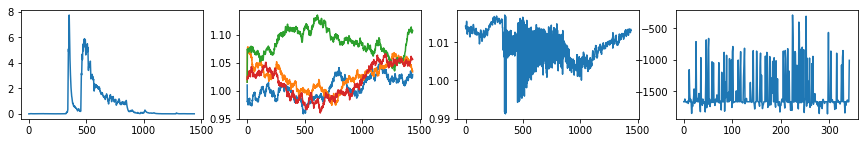

| Reward: -1669 | Episode: 342 | Qmax: -134.8280 | Action: [1.03643383 1.03122108 1.033258   1.04400833]


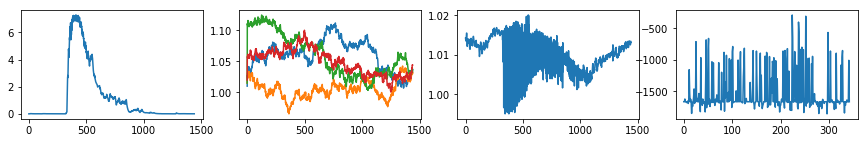

| Reward: -1669 | Episode: 343 | Qmax: -132.7998 | Action: [1.06019296 1.09968563 1.0214638  1.04272215]


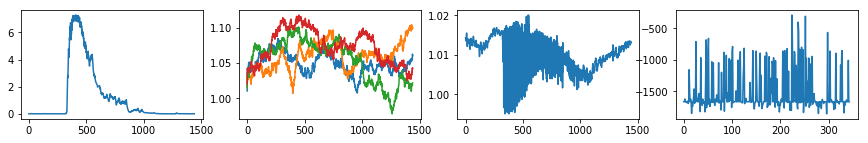

| Reward: -1068 | Episode: 344 | Qmax: -130.3285 | Action: [1.01914176 1.04373368 1.02172473 1.03012408]


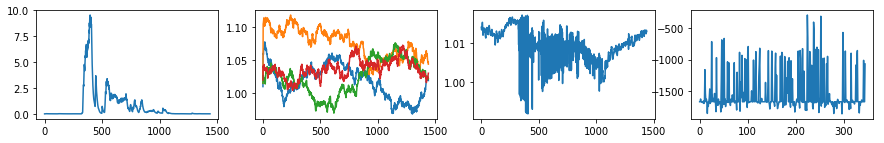

| Reward: -1016 | Episode: 345 | Qmax: -128.8554 | Action: [0.97365616 1.0317799  1.0260517  1.00876551]


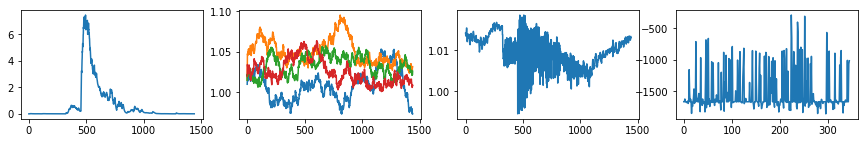

| Reward: -1737 | Episode: 346 | Qmax: -127.9766 | Action: [1.03653341 1.07306516 1.02481192 0.98830018]


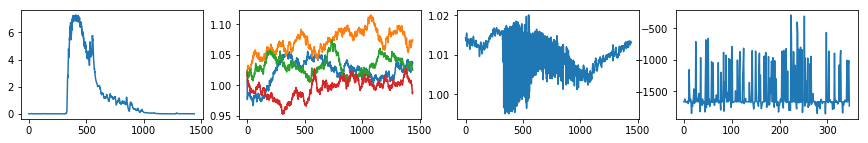

| Reward: -1640 | Episode: 347 | Qmax: -128.5358 | Action: [1.04864069 1.04387144 1.00764694 1.01929755]


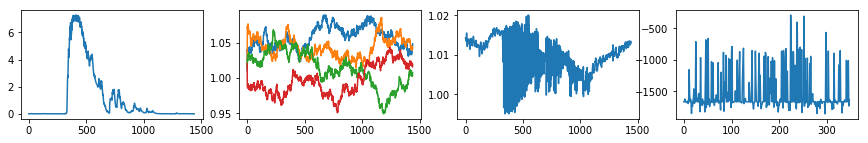

| Reward: -1417 | Episode: 348 | Qmax: -130.4727 | Action: [0.97864814 1.00322759 1.0586628  1.0327007 ]


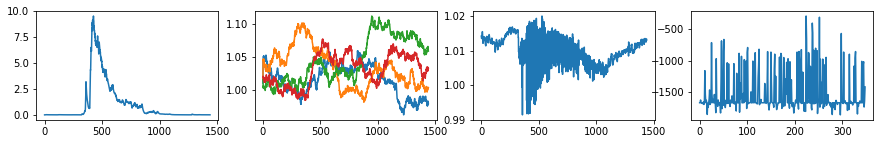

| Reward: -964 | Episode: 349 | Qmax: -133.3170 | Action: [0.98571336 1.04246167 0.91979626 0.99417903]


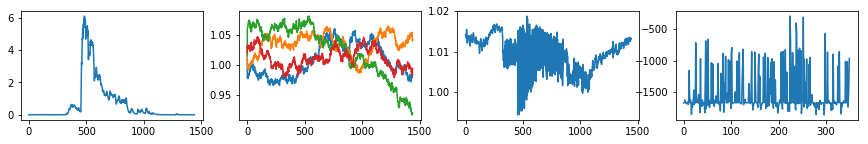

| Reward: -440 | Episode: 350 | Qmax: -134.5033 | Action: [1.06916839 1.0838815  1.05891757 1.09009053]


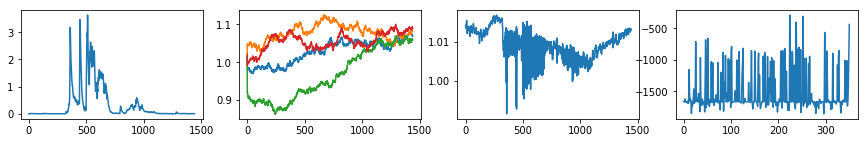

| Reward: -1669 | Episode: 351 | Qmax: -135.3411 | Action: [1.08859804 1.04248286 1.02046462 1.07753213]


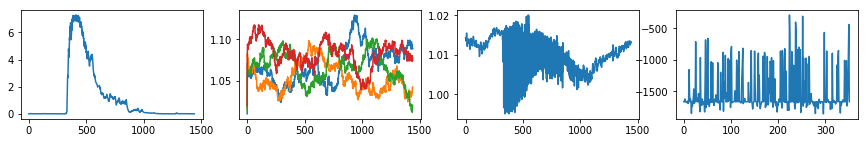

| Reward: -1689 | Episode: 352 | Qmax: -136.1707 | Action: [1.08390028 1.04053433 1.08416808 1.14096909]


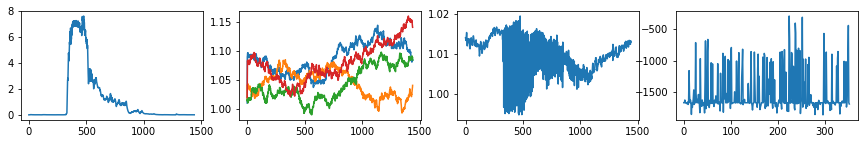

| Reward: -1669 | Episode: 353 | Qmax: -138.1154 | Action: [1.08056759 1.0023343  1.04794093 1.06735161]


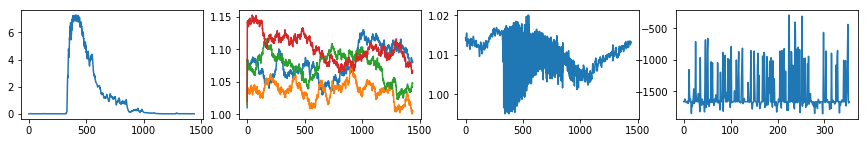

| Reward: -1657 | Episode: 354 | Qmax: -139.3153 | Action: [1.03260818 0.98984836 1.04993533 1.04288662]


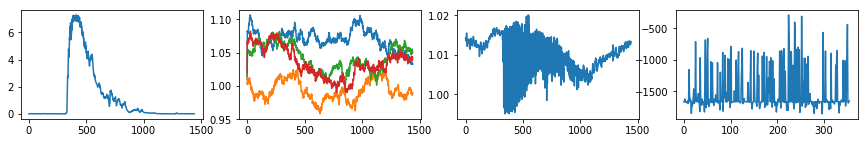

| Reward: -1238 | Episode: 355 | Qmax: -140.8424 | Action: [1.06597523 1.02625472 1.06529551 1.0701835 ]


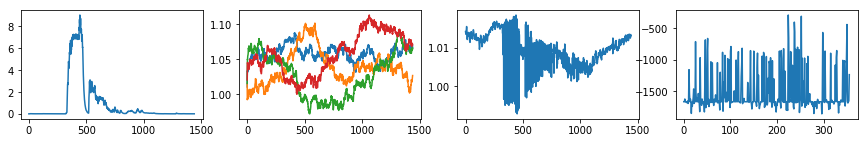

| Reward: -1669 | Episode: 356 | Qmax: -141.3344 | Action: [1.03566925 1.08974939 1.07390474 1.08446144]


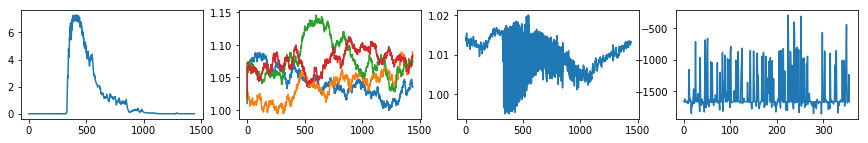

| Reward: -1695 | Episode: 357 | Qmax: -141.6417 | Action: [0.99436285 1.09517047 1.04305687 1.04208522]


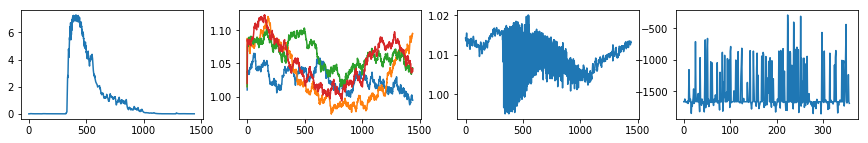

| Reward: -1653 | Episode: 358 | Qmax: -141.5660 | Action: [1.06568522 0.98431821 1.09092068 1.05358845]


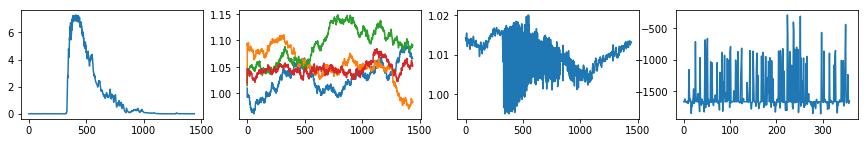

| Reward: -1669 | Episode: 359 | Qmax: -141.0288 | Action: [1.08399143 1.00687208 1.03679058 1.08788474]


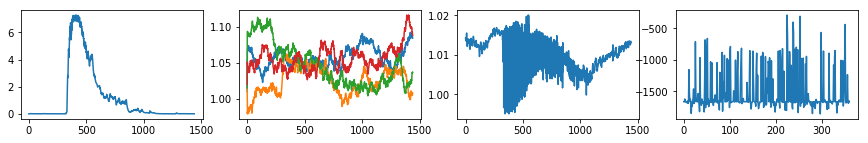

| Reward: -1632 | Episode: 360 | Qmax: -140.8602 | Action: [1.04200738 1.0720741  1.04950118 1.09480588]


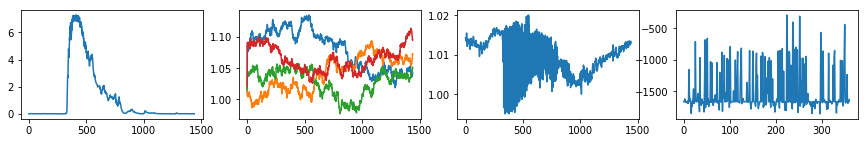

| Reward: -1669 | Episode: 361 | Qmax: -141.1926 | Action: [1.05798748 1.10709965 1.05363731 0.99047305]


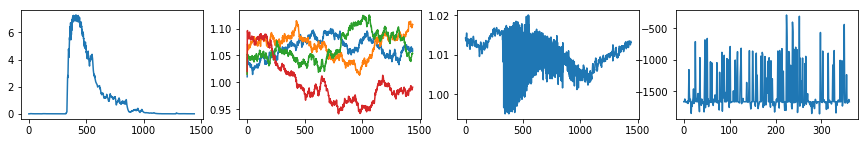

| Reward: -1440 | Episode: 362 | Qmax: -142.2897 | Action: [1.0410508  1.01466075 1.05004614 1.01927699]


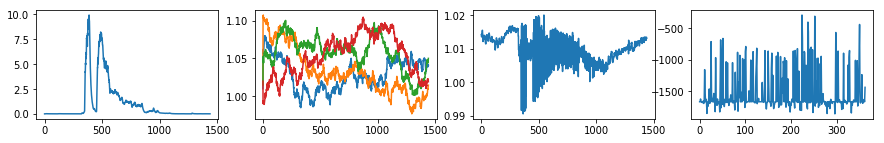

| Reward: -1855 | Episode: 363 | Qmax: -144.0266 | Action: [1.09634016 1.07892969 1.04315806 1.1012976 ]


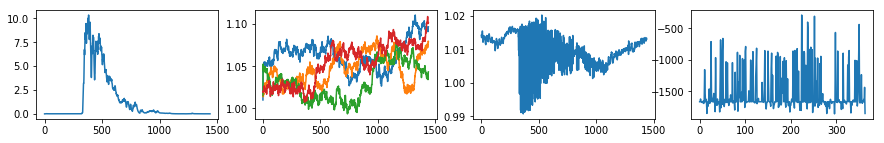

| Reward: -1669 | Episode: 364 | Qmax: -145.5021 | Action: [1.11353078 1.08828111 1.09319518 1.0911636 ]


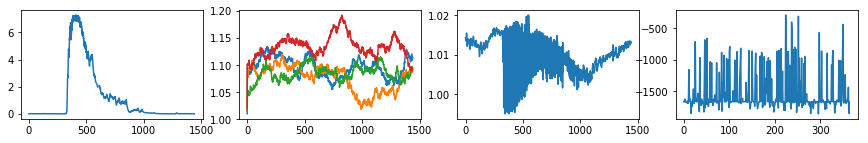

| Reward: -1669 | Episode: 365 | Qmax: -145.4702 | Action: [0.97822445 1.06610752 1.0801453  1.07787494]


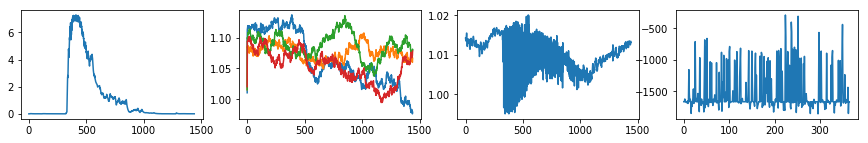

| Reward: -838 | Episode: 366 | Qmax: -145.6727 | Action: [1.0262206  1.06011947 1.10839768 1.10563633]


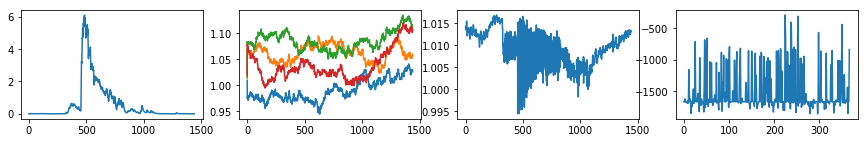

| Reward: -1489 | Episode: 367 | Qmax: -145.6441 | Action: [1.04982458 1.09234086 1.14765944 1.10649809]


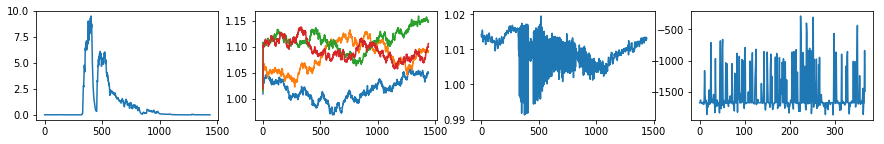

| Reward: -1669 | Episode: 368 | Qmax: -144.1064 | Action: [1.05396862 1.08486515 1.07043764 1.12465408]


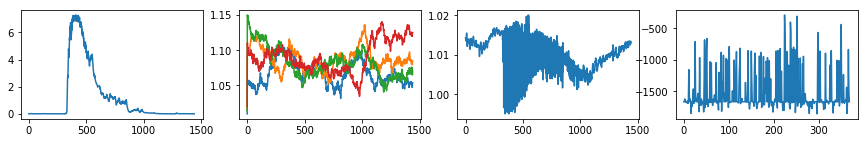

| Reward: -1656 | Episode: 369 | Qmax: -142.9313 | Action: [1.02999187 1.06000806 1.06707729 1.01410032]


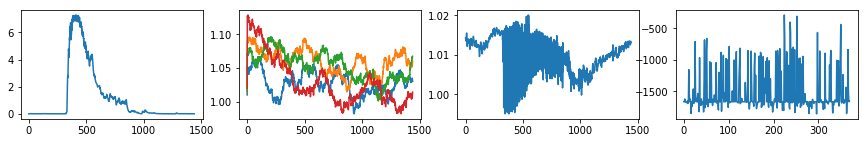

| Reward: -1728 | Episode: 370 | Qmax: -143.7990 | Action: [0.9896421  1.0214029  1.04406205 1.06717414]


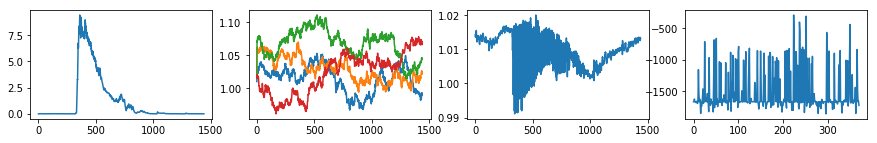

| Reward: -1435 | Episode: 371 | Qmax: -144.5724 | Action: [1.05005391 1.03434081 1.03502626 1.02498901]


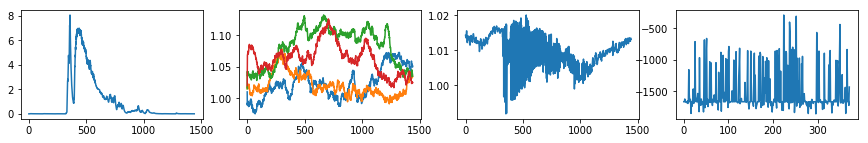

| Reward: -1701 | Episode: 372 | Qmax: -144.9961 | Action: [1.00268405 1.11050489 1.09744272 1.02394187]


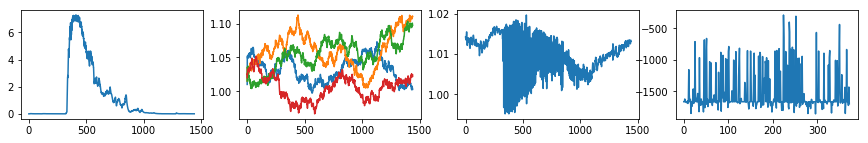

| Reward: -1726 | Episode: 373 | Qmax: -143.4703 | Action: [1.0660331  1.0352518  1.07332758 1.08031952]


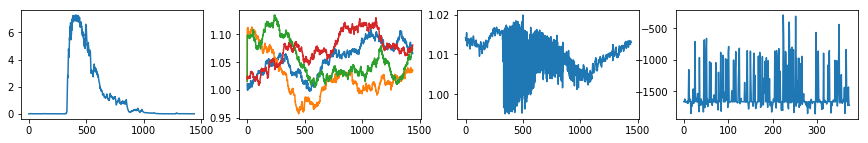

| Reward: -1669 | Episode: 374 | Qmax: -140.0958 | Action: [1.04598411 1.05761247 1.16804265 1.0377323 ]


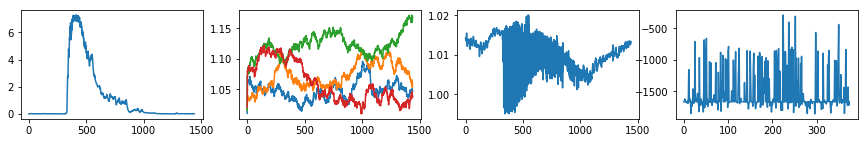

| Reward: -1669 | Episode: 375 | Qmax: -136.9718 | Action: [1.09369464 1.05497656 1.11725564 1.04114551]


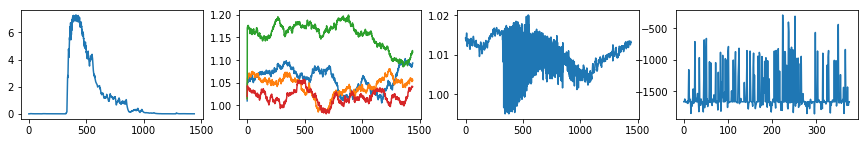

| Reward: -1669 | Episode: 376 | Qmax: -133.7565 | Action: [1.07747887 1.08929912 1.07432332 1.03775546]


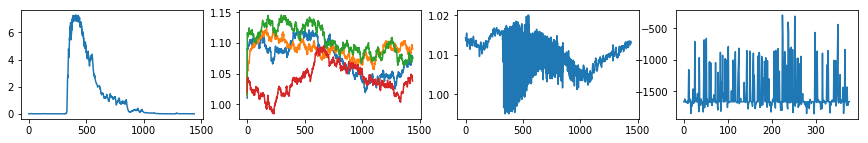

| Reward: -1674 | Episode: 377 | Qmax: -131.0152 | Action: [1.04236429 1.03590309 1.00015348 1.12120966]


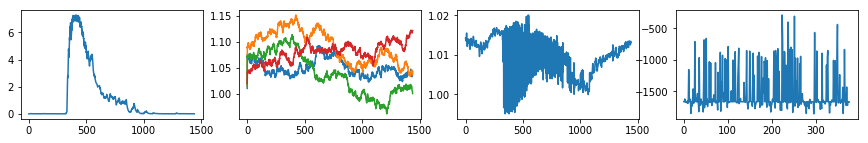

| Reward: -1668 | Episode: 378 | Qmax: -128.3463 | Action: [1.06750634 1.05158853 1.15979166 1.04959282]


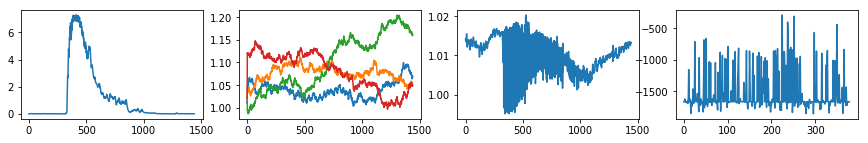

| Reward: -1669 | Episode: 379 | Qmax: -126.3780 | Action: [1.10718832 1.01264301 1.06080571 1.07082605]


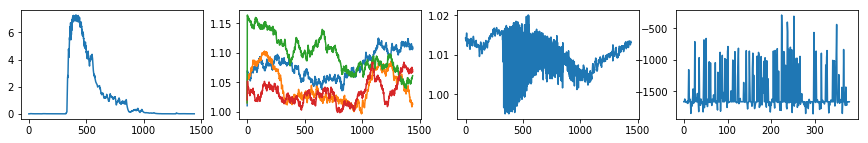

| Reward: -1669 | Episode: 380 | Qmax: -127.7422 | Action: [1.06514651 1.05536856 1.05003603 1.04716666]


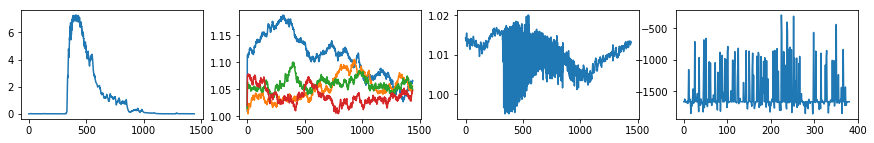

| Reward: -1669 | Episode: 381 | Qmax: -127.5743 | Action: [1.03189959 1.06816032 1.04698418 1.10368111]


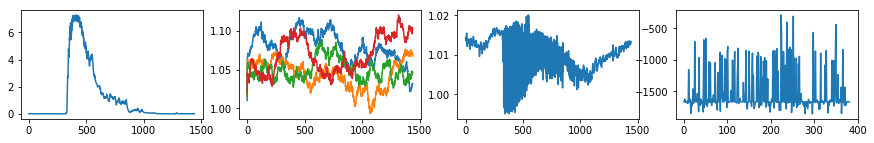

| Reward: -1669 | Episode: 382 | Qmax: -127.0710 | Action: [1.03906255 1.03089118 1.07938932 1.05463163]


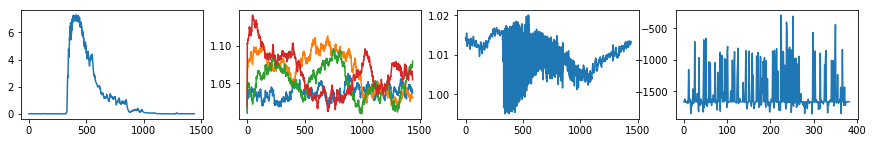

| Reward: -1669 | Episode: 383 | Qmax: -125.5503 | Action: [1.02806261 1.06667483 1.03077319 1.0530786 ]


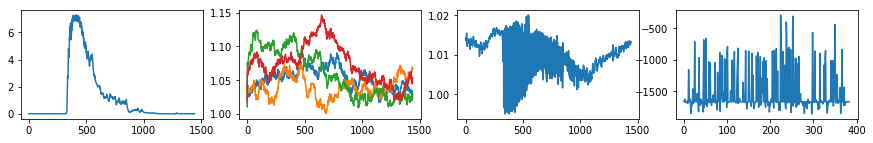

| Reward: -1739 | Episode: 384 | Qmax: -124.4539 | Action: [1.05684365 1.07989998 1.07427622 1.0142418 ]


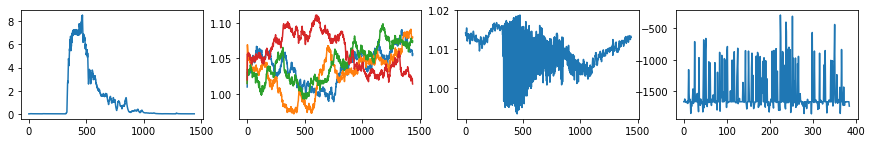

| Reward: -1581 | Episode: 385 | Qmax: -122.9693 | Action: [1.02228399 1.10641355 1.01516995 1.01910602]


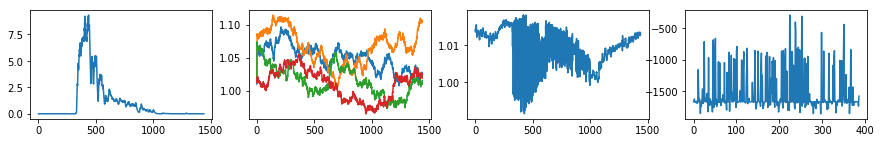

| Reward: -1608 | Episode: 386 | Qmax: -120.7369 | Action: [1.0281658  1.04823357 1.06426197 1.07007638]


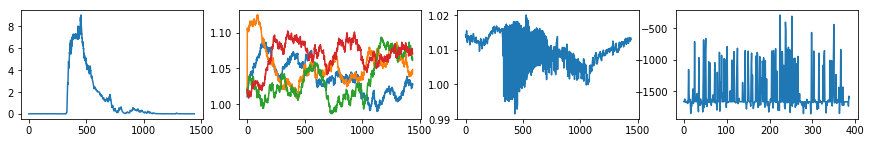

| Reward: -1669 | Episode: 387 | Qmax: -118.2896 | Action: [1.06592827 1.03919016 1.0608861  1.05522175]


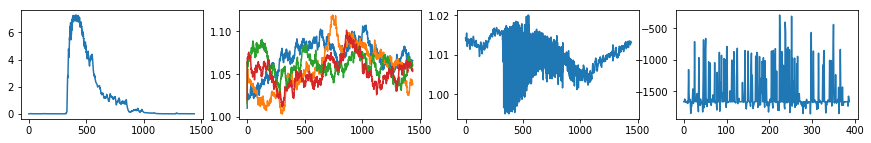

| Reward: -1669 | Episode: 388 | Qmax: -117.8229 | Action: [1.04189496 1.01315051 1.12461793 1.04738304]


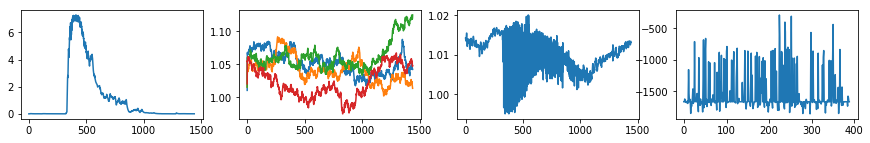

| Reward: -1698 | Episode: 389 | Qmax: -117.4483 | Action: [1.05476188 1.03244444 1.03370078 1.05510575]


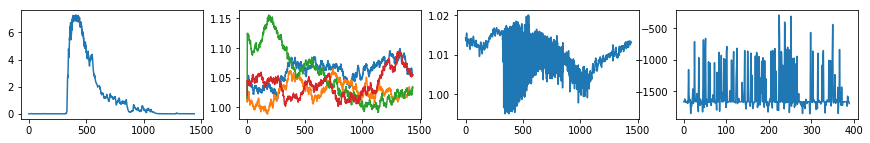

| Reward: -1339 | Episode: 390 | Qmax: -117.2141 | Action: [1.01364698 1.09718441 1.11730133 1.04831894]


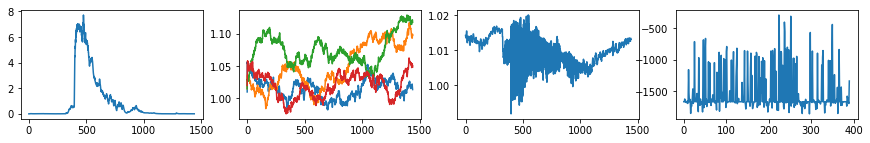

| Reward: -932 | Episode: 391 | Qmax: -116.2079 | Action: [0.99315264 1.02644759 1.10008993 1.02986387]


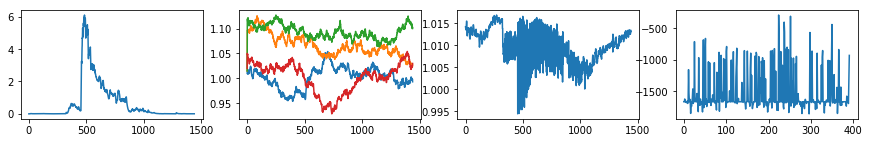

| Reward: -1669 | Episode: 392 | Qmax: -115.6082 | Action: [1.11540825 1.01522703 1.08436359 1.10666739]


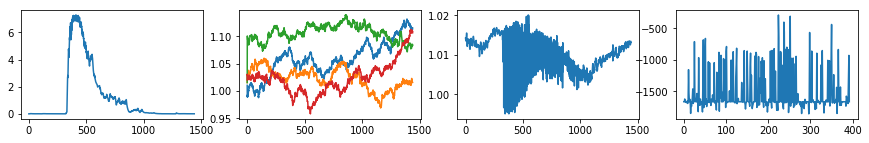

| Reward: -1175 | Episode: 393 | Qmax: -114.7832 | Action: [1.00116258 1.03362124 1.0636686  1.12265233]


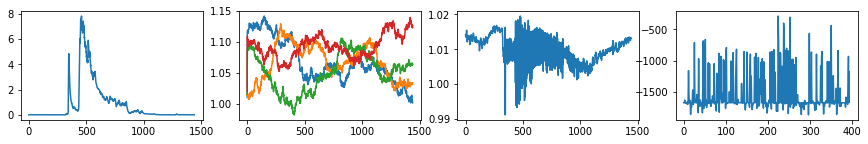

| Reward: -1648 | Episode: 394 | Qmax: -115.7089 | Action: [0.99144643 1.10975858 1.08593406 1.06448567]


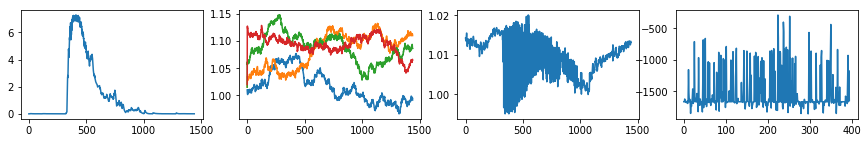

| Reward: -1485 | Episode: 395 | Qmax: -116.1545 | Action: [1.11959459 1.11568803 1.03367544 1.00477815]


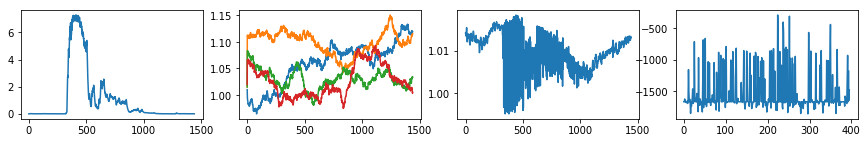

| Reward: -1612 | Episode: 396 | Qmax: -115.8438 | Action: [1.01135479 1.00217512 1.03088606 1.07206687]


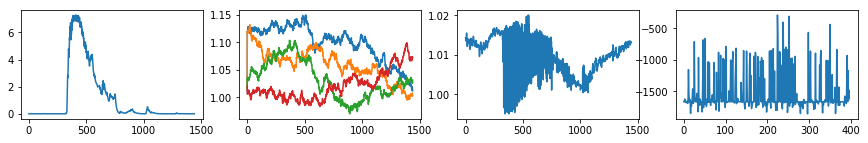

| Reward: -1822 | Episode: 397 | Qmax: -114.4003 | Action: [1.02964335 1.04302285 1.02813004 0.99640103]


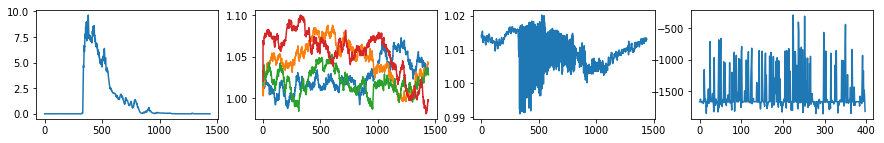

| Reward: -1282 | Episode: 398 | Qmax: -114.1061 | Action: [1.0647528  1.06147239 1.05385701 1.02186305]


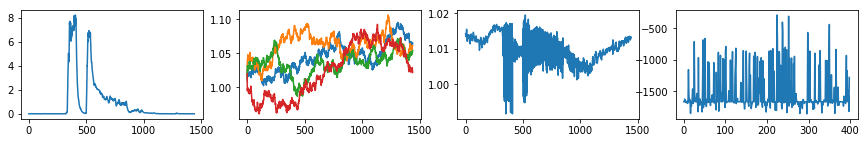

| Reward: -1669 | Episode: 399 | Qmax: -112.7378 | Action: [1.03194068 1.13315478 1.03403274 1.08123279]


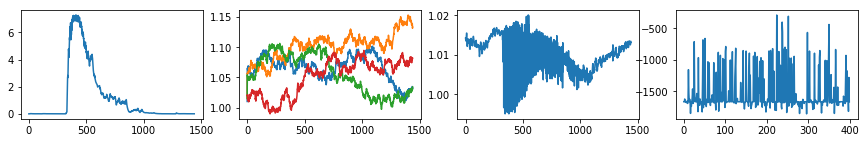

| Reward: -1669 | Episode: 400 | Qmax: -112.0845 | Action: [1.03403101 1.02774387 1.01057277 1.03277551]


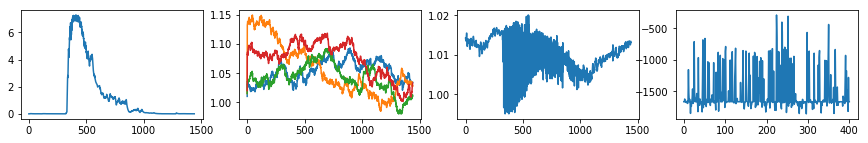

| Reward: -1668 | Episode: 401 | Qmax: -110.3000 | Action: [1.07222711 1.0099466  1.09171396 1.05980572]


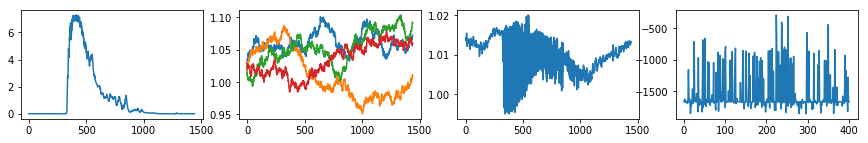

| Reward: -1693 | Episode: 402 | Qmax: -109.7179 | Action: [1.0681538  1.02127003 1.03862518 1.05274678]


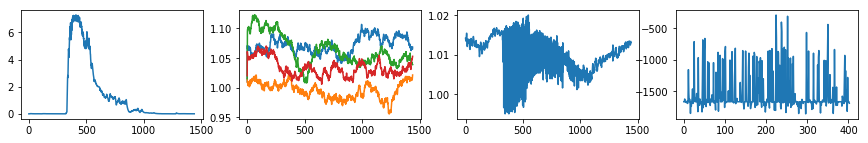

| Reward: -983 | Episode: 403 | Qmax: -108.7697 | Action: [1.08017039 1.0486526  1.08743143 1.08272756]


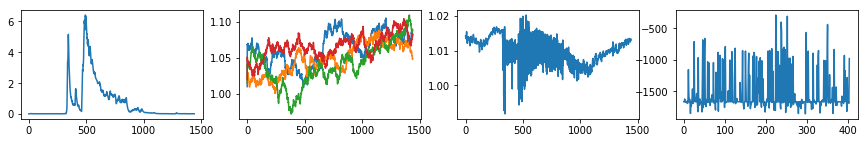

| Reward: -1669 | Episode: 404 | Qmax: -108.9231 | Action: [1.04541153 1.07253699 1.04542248 1.0613893 ]


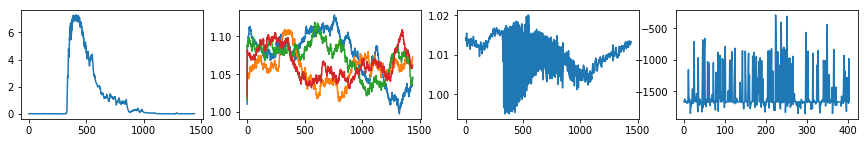

| Reward: -1669 | Episode: 405 | Qmax: -109.6599 | Action: [1.04479566 1.06569626 0.98813765 1.09754532]


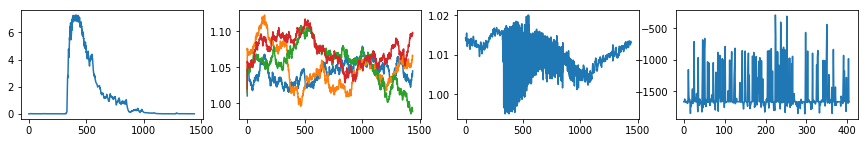

| Reward: -746 | Episode: 406 | Qmax: -109.0765 | Action: [1.07593639 1.04507668 0.99241264 1.09230083]


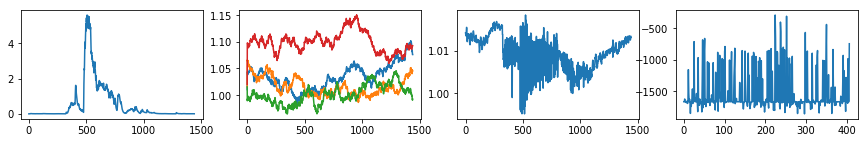

| Reward: -1669 | Episode: 407 | Qmax: -108.5722 | Action: [1.00970213 0.98456748 1.08021826 1.04977037]


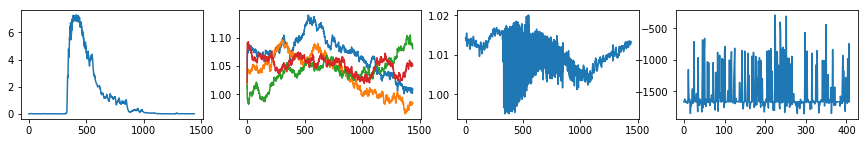

| Reward: -1685 | Episode: 408 | Qmax: -107.8216 | Action: [1.07306701 1.03885633 1.02834381 1.01565412]


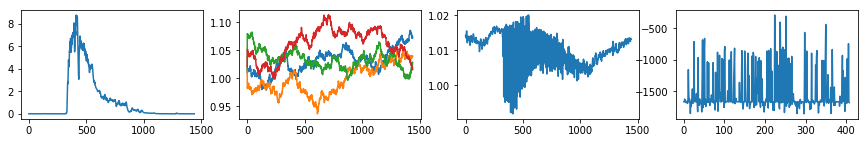

| Reward: -1670 | Episode: 409 | Qmax: -106.6535 | Action: [1.03635818 1.03389589 1.03210589 1.08700686]


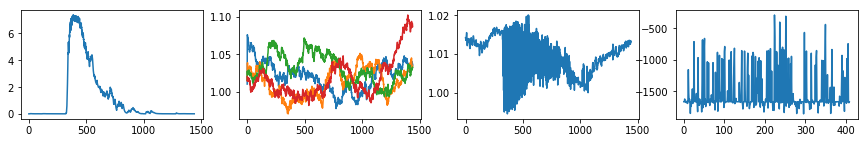

| Reward: -1643 | Episode: 410 | Qmax: -105.8045 | Action: [1.0914026  1.0476436  1.05820722 1.11661285]


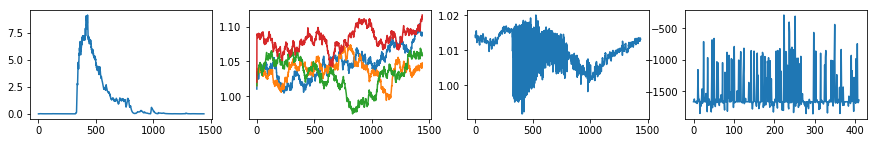

| Reward: -1703 | Episode: 411 | Qmax: -104.9064 | Action: [1.05968312 1.09255429 1.01193473 1.04633451]


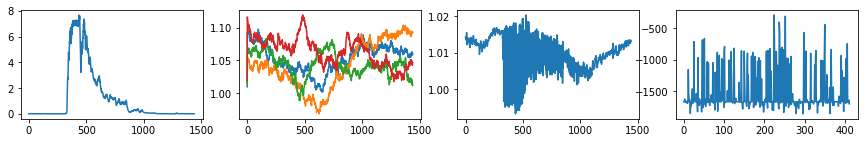

| Reward: -1830 | Episode: 412 | Qmax: -104.1288 | Action: [1.05315747 1.0850922  1.05335916 1.1002222 ]


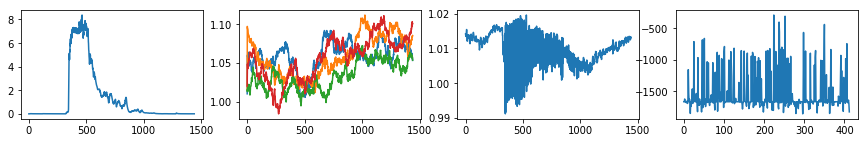

| Reward: -1667 | Episode: 413 | Qmax: -103.7986 | Action: [1.03480373 1.09719515 1.06199391 1.03692651]


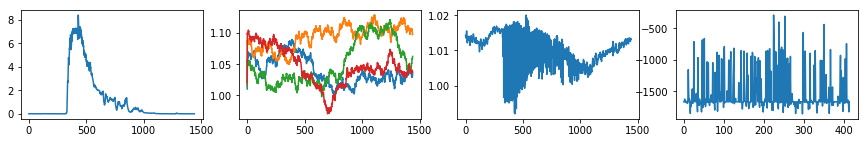

| Reward: -1403 | Episode: 414 | Qmax: -103.9826 | Action: [1.09533865 1.05028756 1.0338389  1.07307023]


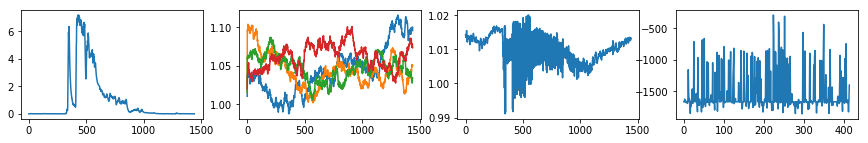

| Reward: -1616 | Episode: 415 | Qmax: -103.7386 | Action: [1.06870694 1.01667549 1.02386599 1.08240927]


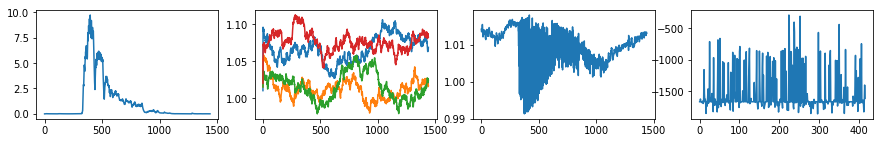

| Reward: -1661 | Episode: 416 | Qmax: -103.5076 | Action: [1.05684807 1.05295004 1.05392082 1.03091992]


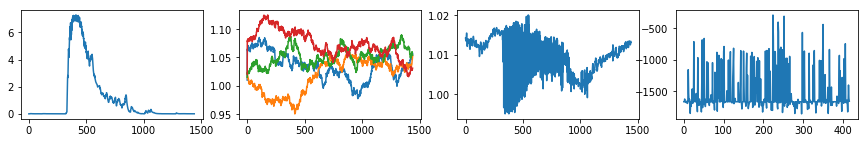

| Reward: -1650 | Episode: 417 | Qmax: -102.2227 | Action: [1.07278232 1.06112326 1.07108914 1.01272716]


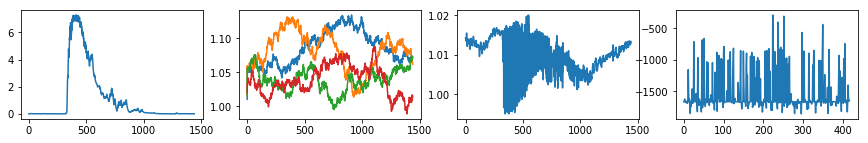

| Reward: -1669 | Episode: 418 | Qmax: -100.0666 | Action: [1.04608409 1.06615127 1.02479813 1.02151143]


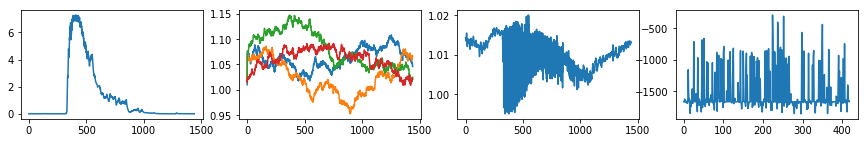

| Reward: -1597 | Episode: 419 | Qmax: -98.7277 | Action: [1.07670668 1.09982505 1.11774537 1.07247897]


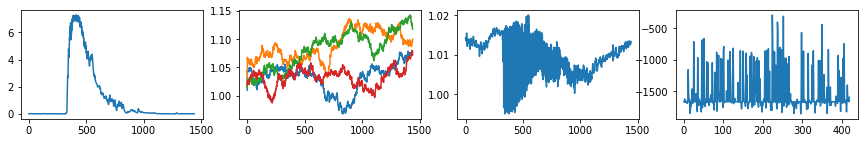

| Reward: -1669 | Episode: 420 | Qmax: -98.8907 | Action: [1.05641148 1.06623714 1.02760999 1.06042929]


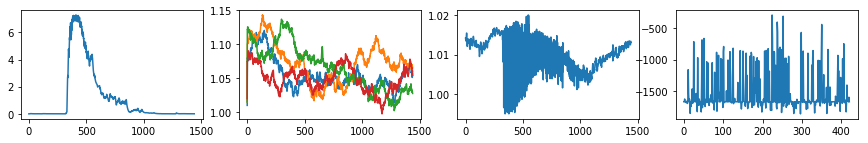

| Reward: -1648 | Episode: 421 | Qmax: -99.7049 | Action: [1.11006652 1.11479347 1.03279146 1.08384147]


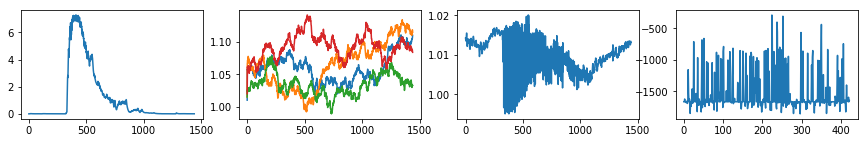

| Reward: -1676 | Episode: 422 | Qmax: -100.1111 | Action: [1.00525656 1.06736242 1.01453231 1.06604374]


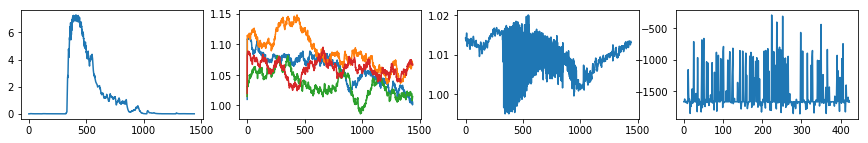

| Reward: -859 | Episode: 423 | Qmax: -100.9794 | Action: [1.0229208  1.07135776 1.12778919 1.06050766]


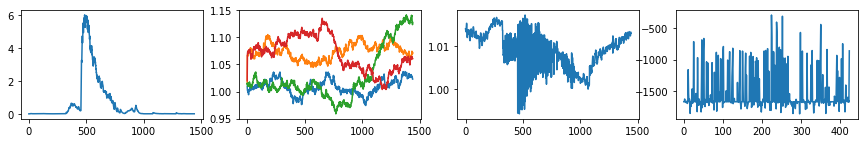

| Reward: -1669 | Episode: 424 | Qmax: -100.7513 | Action: [1.07081033 1.09151543 1.06408623 1.01048806]


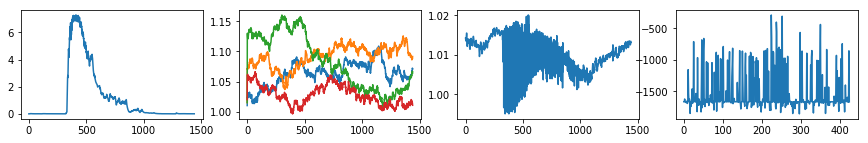

| Reward: -1740 | Episode: 425 | Qmax: -99.3692 | Action: [0.98927561 1.07887053 1.03580131 1.05826885]


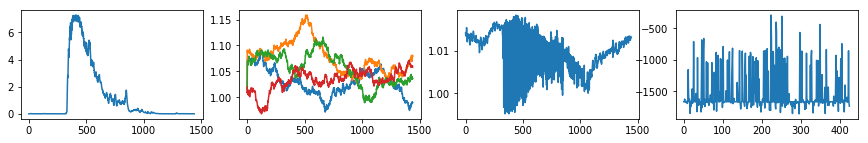

| Reward: -898 | Episode: 426 | Qmax: -98.8293 | Action: [1.00985502 1.09699985 1.06258848 1.03378764]


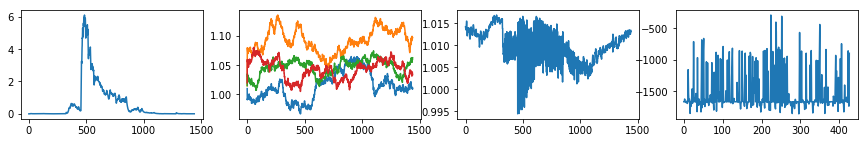

| Reward: -1749 | Episode: 427 | Qmax: -98.7213 | Action: [0.98106804 1.04699725 1.05477639 1.05919217]


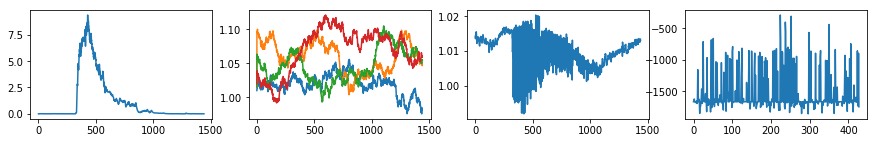

| Reward: -834 | Episode: 428 | Qmax: -99.0128 | Action: [1.05070145 1.05846707 1.08278656 1.08548109]


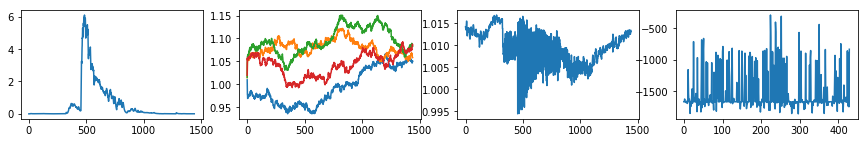

| Reward: -1669 | Episode: 429 | Qmax: -98.8586 | Action: [1.04285823 1.02191591 1.1437163  1.02050614]


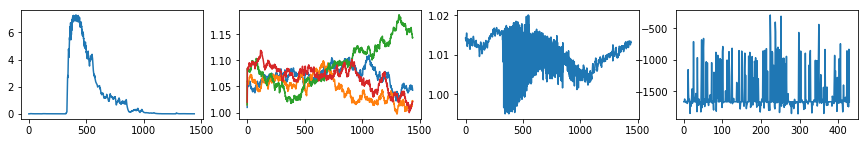

| Reward: -1670 | Episode: 430 | Qmax: -100.1342 | Action: [1.08626546 1.05088737 1.0018419  1.0026925 ]


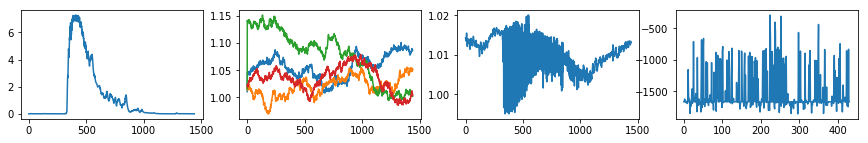

| Reward: -1702 | Episode: 431 | Qmax: -102.3379 | Action: [1.06633545 1.04524609 0.99207349 1.08574143]


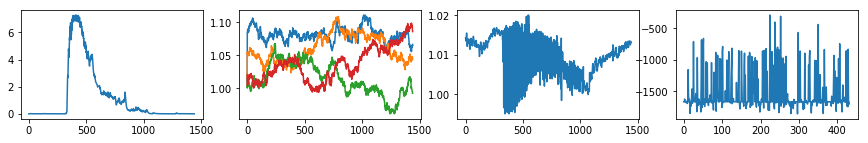

| Reward: -1758 | Episode: 432 | Qmax: -104.9577 | Action: [1.0622981  1.02459828 1.06390734 1.14488468]


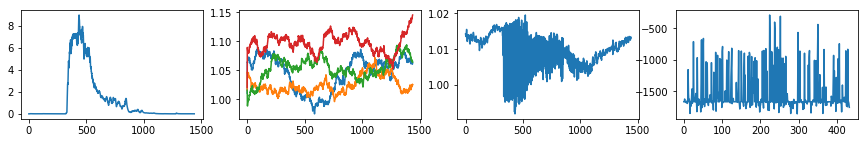

| Reward: -1739 | Episode: 433 | Qmax: -107.0657 | Action: [1.08389665 1.01476077 1.07022071 1.03431456]


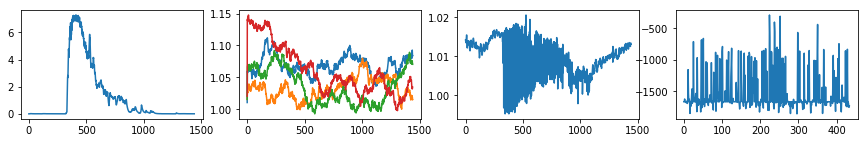

| Reward: -1801 | Episode: 434 | Qmax: -108.8111 | Action: [1.011827   1.03585401 1.02246053 1.00560043]


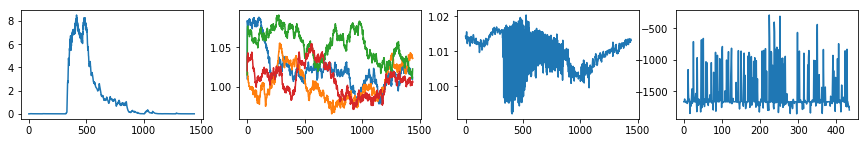

| Reward: -843 | Episode: 435 | Qmax: -109.0469 | Action: [1.007418   1.0708673  0.97325218 1.01685315]


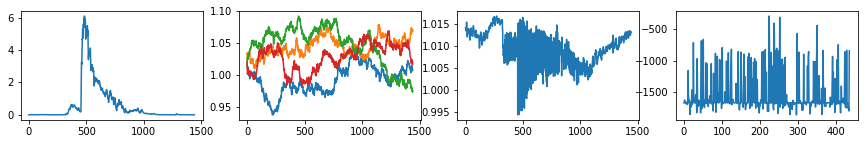

| Reward: -1534 | Episode: 436 | Qmax: -108.9223 | Action: [1.04900261 1.0776959  1.05069987 1.0484033 ]


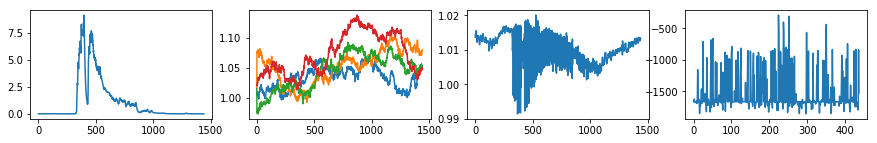

| Reward: -1656 | Episode: 437 | Qmax: -108.1475 | Action: [1.04826366 1.08614471 1.16238878 1.02939614]


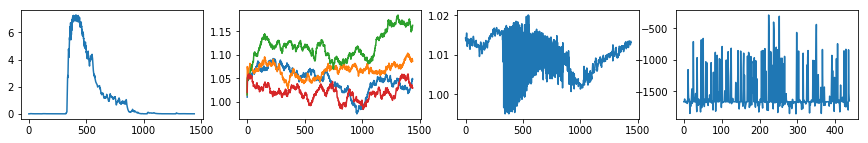

| Reward: -1610 | Episode: 438 | Qmax: -108.2037 | Action: [1.00136688 1.02807641 1.05252824 1.03055555]


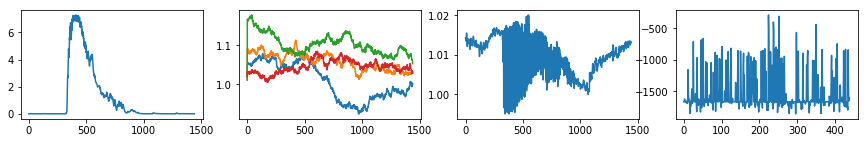

| Reward: -1669 | Episode: 439 | Qmax: -109.8542 | Action: [1.06938568 1.04908256 1.04147067 1.07133339]


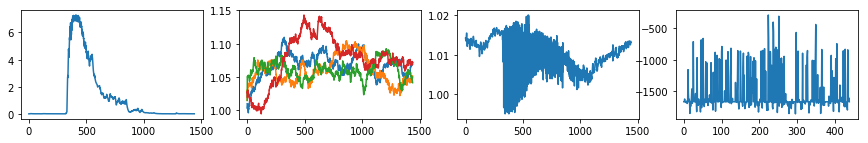

| Reward: -1669 | Episode: 440 | Qmax: -110.7462 | Action: [1.06781161 0.97933687 1.0748768  1.02833751]


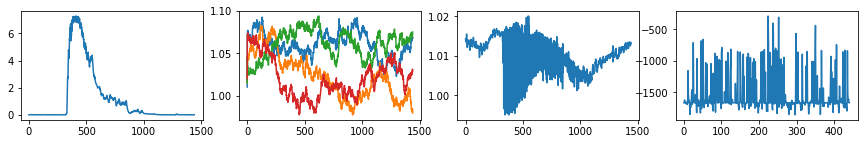

| Reward: -1835 | Episode: 441 | Qmax: -110.4400 | Action: [1.03933717 1.04409571 1.06634555 1.09371307]


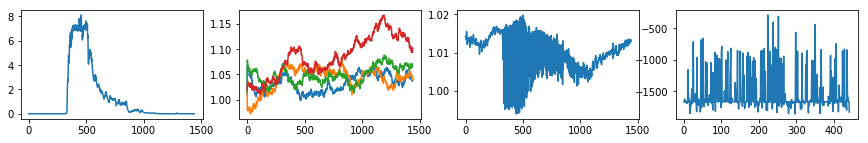

| Reward: -1669 | Episode: 442 | Qmax: -111.2479 | Action: [1.02401017 0.94877068 1.07893195 1.06092234]


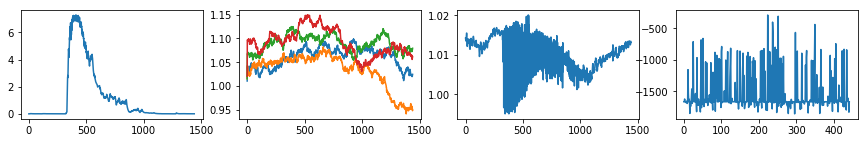

| Reward: -1648 | Episode: 443 | Qmax: -110.1471 | Action: [1.06732372 1.00939311 1.03159589 1.02527921]


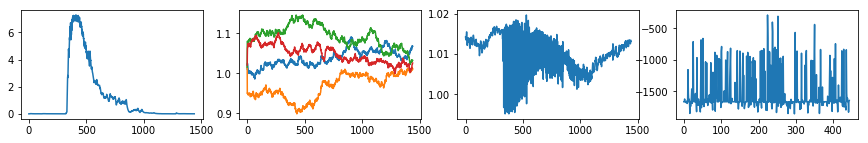

| Reward: -1669 | Episode: 444 | Qmax: -111.1204 | Action: [1.01919461 1.07068227 1.08792819 1.04435758]


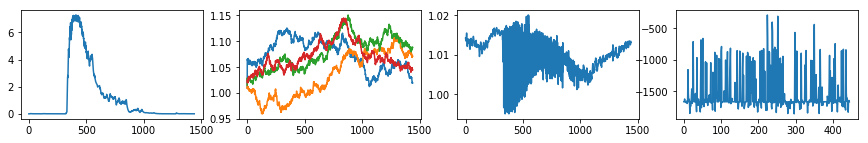

| Reward: -1058 | Episode: 445 | Qmax: -110.8571 | Action: [1.05070194 1.04375892 1.05611236 1.08387615]


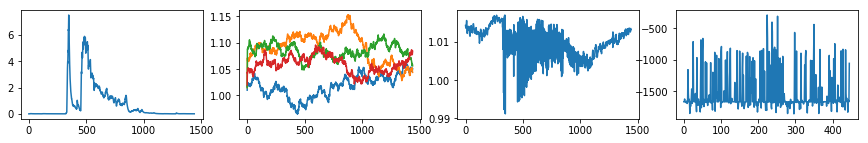

| Reward: -1669 | Episode: 446 | Qmax: -110.9264 | Action: [1.00141369 1.01709278 1.08903421 1.0879416 ]


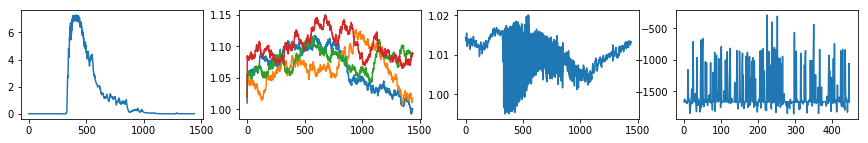

| Reward: -1637 | Episode: 447 | Qmax: -111.0987 | Action: [0.98064822 1.01798897 1.0599938  0.99853099]


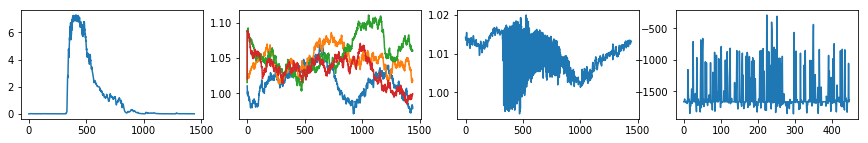

| Reward: -835 | Episode: 448 | Qmax: -112.1126 | Action: [1.04309622 1.02644146 1.08984399 1.04646607]


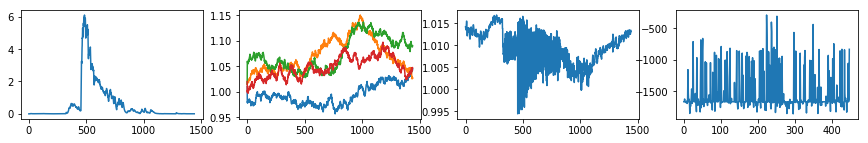

| Reward: -833 | Episode: 449 | Qmax: -112.6528 | Action: [1.0328739  1.0450757  1.05667769 1.13161333]


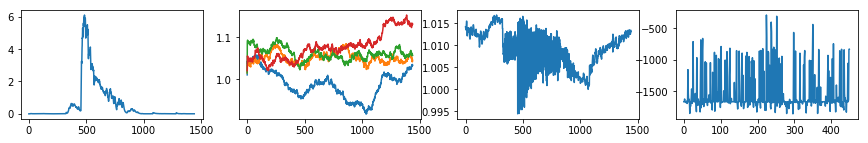

| Reward: -1739 | Episode: 450 | Qmax: -112.4818 | Action: [1.02003006 1.05422242 1.01260012 1.10623544]


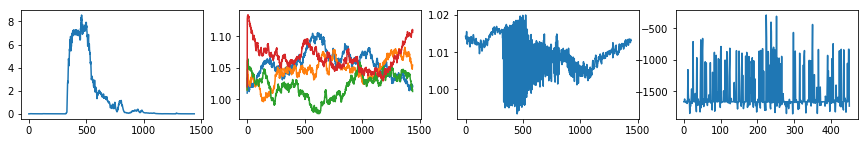

| Reward: -1661 | Episode: 451 | Qmax: -111.9673 | Action: [1.0333888  1.00911982 1.05485764 1.11360371]


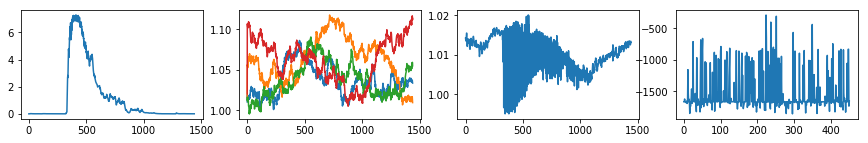

| Reward: -1670 | Episode: 452 | Qmax: -111.5141 | Action: [1.0102121  1.03344096 1.03751825 1.05417473]


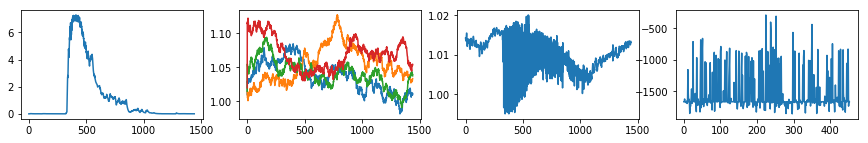

| Reward: -1670 | Episode: 453 | Qmax: -112.3764 | Action: [1.0529036  1.09793874 1.0678151  1.01344703]


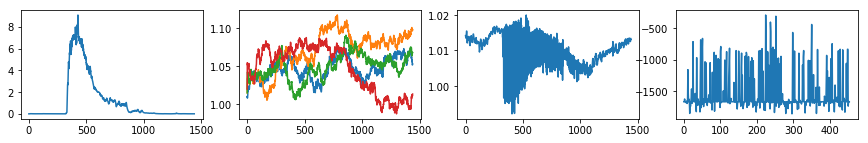

| Reward: -844 | Episode: 454 | Qmax: -113.1375 | Action: [1.07095551 0.97247987 1.03222084 1.06225306]


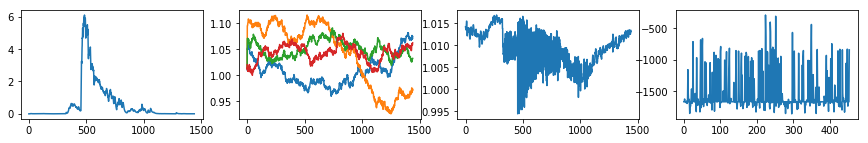

| Reward: -1654 | Episode: 455 | Qmax: -113.8455 | Action: [1.10632038 1.01756807 1.0186922  1.00506176]


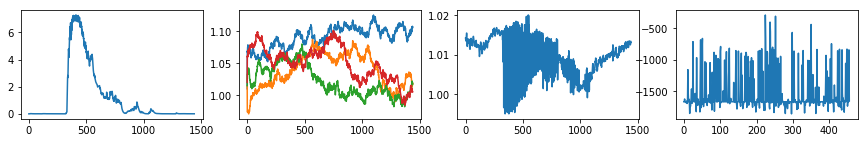

| Reward: -1669 | Episode: 456 | Qmax: -113.6600 | Action: [1.09380887 1.05877089 1.04332457 1.00773379]


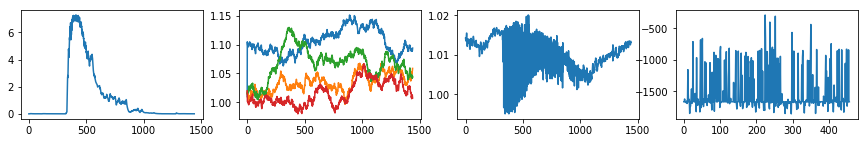

| Reward: -1669 | Episode: 457 | Qmax: -112.9030 | Action: [1.03459817 1.02351451 1.0168577  1.06041851]


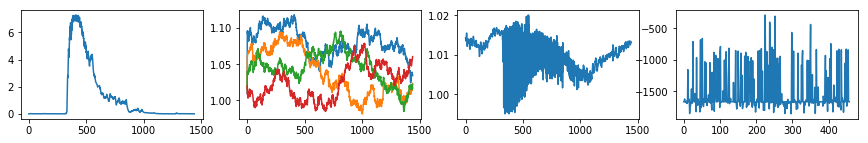

| Reward: -1669 | Episode: 458 | Qmax: -113.3935 | Action: [1.03631481 1.05735662 1.08637455 1.05030185]


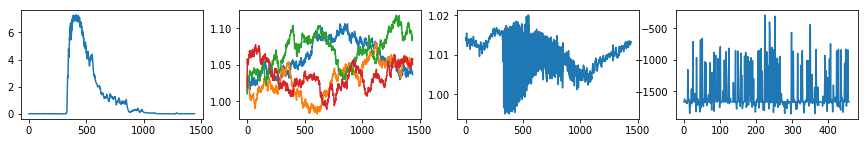

| Reward: -1674 | Episode: 459 | Qmax: -113.6559 | Action: [0.93820868 0.99252779 1.08636246 1.10523375]


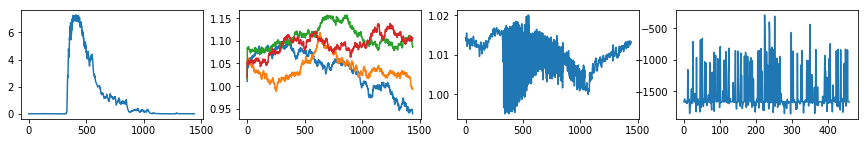

| Reward: -859 | Episode: 460 | Qmax: -113.2010 | Action: [1.00930842 1.05281771 1.0619554  1.08360278]


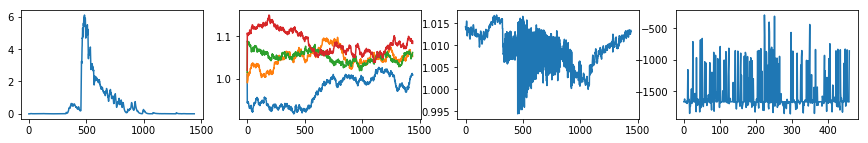

| Reward: -1692 | Episode: 461 | Qmax: -112.6625 | Action: [0.94655092 1.13837098 1.05322668 1.07574874]


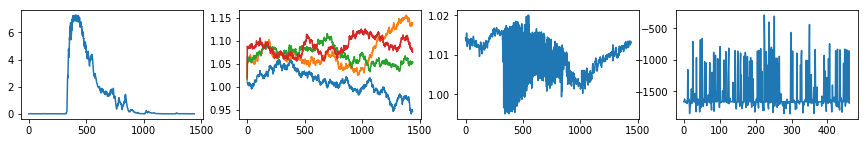

| Reward: -1043 | Episode: 462 | Qmax: -111.8224 | Action: [1.02905619 1.04716147 1.02335771 1.05540535]


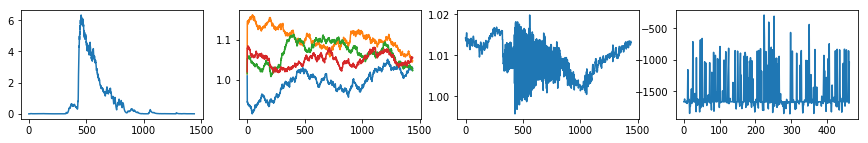

| Reward: -1196 | Episode: 463 | Qmax: -111.7718 | Action: [1.03293714 1.09234715 1.03080274 1.06329799]


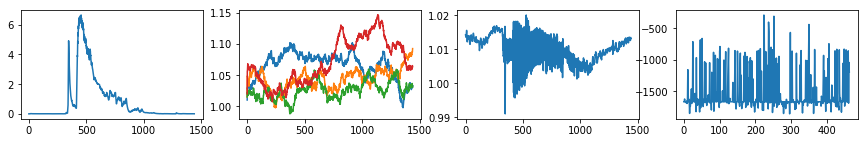

| Reward: -1657 | Episode: 464 | Qmax: -111.9161 | Action: [1.04394166 1.03478225 1.00745849 0.98705447]


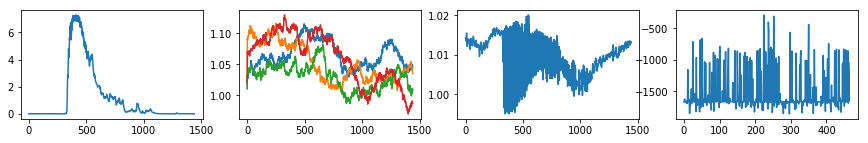

| Reward: -1660 | Episode: 465 | Qmax: -112.6736 | Action: [1.00134853 1.04199145 1.08901936 1.04885203]


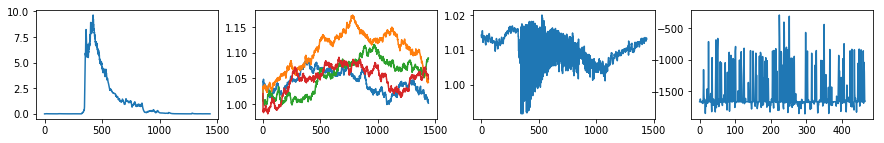

| Reward: -1124 | Episode: 466 | Qmax: -113.6217 | Action: [0.96510015 1.04920807 1.09956358 1.09383483]


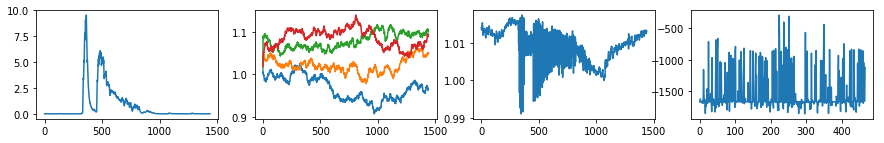

| Reward: -1663 | Episode: 467 | Qmax: -115.2878 | Action: [1.01268868 1.08527517 1.04837382 1.05916324]


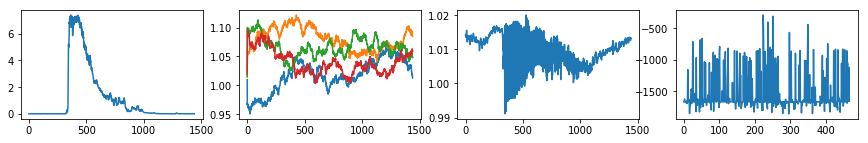

| Reward: -1369 | Episode: 468 | Qmax: -117.0642 | Action: [1.11246619 1.09872648 1.01527911 1.05654213]


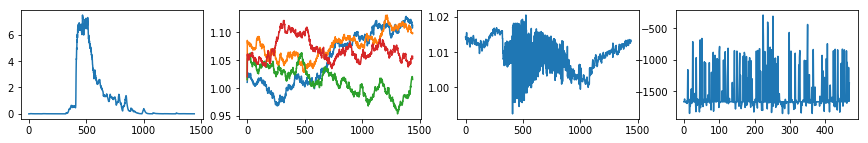

| Reward: -1772 | Episode: 469 | Qmax: -115.9981 | Action: [1.0651975  1.10392349 1.02154174 1.05451942]


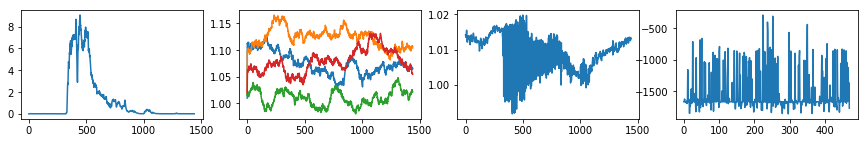

| Reward: -1686 | Episode: 470 | Qmax: -114.3685 | Action: [1.02242075 1.04048414 1.05259822 1.02711061]


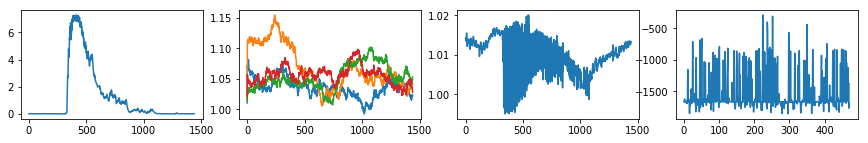

| Reward: -1651 | Episode: 471 | Qmax: -113.9855 | Action: [1.03481505 1.03192486 1.10343163 1.11955746]


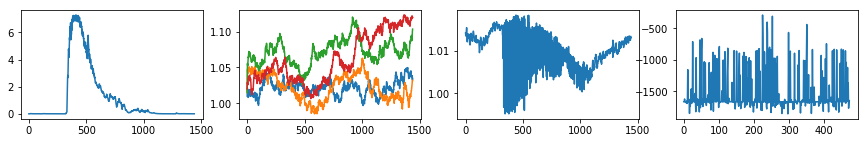

| Reward: -983 | Episode: 472 | Qmax: -114.5633 | Action: [1.03860919 1.00022411 1.0530942  1.00445563]


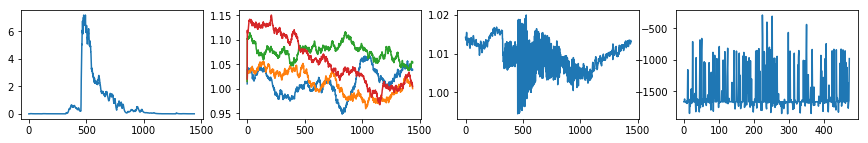

| Reward: -1101 | Episode: 473 | Qmax: -114.5055 | Action: [1.06321718 1.04760248 1.08037374 1.04589806]


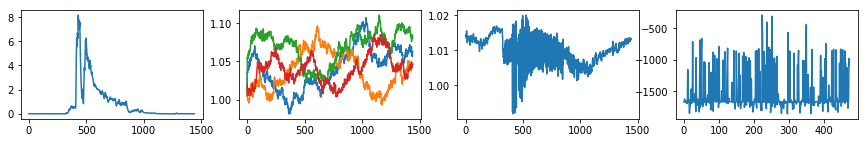

| Reward: -1669 | Episode: 474 | Qmax: -115.8500 | Action: [1.15891249 0.97793591 1.10738636 1.02522852]


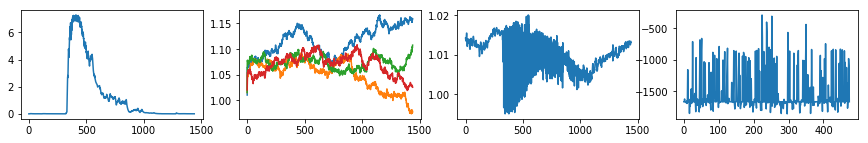

| Reward: -1669 | Episode: 475 | Qmax: -115.4128 | Action: [1.00857127 1.0360524  1.04057365 1.04292935]


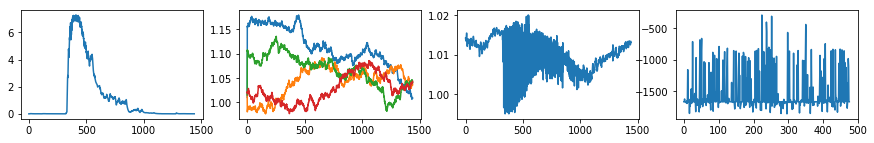

| Reward: -924 | Episode: 476 | Qmax: -115.4408 | Action: [1.0514165  1.12766113 1.01724408 1.06281362]


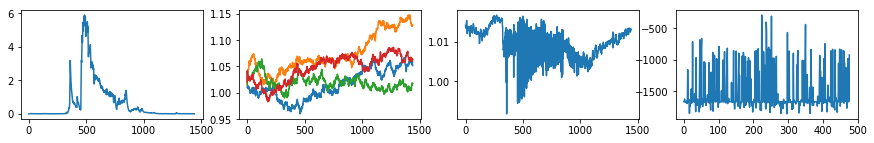

| Reward: -1669 | Episode: 477 | Qmax: -114.8240 | Action: [1.06086703 1.01698751 0.9651954  1.01981339]


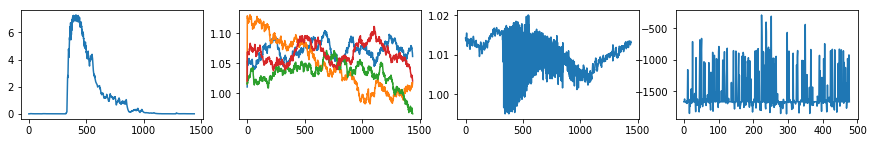

| Reward: -1682 | Episode: 478 | Qmax: -113.8034 | Action: [1.04615787 1.05501494 1.0707016  0.93617487]


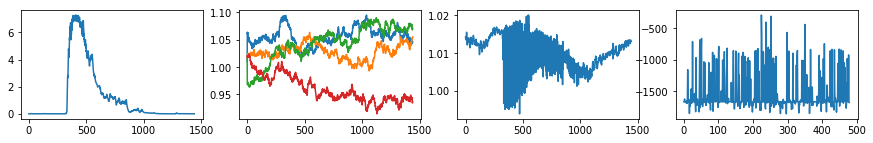

| Reward: -1641 | Episode: 479 | Qmax: -113.9335 | Action: [1.0401165  1.08848953 1.01737799 1.01892388]


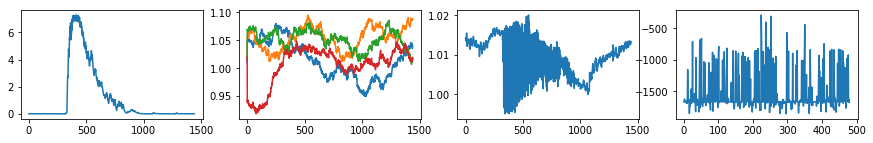

| Reward: -1679 | Episode: 480 | Qmax: -115.1209 | Action: [1.07997213 1.07824525 1.09294119 1.05477937]


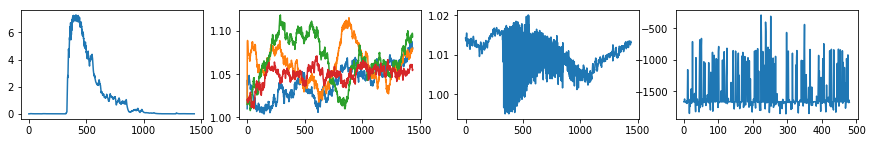

| Reward: -1669 | Episode: 481 | Qmax: -115.5685 | Action: [1.03039271 1.05539453 1.07126957 1.02965787]


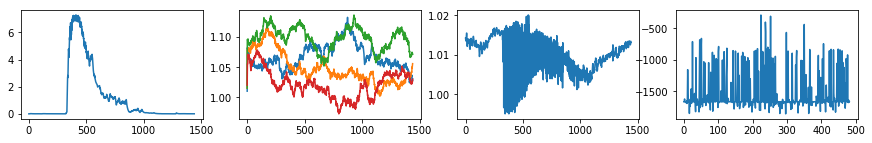

| Reward: -1669 | Episode: 482 | Qmax: -115.4833 | Action: [1.10476903 1.02522656 1.00586196 1.0269738 ]


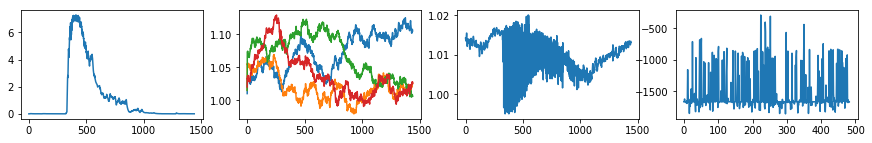

| Reward: -1764 | Episode: 483 | Qmax: -115.7448 | Action: [1.04645643 1.01294651 1.079586   1.07030216]


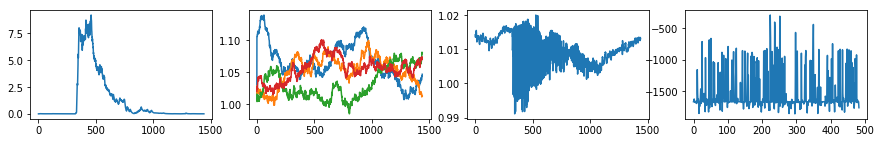

| Reward: -1669 | Episode: 484 | Qmax: -116.7724 | Action: [1.07510573 1.03172954 1.07923484 1.11315739]


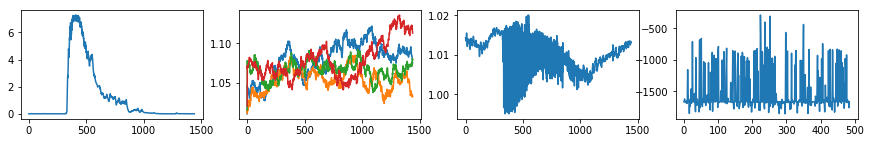

| Reward: -810 | Episode: 485 | Qmax: -118.0374 | Action: [1.1063686  1.01096029 0.99642509 1.12916916]


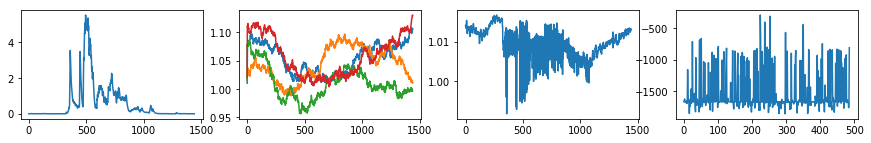

| Reward: -507 | Episode: 486 | Qmax: -118.4344 | Action: [1.11280096 1.07035981 1.0475582  1.09985532]


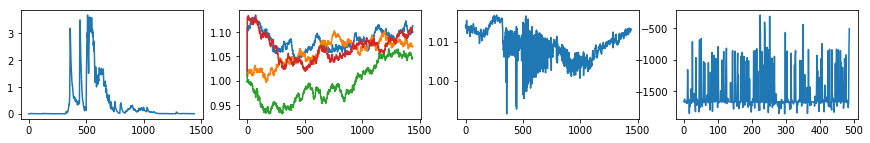

| Reward: -1669 | Episode: 487 | Qmax: -117.7512 | Action: [1.05192085 1.14913703 0.99111872 1.03830097]


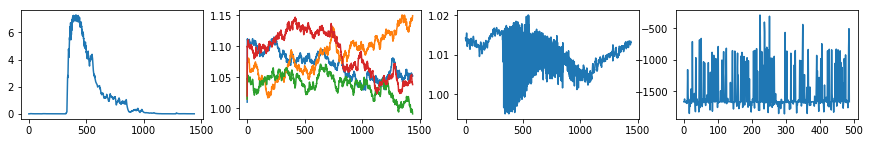

| Reward: -1669 | Episode: 488 | Qmax: -116.8473 | Action: [1.02495215 1.14837322 1.06279731 1.02979226]


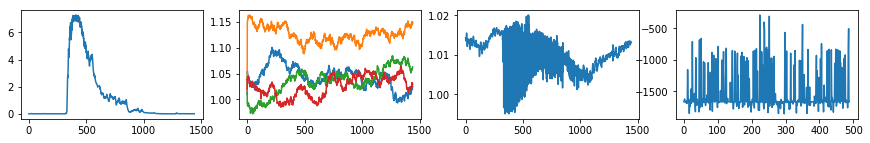

| Reward: -1482 | Episode: 489 | Qmax: -117.6497 | Action: [1.06907249 1.03460594 1.03151417 1.05787596]


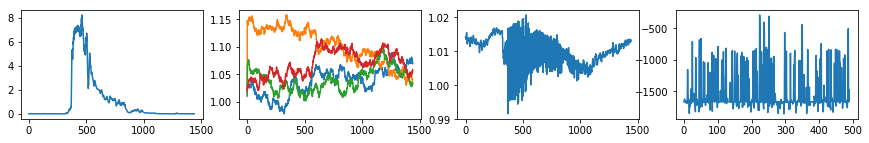

| Reward: -1652 | Episode: 490 | Qmax: -118.4742 | Action: [0.96631932 0.99638604 1.09063612 1.07662618]


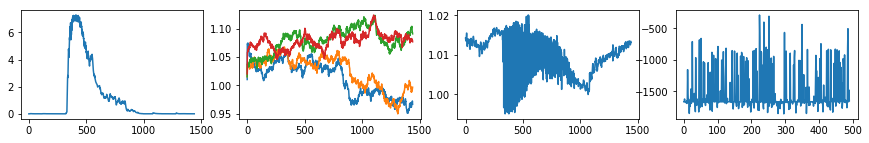

| Reward: -1719 | Episode: 491 | Qmax: -119.3226 | Action: [1.02169189 1.01847396 1.04631614 1.05072847]


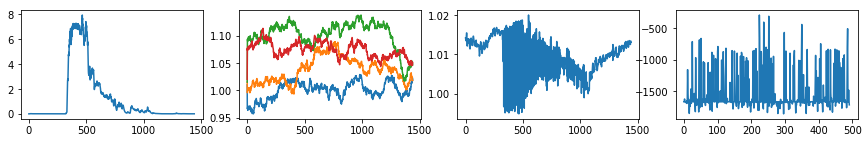

| Reward: -1669 | Episode: 492 | Qmax: -119.2068 | Action: [1.02314702 1.1114688  1.06809547 1.09039729]


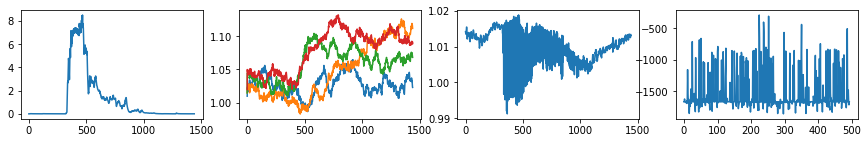

| Reward: -1669 | Episode: 493 | Qmax: -117.5560 | Action: [1.0725298  1.0618678  1.0420641  1.08339499]


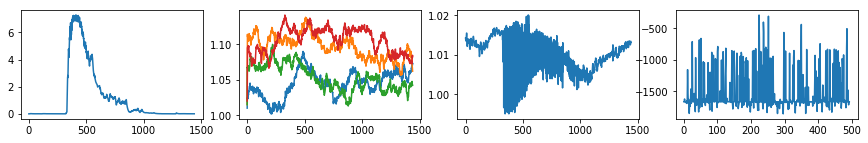

| Reward: -1669 | Episode: 494 | Qmax: -117.2981 | Action: [1.07646466 0.99136241 1.06492501 1.06101295]


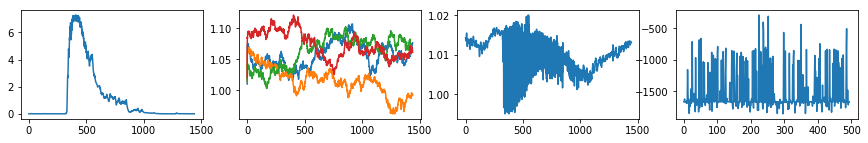

| Reward: -1639 | Episode: 495 | Qmax: -116.7009 | Action: [1.02508774 1.06606978 1.05232764 1.0140724 ]


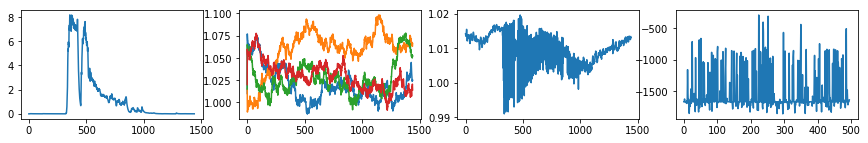

| Reward: -1675 | Episode: 496 | Qmax: -116.4592 | Action: [1.10369847 1.03217112 1.03043704 1.04178077]


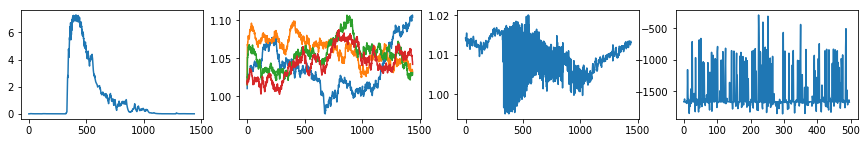

| Reward: -1765 | Episode: 497 | Qmax: -115.9816 | Action: [1.12705509 1.03581474 1.0338396  1.05805394]


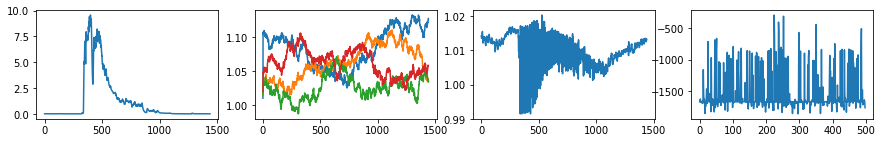

| Reward: -1669 | Episode: 498 | Qmax: -116.7656 | Action: [1.12770666 1.00258015 0.98383671 1.06595641]


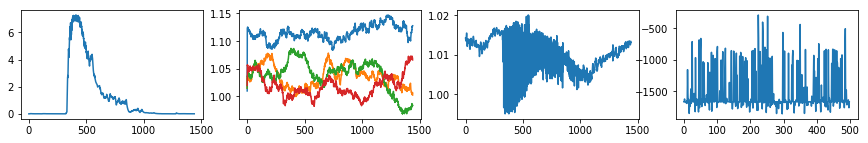

| Reward: -1488 | Episode: 499 | Qmax: -118.6682 | Action: [1.07867701 1.08502185 1.04608752 1.10102473]


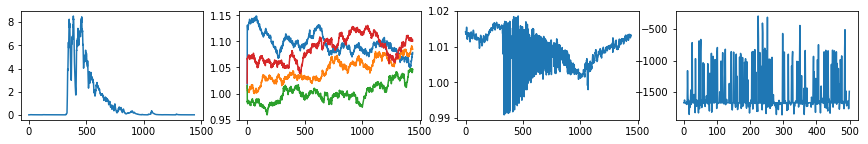

| Reward: -1669 | Episode: 500 | Qmax: -120.0002 | Action: [1.03483196 1.08448203 1.01920894 1.03081139]


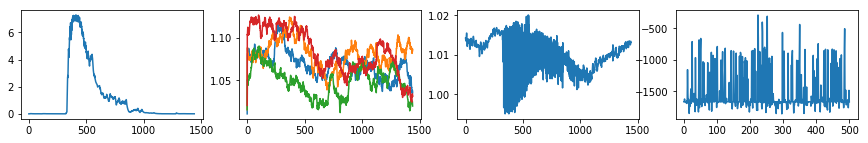

| Reward: -1657 | Episode: 501 | Qmax: -120.5910 | Action: [1.00096161 1.00232711 1.07807457 1.06794515]


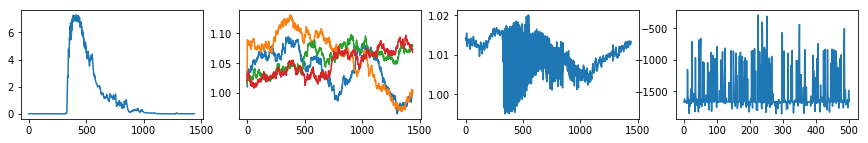

| Reward: -1646 | Episode: 502 | Qmax: -120.3048 | Action: [1.05736706 1.07751207 1.02957582 1.10698213]


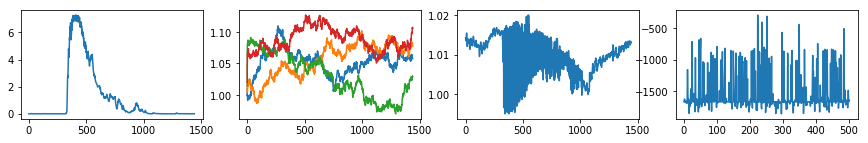

| Reward: -1675 | Episode: 503 | Qmax: -119.4873 | Action: [1.01767161 1.03417153 0.97544252 1.07239489]


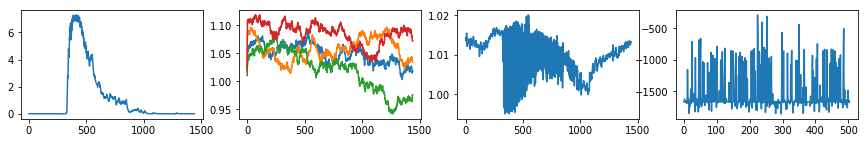

| Reward: -1227 | Episode: 504 | Qmax: -118.3720 | Action: [1.02675536 1.01200704 1.02552847 1.06379429]


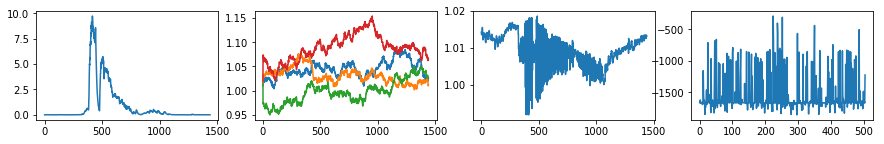

| Reward: -1648 | Episode: 505 | Qmax: -118.1730 | Action: [1.05307979 1.00501184 1.0478162  1.02911978]


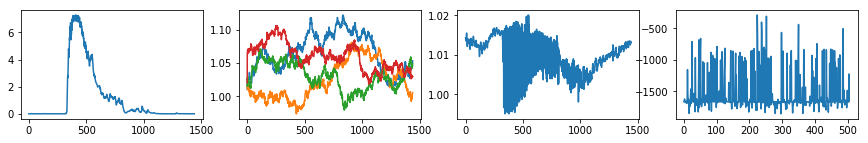

| Reward: -1734 | Episode: 506 | Qmax: -118.7110 | Action: [1.05417826 1.04974669 1.04967097 1.06146977]


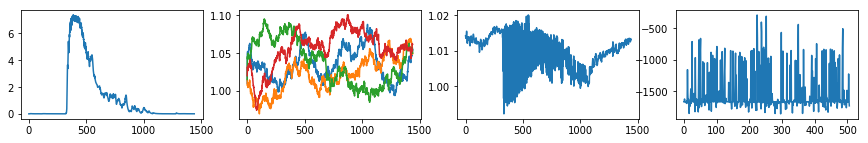

| Reward: -1669 | Episode: 507 | Qmax: -120.0650 | Action: [1.06578996 1.06647319 1.05628294 1.02258161]


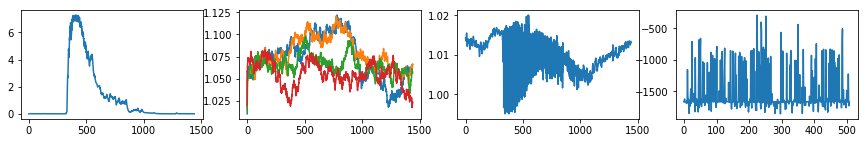

| Reward: -1669 | Episode: 508 | Qmax: -120.3170 | Action: [1.05593626 1.01220224 1.0354163  1.12035081]


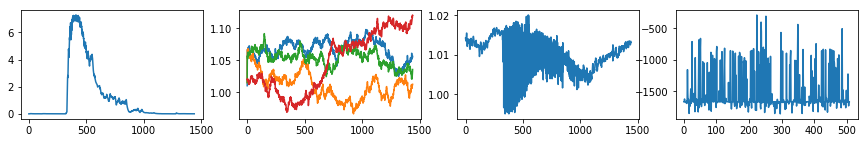

| Reward: -1616 | Episode: 509 | Qmax: -120.2903 | Action: [1.06720935 1.00349422 1.01748379 1.04844741]


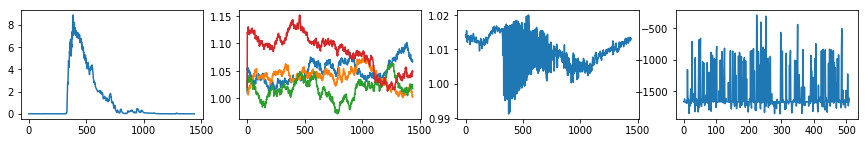

| Reward: -614 | Episode: 510 | Qmax: -119.0304 | Action: [1.01636474 1.01623408 0.99928962 1.07997532]


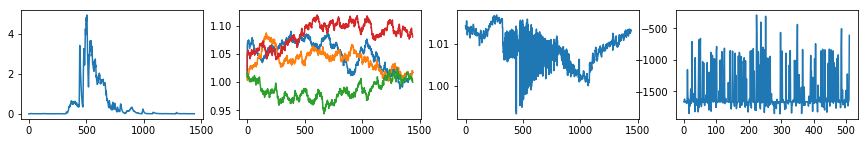

| Reward: -1680 | Episode: 511 | Qmax: -117.1819 | Action: [1.01492447 1.0457672  1.10197694 1.03735096]


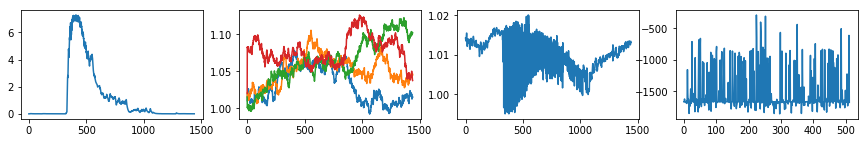

| Reward: -1723 | Episode: 512 | Qmax: -115.6417 | Action: [1.07502972 1.04860502 1.0558557  1.04749123]


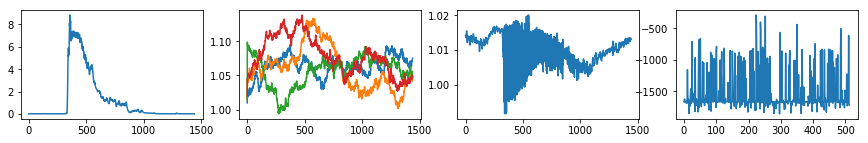

| Reward: -1660 | Episode: 513 | Qmax: -113.6645 | Action: [1.03784624 1.06628477 1.06573098 1.07686515]


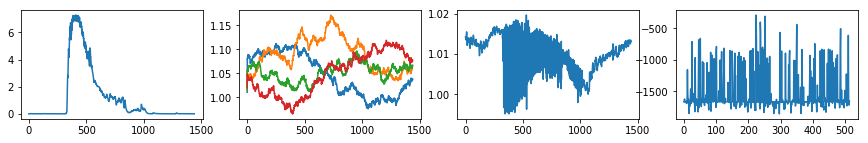

| Reward: -1661 | Episode: 514 | Qmax: -112.3197 | Action: [1.06043341 1.01308344 1.02142167 1.07195718]


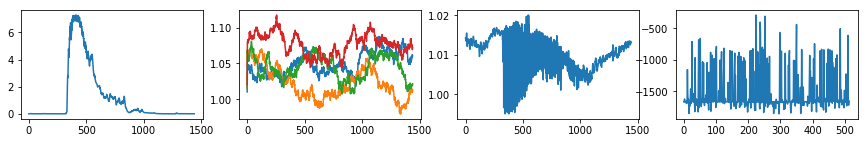

| Reward: -1436 | Episode: 515 | Qmax: -112.2967 | Action: [0.98476863 1.0020668  1.04608729 1.05696918]


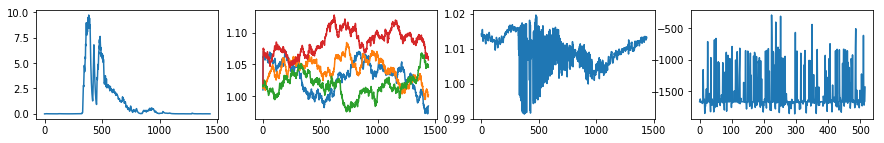

| Reward: -1663 | Episode: 516 | Qmax: -112.6758 | Action: [1.07450092 1.0696437  1.04081501 1.07787872]


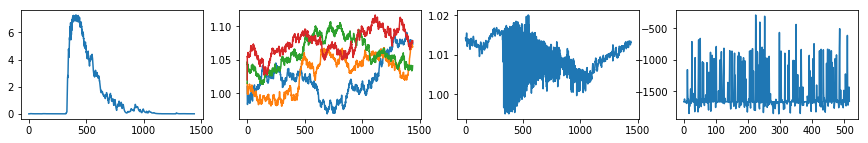

| Reward: -1678 | Episode: 517 | Qmax: -114.3119 | Action: [1.0240395  1.04405041 0.9807012  0.99303196]


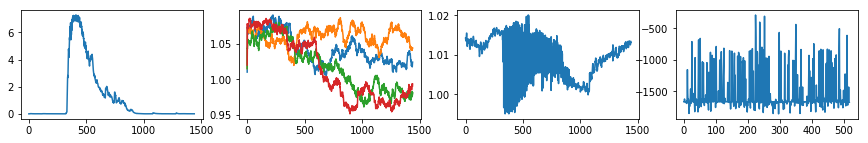

| Reward: -901 | Episode: 518 | Qmax: -116.1718 | Action: [1.05220969 1.11507692 1.12418152 1.04111498]


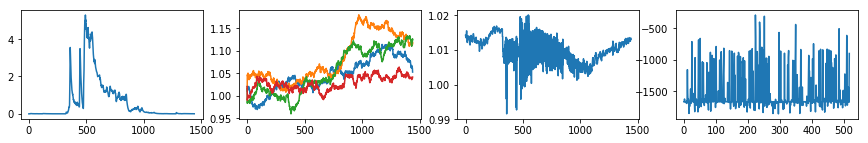

| Reward: -1669 | Episode: 519 | Qmax: -118.6297 | Action: [1.06414689 1.07786621 1.09748418 1.04755936]


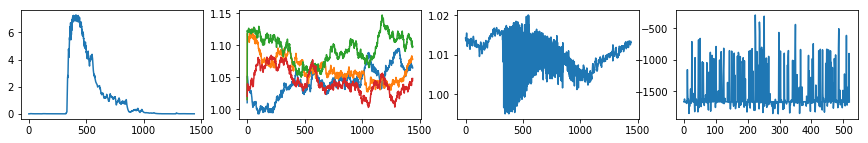

| Reward: -1673 | Episode: 520 | Qmax: -121.6587 | Action: [1.03140752 1.04702766 1.12341371 1.08513621]


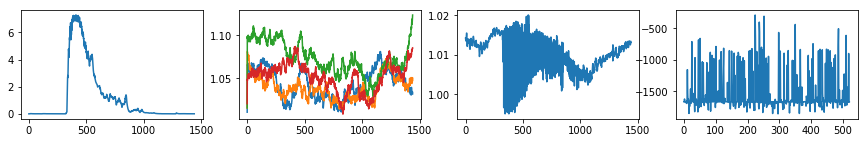

| Reward: -1669 | Episode: 521 | Qmax: -123.9382 | Action: [1.0556917  1.04735129 1.11224208 1.03245755]


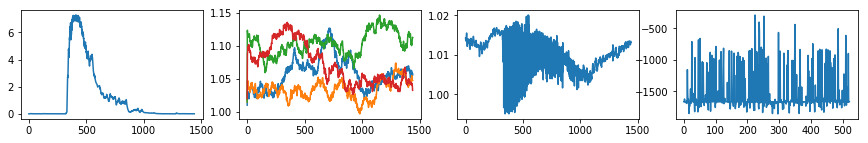

| Reward: -988 | Episode: 522 | Qmax: -126.3408 | Action: [0.99244898 1.0346494  1.05100219 1.03746396]


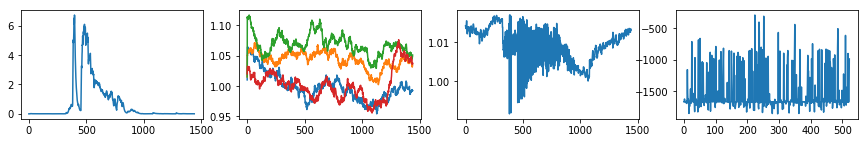

| Reward: -1631 | Episode: 523 | Qmax: -127.7219 | Action: [1.05360894 1.0136504  1.01296174 1.06835681]


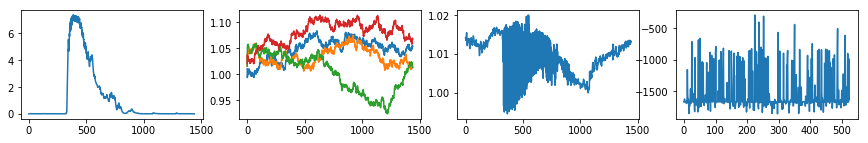

| Reward: -1672 | Episode: 524 | Qmax: -127.8889 | Action: [1.01055726 1.0528548  1.0604446  0.99976681]


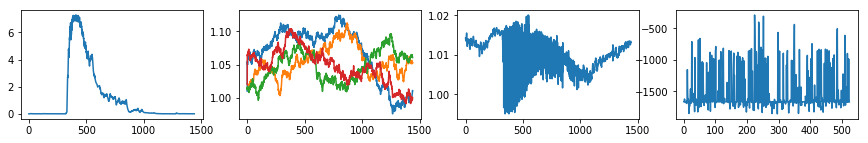

| Reward: -1669 | Episode: 525 | Qmax: -127.6699 | Action: [1.07392538 1.01030335 1.05278072 1.01719304]


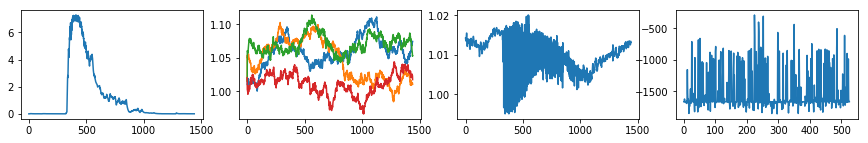

| Reward: -1691 | Episode: 526 | Qmax: -128.0956 | Action: [1.09802455 1.07563933 0.98475947 1.02298479]


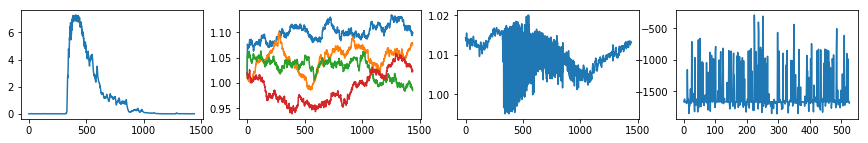

| Reward: -331 | Episode: 527 | Qmax: -128.2374 | Action: [0.98138834 1.10509359 1.0393715  1.02586992]


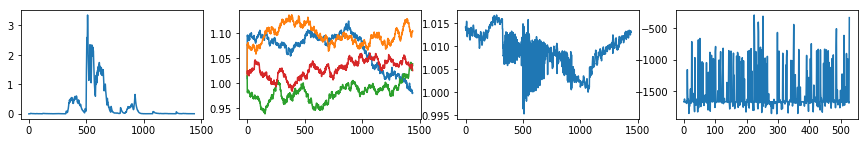

| Reward: -1407 | Episode: 528 | Qmax: -128.2574 | Action: [0.99627422 1.1141027  0.9931048  1.06740775]


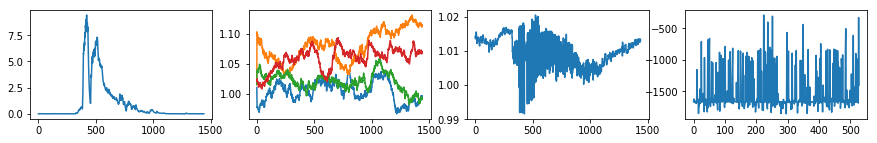

| Reward: -1840 | Episode: 529 | Qmax: -128.6384 | Action: [1.01396237 1.0841314  1.09405946 1.10655979]


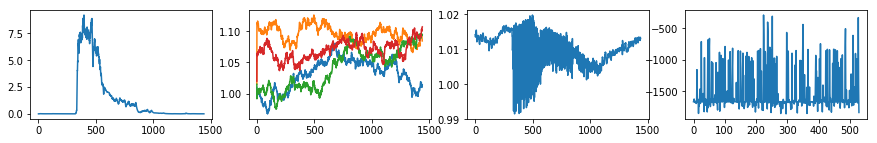

| Reward: -1744 | Episode: 530 | Qmax: -128.2035 | Action: [1.05631201 1.0764029  1.00612631 1.04657989]


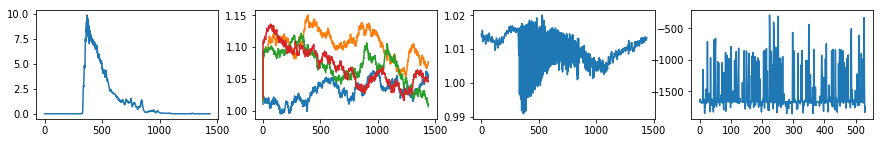

| Reward: -1669 | Episode: 531 | Qmax: -127.1615 | Action: [1.0788728  1.0634164  1.06281082 1.06375718]


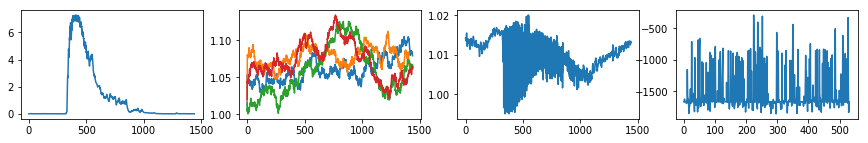

| Reward: -1669 | Episode: 532 | Qmax: -125.5358 | Action: [1.05993313 1.09088986 1.09889449 1.03756553]


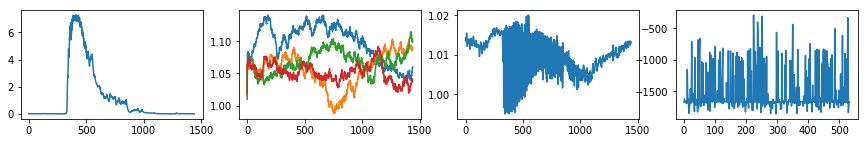

| Reward: -1671 | Episode: 533 | Qmax: -124.3407 | Action: [0.98172943 1.0168731  1.13067584 1.03021947]


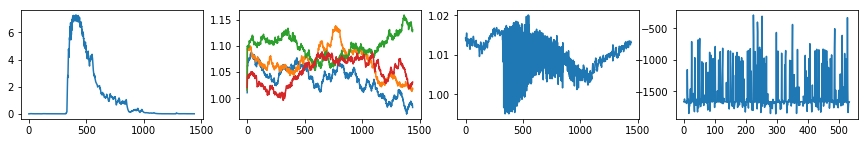

| Reward: -1152 | Episode: 534 | Qmax: -124.7201 | Action: [1.02464816 1.05044118 1.09980895 1.09630564]


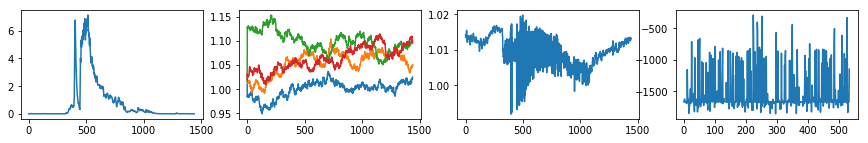

| Reward: -770 | Episode: 535 | Qmax: -123.7513 | Action: [1.03801256 1.074558   1.04098128 1.05287025]


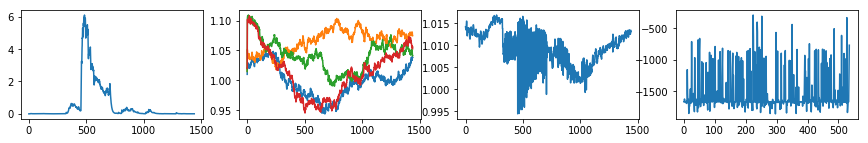

| Reward: -1717 | Episode: 536 | Qmax: -122.3157 | Action: [1.05060896 1.0920197  1.02573395 1.04791146]


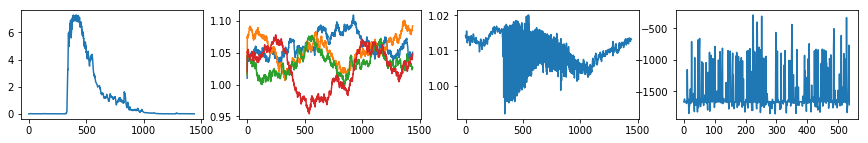

| Reward: -1669 | Episode: 537 | Qmax: -122.3368 | Action: [1.08156528 1.01144387 1.04586241 1.00694669]


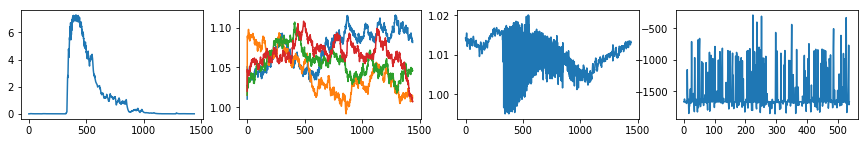

| Reward: -1781 | Episode: 538 | Qmax: -121.2240 | Action: [1.00680544 0.95993349 1.05296563 1.06503263]


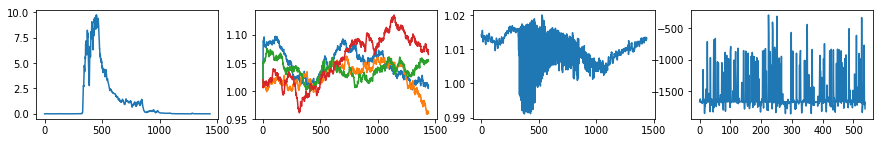

| Reward: -1669 | Episode: 539 | Qmax: -120.2786 | Action: [1.06537941 1.00001942 1.16769962 1.08250844]


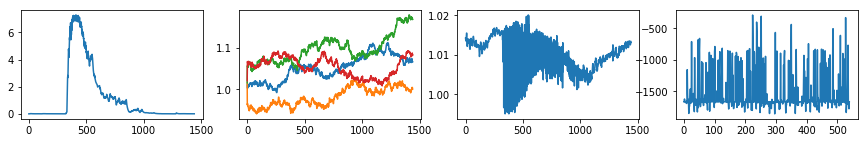

| Reward: -1669 | Episode: 540 | Qmax: -119.6734 | Action: [1.0157073  1.04473363 1.08245513 1.06523073]


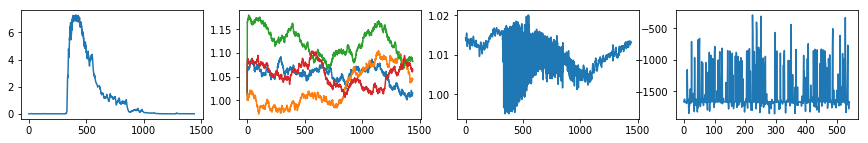

| Reward: -1703 | Episode: 541 | Qmax: -119.4437 | Action: [1.06868834 1.03612185 1.04077375 1.0328647 ]


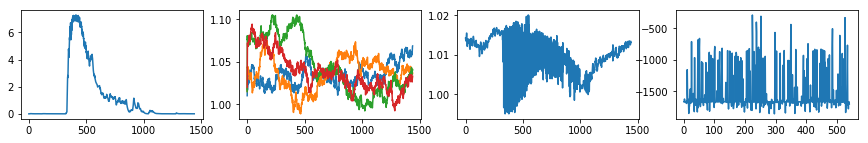

| Reward: -1184 | Episode: 542 | Qmax: -118.8006 | Action: [1.03079464 1.00753171 1.05855499 1.05518965]


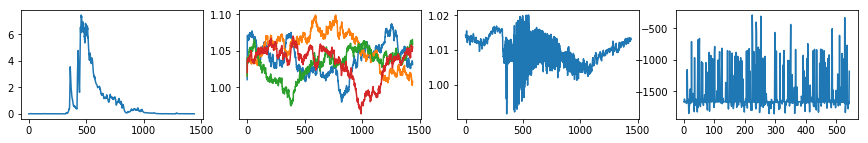

| Reward: -1807 | Episode: 543 | Qmax: -118.5192 | Action: [1.06599027 1.05237747 1.0544537  0.99902659]


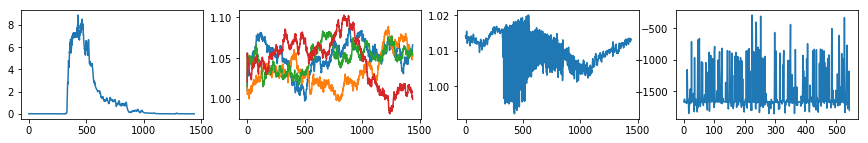

| Reward: -1672 | Episode: 544 | Qmax: -117.0282 | Action: [0.99973811 1.07842645 1.03075722 1.05128596]


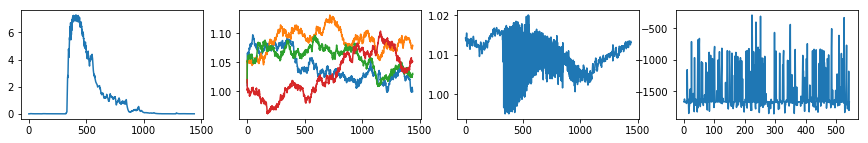

| Reward: -1713 | Episode: 545 | Qmax: -116.4224 | Action: [1.04150284 1.01829186 1.07366713 1.05393295]


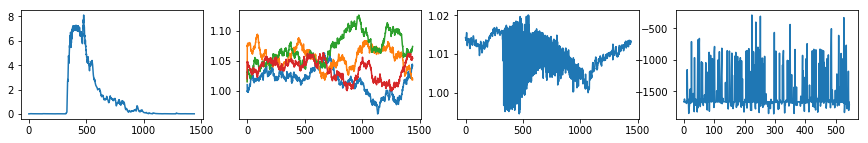

| Reward: -1669 | Episode: 546 | Qmax: -116.3401 | Action: [0.99935225 1.02640414 1.08059603 1.07216615]


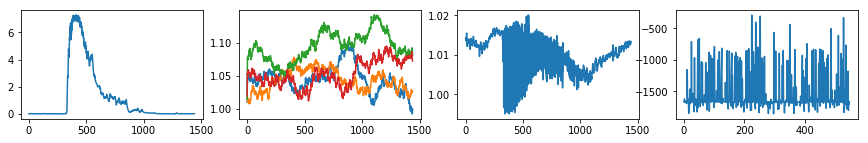

| Reward: -899 | Episode: 547 | Qmax: -116.2919 | Action: [1.0213957  1.02432497 1.08267497 1.00455355]


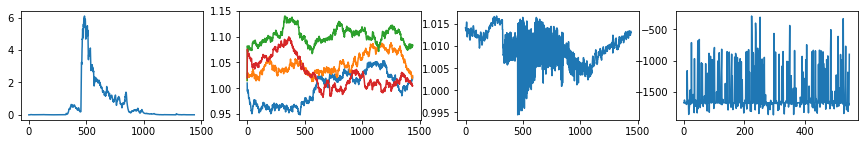

| Reward: -1669 | Episode: 548 | Qmax: -116.6491 | Action: [1.07395754 1.07641151 1.10959075 1.0803949 ]


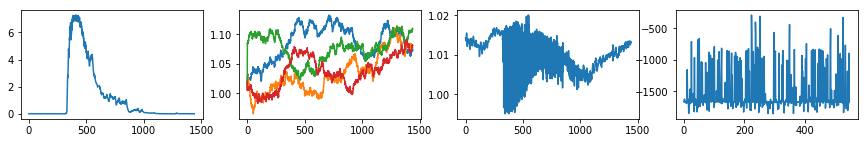

| Reward: -1669 | Episode: 549 | Qmax: -117.9664 | Action: [1.0554551  1.087971   1.01748013 1.10172961]


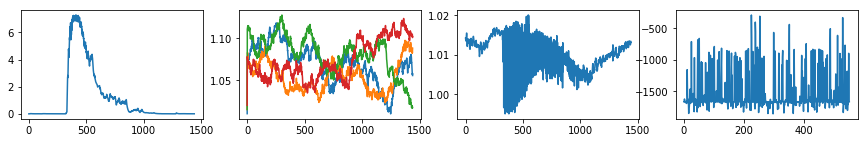

| Reward: -1547 | Episode: 550 | Qmax: -118.3991 | Action: [1.0248881  1.11043509 1.0684045  1.08822893]


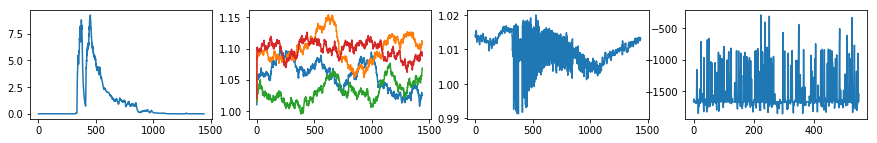

| Reward: -1636 | Episode: 551 | Qmax: -118.2504 | Action: [0.9973902  1.05102268 1.10599353 0.99543765]


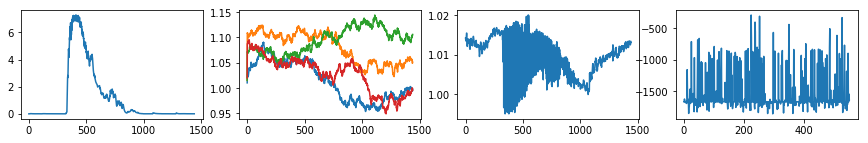

| Reward: -1689 | Episode: 552 | Qmax: -117.9747 | Action: [1.06145282 1.08573524 1.06403424 1.06762906]


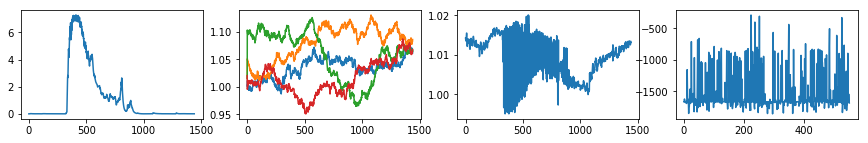

| Reward: -1431 | Episode: 553 | Qmax: -118.8537 | Action: [1.0275153  1.03983696 1.11129395 1.04584083]


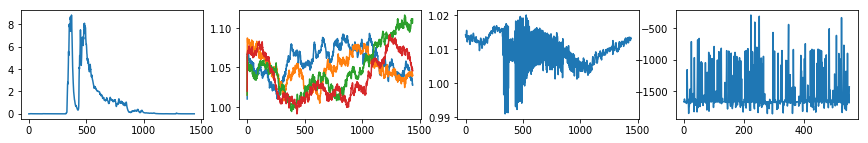

| Reward: -1575 | Episode: 554 | Qmax: -119.0438 | Action: [1.10746514 1.08475581 1.06832727 1.03809725]


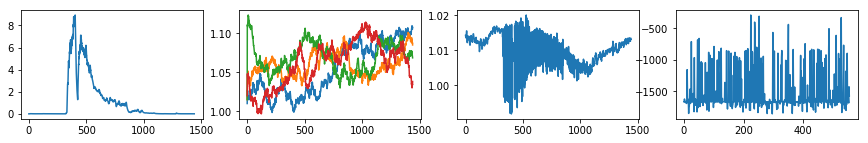

| Reward: -1624 | Episode: 555 | Qmax: -119.2209 | Action: [0.99228261 1.07238771 0.97160989 1.0322467 ]


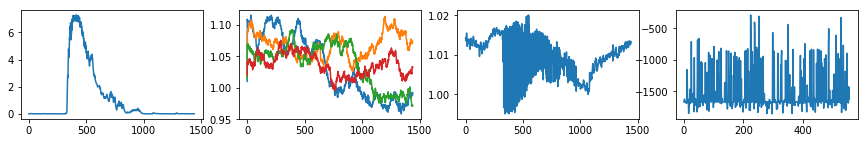

| Reward: -1669 | Episode: 556 | Qmax: -119.4190 | Action: [1.08008636 1.12836452 0.99105203 1.14179364]


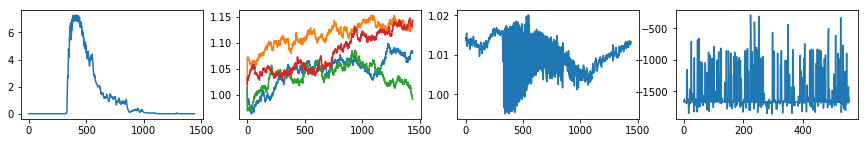

| Reward: -1616 | Episode: 557 | Qmax: -119.3769 | Action: [1.05263119 1.10007049 1.07593413 1.066167  ]


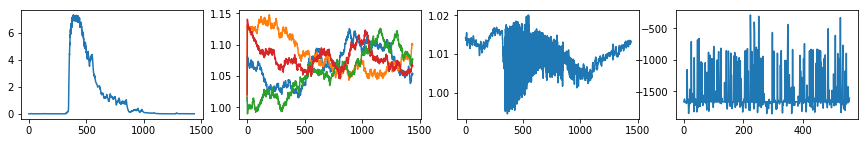

| Reward: -1693 | Episode: 558 | Qmax: -120.4093 | Action: [0.9499629  1.06247174 1.01692997 1.08694004]


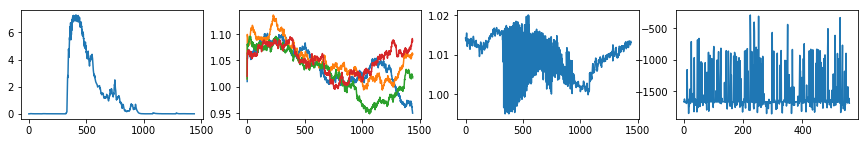

| Reward: -1768 | Episode: 559 | Qmax: -121.6777 | Action: [1.12175455 0.99903354 1.04684345 1.08353257]


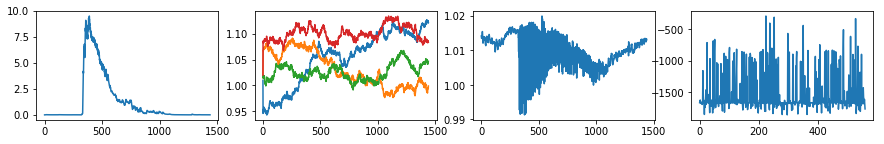

| Reward: -1669 | Episode: 560 | Qmax: -122.5550 | Action: [1.1104204  0.98679643 1.02699601 1.04987893]


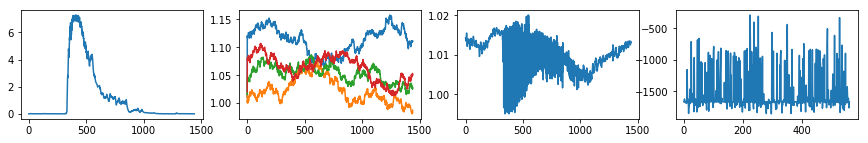

| Reward: -1518 | Episode: 561 | Qmax: -123.8161 | Action: [1.03121287 1.07564646 1.032008   1.12082039]


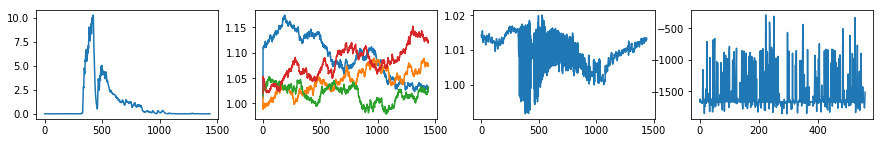

| Reward: -899 | Episode: 562 | Qmax: -125.2706 | Action: [1.0061277  1.05839303 1.05084757 1.02253684]


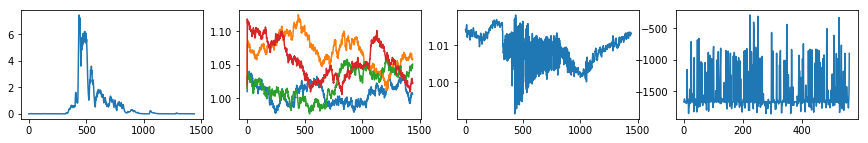

| Reward: -1691 | Episode: 563 | Qmax: -125.8729 | Action: [1.09682968 0.98514135 1.03265569 1.08248604]


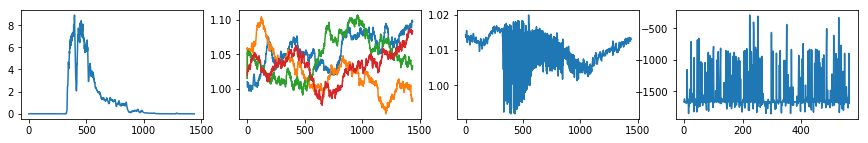

| Reward: -1479 | Episode: 564 | Qmax: -125.4994 | Action: [1.01697161 1.04882219 1.07732958 1.05137396]


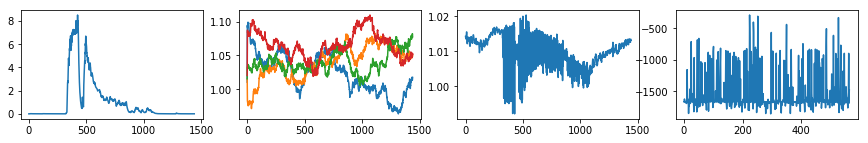

| Reward: -845 | Episode: 565 | Qmax: -124.3571 | Action: [0.98252688 1.02117039 1.03762905 1.04790719]


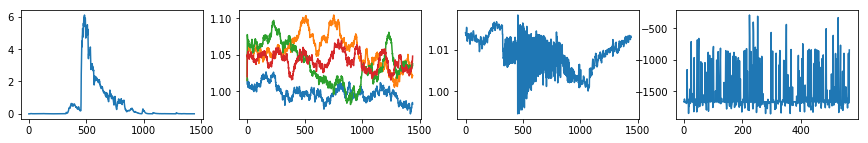

| Reward: -1619 | Episode: 566 | Qmax: -123.7415 | Action: [0.98997598 1.06970781 1.07518732 1.05555047]


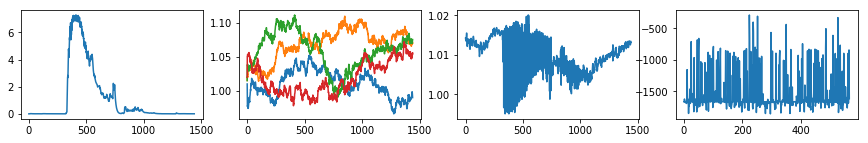

| Reward: -1494 | Episode: 567 | Qmax: -124.1021 | Action: [1.00223081 1.09948096 1.09578405 1.06278861]


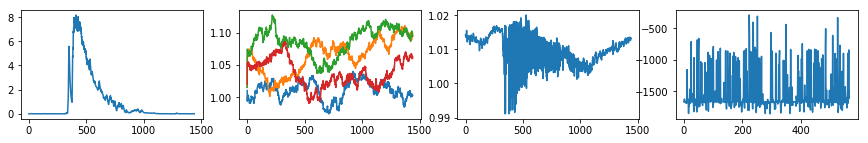

| Reward: -951 | Episode: 568 | Qmax: -125.0455 | Action: [1.1123037  1.02622339 1.07405523 1.03555848]


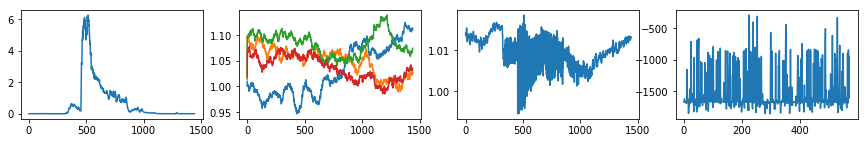

| Reward: -1669 | Episode: 569 | Qmax: -125.1502 | Action: [1.06603934 1.04342024 1.11639881 1.04402089]


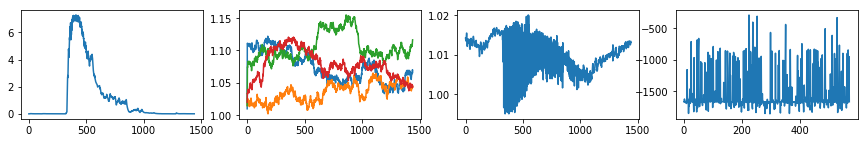

| Reward: -1674 | Episode: 570 | Qmax: -126.3306 | Action: [1.04342964 1.00081282 1.00630699 1.01504613]


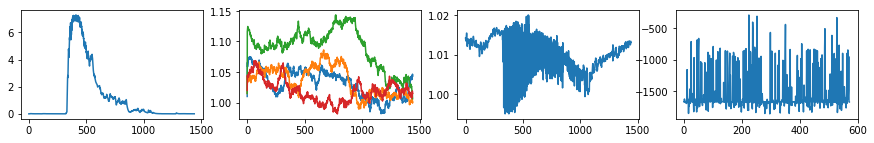

| Reward: -1695 | Episode: 571 | Qmax: -127.2638 | Action: [1.01385674 1.02447121 1.05312087 1.02205501]


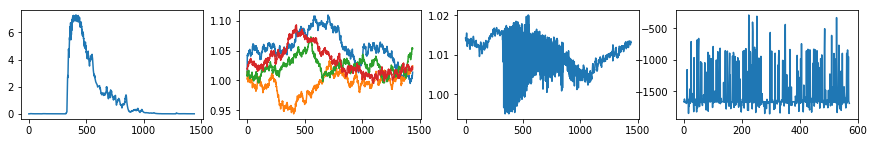

| Reward: -1669 | Episode: 572 | Qmax: -127.1519 | Action: [1.04479489 1.00081436 1.08102092 1.03356764]


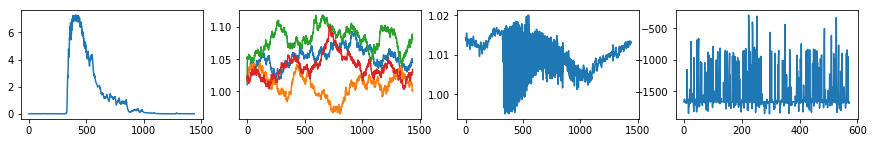

| Reward: -1669 | Episode: 573 | Qmax: -126.2462 | Action: [1.0689366  1.07641382 1.05047703 1.04901441]


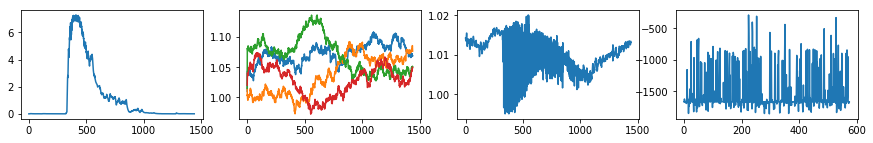

| Reward: -1803 | Episode: 574 | Qmax: -125.0849 | Action: [1.0166231  1.09106395 1.07475288 1.10239756]


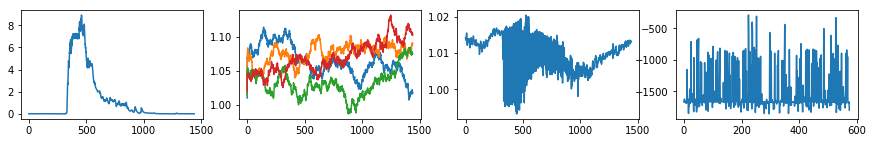

| Reward: -1666 | Episode: 575 | Qmax: -124.2503 | Action: [1.07276769 1.06943251 1.04544852 0.99424024]


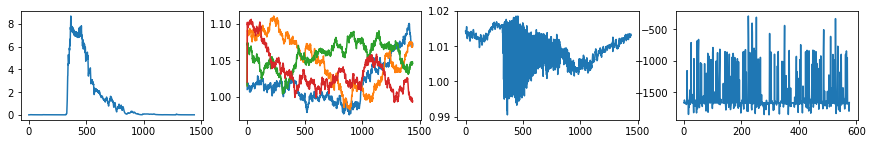

| Reward: -1673 | Episode: 576 | Qmax: -124.4031 | Action: [1.0231162  1.03823569 1.03967924 1.03992503]


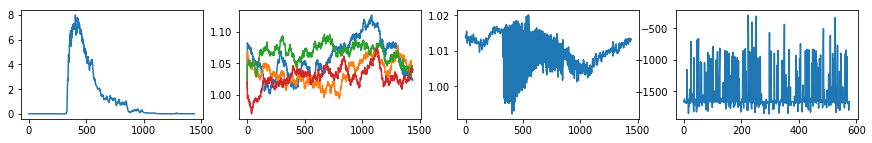

| Reward: -702 | Episode: 577 | Qmax: -124.3588 | Action: [0.95372561 1.04732743 1.0644198  1.03837549]


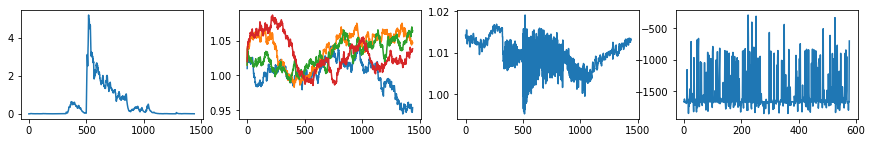

| Reward: -1131 | Episode: 578 | Qmax: -124.5843 | Action: [1.0155913  1.03640422 0.99637513 1.04190996]


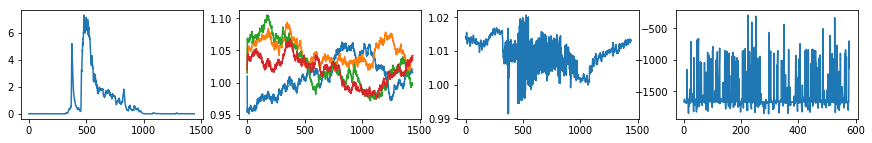

| Reward: -1684 | Episode: 579 | Qmax: -124.1796 | Action: [1.07802768 1.02036777 1.0446033  1.09858492]


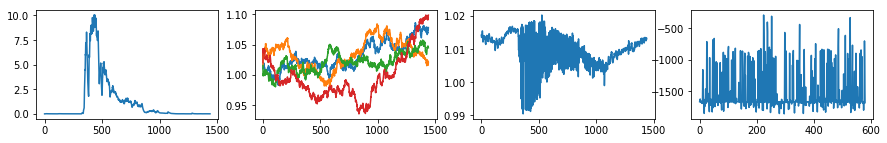

| Reward: -1669 | Episode: 580 | Qmax: -122.9711 | Action: [1.02034837 1.10537956 1.11903763 1.04621653]


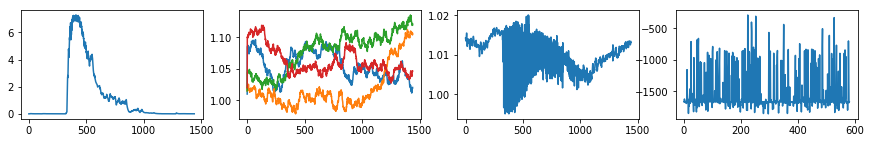

| Reward: -1681 | Episode: 581 | Qmax: -121.1487 | Action: [1.05546184 1.12810065 1.09825449 1.03359513]


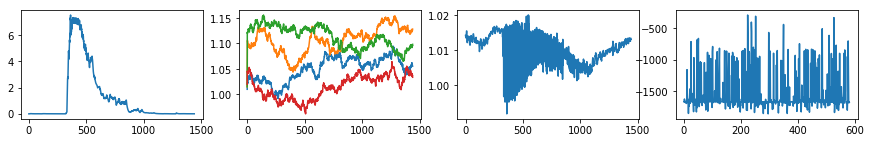

| Reward: -850 | Episode: 582 | Qmax: -119.2605 | Action: [1.03710786 1.07550324 1.11124808 1.08732476]


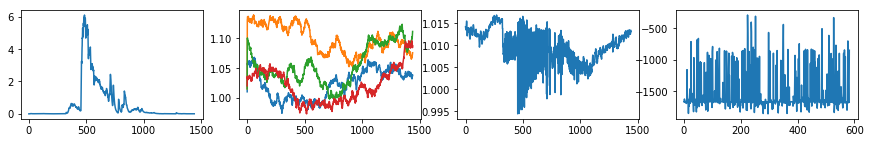

| Reward: -1669 | Episode: 583 | Qmax: -119.1176 | Action: [1.04642285 1.1327555  0.91849877 1.10672016]


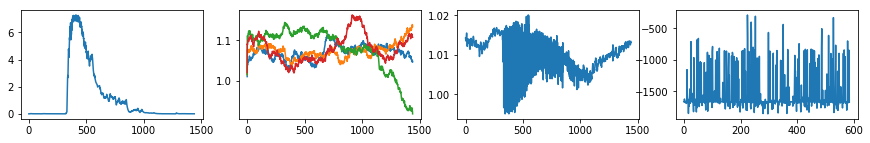

| Reward: -1142 | Episode: 584 | Qmax: -120.0446 | Action: [1.00813622 1.08602505 1.06001953 1.00173339]


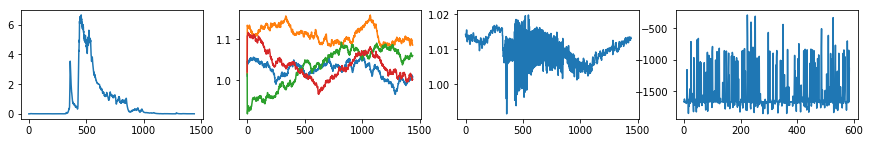

| Reward: -868 | Episode: 585 | Qmax: -121.7604 | Action: [0.97314997 1.07519548 1.03190132 0.99734857]


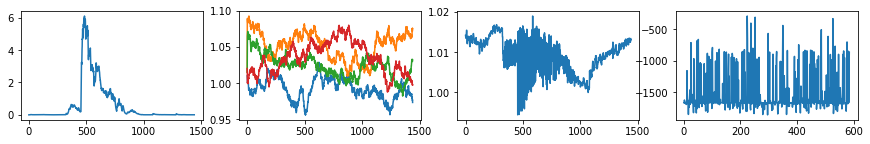

| Reward: -1687 | Episode: 586 | Qmax: -121.6486 | Action: [1.02302419 1.05964012 1.05028536 1.01836832]


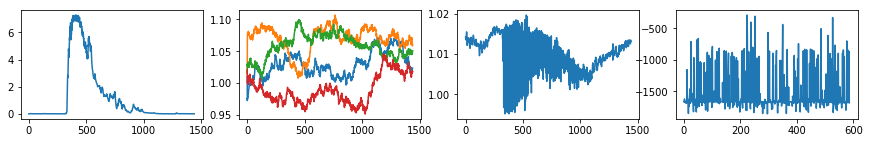

| Reward: -956 | Episode: 587 | Qmax: -122.1425 | Action: [0.980432   1.07459338 1.05947057 1.1087024 ]


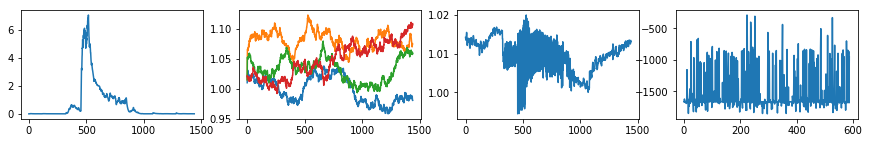

| Reward: -865 | Episode: 588 | Qmax: -122.5301 | Action: [1.09474561 1.06948147 1.08389311 1.06905935]


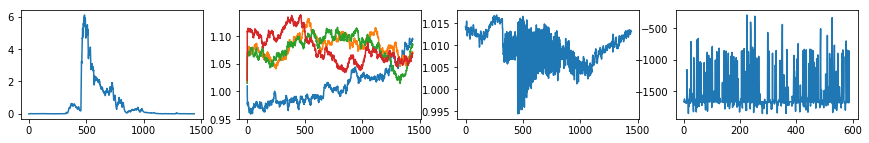

| Reward: -1670 | Episode: 589 | Qmax: -122.7383 | Action: [1.03737893 1.05136901 0.9904996  1.10473295]


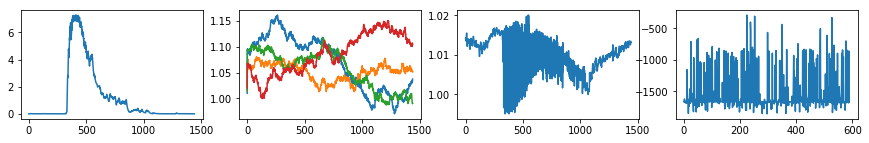

| Reward: -1464 | Episode: 590 | Qmax: -122.3134 | Action: [1.02997627 1.05599125 1.0008367  1.01684292]


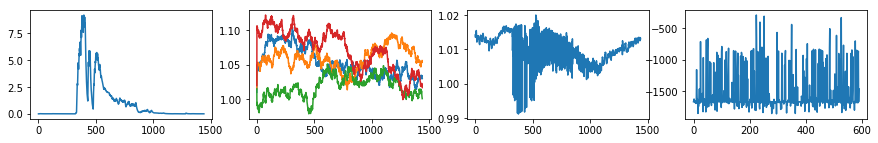

| Reward: -1675 | Episode: 591 | Qmax: -121.5597 | Action: [1.05437011 1.08333791 0.9801967  1.0206767 ]


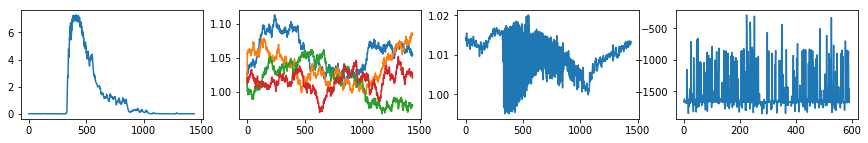

| Reward: -459 | Episode: 592 | Qmax: -121.1665 | Action: [1.04491702 1.03131897 1.02987639 1.03657038]


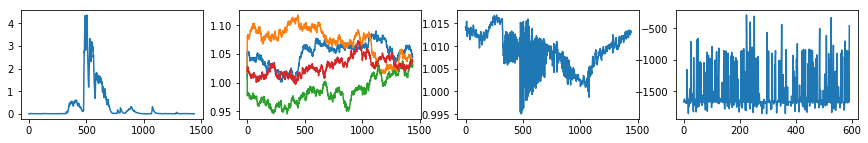

| Reward: -1669 | Episode: 593 | Qmax: -120.9484 | Action: [1.10738764 1.05565016 1.08193682 1.03687074]


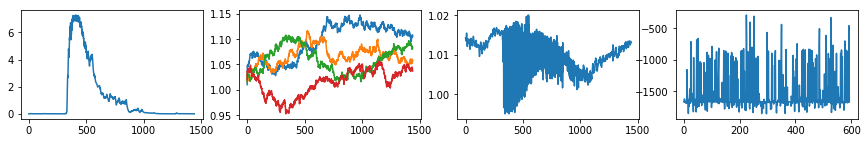

| Reward: -1669 | Episode: 594 | Qmax: -121.2629 | Action: [1.03236018 1.02545159 1.09180495 1.06111851]


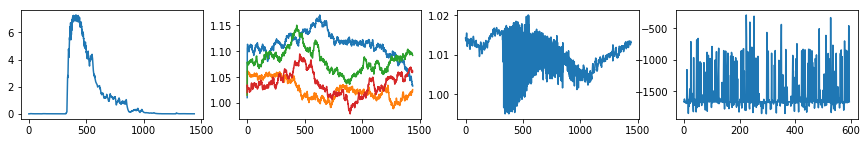

| Reward: -1329 | Episode: 595 | Qmax: -120.6638 | Action: [1.01931225 1.00566002 1.02080877 1.05652449]


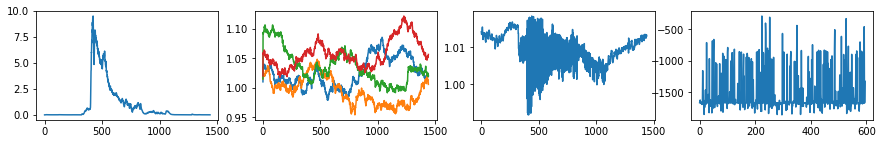

| Reward: -1448 | Episode: 596 | Qmax: -121.5164 | Action: [1.03254983 1.09142324 1.07271115 1.07165469]


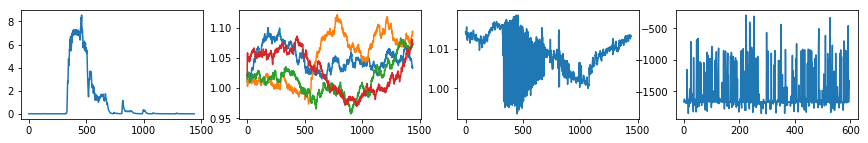

| Reward: -1669 | Episode: 597 | Qmax: -121.6816 | Action: [1.06331548 1.07071725 1.01596443 1.14289725]


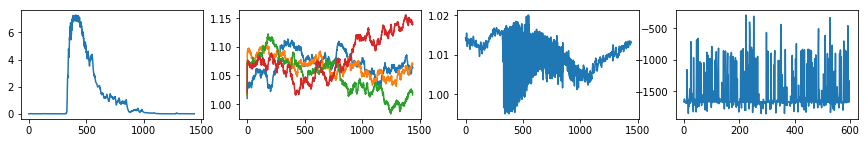

| Reward: -1669 | Episode: 598 | Qmax: -120.5479 | Action: [1.09203727 1.02934676 1.06447478 1.00684458]


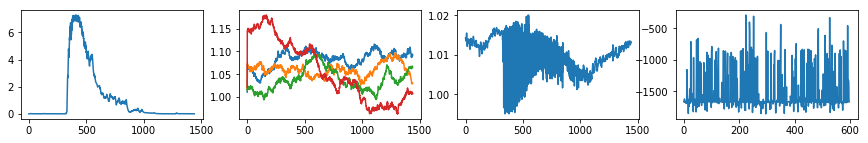

| Reward: -1671 | Episode: 599 | Qmax: -119.9363 | Action: [1.05016547 1.03201971 1.08165279 1.04300481]


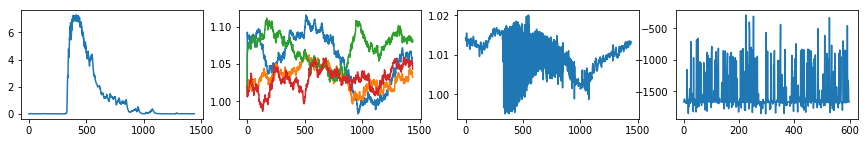

| Reward: -1687 | Episode: 600 | Qmax: -118.7848 | Action: [1.05854285 1.07238581 1.07325671 1.04894202]


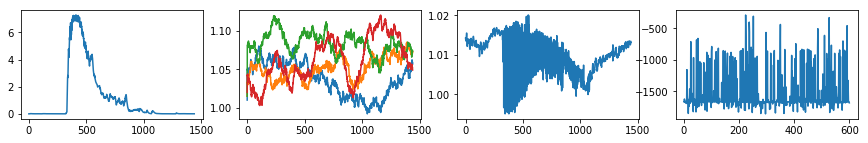

| Reward: -1652 | Episode: 601 | Qmax: -118.8034 | Action: [1.0107514  0.99128909 1.08777862 1.01825981]


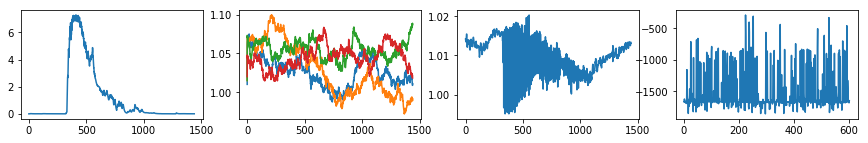

| Reward: -1741 | Episode: 602 | Qmax: -119.3424 | Action: [1.0262146  1.06759845 1.06185063 1.0417348 ]


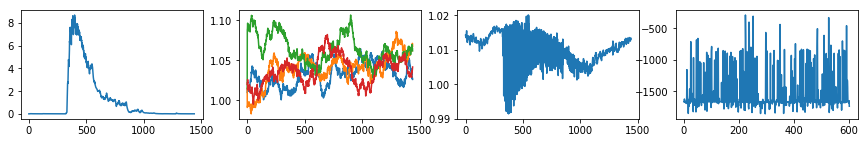

| Reward: -1729 | Episode: 603 | Qmax: -120.1834 | Action: [1.04660787 1.02580164 1.06804482 1.01673129]


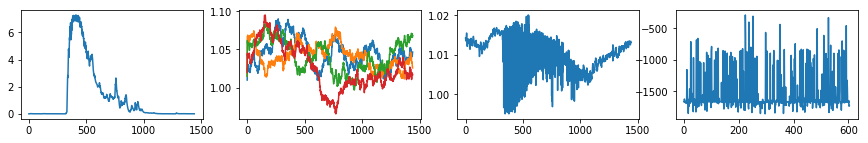

| Reward: -1651 | Episode: 604 | Qmax: -119.8451 | Action: [1.04068562 1.03936835 0.96986466 0.99975031]


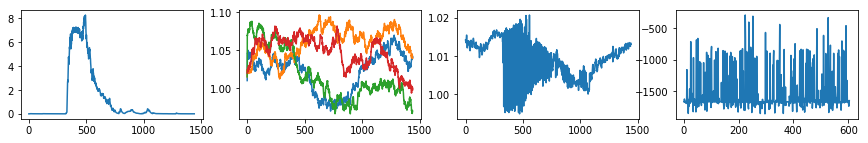

| Reward: -1495 | Episode: 605 | Qmax: -121.0209 | Action: [1.05966398 0.99311378 1.08264532 1.02791395]


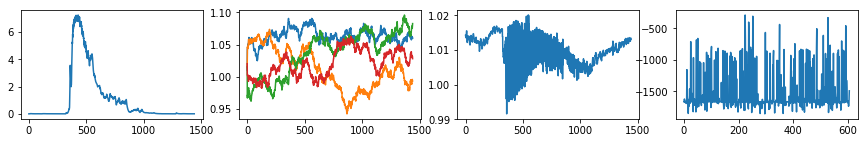

| Reward: -1669 | Episode: 606 | Qmax: -121.5299 | Action: [1.03318999 1.03173538 1.05467274 1.04764222]


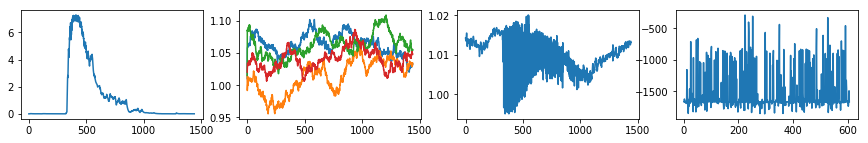

| Reward: -1669 | Episode: 607 | Qmax: -122.3162 | Action: [1.05012485 1.02965022 1.0246713  1.02890798]


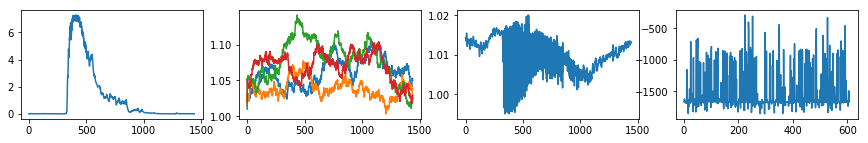

| Reward: -1669 | Episode: 608 | Qmax: -121.6006 | Action: [1.02096951 1.03082811 1.06929764 1.05943321]


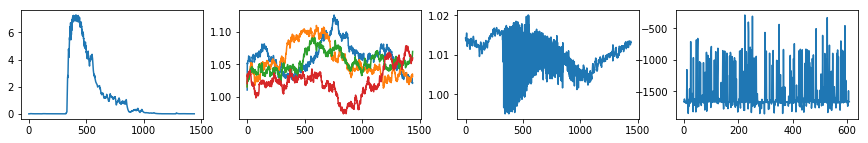

| Reward: -1655 | Episode: 609 | Qmax: -121.1544 | Action: [1.02001623 1.05892845 1.02076468 1.03604465]


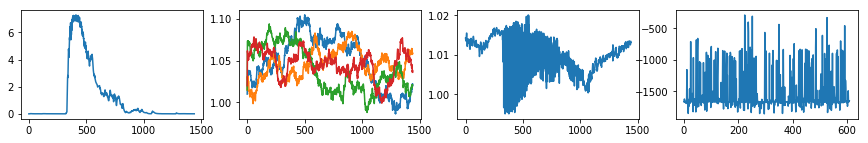

| Reward: -1289 | Episode: 610 | Qmax: -120.4580 | Action: [1.0444718  1.0669116  1.13597745 1.03679635]


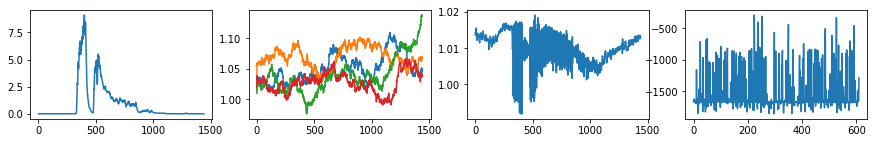

| Reward: -1669 | Episode: 611 | Qmax: -120.8680 | Action: [1.01367189 1.02778082 1.03016752 1.01553019]


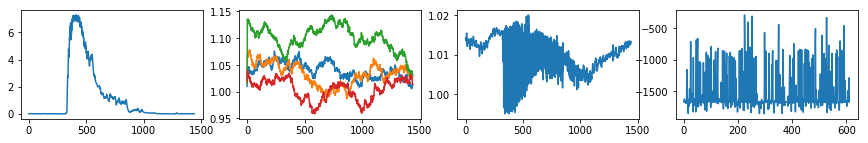

| Reward: -1555 | Episode: 612 | Qmax: -120.2320 | Action: [1.05322528 1.07353284 1.03069925 1.09188459]


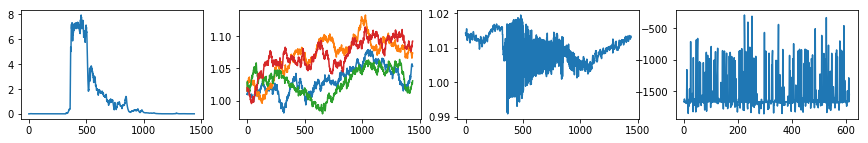

| Reward: -1669 | Episode: 613 | Qmax: -120.4622 | Action: [1.02088157 1.03925688 1.06605141 1.01627989]


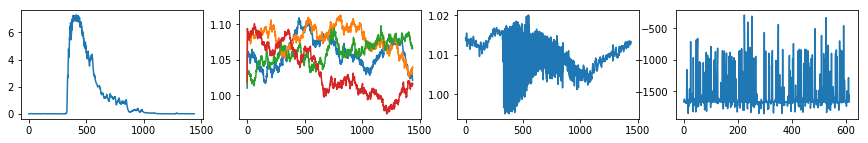

| Reward: -1669 | Episode: 614 | Qmax: -120.3475 | Action: [1.10486642 1.00960155 1.06188546 1.13245081]


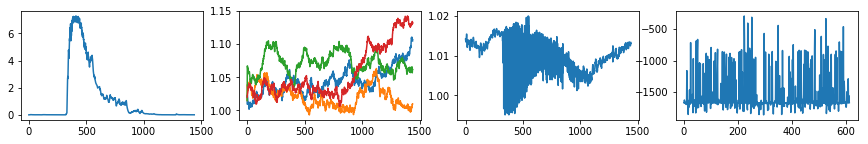

| Reward: -1669 | Episode: 615 | Qmax: -121.0584 | Action: [1.07034899 1.06263155 1.08948369 1.07926616]


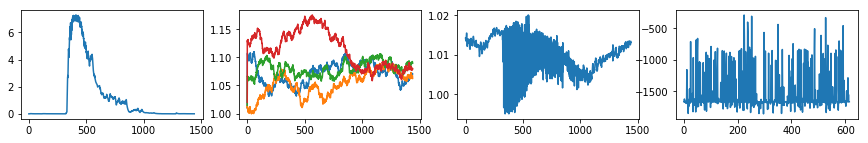

| Reward: -1683 | Episode: 616 | Qmax: -121.1919 | Action: [1.09675165 1.05709918 1.05684682 1.02368508]


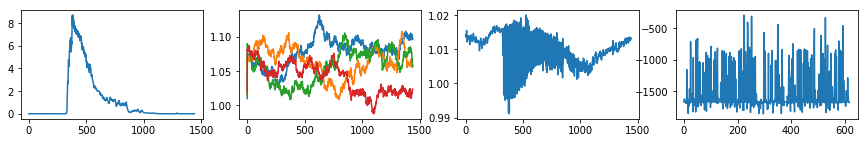

| Reward: -1669 | Episode: 617 | Qmax: -121.4839 | Action: [1.0337761  1.01293516 1.08763144 1.099691  ]


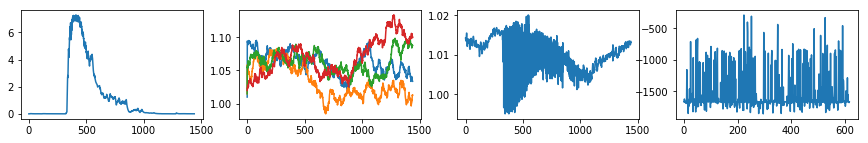

| Reward: -1211 | Episode: 618 | Qmax: -121.6551 | Action: [1.08565107 1.03219165 1.00167724 1.03074489]


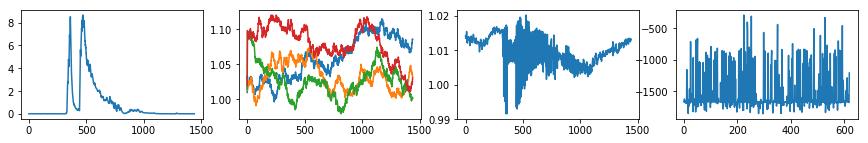

| Reward: -1669 | Episode: 619 | Qmax: -121.2605 | Action: [1.02375974 1.04529375 1.08630247 1.07084852]


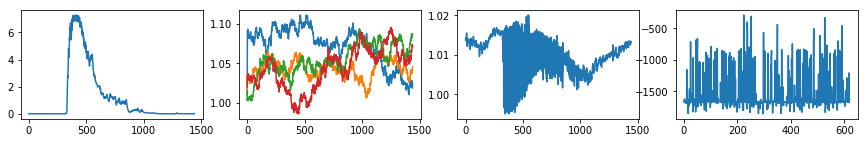

| Reward: -1669 | Episode: 620 | Qmax: -120.8009 | Action: [1.0479546  1.07909758 1.06131104 1.01048036]


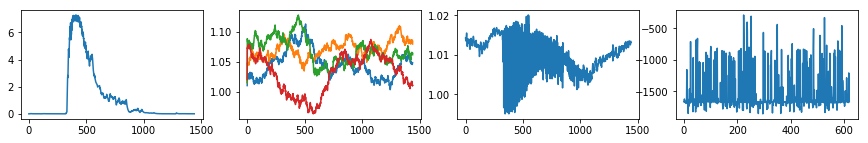

| Reward: -1679 | Episode: 621 | Qmax: -120.2938 | Action: [1.00457944 1.04978163 1.07438521 1.07907239]


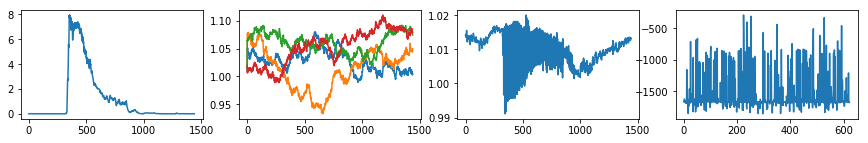

| Reward: -1502 | Episode: 622 | Qmax: -117.9805 | Action: [1.03133517 1.03766416 1.03513527 1.13520877]


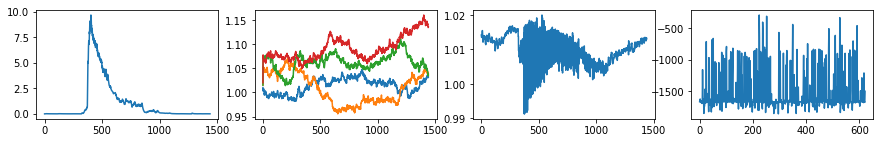

| Reward: -1742 | Episode: 623 | Qmax: -116.0397 | Action: [1.07355572 1.0807752  1.07395523 1.14323737]


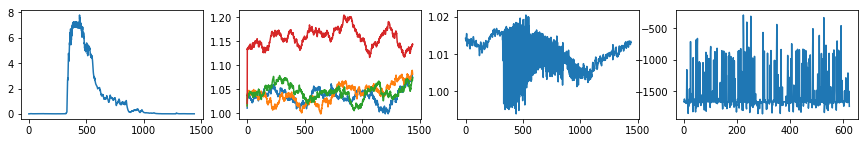

| Reward: -1677 | Episode: 624 | Qmax: -115.1931 | Action: [1.01112806 1.01611406 1.08294472 1.0935965 ]


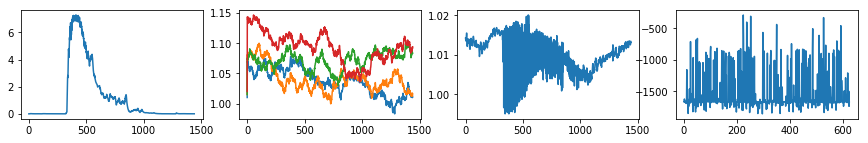

| Reward: -1595 | Episode: 625 | Qmax: -116.4067 | Action: [1.07564573 1.02970929 1.05821521 1.04616323]


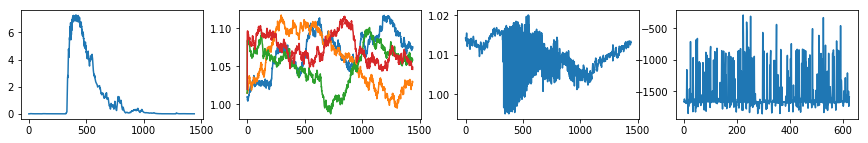

| Reward: -1669 | Episode: 626 | Qmax: -116.5263 | Action: [1.05542016 0.98437836 1.05722975 1.03968761]


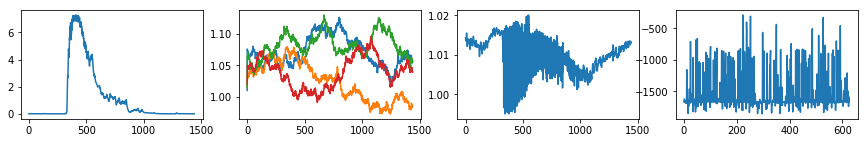

| Reward: -1669 | Episode: 627 | Qmax: -115.9446 | Action: [1.06646571 1.09165437 1.05204164 1.07665939]


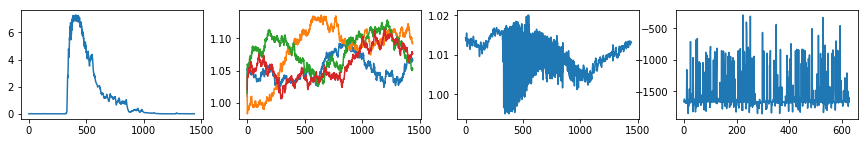

| Reward: -1669 | Episode: 628 | Qmax: -116.7593 | Action: [1.03119282 1.00740547 0.97066161 1.13289458]


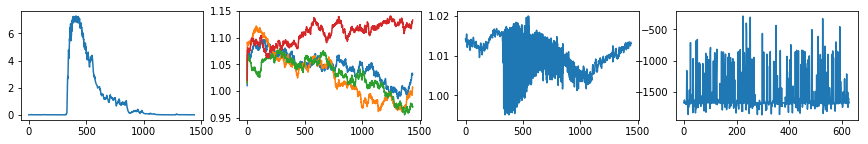

| Reward: -1715 | Episode: 629 | Qmax: -117.5834 | Action: [1.06280993 1.02847911 1.00069527 1.14689416]


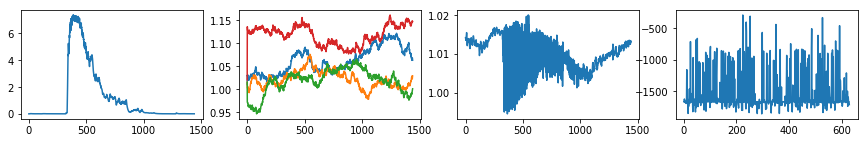

| Reward: -1687 | Episode: 630 | Qmax: -118.6271 | Action: [1.0128461  1.08876276 1.00705518 1.13515344]


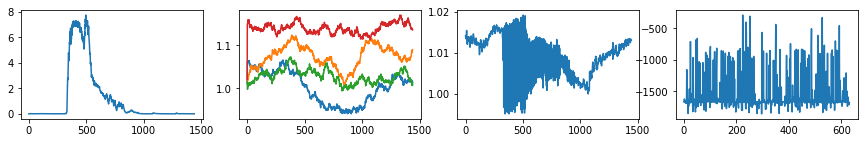

| Reward: -818 | Episode: 631 | Qmax: -119.7567 | Action: [1.00050214 1.09364731 1.00160949 1.05206497]


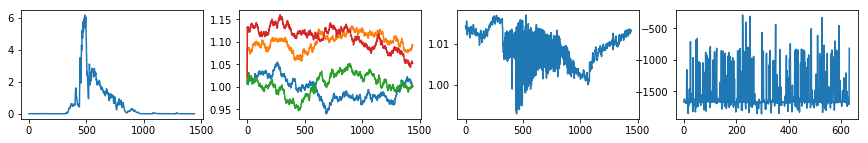

| Reward: -1023 | Episode: 632 | Qmax: -120.1658 | Action: [1.01099634 1.03811664 1.09503507 1.07645675]


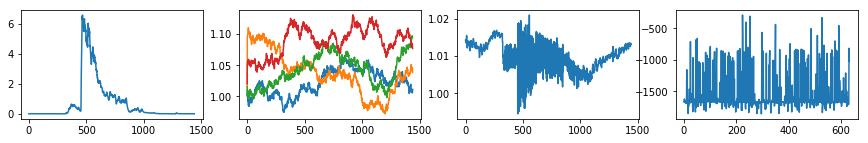

| Reward: -1669 | Episode: 633 | Qmax: -119.9007 | Action: [1.12147563 0.99911067 1.02698825 1.06298083]


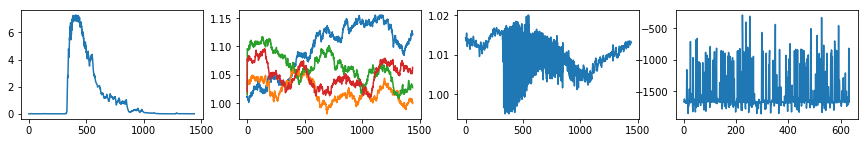

| Reward: -1669 | Episode: 634 | Qmax: -118.7776 | Action: [1.0309281  1.01600781 1.0981746  1.02661458]


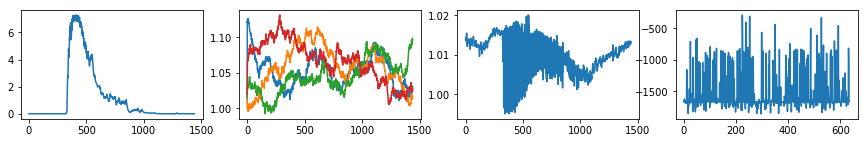

| Reward: -1667 | Episode: 635 | Qmax: -118.1269 | Action: [1.04476207 0.99993251 1.0463507  1.02316977]


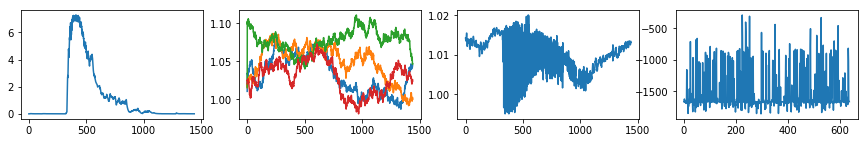

| Reward: -1758 | Episode: 636 | Qmax: -118.1453 | Action: [1.06286761 1.07715097 1.01172997 1.05400428]


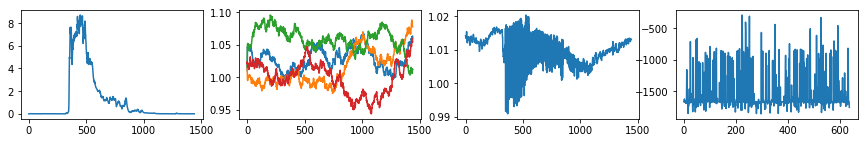

| Reward: -1275 | Episode: 637 | Qmax: -118.0647 | Action: [1.03812529 1.01182571 1.08880826 1.05040552]


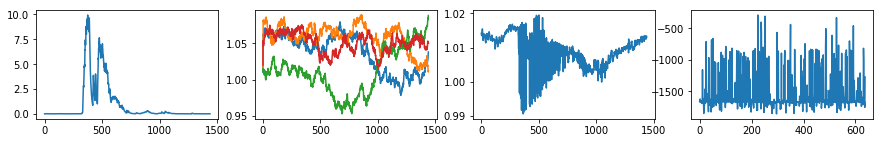

| Reward: -1669 | Episode: 638 | Qmax: -117.8497 | Action: [1.01151365 1.0117079  1.09640665 1.01698488]


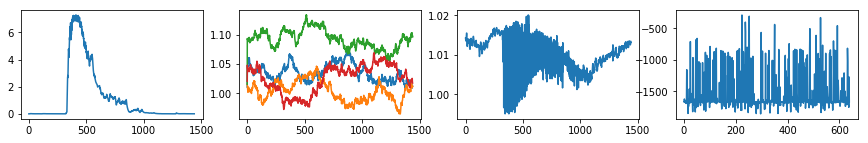

| Reward: -1669 | Episode: 639 | Qmax: -118.2786 | Action: [1.05185676 1.10432875 1.06698892 1.05108486]


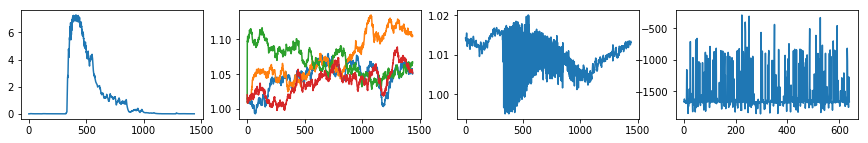

| Reward: -1669 | Episode: 640 | Qmax: -118.4289 | Action: [1.08914149 1.02424844 1.06268998 1.02980893]


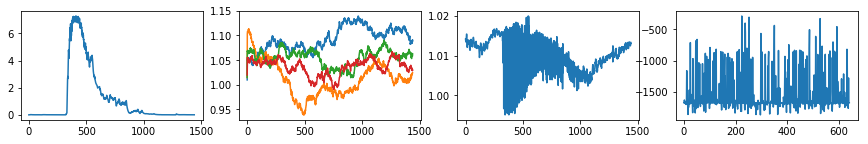

| Reward: -1662 | Episode: 641 | Qmax: -118.7903 | Action: [1.03824723 1.04536663 1.06042389 1.0786431 ]


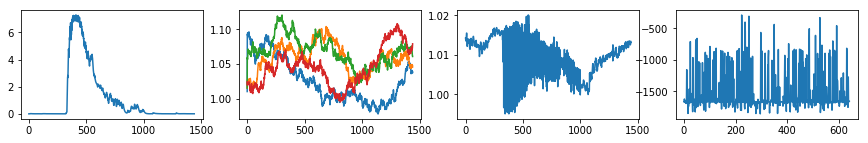

| Reward: -1669 | Episode: 642 | Qmax: -118.7026 | Action: [1.04247996 0.95458222 1.04433283 0.99567453]


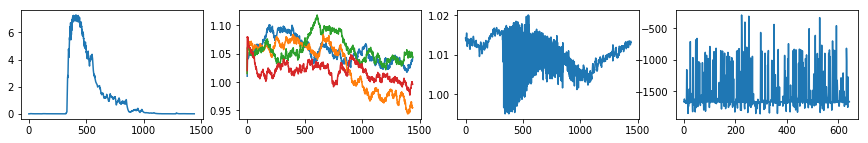

| Reward: -1670 | Episode: 643 | Qmax: -118.1831 | Action: [0.99467395 1.02134556 1.10187234 0.98260398]


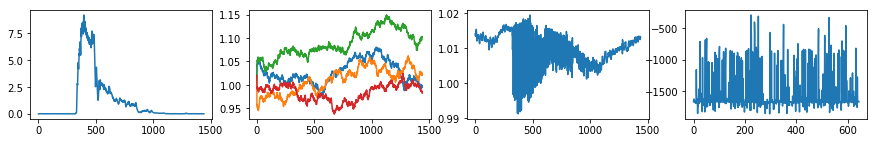

| Reward: -1664 | Episode: 644 | Qmax: -116.9769 | Action: [1.05107458 1.0446929  1.00906171 1.06166984]


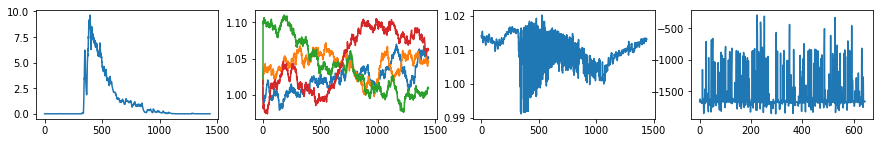

| Reward: -925 | Episode: 645 | Qmax: -115.9527 | Action: [1.04376969 1.07581483 1.04300051 1.05549012]


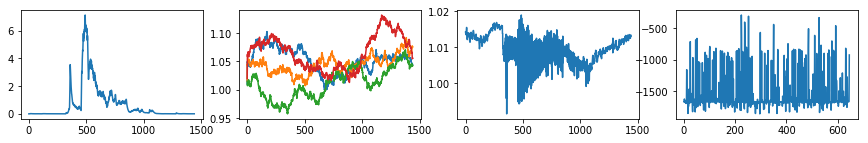

| Reward: -1138 | Episode: 646 | Qmax: -115.4940 | Action: [1.02704318 1.13995521 1.01253137 1.0488871 ]


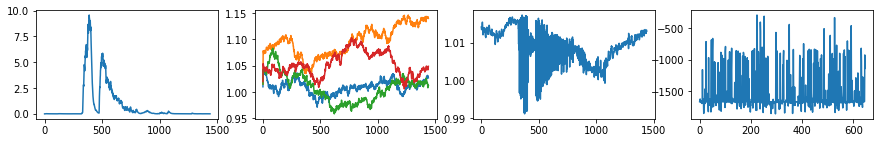

| Reward: -1608 | Episode: 647 | Qmax: -114.6489 | Action: [1.00469086 1.05981811 0.98102109 1.0479128 ]


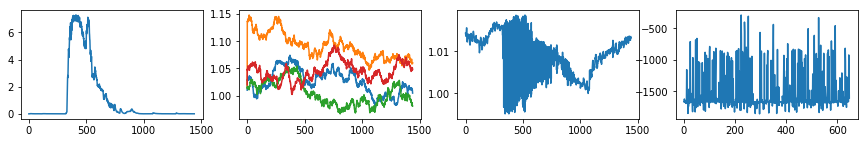

| Reward: -843 | Episode: 648 | Qmax: -115.1012 | Action: [1.04992209 0.98896613 1.08491704 1.05618199]


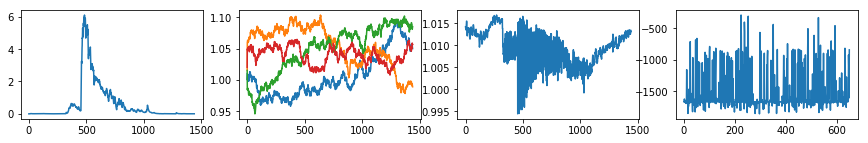

| Reward: -1669 | Episode: 649 | Qmax: -114.9357 | Action: [1.04061569 0.98349155 1.12048122 1.05842205]


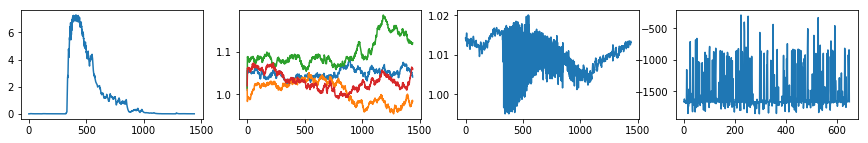

| Reward: -1461 | Episode: 650 | Qmax: -113.8608 | Action: [1.05948183 1.0212611  1.11704666 1.0179619 ]


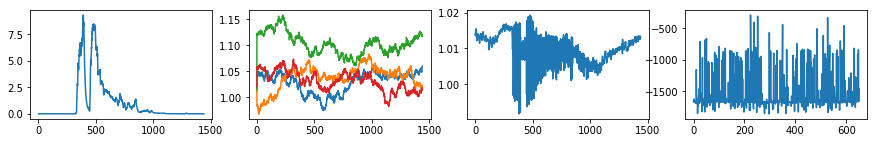

| Reward: -1681 | Episode: 651 | Qmax: -113.5196 | Action: [1.06584881 1.07379679 1.0225343  1.06540486]


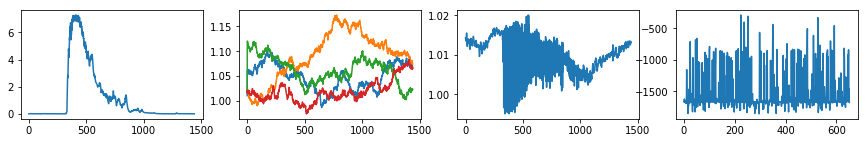

| Reward: -1669 | Episode: 652 | Qmax: -114.2899 | Action: [1.11935629 1.10147949 1.03605772 1.03553363]


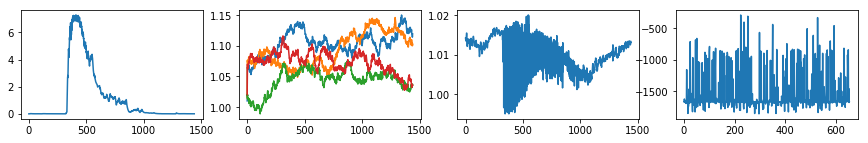

| Reward: -1669 | Episode: 653 | Qmax: -115.5709 | Action: [1.08618092 1.09716118 1.05508435 1.12821182]


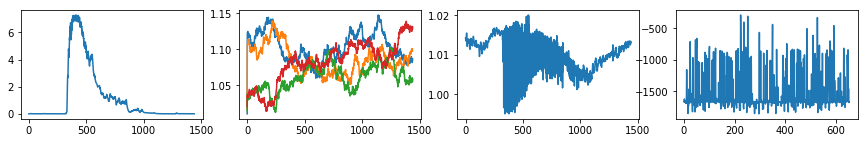

| Reward: -1641 | Episode: 654 | Qmax: -114.0199 | Action: [1.01235328 1.07165241 1.06992527 1.04493355]


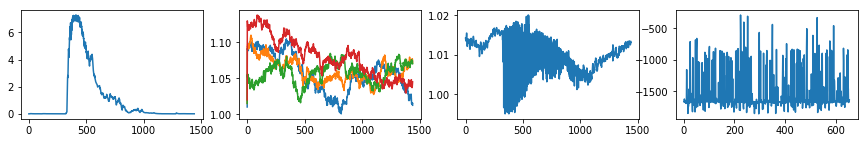

| Reward: -1702 | Episode: 655 | Qmax: -114.2292 | Action: [1.05454061 1.05388175 1.08994171 0.99779955]


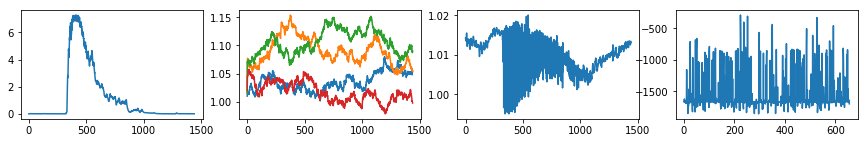

| Reward: -1669 | Episode: 656 | Qmax: -113.1419 | Action: [1.06841694 1.07360737 1.09318887 1.00369951]


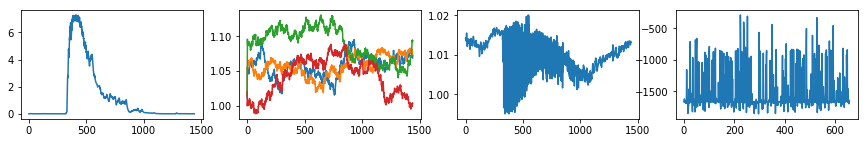

| Reward: -1669 | Episode: 657 | Qmax: -113.6337 | Action: [1.01923171 1.10077538 1.06532362 1.0629861 ]


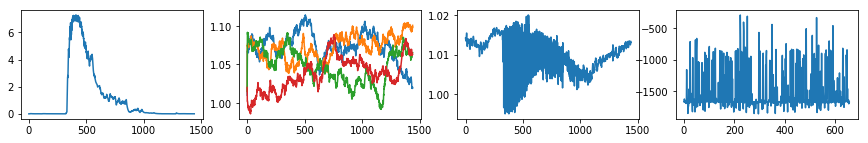

| Reward: -1669 | Episode: 658 | Qmax: -112.7318 | Action: [1.04491155 1.08818932 1.08373656 1.13033833]


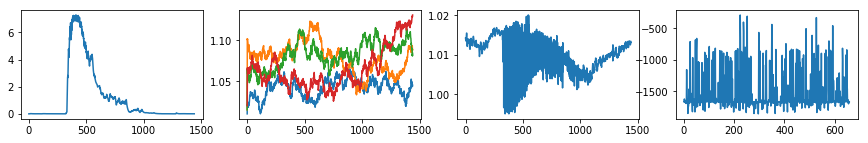

| Reward: -1511 | Episode: 659 | Qmax: -112.4603 | Action: [1.00781599 1.01145672 1.02559429 1.05526645]


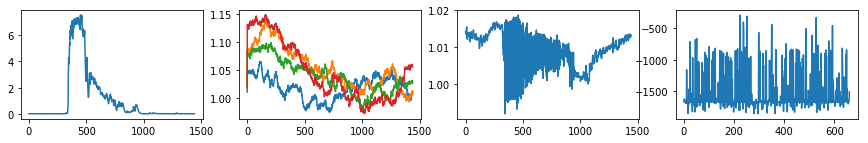

| Reward: -1615 | Episode: 660 | Qmax: -112.7927 | Action: [1.11928    1.05252096 1.04422777 1.07929372]


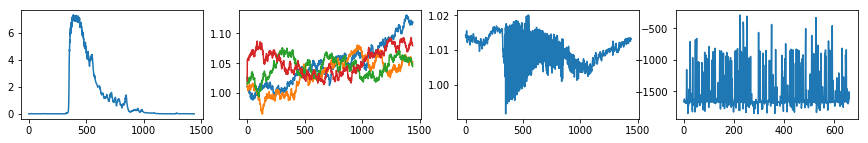

| Reward: -1683 | Episode: 661 | Qmax: -111.8270 | Action: [1.05138    1.02354133 1.09215532 1.04635972]


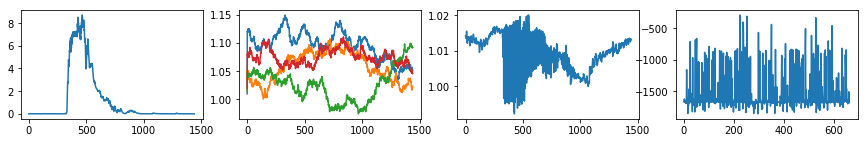

| Reward: -1669 | Episode: 662 | Qmax: -111.3675 | Action: [1.0728977  1.08441466 1.03852445 1.01446405]


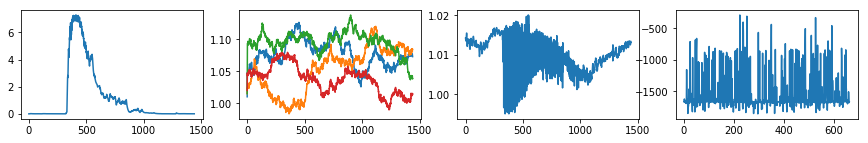

| Reward: -1022 | Episode: 663 | Qmax: -110.2248 | Action: [1.07152613 1.09649819 1.00528812 1.07832296]


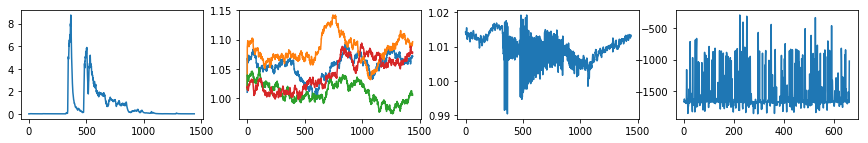

| Reward: -1669 | Episode: 664 | Qmax: -108.9932 | Action: [1.05718424 1.05138816 1.0641228  1.08564286]


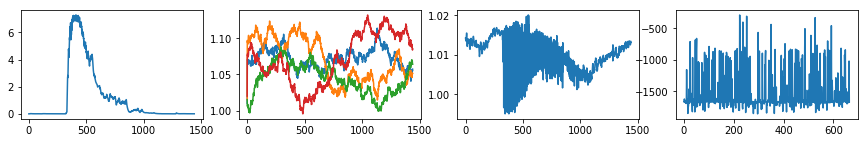

| Reward: -1852 | Episode: 665 | Qmax: -107.9362 | Action: [1.0813075  1.02922822 0.98150469 1.00811372]


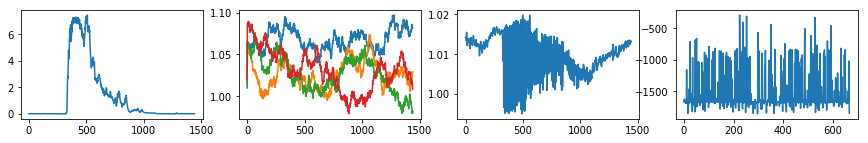

| Reward: -1716 | Episode: 666 | Qmax: -107.2286 | Action: [1.02763947 1.02836012 0.99038085 1.01287523]


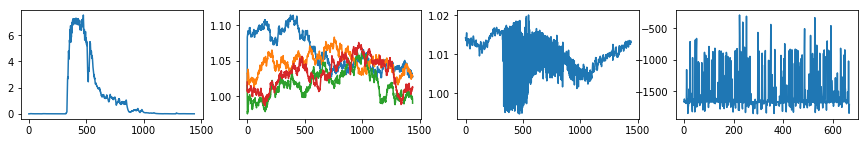

| Reward: -264 | Episode: 667 | Qmax: -106.4485 | Action: [1.05924865 1.08530861 1.03112502 0.9842241 ]


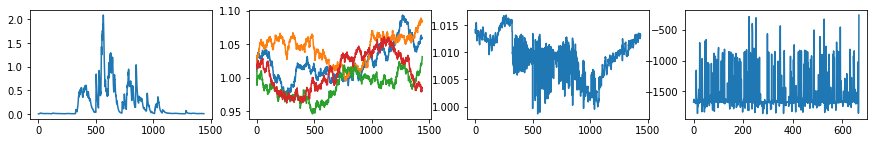

| Reward: -1716 | Episode: 668 | Qmax: -105.1798 | Action: [1.04594322 1.01348702 1.03761947 1.01293836]


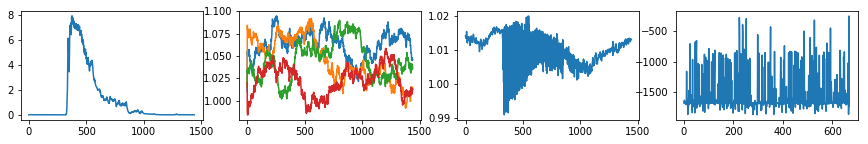

| Reward: -1669 | Episode: 669 | Qmax: -104.5992 | Action: [1.02769295 1.01478152 1.06900345 0.95332938]


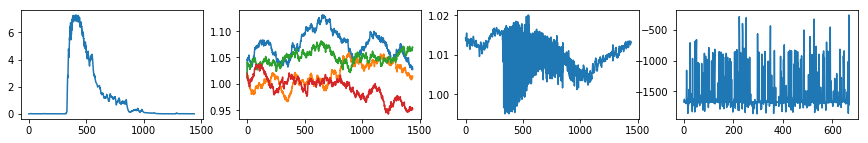

| Reward: -1740 | Episode: 670 | Qmax: -103.8238 | Action: [1.0041701  1.01364631 1.10837075 1.04136234]


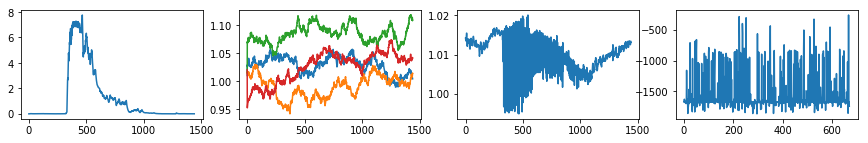

| Reward: -1572 | Episode: 671 | Qmax: -103.1626 | Action: [1.0382356  1.04126209 1.04609234 1.05628494]


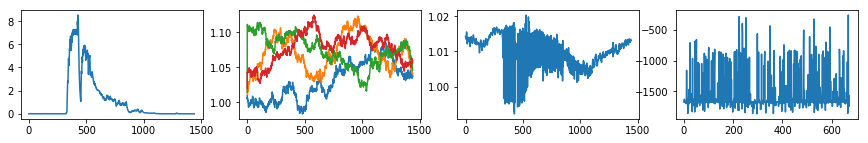

| Reward: -1679 | Episode: 672 | Qmax: -102.6978 | Action: [1.06953475 1.07351017 1.06487424 1.06340748]


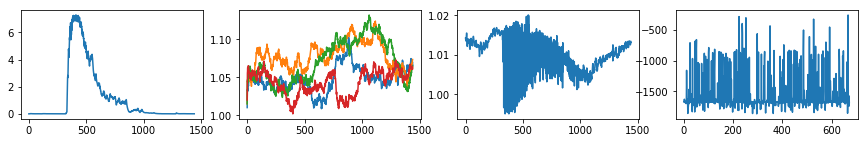

| Reward: -1636 | Episode: 673 | Qmax: -102.2108 | Action: [1.09162037 1.05056686 1.08321319 1.05193758]


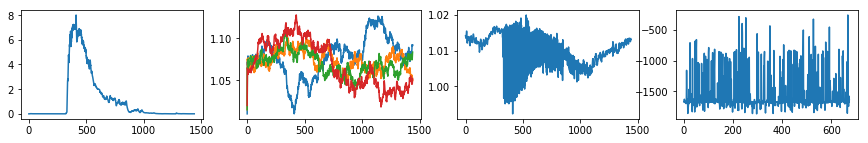

| Reward: -1670 | Episode: 674 | Qmax: -101.8135 | Action: [1.11117222 1.07570223 1.03648588 1.06385649]


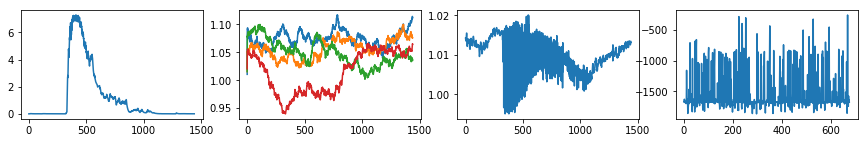

| Reward: -1709 | Episode: 675 | Qmax: -102.6926 | Action: [1.18412044 1.00403572 1.06485814 1.04021521]


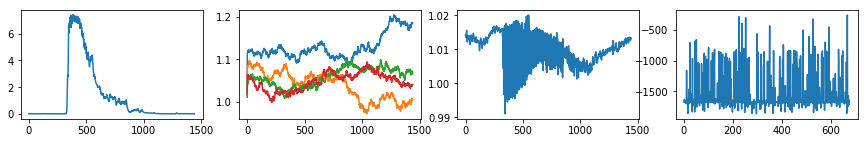

| Reward: -1330 | Episode: 676 | Qmax: -102.3612 | Action: [0.99416386 1.02364143 1.05944742 1.07015433]


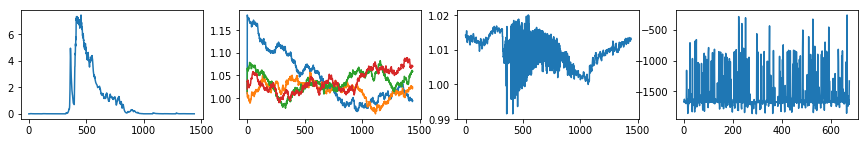

| Reward: -1103 | Episode: 677 | Qmax: -102.4333 | Action: [1.07448969 1.08588156 1.04220728 1.06289072]


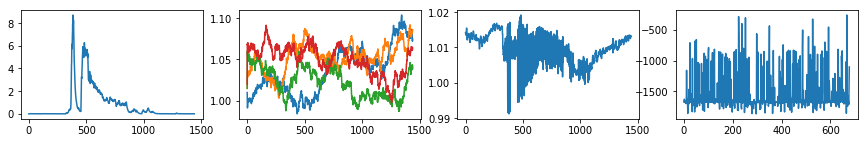

| Reward: -1669 | Episode: 678 | Qmax: -102.7309 | Action: [1.03097098 1.10990369 1.05233635 1.05936963]


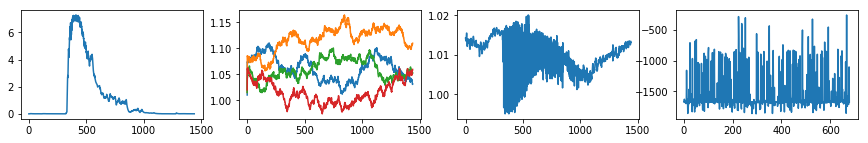

| Reward: -1645 | Episode: 679 | Qmax: -103.1227 | Action: [1.08071263 1.05784005 1.06146469 1.00438678]


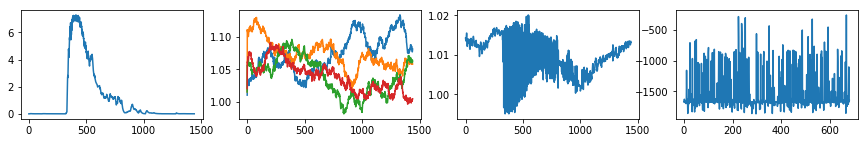

| Reward: -1669 | Episode: 680 | Qmax: -104.1956 | Action: [1.07084608 1.04973754 1.13141975 0.95697769]


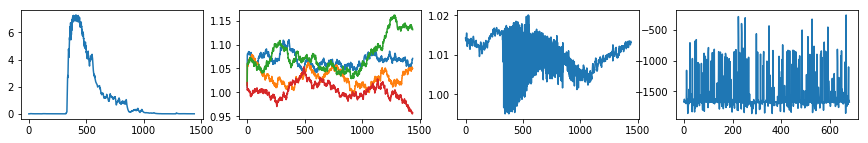

| Reward: -1668 | Episode: 681 | Qmax: -105.4883 | Action: [1.07884369 1.05119686 1.05064658 0.97583005]


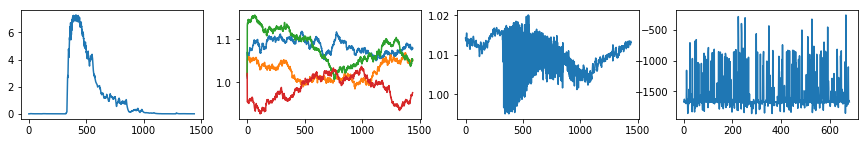

| Reward: -1445 | Episode: 682 | Qmax: -105.3367 | Action: [1.06795983 0.99618314 0.99784975 1.08448077]


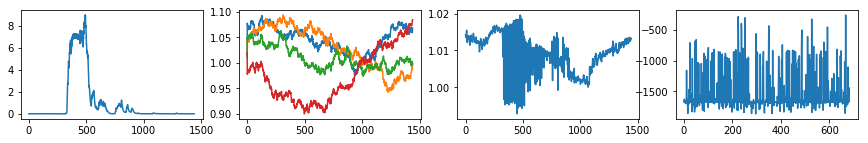

| Reward: -1712 | Episode: 683 | Qmax: -106.7661 | Action: [1.04804931 1.08215819 1.00165264 1.01286459]


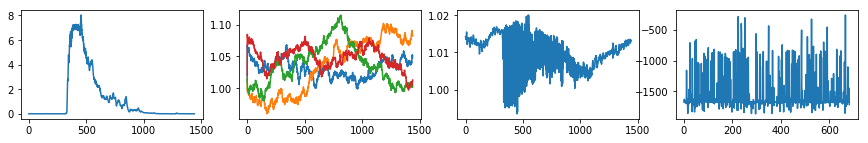

| Reward: -1525 | Episode: 684 | Qmax: -106.8953 | Action: [1.0438978  1.07720402 1.07841909 1.04125486]


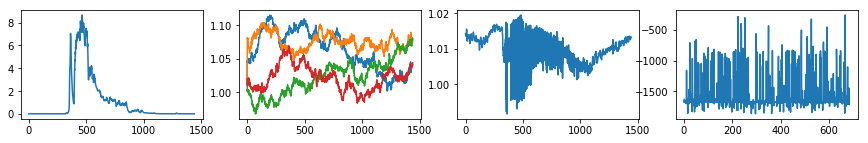

| Reward: -1669 | Episode: 685 | Qmax: -107.3893 | Action: [1.07937506 1.02573493 1.05080183 1.05624328]


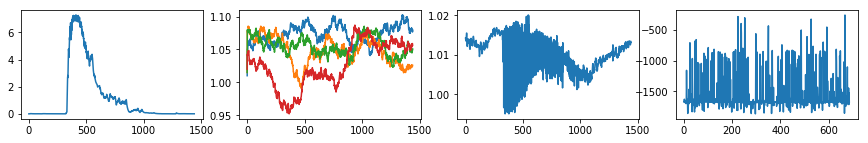

| Reward: -1669 | Episode: 686 | Qmax: -107.0678 | Action: [1.03717362 1.02175275 1.06603391 0.99674083]


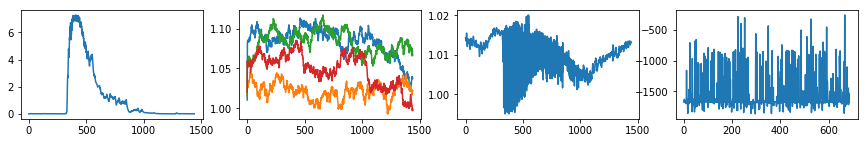

| Reward: -1669 | Episode: 687 | Qmax: -105.1307 | Action: [1.04197512 0.97421536 1.08182131 1.05944421]


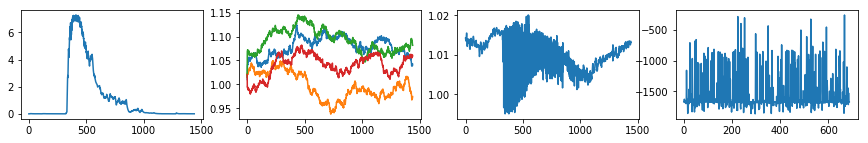

| Reward: -1682 | Episode: 688 | Qmax: -103.9307 | Action: [1.02488584 1.01979049 0.99237896 1.03227862]


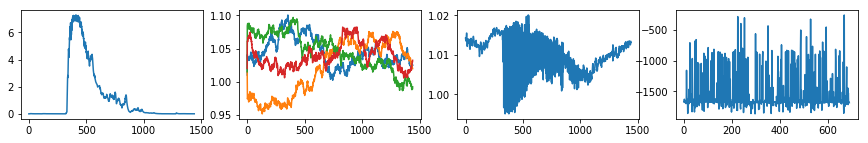

| Reward: -758 | Episode: 689 | Qmax: -102.8274 | Action: [1.04530065 1.06551162 1.03430455 1.06286255]


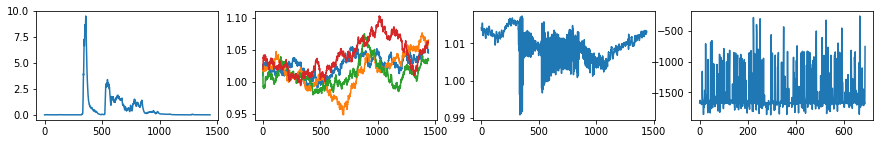

| Reward: -1760 | Episode: 690 | Qmax: -102.3343 | Action: [1.05843089 1.07613258 1.07719451 1.0453201 ]


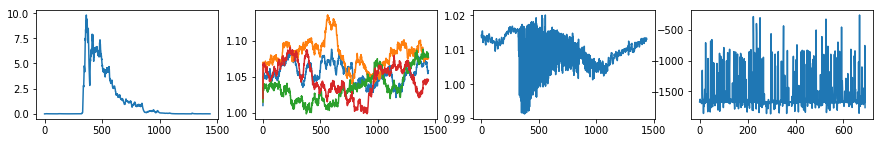

| Reward: -1669 | Episode: 691 | Qmax: -101.4831 | Action: [1.05047083 1.10200998 1.08401845 1.01911105]


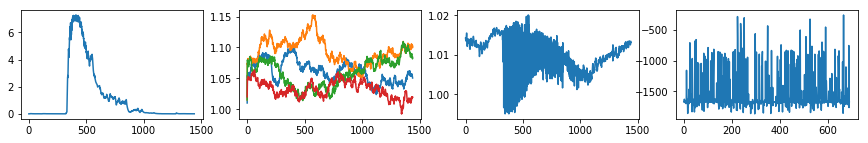

| Reward: -1669 | Episode: 692 | Qmax: -100.6029 | Action: [1.04837781 1.14139995 1.06283182 1.03330222]


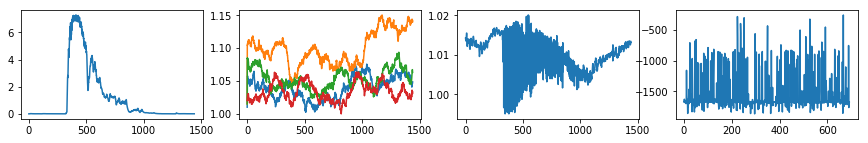

| Reward: -1668 | Episode: 693 | Qmax: -99.5871 | Action: [1.04618903 1.06210072 1.01062215 0.99354327]


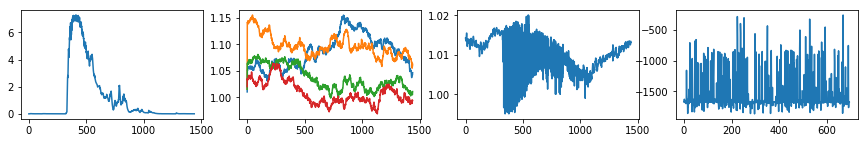

| Reward: -1685 | Episode: 694 | Qmax: -99.2636 | Action: [1.05994338 1.07355671 1.01229382 1.0934674 ]


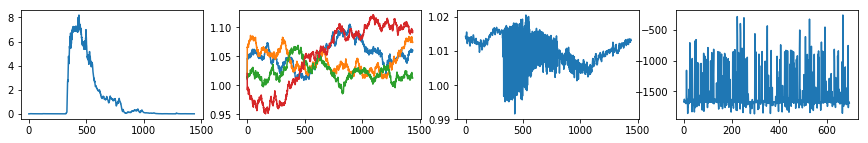

| Reward: -1251 | Episode: 695 | Qmax: -100.6284 | Action: [1.06210799 1.10270769 1.00807643 1.02905128]


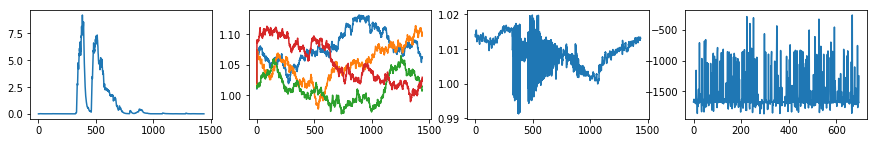

| Reward: -1607 | Episode: 696 | Qmax: -102.6287 | Action: [1.05853084 1.09157552 1.03348885 1.00495093]


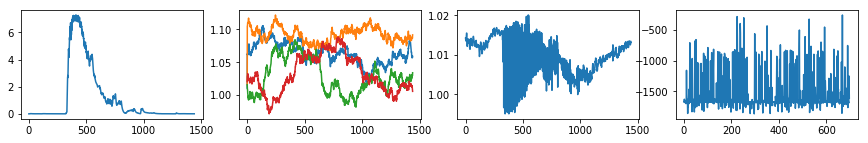

| Reward: -1669 | Episode: 697 | Qmax: -105.1699 | Action: [1.01375025 0.99003513 1.02985052 1.07162697]


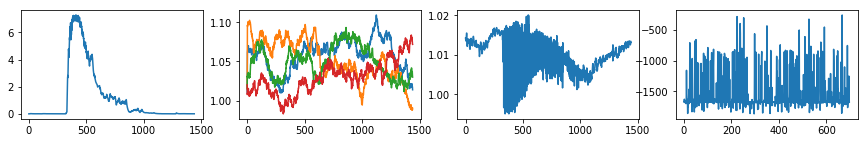

| Reward: -1636 | Episode: 698 | Qmax: -105.5951 | Action: [1.03573138 1.07255096 0.9941631  1.10846322]


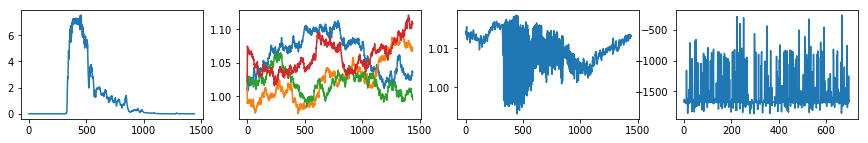

| Reward: -1751 | Episode: 699 | Qmax: -104.5495 | Action: [1.03851594 1.02517893 1.03928132 1.02075175]


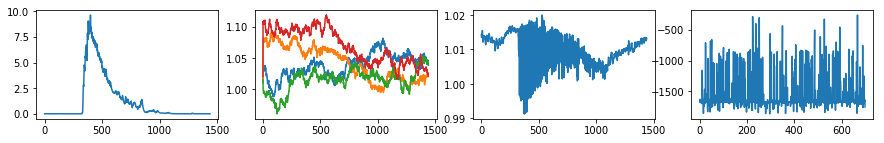

| Reward: -1669 | Episode: 700 | Qmax: -105.4134 | Action: [1.05997501 1.07361009 1.07499391 1.09511275]


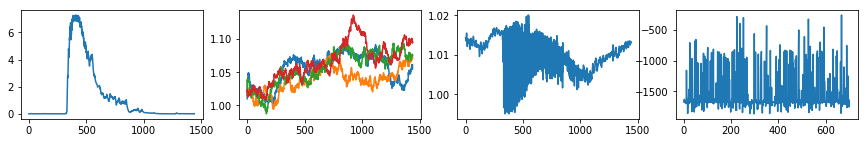

| Reward: -1065 | Episode: 701 | Qmax: -105.3432 | Action: [1.06391207 0.99897471 1.0213636  1.02631178]


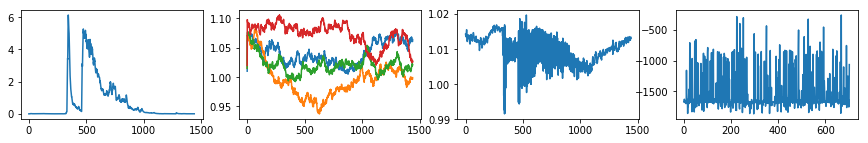

| Reward: -1528 | Episode: 702 | Qmax: -105.3583 | Action: [1.07444774 1.06832257 0.98908929 1.04035847]


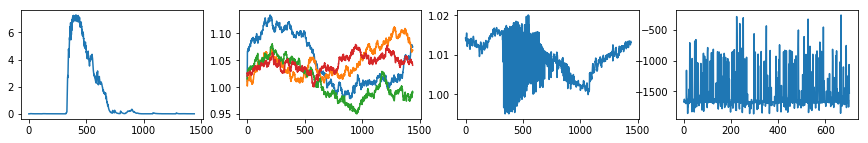

| Reward: -971 | Episode: 703 | Qmax: -106.1939 | Action: [1.07567584 1.09033248 1.04076543 1.0487548 ]


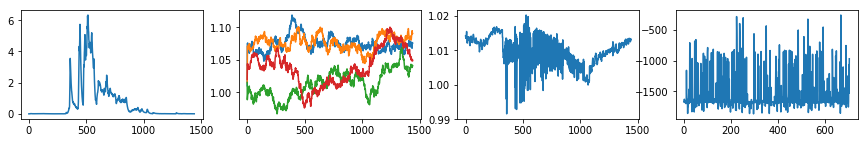

| Reward: -1675 | Episode: 704 | Qmax: -106.4154 | Action: [1.01129172 1.08286661 1.05571273 1.04345526]


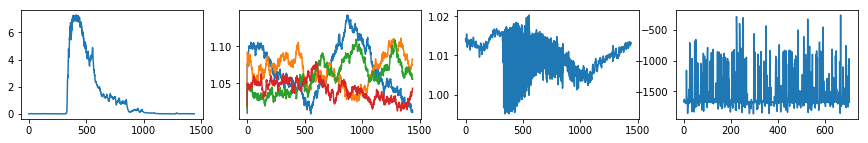

| Reward: -1661 | Episode: 705 | Qmax: -106.5661 | Action: [1.06134127 1.0691767  0.98760875 1.0469499 ]


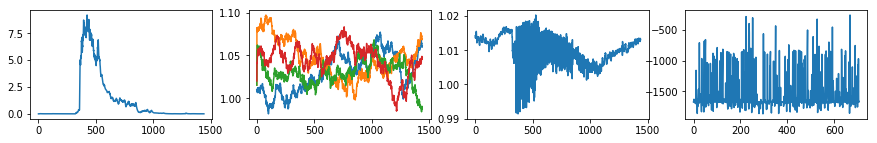

| Reward: -1497 | Episode: 706 | Qmax: -106.7692 | Action: [1.0131514  1.11533191 0.95620239 1.12498195]


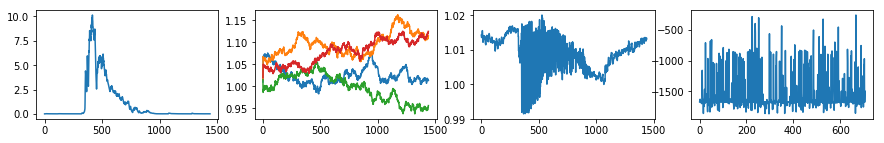

| Reward: -1207 | Episode: 707 | Qmax: -106.5555 | Action: [1.07699004 1.09785387 0.98910052 1.10364171]


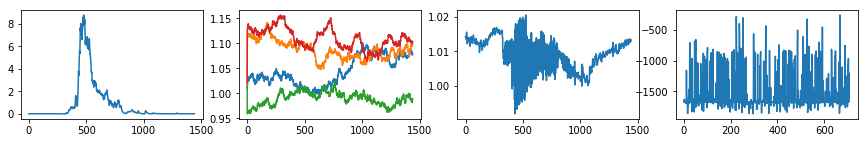

| Reward: -1509 | Episode: 708 | Qmax: -106.4757 | Action: [1.04166166 1.03219335 1.06038553 1.01677917]


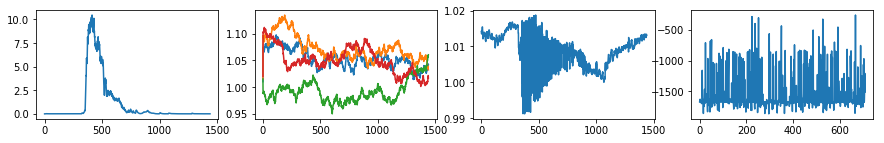

| Reward: -1686 | Episode: 709 | Qmax: -106.3865 | Action: [1.06486623 1.05825729 1.01645159 1.05627893]


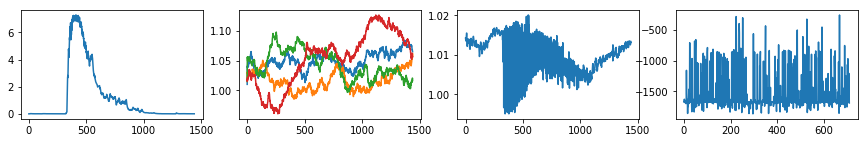

| Reward: -1672 | Episode: 710 | Qmax: -106.7673 | Action: [1.06354802 1.05510302 1.04254741 0.9527423 ]


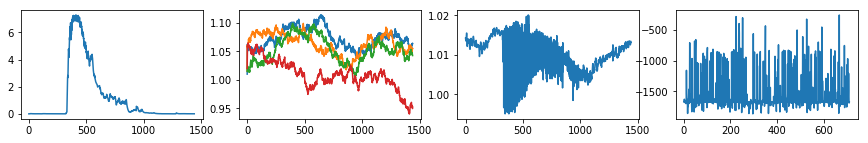

| Reward: -1669 | Episode: 711 | Qmax: -107.7233 | Action: [1.00297574 1.05903157 1.02263069 1.05019978]


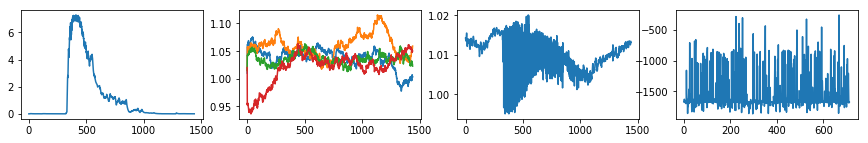

| Reward: -1687 | Episode: 712 | Qmax: -108.7360 | Action: [1.07943877 1.06002018 1.02661776 1.05499623]


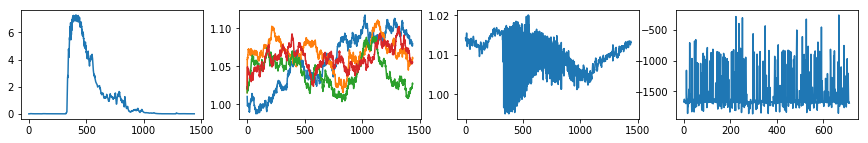

| Reward: -1334 | Episode: 713 | Qmax: -109.5733 | Action: [1.15353107 1.03299076 1.01849959 1.05758874]


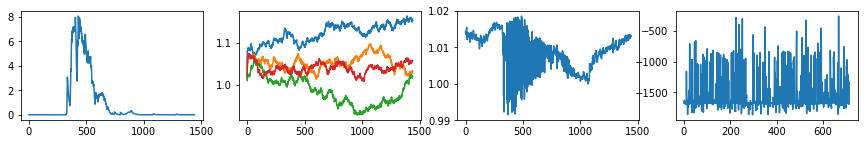

| Reward: -1669 | Episode: 714 | Qmax: -110.5385 | Action: [1.06272509 1.03810414 1.02344621 1.12639761]


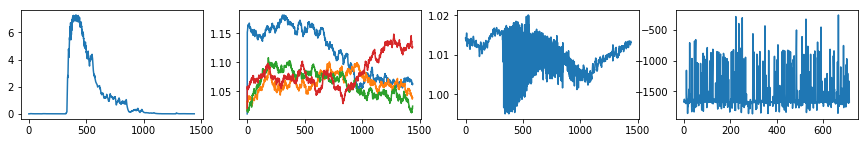

| Reward: -1669 | Episode: 715 | Qmax: -110.8486 | Action: [1.04637474 1.02115628 1.16635245 1.06079294]


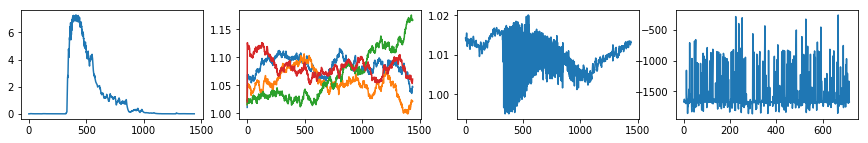

| Reward: -1669 | Episode: 716 | Qmax: -108.8814 | Action: [1.03523267 1.11917035 1.05643275 1.05495121]


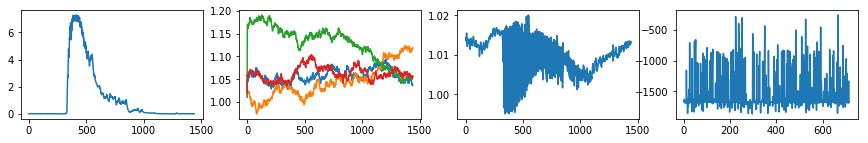

| Reward: -1661 | Episode: 717 | Qmax: -107.6256 | Action: [1.02509666 1.03307641 1.02589859 0.98724774]


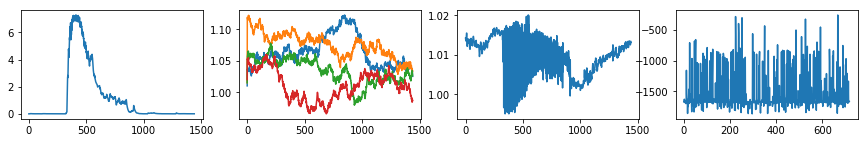

| Reward: -1669 | Episode: 718 | Qmax: -105.9753 | Action: [1.06177953 1.00199194 1.0126599  1.0391419 ]


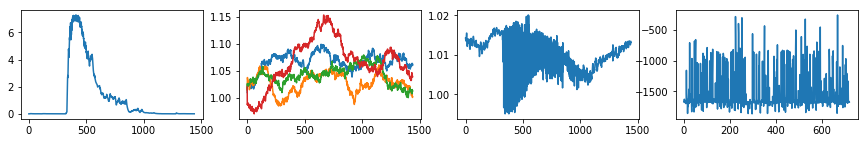

| Reward: -1657 | Episode: 719 | Qmax: -106.2311 | Action: [1.00344268 1.06443681 1.03473901 1.06680986]


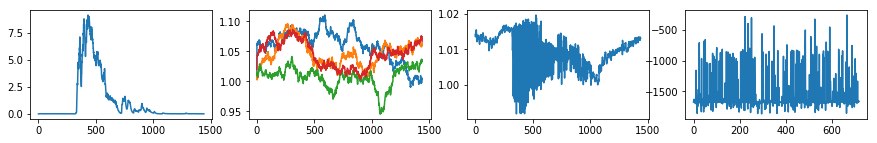

| Reward: -871 | Episode: 720 | Qmax: -106.2885 | Action: [1.12031582 1.05390262 1.05622692 1.03469049]


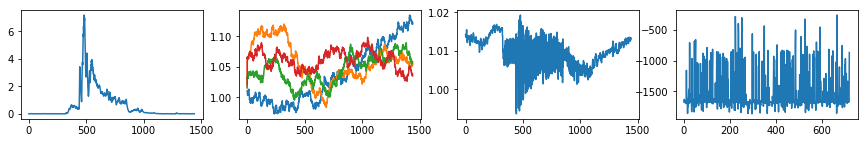

| Reward: -1618 | Episode: 721 | Qmax: -106.6958 | Action: [1.02977535 1.10525913 1.00790347 1.07045493]


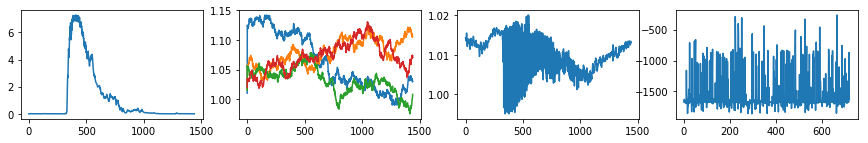

| Reward: -1669 | Episode: 722 | Qmax: -107.1810 | Action: [1.04196243 1.03836409 1.02739434 1.08894593]


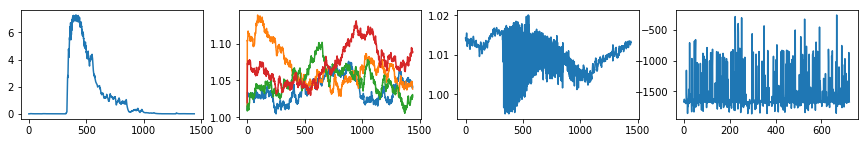

| Reward: -1669 | Episode: 723 | Qmax: -108.0069 | Action: [1.05002342 1.05597488 1.06631846 1.0695304 ]


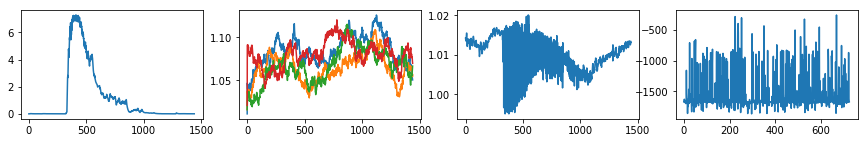

| Reward: -1718 | Episode: 724 | Qmax: -109.3127 | Action: [1.13634205 1.04521791 1.02547701 1.11642478]


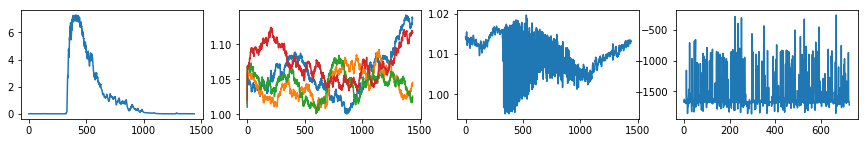

| Reward: -1669 | Episode: 725 | Qmax: -111.3543 | Action: [1.03745178 1.10604969 1.01947273 1.0851237 ]


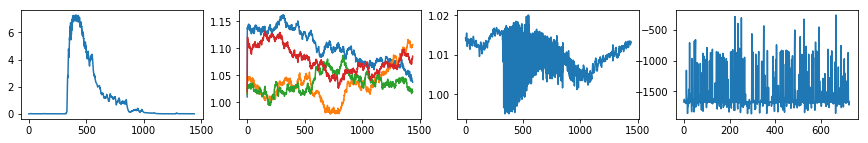

| Reward: -1601 | Episode: 726 | Qmax: -111.6113 | Action: [1.04016335 1.03215037 1.04249954 1.04691329]


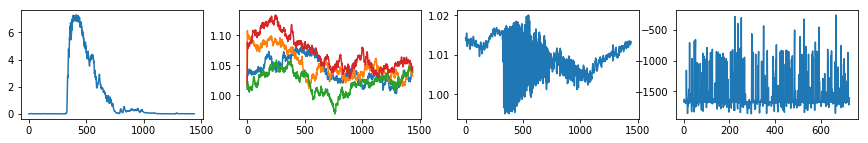

| Reward: -1749 | Episode: 727 | Qmax: -111.8027 | Action: [1.07907404 1.0380302  1.09412783 1.03152296]


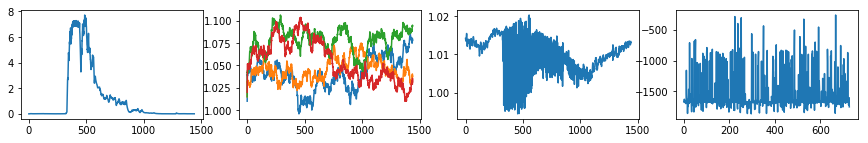

| Reward: -1672 | Episode: 728 | Qmax: -111.4120 | Action: [1.00537475 1.02541821 1.06668901 1.02018834]


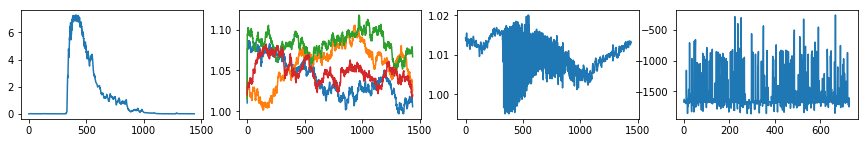

| Reward: -1669 | Episode: 729 | Qmax: -109.6505 | Action: [1.1033188  1.11952385 1.04760526 1.05448092]


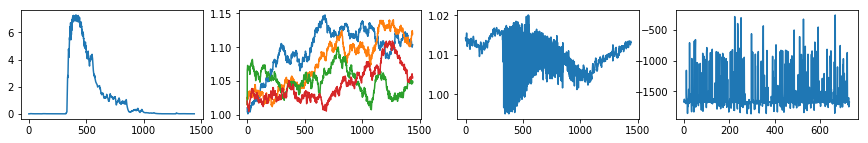

| Reward: -1683 | Episode: 730 | Qmax: -110.1016 | Action: [1.03564364 1.10178551 1.08732609 1.01590291]


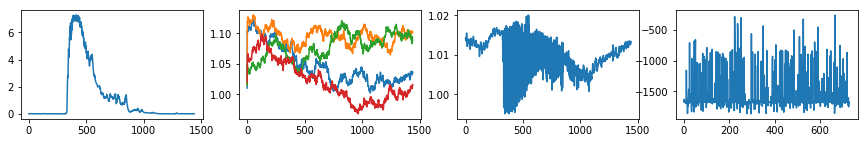

| Reward: -1662 | Episode: 731 | Qmax: -111.1350 | Action: [1.08355137 1.02448577 1.03568306 1.12752766]


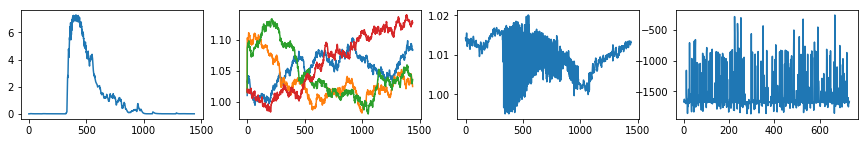

| Reward: -1674 | Episode: 732 | Qmax: -111.7511 | Action: [1.08462576 1.01432061 1.04651988 1.05943181]


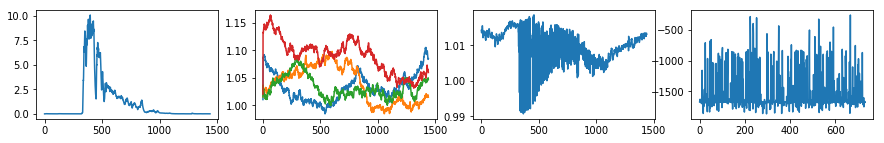

| Reward: -1677 | Episode: 733 | Qmax: -114.1478 | Action: [1.05987974 1.03155604 1.01617043 1.00104748]


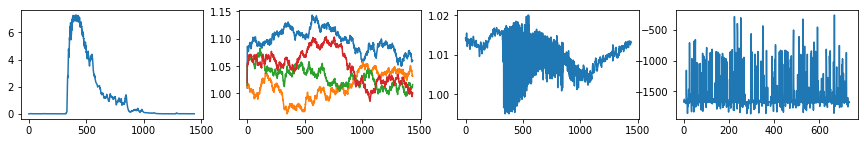

| Reward: -1130 | Episode: 734 | Qmax: -115.9752 | Action: [1.0511358  1.03813899 1.06658398 1.03370282]


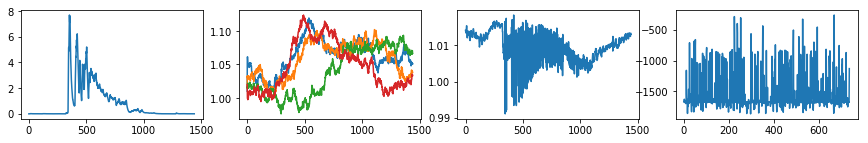

| Reward: -1669 | Episode: 735 | Qmax: -116.1484 | Action: [1.02490186 1.075632   1.04157952 0.98367148]


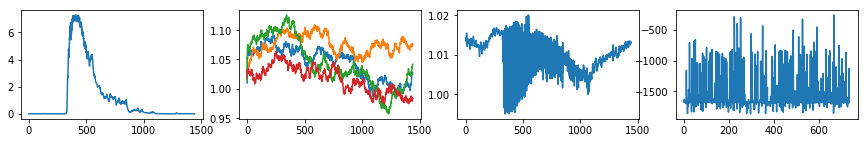

| Reward: -528 | Episode: 736 | Qmax: -115.2869 | Action: [0.99270396 1.02441339 1.02982757 1.08628884]


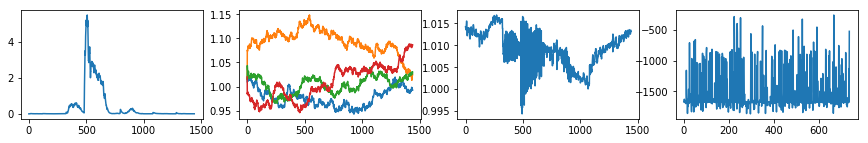

| Reward: -1444 | Episode: 737 | Qmax: -114.1495 | Action: [1.06212578 0.97252818 1.00852367 1.03500302]


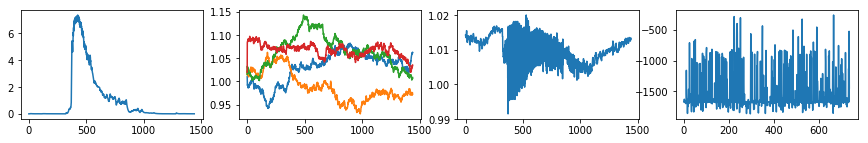

| Reward: -1633 | Episode: 738 | Qmax: -114.0138 | Action: [1.06688322 1.07208341 1.07801277 1.05243012]


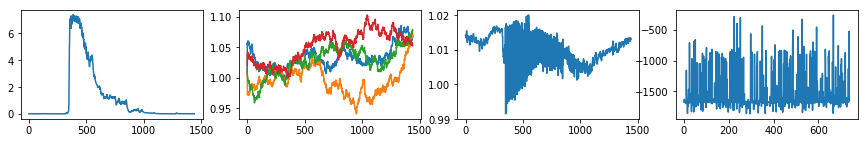

| Reward: -1735 | Episode: 739 | Qmax: -113.8327 | Action: [1.07257322 1.04570365 1.04025072 1.0822783 ]


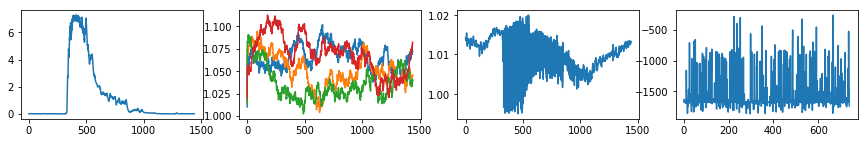

| Reward: -1181 | Episode: 740 | Qmax: -113.3200 | Action: [1.02211629 1.05412384 1.03374364 1.04118907]


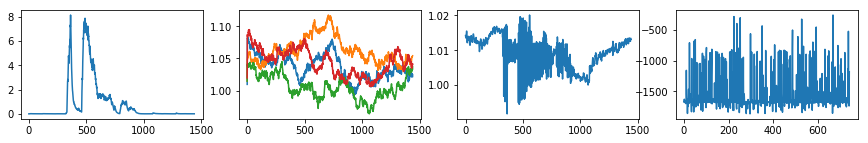

| Reward: -888 | Episode: 741 | Qmax: -112.6056 | Action: [1.04800289 1.02804341 1.07587422 0.99389005]


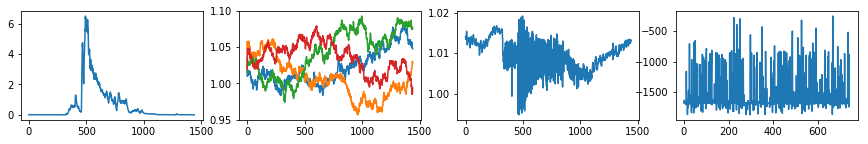

| Reward: -1601 | Episode: 742 | Qmax: -111.4047 | Action: [1.07252122 1.04433505 1.04778399 1.00431928]


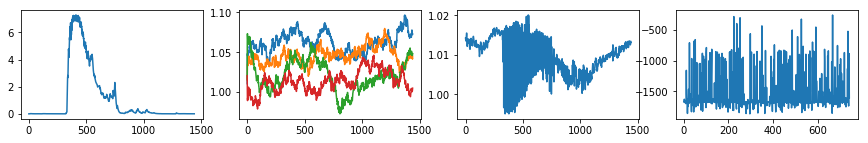

| Reward: -1669 | Episode: 743 | Qmax: -111.3903 | Action: [1.01478818 1.09884994 1.05476895 1.02345105]


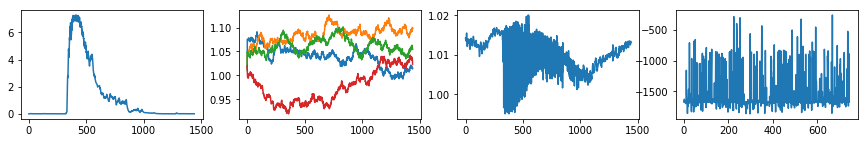

| Reward: -920 | Episode: 744 | Qmax: -111.4677 | Action: [1.03192797 1.07979974 1.02873347 1.04645563]


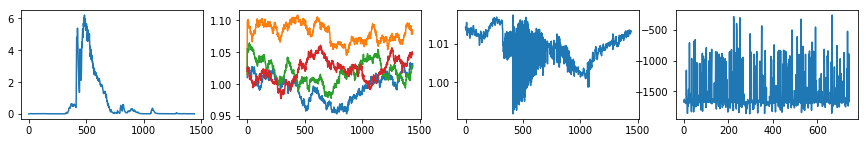

| Reward: -1200 | Episode: 745 | Qmax: -111.7473 | Action: [1.01227491 1.06089911 1.09396142 1.04525647]


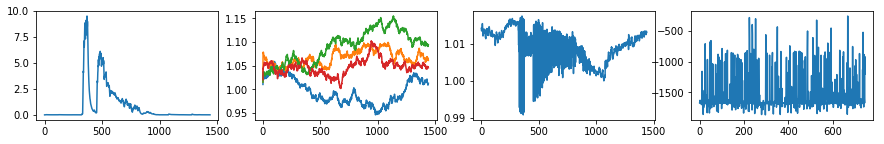

| Reward: -953 | Episode: 746 | Qmax: -110.2449 | Action: [1.07156206 1.02458959 1.07644612 1.04413805]


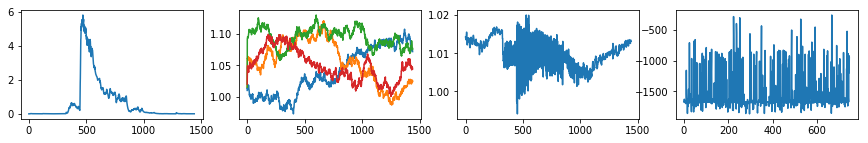

| Reward: -1669 | Episode: 747 | Qmax: -109.2766 | Action: [1.04687585 1.00143325 1.04960363 1.06500254]


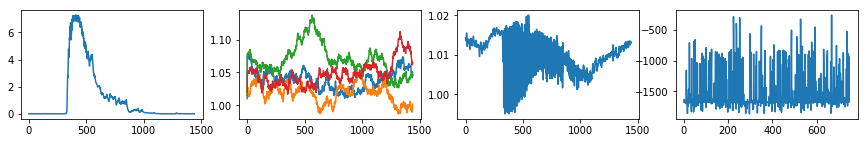

| Reward: -1669 | Episode: 748 | Qmax: -108.0518 | Action: [1.07837403 1.09103792 1.04012464 1.06834333]


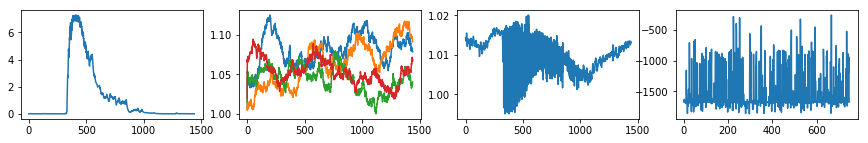

| Reward: -1550 | Episode: 749 | Qmax: -108.2319 | Action: [1.06004445 1.03469864 0.97031354 1.02560309]


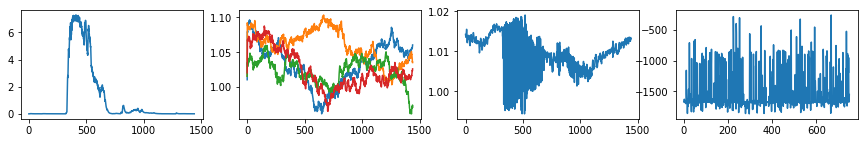

| Reward: -1862 | Episode: 750 | Qmax: -107.3526 | Action: [1.00553305 1.06213777 1.10301003 1.00722568]


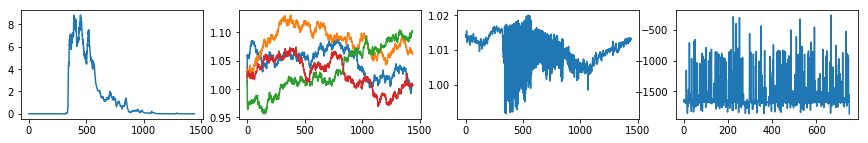

| Reward: -1669 | Episode: 751 | Qmax: -107.9290 | Action: [1.11357079 1.04187293 1.02399551 1.02163648]


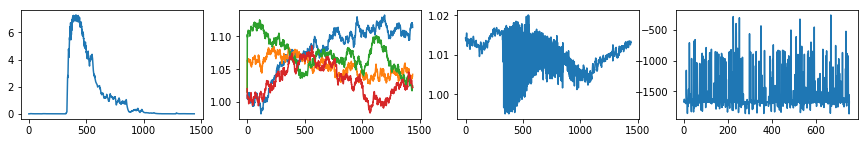

| Reward: -1394 | Episode: 752 | Qmax: -108.9230 | Action: [1.10559195 1.06019418 1.07058668 1.02938734]


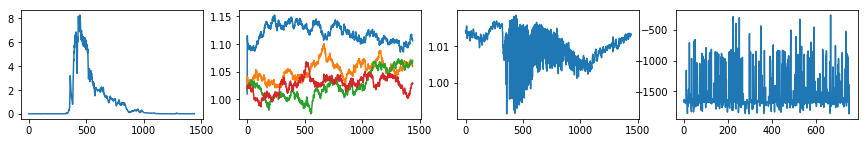

| Reward: -1669 | Episode: 753 | Qmax: -111.2504 | Action: [1.06651788 1.00815293 1.04832362 1.0380986 ]


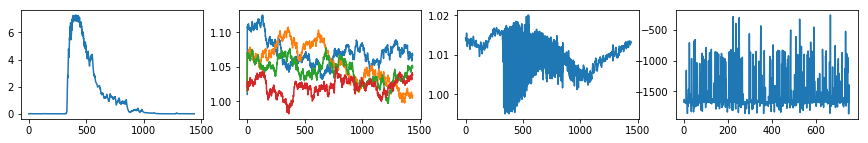

| Reward: -1669 | Episode: 754 | Qmax: -113.0009 | Action: [1.05340873 1.0883251  0.99954249 1.08117421]


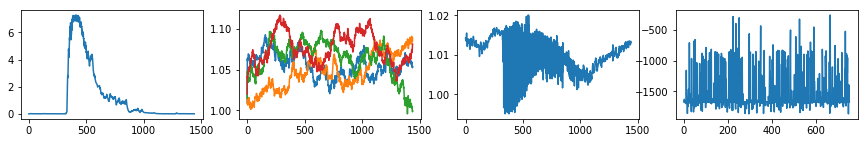

| Reward: -1668 | Episode: 755 | Qmax: -114.6829 | Action: [1.07363401 1.08148378 1.08659447 1.04799097]


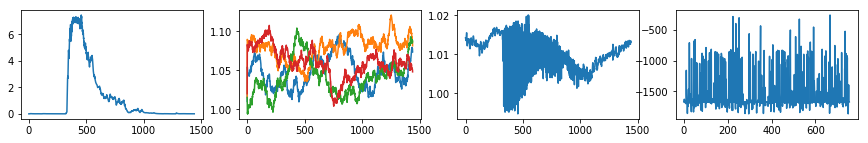

| Reward: -1669 | Episode: 756 | Qmax: -114.1648 | Action: [1.03049944 1.00083903 1.04123164 1.05480852]


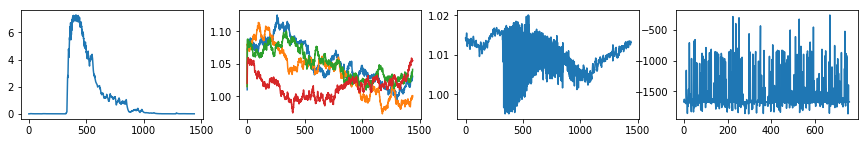

| Reward: -1735 | Episode: 757 | Qmax: -114.4640 | Action: [1.04317223 1.06377186 1.09991856 1.0310342 ]


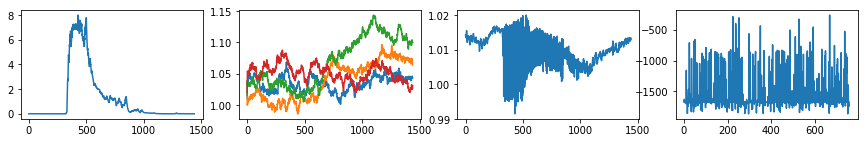

| Reward: -1605 | Episode: 758 | Qmax: -115.0541 | Action: [0.98511931 1.03883803 0.95470863 1.0958805 ]


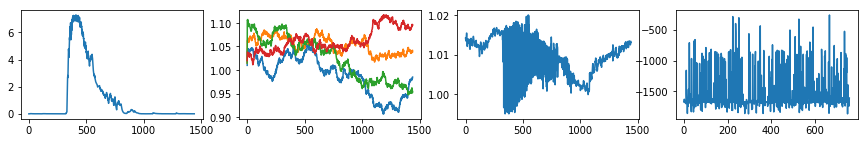

| Reward: -629 | Episode: 759 | Qmax: -115.6114 | Action: [1.08488675 1.03031395 1.0704922  1.01284708]


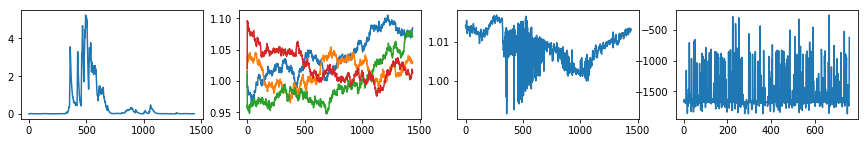

| Reward: -1669 | Episode: 760 | Qmax: -116.6133 | Action: [1.0814973  1.06584758 1.07341243 1.05321425]


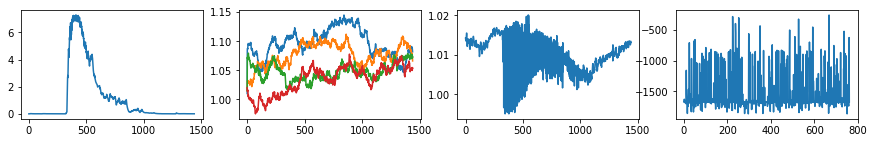

| Reward: -1669 | Episode: 761 | Qmax: -117.7573 | Action: [1.095115   0.94687201 1.06671557 1.0475658 ]


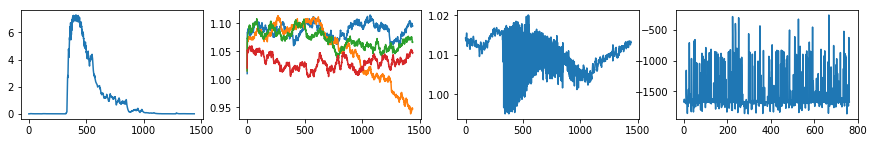

| Reward: -1669 | Episode: 762 | Qmax: -117.8233 | Action: [1.12889149 1.09140111 1.08840566 1.06983869]


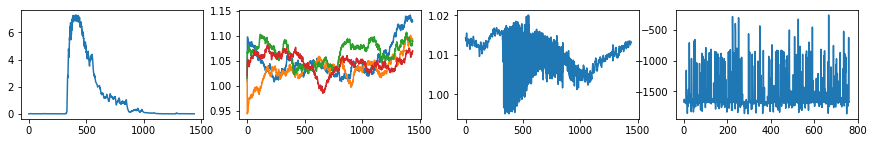

| Reward: -1669 | Episode: 763 | Qmax: -118.2190 | Action: [1.04216826 1.03622867 1.06028021 1.02264176]


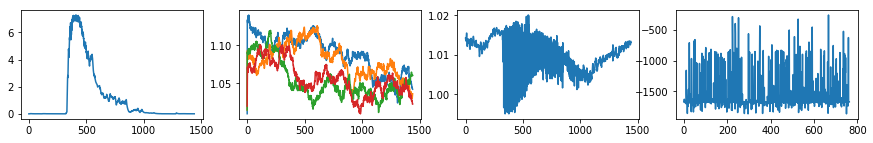

| Reward: -1672 | Episode: 764 | Qmax: -118.6695 | Action: [0.98887797 1.08033721 1.02158289 1.01278142]


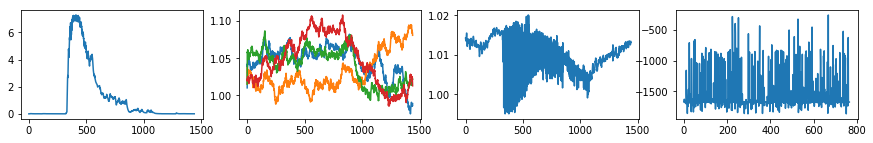

| Reward: -1669 | Episode: 765 | Qmax: -119.4107 | Action: [1.10637312 0.97550386 1.03631515 1.0941399 ]


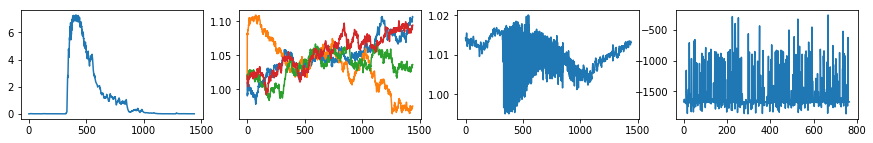

| Reward: -1248 | Episode: 766 | Qmax: -119.6138 | Action: [1.0852717  1.05798363 1.01858168 1.01950254]


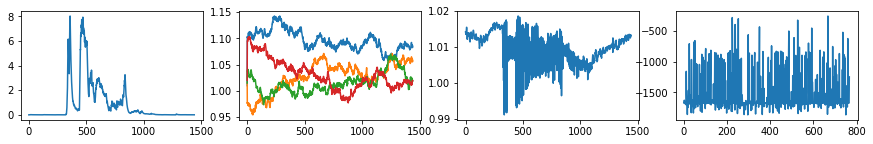

| Reward: -1669 | Episode: 767 | Qmax: -119.2269 | Action: [1.00669681 1.06284966 1.06083284 0.98104636]


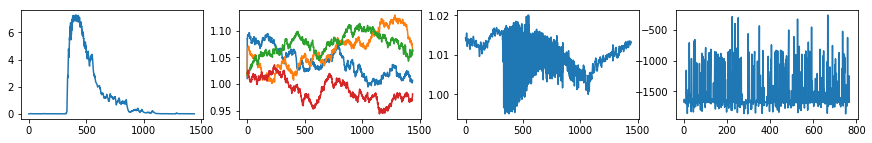

| Reward: -1280 | Episode: 768 | Qmax: -118.6916 | Action: [1.03852746 1.03189099 1.08877692 1.07034077]


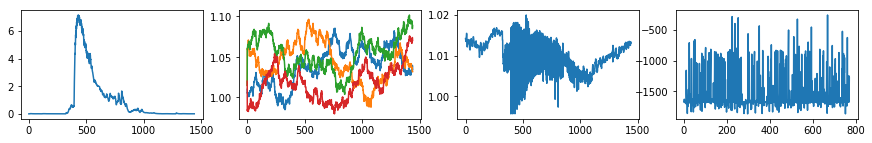

| Reward: -1669 | Episode: 769 | Qmax: -117.9076 | Action: [1.04920013 1.0633877  1.0457521  1.03420681]


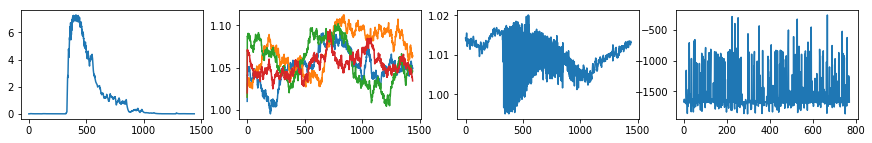

| Reward: -855 | Episode: 770 | Qmax: -117.7688 | Action: [1.0526921  1.084393   0.97829299 1.09167134]


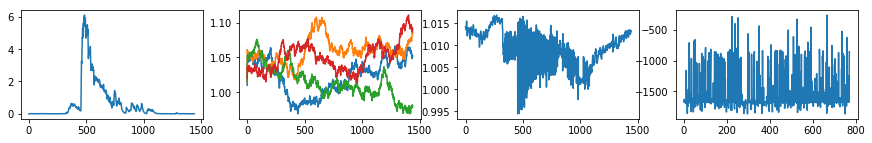

| Reward: -1669 | Episode: 771 | Qmax: -117.4178 | Action: [1.11237694 1.04086918 1.00134762 1.02008385]


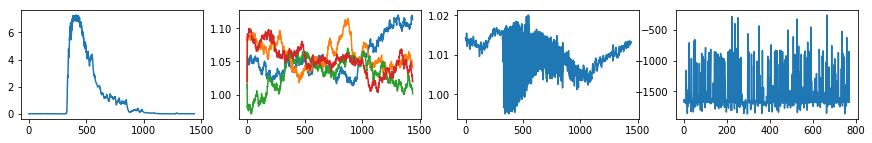

| Reward: -1290 | Episode: 772 | Qmax: -117.7620 | Action: [1.01600415 1.05327133 1.03851253 1.10506931]


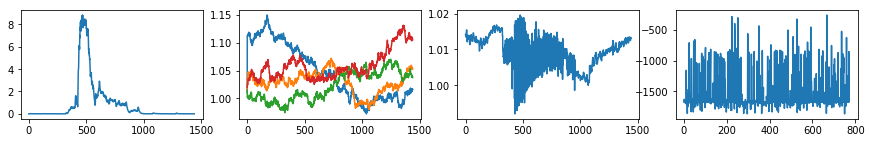

| Reward: -1669 | Episode: 773 | Qmax: -118.3167 | Action: [1.09047424 1.10620901 1.06383337 1.0417213 ]


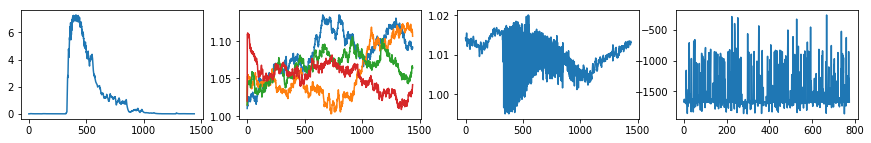

| Reward: -1669 | Episode: 774 | Qmax: -118.4580 | Action: [1.05243181 1.00408588 1.09580998 1.02347248]


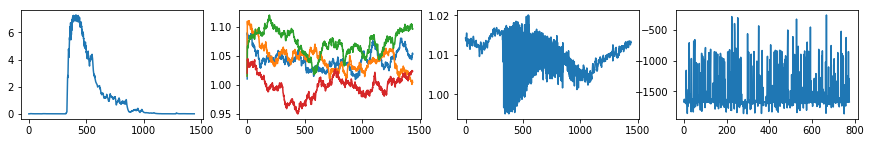

| Reward: -1782 | Episode: 775 | Qmax: -120.5718 | Action: [1.00828118 1.01568947 1.03971862 1.09178455]


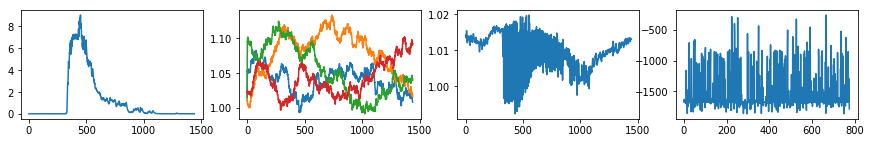

| Reward: -886 | Episode: 776 | Qmax: -121.0368 | Action: [1.08509745 1.13599789 1.05361443 1.0645229 ]


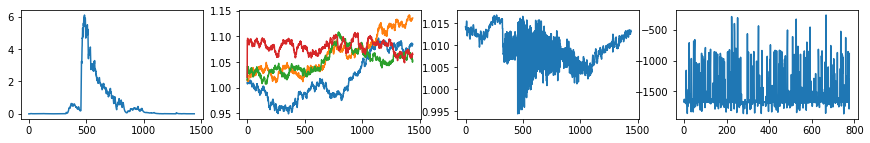

| Reward: -1669 | Episode: 777 | Qmax: -120.2431 | Action: [1.10344181 1.05736432 1.08905281 1.06498293]


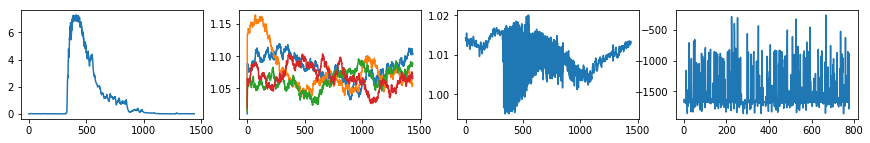

| Reward: -1669 | Episode: 778 | Qmax: -119.9850 | Action: [1.01612976 1.0032322  1.00443927 1.03723628]


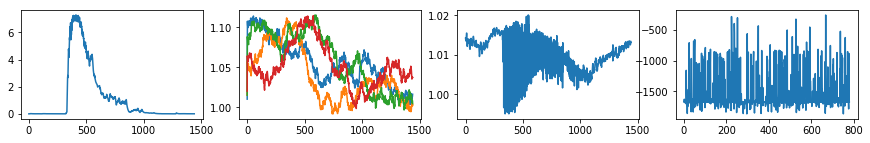

| Reward: -1007 | Episode: 779 | Qmax: -118.2416 | Action: [1.08044751 1.06413139 1.05337168 0.9589918 ]


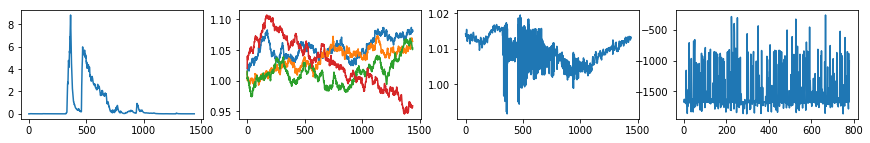

| Reward: -1669 | Episode: 780 | Qmax: -117.7076 | Action: [1.00720574 1.07734139 1.08111039 1.09807883]


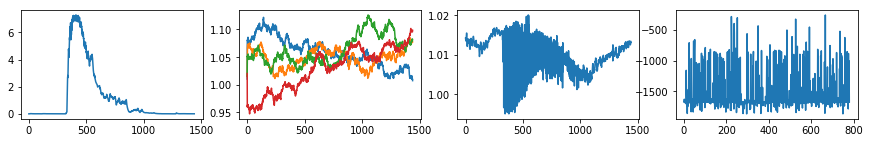

| Reward: -1720 | Episode: 781 | Qmax: -117.9617 | Action: [1.11227856 1.06579136 1.16334572 1.01172013]


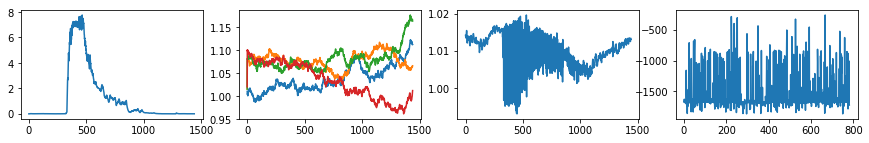

| Reward: -1669 | Episode: 782 | Qmax: -117.7590 | Action: [1.04900049 1.00568499 1.02559908 1.04802075]


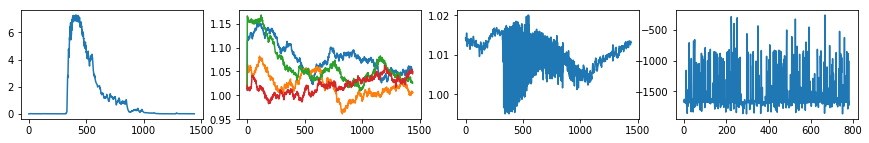

| Reward: -1669 | Episode: 783 | Qmax: -118.9179 | Action: [1.12317478 1.06486381 1.08970169 1.08510114]


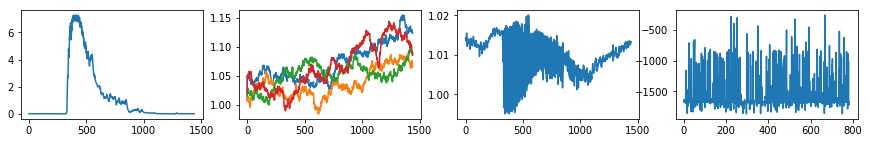

| Reward: -1669 | Episode: 784 | Qmax: -120.4075 | Action: [1.06310197 1.07318879 0.95098355 1.0765605 ]


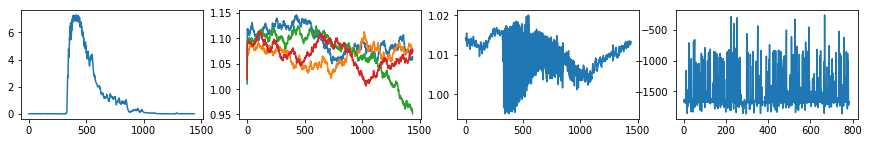

| Reward: -879 | Episode: 785 | Qmax: -121.0104 | Action: [1.02287889 1.02619415 1.01171524 1.04038592]


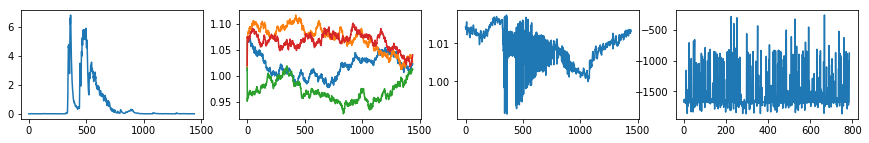

| Reward: -1368 | Episode: 786 | Qmax: -122.3830 | Action: [0.97608539 0.96356465 1.05661331 1.00596975]


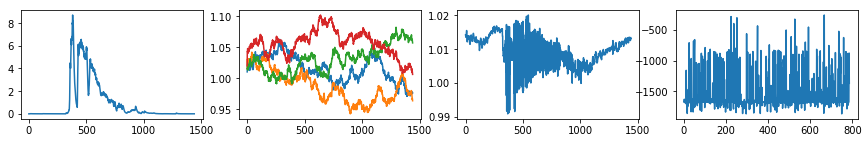

| Reward: -1669 | Episode: 787 | Qmax: -122.8276 | Action: [1.11236788 1.06824129 1.11584239 1.05947639]


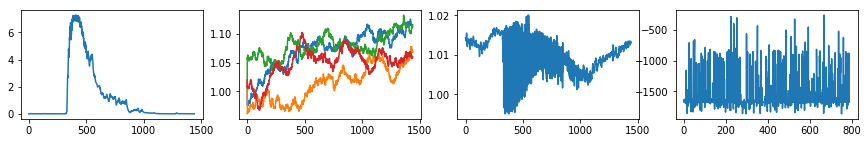

| Reward: -1669 | Episode: 788 | Qmax: -122.4292 | Action: [1.0367338  1.06726645 1.0172809  1.03916523]


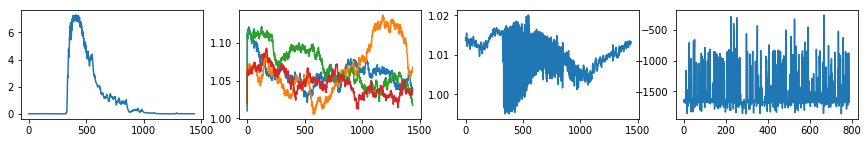

| Reward: -1461 | Episode: 789 | Qmax: -122.1310 | Action: [1.0689328  1.0283132  1.04746736 1.03883844]


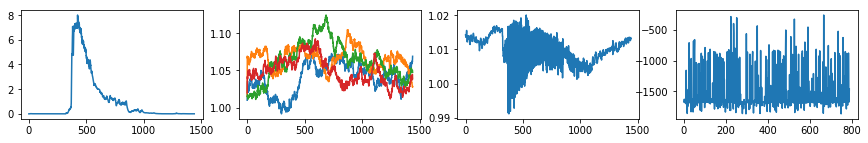

| Reward: -1669 | Episode: 790 | Qmax: -120.9965 | Action: [1.01375089 1.08758635 1.02950296 1.03786103]


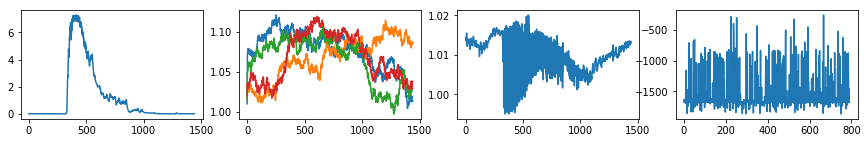

| Reward: -1708 | Episode: 791 | Qmax: -119.7345 | Action: [1.01302863 1.13042839 0.98862952 1.11503455]


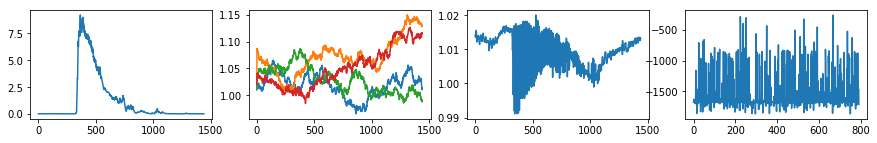

| Reward: -718 | Episode: 792 | Qmax: -119.5345 | Action: [1.02339745 1.05418282 1.00266255 1.01780754]


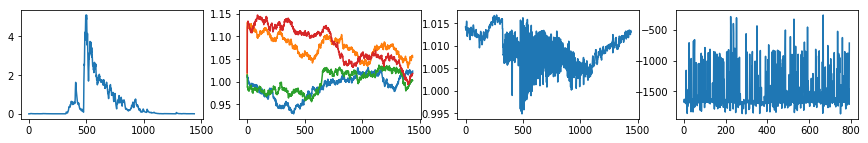

| Reward: -1702 | Episode: 793 | Qmax: -119.7775 | Action: [1.02861673 1.03149337 1.03652415 1.06179081]


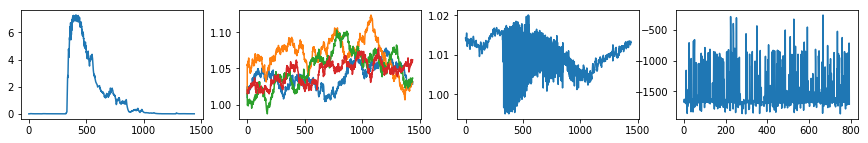

| Reward: -1632 | Episode: 794 | Qmax: -119.6832 | Action: [1.06414849 1.11205504 1.06452024 1.0327043 ]


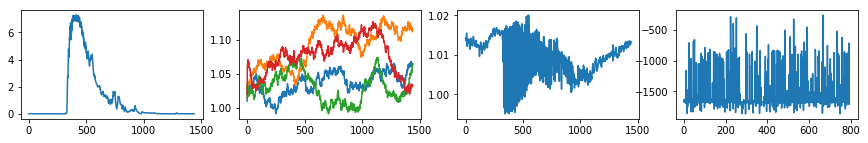

| Reward: -1680 | Episode: 795 | Qmax: -119.8818 | Action: [1.06388483 1.05367534 1.02985214 0.99965591]


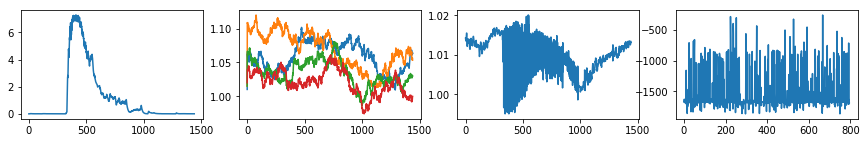

| Reward: -1426 | Episode: 796 | Qmax: -120.0161 | Action: [1.09884867 1.03331262 0.97686743 1.0562175 ]


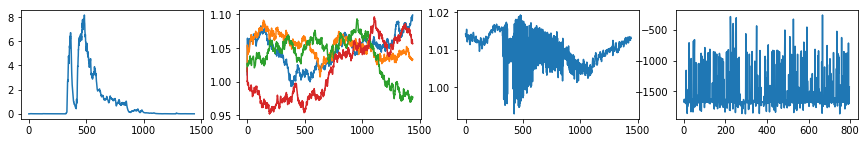

| Reward: -1027 | Episode: 797 | Qmax: -120.5423 | Action: [1.0288986  1.09449019 0.98561064 1.0525891 ]


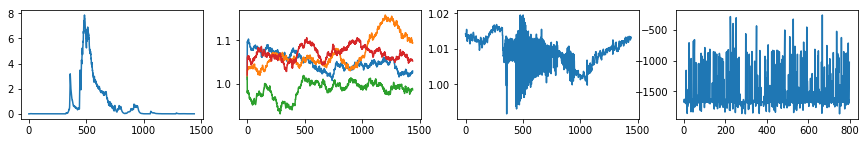

| Reward: -824 | Episode: 798 | Qmax: -120.9091 | Action: [1.05061145 1.06124396 0.99614134 1.00285921]


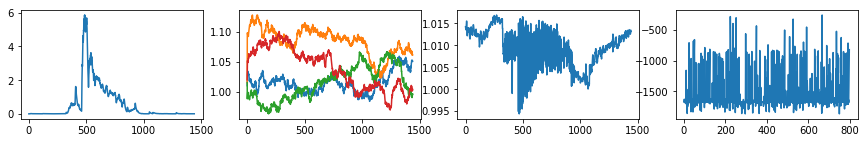

| Reward: -1858 | Episode: 799 | Qmax: -120.3354 | Action: [1.11804514 0.99667736 1.01861846 1.07164934]


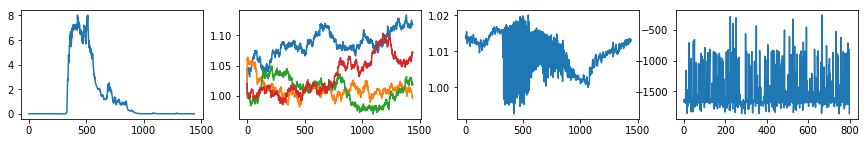

| Reward: -1673 | Episode: 800 | Qmax: -120.4433 | Action: [1.00601143 1.06088784 1.06649245 1.01270961]


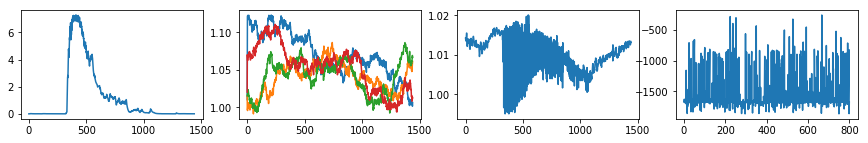

| Reward: -1103 | Episode: 801 | Qmax: -120.4675 | Action: [1.10394693 1.03366105 1.10785304 1.00122232]


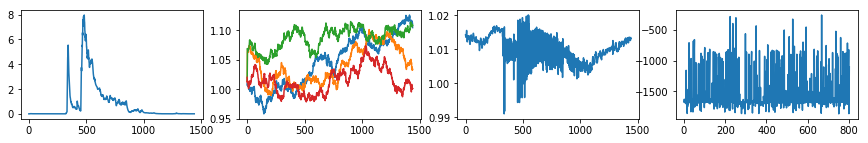

| Reward: -1669 | Episode: 802 | Qmax: -120.1003 | Action: [1.09836407 1.0308689  1.0785362  1.03688907]


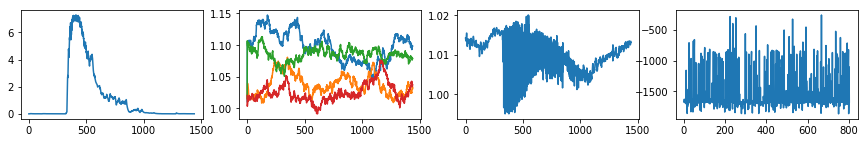

| Reward: -1669 | Episode: 803 | Qmax: -120.5210 | Action: [1.06888838 1.04150273 1.03229697 1.07081347]


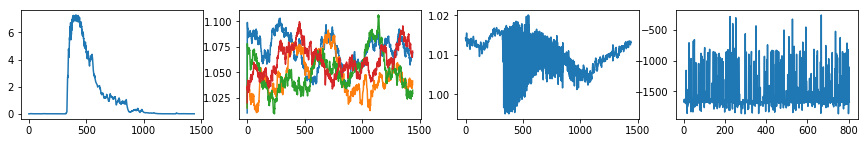

| Reward: -1669 | Episode: 804 | Qmax: -121.3953 | Action: [1.10341735 1.01911968 1.07632658 0.99625829]


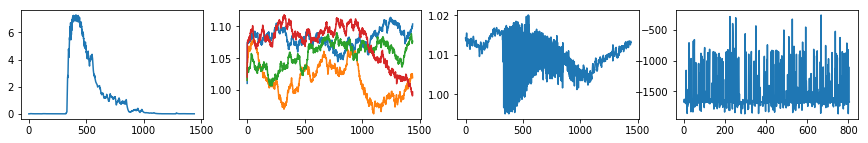

| Reward: -1733 | Episode: 805 | Qmax: -122.0415 | Action: [1.11877251 1.05888742 1.01980668 1.07142664]


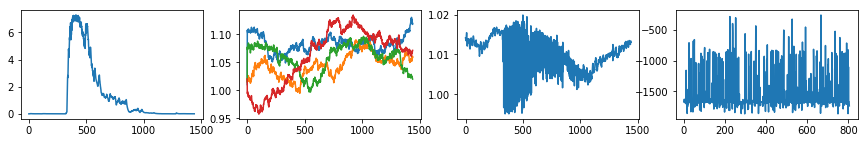

| Reward: -1685 | Episode: 806 | Qmax: -122.4294 | Action: [1.0530544  1.05612002 1.00791895 1.0540126 ]


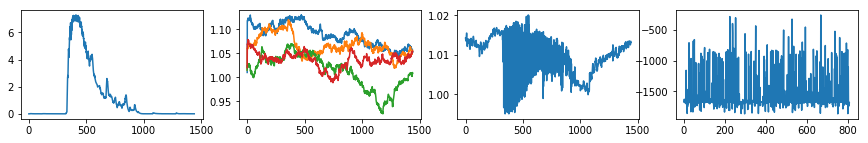

| Reward: -846 | Episode: 807 | Qmax: -122.2030 | Action: [1.0259377  1.02818283 1.03461091 1.01157393]


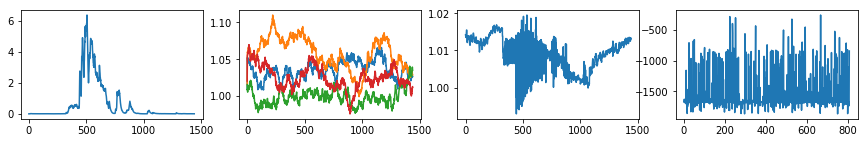

| Reward: -1527 | Episode: 808 | Qmax: -121.4041 | Action: [1.06997667 1.08897766 1.08220959 1.12552501]


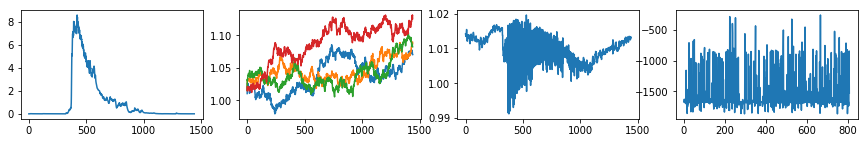

| Reward: -1669 | Episode: 809 | Qmax: -120.9141 | Action: [1.02636607 1.06007531 1.04466735 0.97222976]


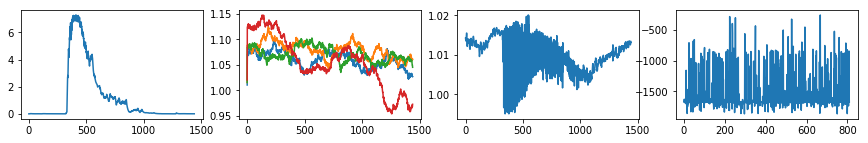

| Reward: -1524 | Episode: 810 | Qmax: -121.3969 | Action: [0.97586782 1.02476529 1.07917394 1.03951361]


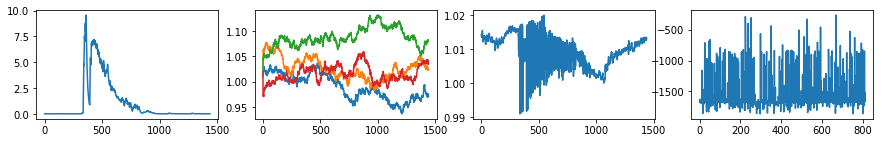

| Reward: -1661 | Episode: 811 | Qmax: -120.8829 | Action: [1.07408659 1.04319638 1.03072921 1.05688693]


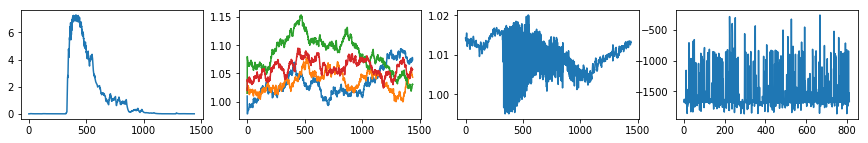

| Reward: -1647 | Episode: 812 | Qmax: -118.7220 | Action: [1.07794896 1.02805249 1.06263463 1.03511497]


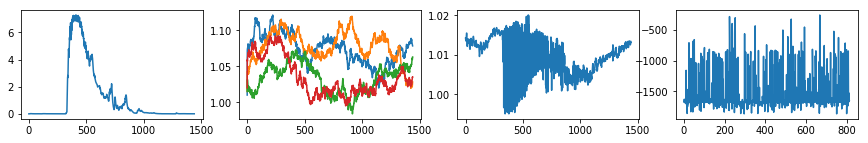

| Reward: -1675 | Episode: 813 | Qmax: -117.1360 | Action: [0.99159173 1.03855537 1.03519052 1.07497588]


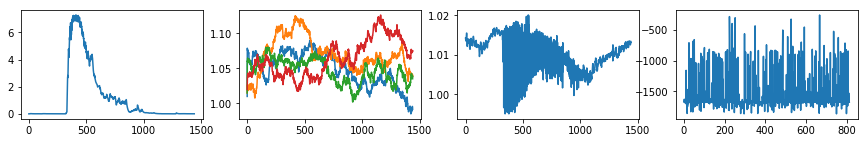

| Reward: -1669 | Episode: 814 | Qmax: -116.2613 | Action: [1.02801469 1.04590462 1.05389955 1.05559931]


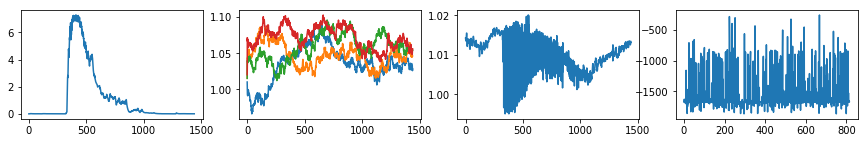

| Reward: -1601 | Episode: 815 | Qmax: -116.7651 | Action: [1.01784749 1.07509725 1.02215126 1.10576714]


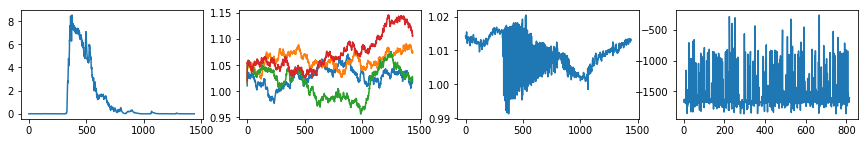

| Reward: -869 | Episode: 816 | Qmax: -116.8716 | Action: [1.04061896 1.12116581 1.05741103 1.07579153]


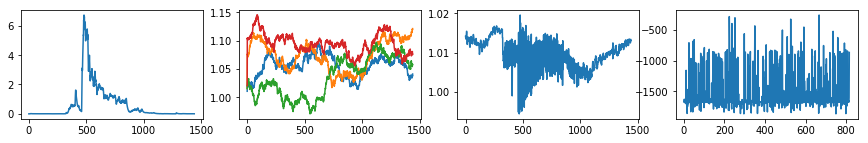

| Reward: -1680 | Episode: 817 | Qmax: -117.5434 | Action: [1.05434457 1.07221622 1.01335095 1.04530008]


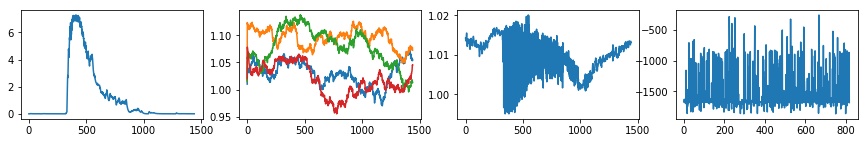

| Reward: -1669 | Episode: 818 | Qmax: -118.6377 | Action: [1.07944208 1.04641299 1.07568894 0.98236657]


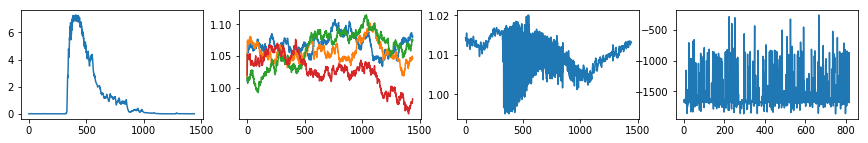

| Reward: -1669 | Episode: 819 | Qmax: -118.3801 | Action: [1.0759202  1.06792157 1.03647845 1.02606225]


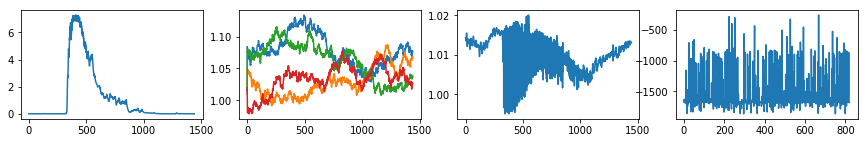

| Reward: -1656 | Episode: 820 | Qmax: -117.9019 | Action: [1.04222531 1.0332774  1.04022185 1.08350569]


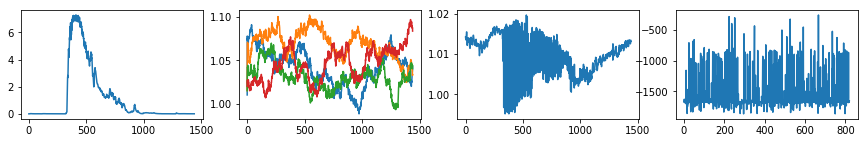

| Reward: -1726 | Episode: 821 | Qmax: -118.0390 | Action: [1.06188924 0.97287763 1.06659462 1.03446456]


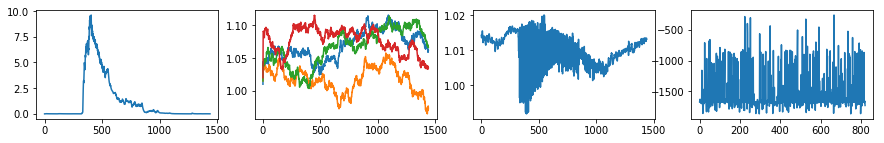

| Reward: -1802 | Episode: 822 | Qmax: -117.7285 | Action: [1.08116852 1.02376867 1.03972524 1.07369703]


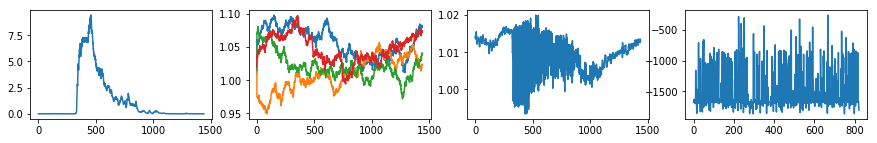

| Reward: -1669 | Episode: 823 | Qmax: -117.1300 | Action: [1.0642869  0.9818571  1.03750444 1.07955728]


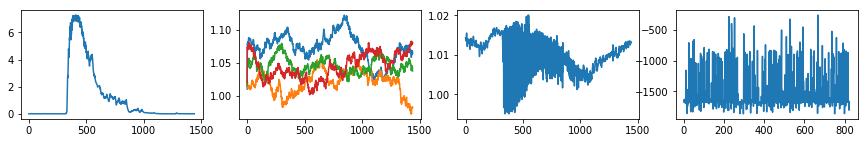

| Reward: -1669 | Episode: 824 | Qmax: -116.5304 | Action: [1.09901777 0.98513954 1.03651544 1.10556149]


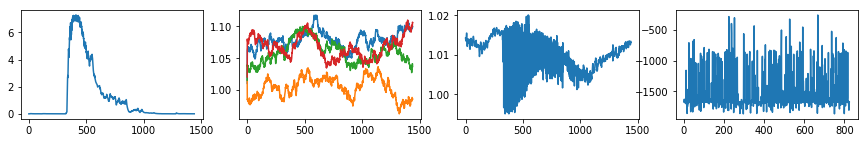

| Reward: -1097 | Episode: 825 | Qmax: -115.7723 | Action: [1.06963893 1.08063214 0.99559896 1.15266703]


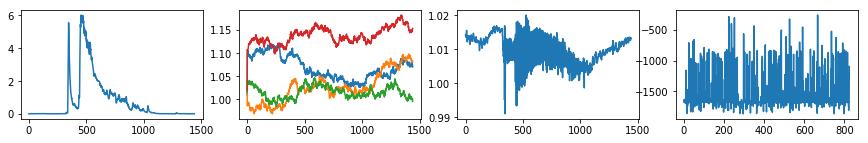

| Reward: -1408 | Episode: 826 | Qmax: -114.6943 | Action: [1.04359648 1.06201906 1.01292864 1.07256005]


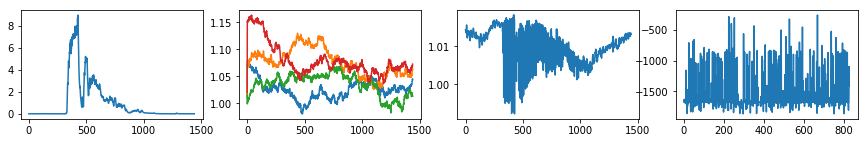

| Reward: -1203 | Episode: 827 | Qmax: -114.6700 | Action: [1.05721764 1.10657607 1.07691765 1.10833402]


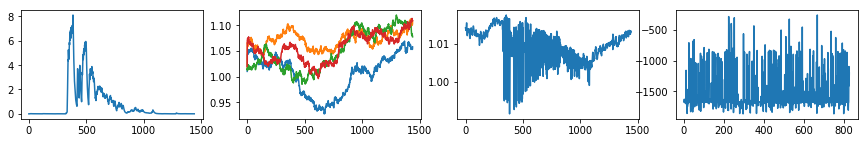

| Reward: -1669 | Episode: 828 | Qmax: -114.7556 | Action: [1.06127746 1.03634592 1.09501026 1.04291127]


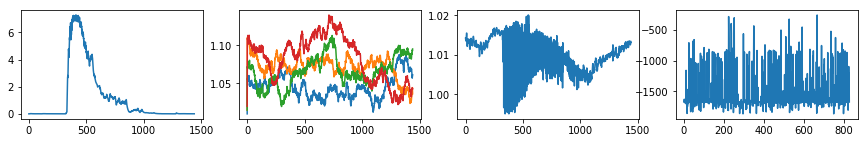

| Reward: -1359 | Episode: 829 | Qmax: -113.0946 | Action: [0.98532475 1.04297914 1.05811497 1.0119079 ]


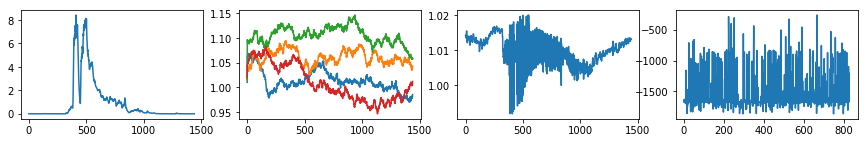

| Reward: -1686 | Episode: 830 | Qmax: -112.2151 | Action: [1.02595547 1.01669674 1.04378634 0.97444283]


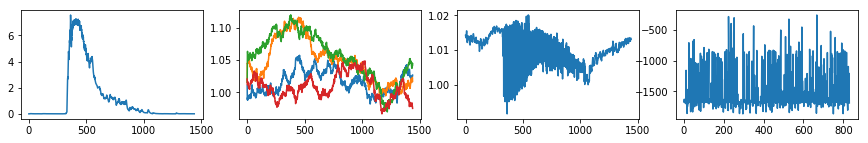

| Reward: -1507 | Episode: 831 | Qmax: -111.4898 | Action: [1.10029114 1.07941283 1.05401001 1.07126127]


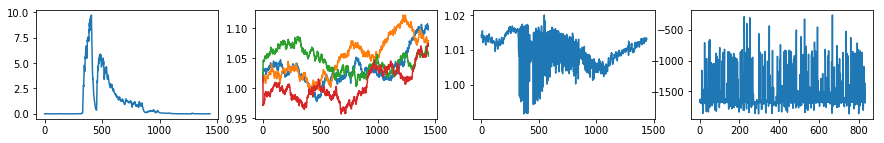

| Reward: -1776 | Episode: 832 | Qmax: -110.9278 | Action: [1.06337024 1.07903839 0.99987233 1.07256053]


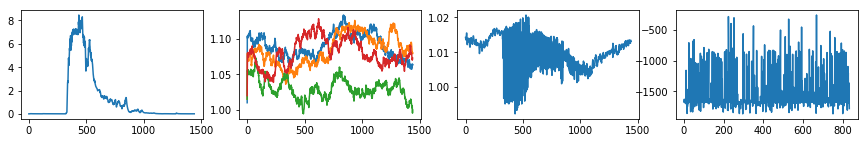

| Reward: -1253 | Episode: 833 | Qmax: -110.7506 | Action: [1.02793255 1.01594398 1.03318611 1.04771647]


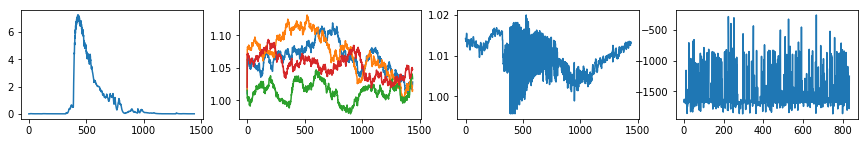

| Reward: -1772 | Episode: 834 | Qmax: -110.5094 | Action: [1.07711813 1.0089823  1.08210734 1.06739229]


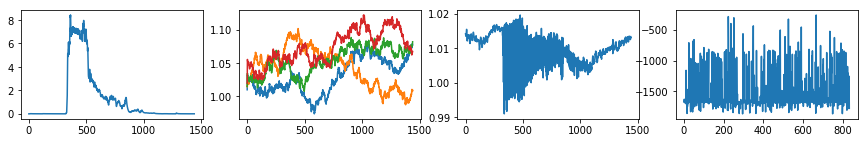

| Reward: -1756 | Episode: 835 | Qmax: -108.5128 | Action: [1.12463806 1.03764663 1.06145088 1.05692058]


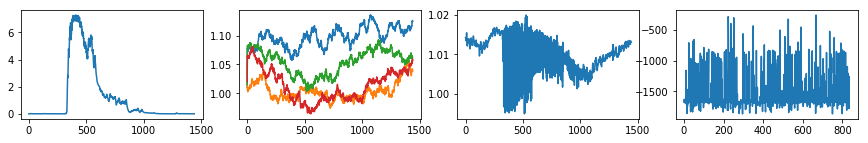

| Reward: -1698 | Episode: 836 | Qmax: -107.6194 | Action: [1.02584572 1.10111147 1.10364959 0.99324461]


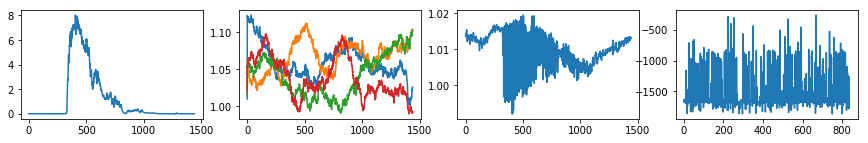

| Reward: -1819 | Episode: 837 | Qmax: -106.7468 | Action: [1.05804193 1.05628811 1.03078508 1.03836534]


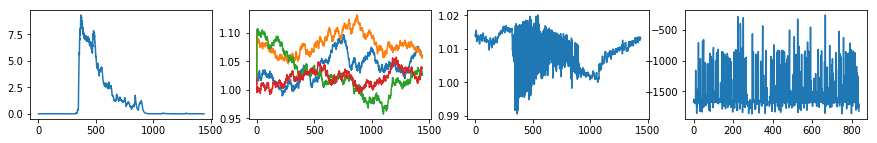

| Reward: -1669 | Episode: 838 | Qmax: -107.6396 | Action: [1.05534134 1.07501908 1.03490871 1.09591743]


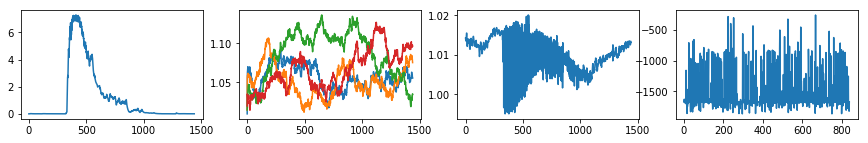

| Reward: -1634 | Episode: 839 | Qmax: -108.4875 | Action: [1.05840946 1.06454133 1.10661418 1.11768935]


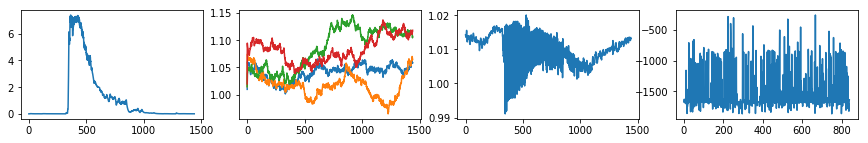

| Reward: -1680 | Episode: 840 | Qmax: -108.2359 | Action: [1.08989068 1.10063922 1.09621887 1.04389447]


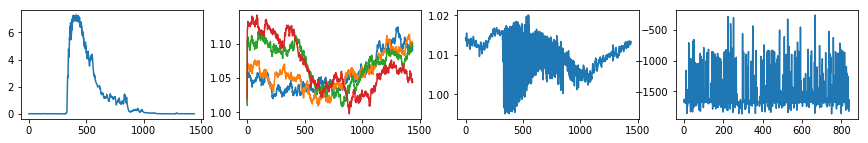

| Reward: -1693 | Episode: 841 | Qmax: -107.6661 | Action: [1.00212696 1.00738142 1.03268334 1.00094292]


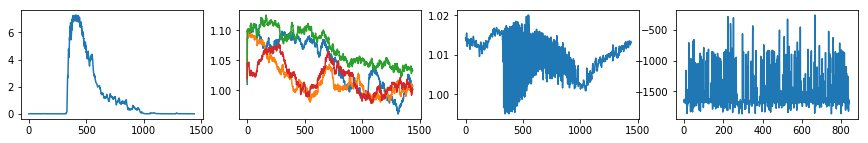

| Reward: -834 | Episode: 842 | Qmax: -107.3973 | Action: [0.99792706 1.01481579 1.01806322 1.05330039]


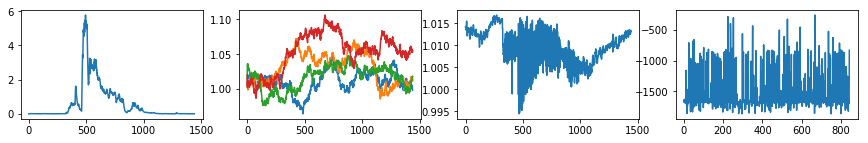

| Reward: -1669 | Episode: 843 | Qmax: -107.7595 | Action: [1.04231641 1.01337566 1.04812658 1.10052099]


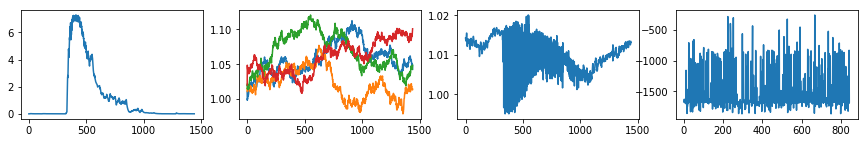

| Reward: -942 | Episode: 844 | Qmax: -108.4496 | Action: [1.09584751 0.97652983 1.03984439 1.10039139]


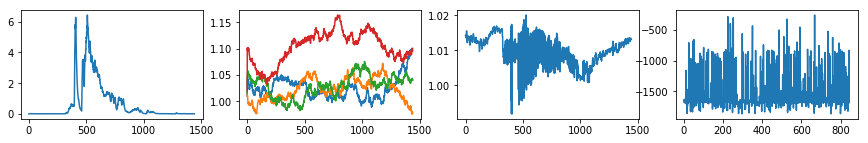

| Reward: -1668 | Episode: 845 | Qmax: -110.2605 | Action: [1.08807588 0.97182823 1.06446521 1.07676974]


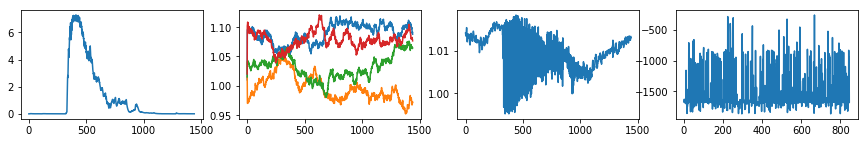

| Reward: -1669 | Episode: 846 | Qmax: -112.2384 | Action: [1.00762512 0.96409823 1.04878929 1.03346386]


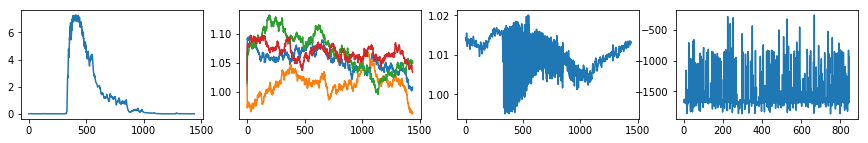

| Reward: -1669 | Episode: 847 | Qmax: -114.3079 | Action: [1.08336343 1.10508162 0.99364877 1.05158269]


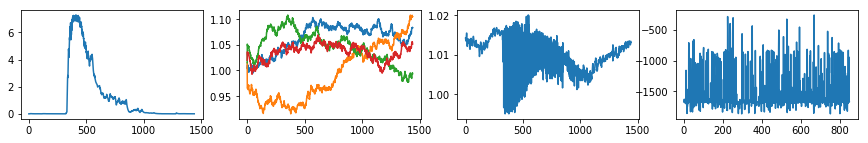

| Reward: -1656 | Episode: 848 | Qmax: -113.3465 | Action: [1.0089649  1.09709797 1.01138505 1.03942037]


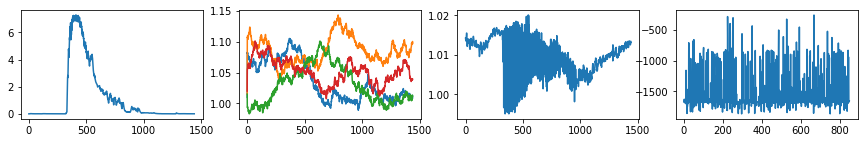

| Reward: -1595 | Episode: 849 | Qmax: -113.8205 | Action: [0.97045498 1.08412138 1.04886036 1.02055725]


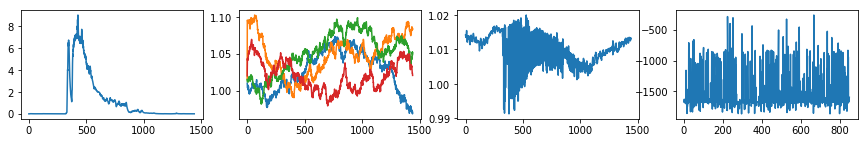

| Reward: -1102 | Episode: 850 | Qmax: -115.2864 | Action: [1.07391271 1.01093504 1.07401149 0.9848736 ]


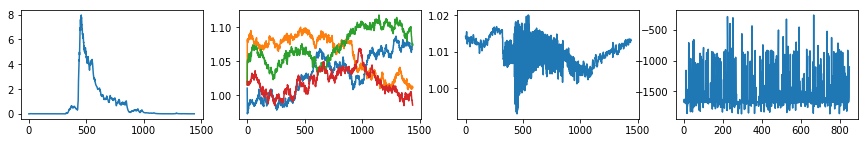

| Reward: -1669 | Episode: 851 | Qmax: -116.6099 | Action: [1.01222265 1.0475672  1.07522036 1.04986231]


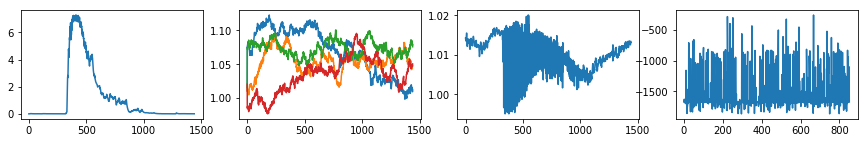

| Reward: -1681 | Episode: 852 | Qmax: -117.2144 | Action: [1.0328147  1.03124562 1.06060072 1.07365256]


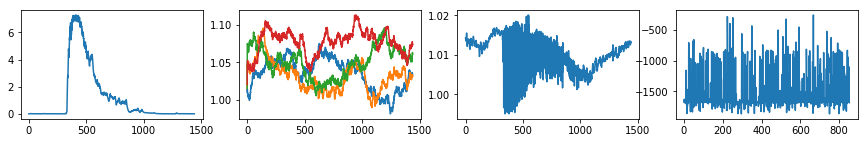

| Reward: -1669 | Episode: 853 | Qmax: -118.6154 | Action: [1.04682038 1.02782842 1.03557955 1.01568358]


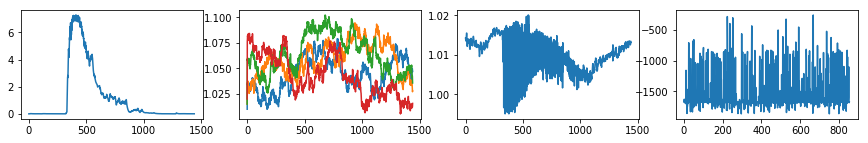

| Reward: -1721 | Episode: 854 | Qmax: -120.0899 | Action: [1.05042342 1.03934644 1.13534785 1.02647731]


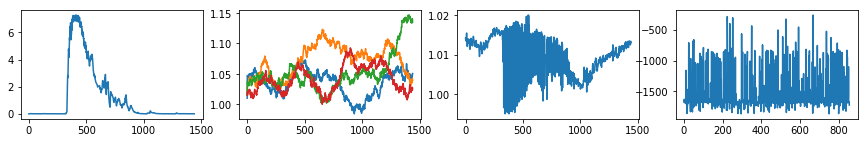

| Reward: -1680 | Episode: 855 | Qmax: -121.3080 | Action: [0.96476874 1.00736534 1.00767041 1.06881227]


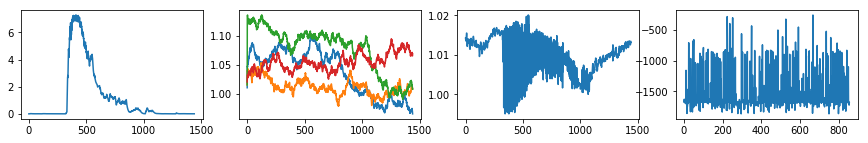

| Reward: -859 | Episode: 856 | Qmax: -122.7915 | Action: [1.00537892 1.10219289 1.0161588  1.0153812 ]


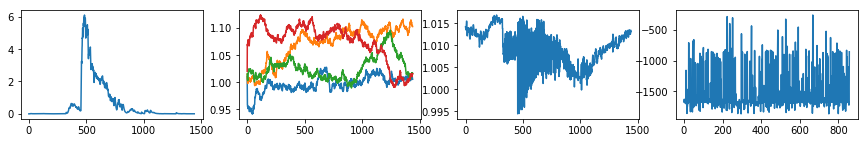

| Reward: -1771 | Episode: 857 | Qmax: -124.7347 | Action: [1.02475664 1.07722636 1.04450607 1.04859181]


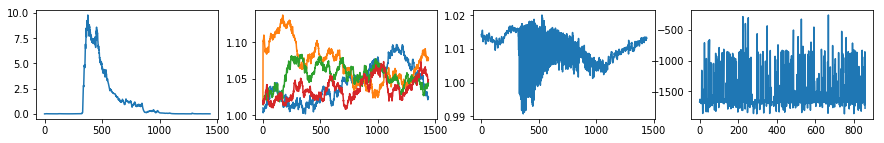

| Reward: -960 | Episode: 858 | Qmax: -125.9237 | Action: [1.04000889 1.08805474 0.99937956 1.00958767]


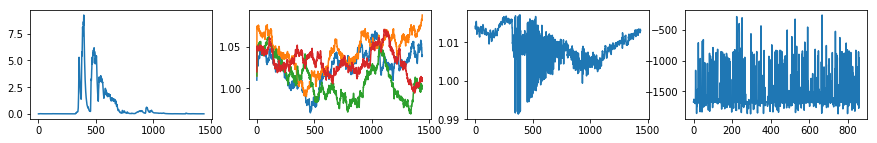

| Reward: -1694 | Episode: 859 | Qmax: -125.2428 | Action: [1.04968497 1.11982836 1.0294711  1.0560473 ]


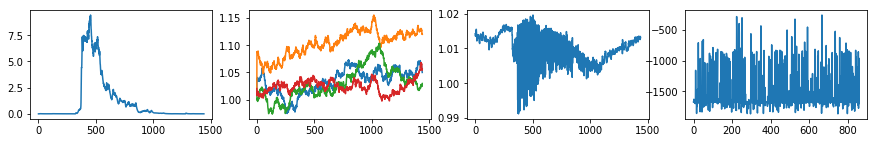

| Reward: -848 | Episode: 860 | Qmax: -123.7353 | Action: [1.07066909 1.08094556 1.04309633 1.05857858]


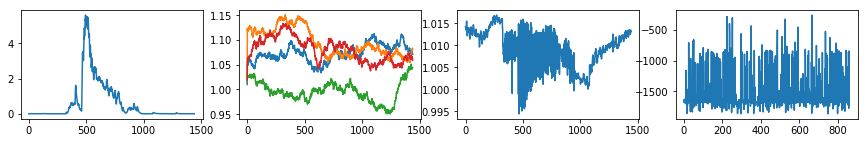

| Reward: -1341 | Episode: 861 | Qmax: -123.0874 | Action: [0.98975828 1.06080093 1.0465584  0.98675227]


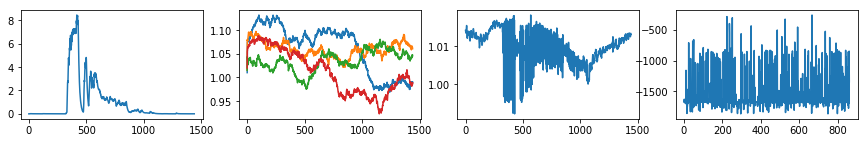

| Reward: -1692 | Episode: 862 | Qmax: -123.4595 | Action: [0.994731   1.06142057 1.04144914 1.01532684]


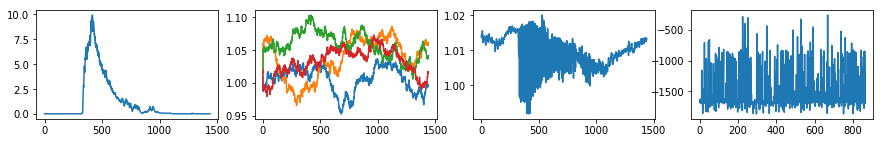

| Reward: -1062 | Episode: 863 | Qmax: -123.3348 | Action: [1.04145528 1.0573983  1.06568879 1.10484741]


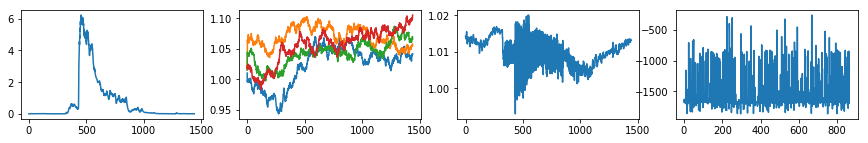

| Reward: -1669 | Episode: 864 | Qmax: -124.0368 | Action: [1.06545522 1.03542086 1.06800555 1.09030869]


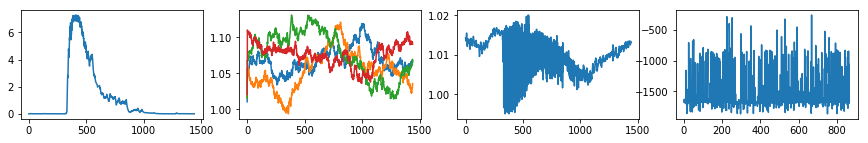

| Reward: -1671 | Episode: 865 | Qmax: -124.6969 | Action: [1.07916155 1.03477054 1.03889301 1.0970775 ]


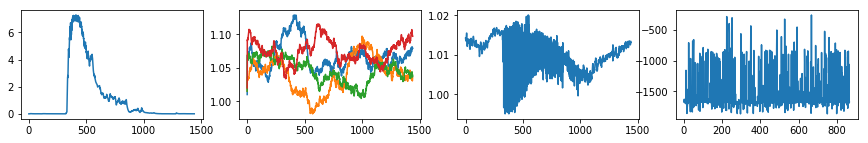

| Reward: -1669 | Episode: 866 | Qmax: -124.9161 | Action: [1.03419249 1.05078978 1.11055278 1.03117336]


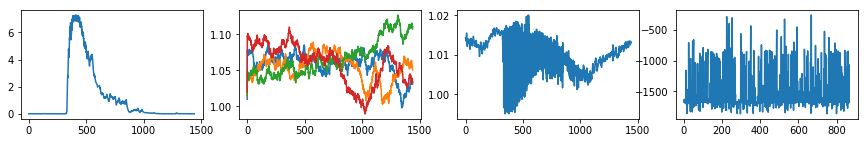

| Reward: -1669 | Episode: 867 | Qmax: -123.3325 | Action: [1.0255951  1.06155979 1.08252986 1.14181885]


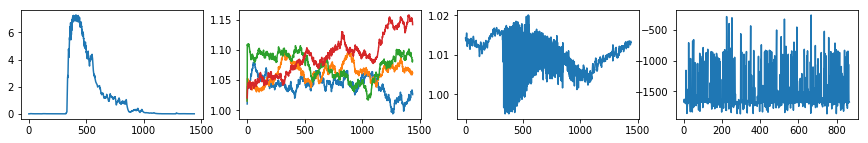

| Reward: -1675 | Episode: 868 | Qmax: -122.1731 | Action: [1.10642593 1.06532199 1.11102995 1.06666591]


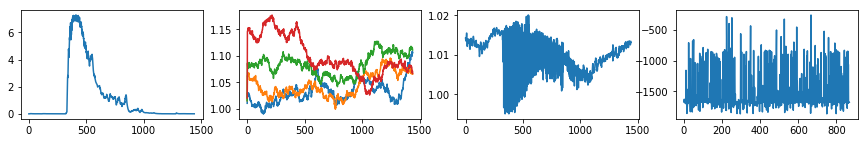

| Reward: -1669 | Episode: 869 | Qmax: -122.3460 | Action: [1.09732021 1.14078315 1.08423589 1.05443744]


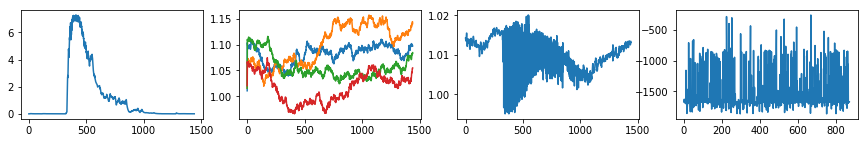

| Reward: -1680 | Episode: 870 | Qmax: -122.0509 | Action: [1.05979335 0.99846349 1.06203844 1.09541182]


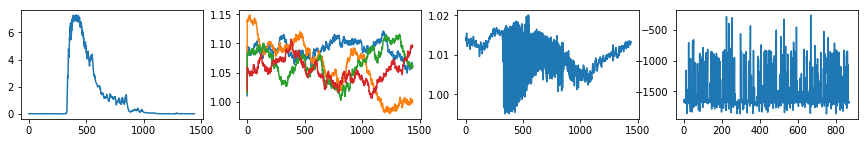

| Reward: -1669 | Episode: 871 | Qmax: -121.2675 | Action: [1.08853996 1.04516422 1.03831686 1.07162596]


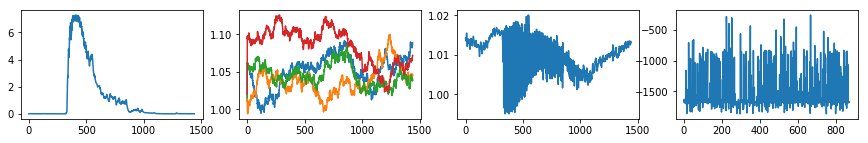

| Reward: -1669 | Episode: 872 | Qmax: -120.4238 | Action: [1.13981311 1.08084235 1.01635867 1.04552136]


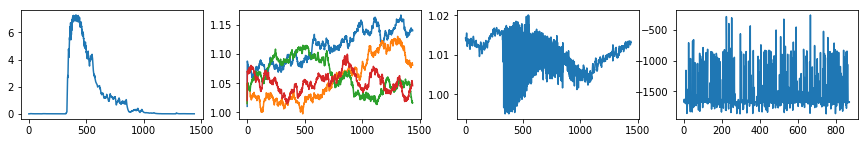

| Reward: -711 | Episode: 873 | Qmax: -119.3088 | Action: [1.05817394 1.03392671 1.11461831 1.06881291]


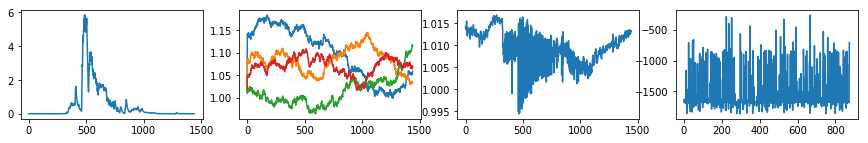

| Reward: -1332 | Episode: 874 | Qmax: -117.3788 | Action: [0.9871162  1.08117054 1.08721319 1.01950533]


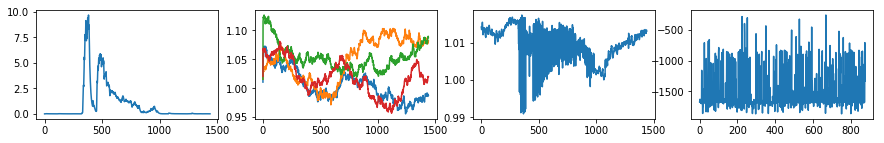

| Reward: -1801 | Episode: 875 | Qmax: -115.6761 | Action: [1.04823531 0.9782133  1.05080754 1.05699772]


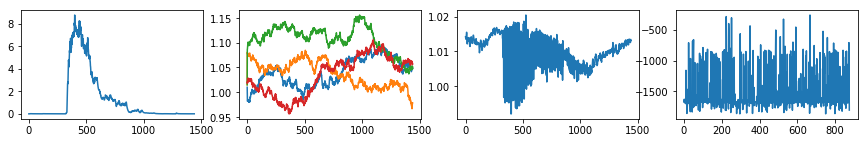

| Reward: -1663 | Episode: 876 | Qmax: -114.4541 | Action: [0.99920266 1.09106635 1.01529082 1.00569317]


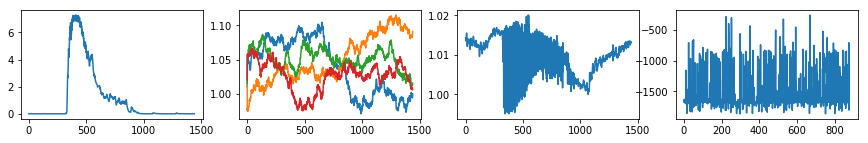

| Reward: -702 | Episode: 877 | Qmax: -112.6154 | Action: [1.02035167 1.0423534  1.0015125  1.0431739 ]


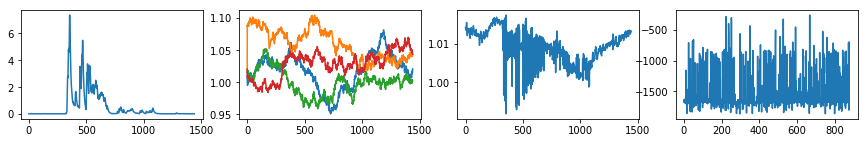

| Reward: -1341 | Episode: 878 | Qmax: -110.7829 | Action: [1.04411206 1.04154841 1.06950884 1.06823324]


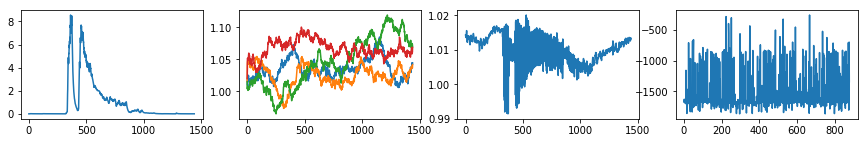

| Reward: -1655 | Episode: 879 | Qmax: -108.9356 | Action: [1.04711248 1.06295288 1.00699147 1.05701116]


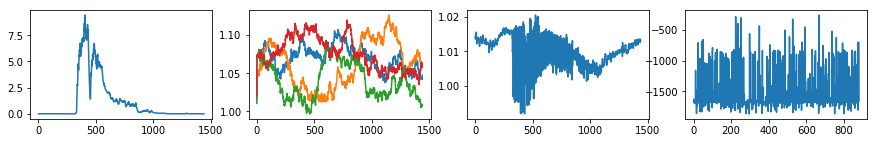

| Reward: -1120 | Episode: 880 | Qmax: -107.7183 | Action: [1.05449448 1.04340387 1.02873981 1.11770506]


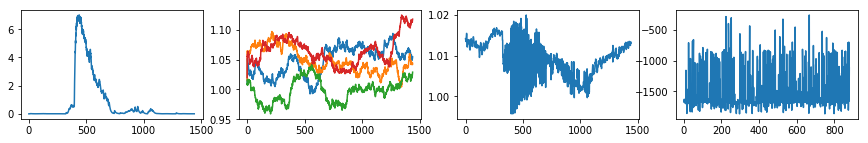

| Reward: -1675 | Episode: 881 | Qmax: -106.6358 | Action: [0.99119807 1.02938445 1.06627776 1.0719442 ]


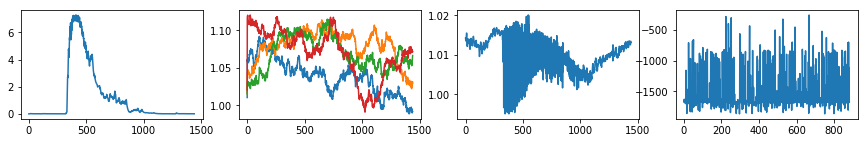

| Reward: -1583 | Episode: 882 | Qmax: -105.7612 | Action: [1.08859829 1.06333405 1.02405749 1.0132435 ]


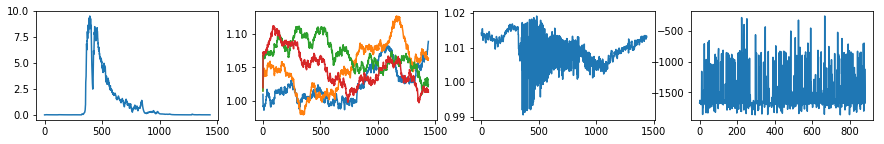

| Reward: -1643 | Episode: 883 | Qmax: -105.4321 | Action: [1.07172325 1.05196422 1.02641971 1.05447824]


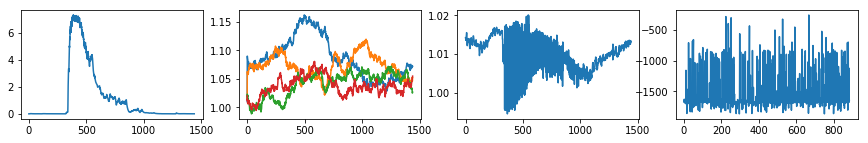

| Reward: -863 | Episode: 884 | Qmax: -105.5891 | Action: [1.00229208 1.03198491 1.04530343 1.07132245]


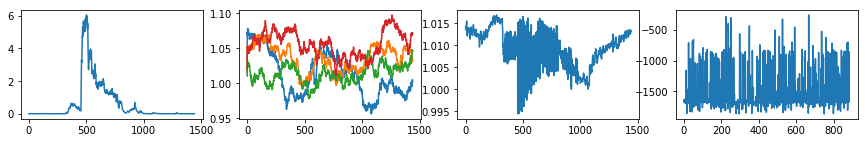

| Reward: -692 | Episode: 885 | Qmax: -106.1849 | Action: [1.06350513 1.12706616 0.99945485 1.15649474]


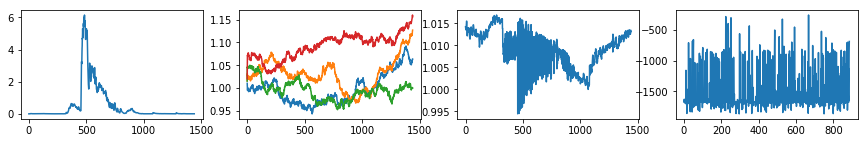

| Reward: -1669 | Episode: 886 | Qmax: -106.0843 | Action: [1.01697319 1.04036985 1.08950213 1.08479368]


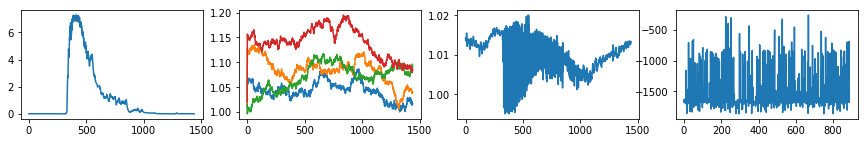

| Reward: -1671 | Episode: 887 | Qmax: -105.1989 | Action: [0.9850091  1.03418572 1.08796745 1.07312463]


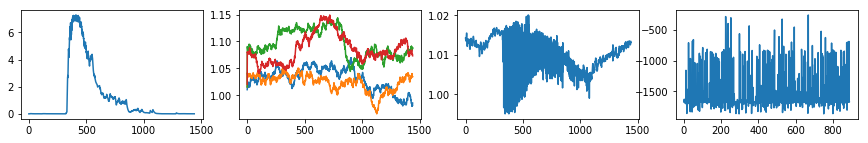

| Reward: -1722 | Episode: 888 | Qmax: -103.5954 | Action: [0.98712965 1.07940937 1.02250221 1.02719334]


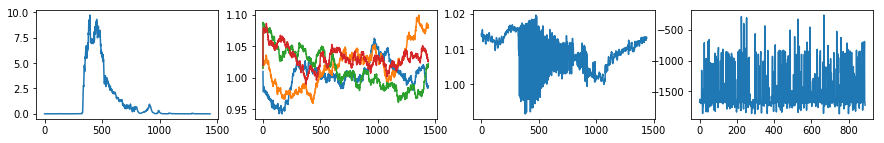

| Reward: -1156 | Episode: 889 | Qmax: -100.4392 | Action: [1.08308628 1.06443497 1.02282149 1.02302852]


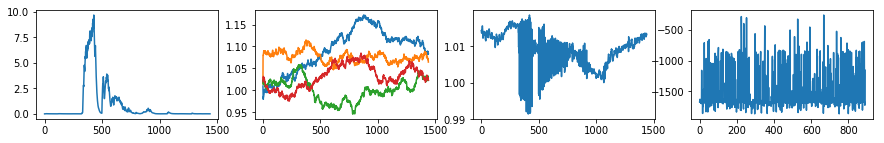

| Reward: -1669 | Episode: 890 | Qmax: -99.7487 | Action: [1.05394586 1.04387839 1.03365254 1.0296379 ]


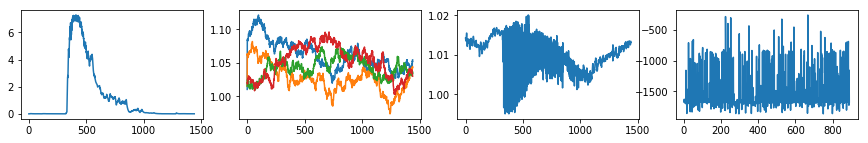

| Reward: -1680 | Episode: 891 | Qmax: -99.0844 | Action: [0.98823238 1.06413219 1.02926601 1.02408831]


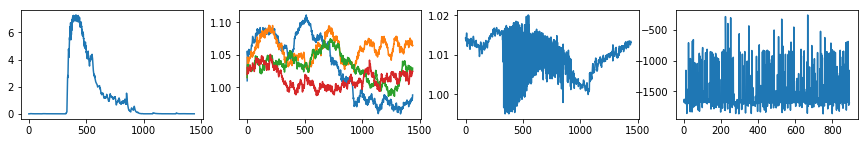

| Reward: -790 | Episode: 892 | Qmax: -98.6259 | Action: [1.02853787 1.03086755 1.01734843 1.00712824]


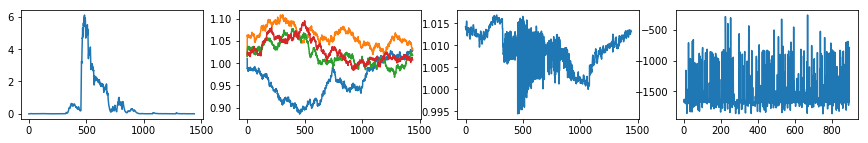

| Reward: -683 | Episode: 893 | Qmax: -97.5730 | Action: [1.03996001 1.04145928 1.05251907 0.98533489]


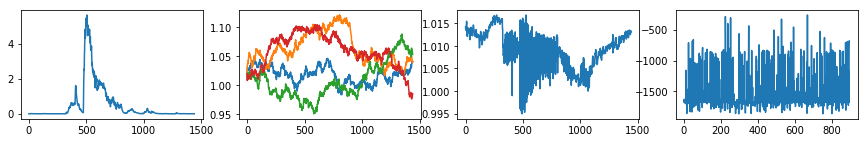

| Reward: -1669 | Episode: 894 | Qmax: -96.3796 | Action: [1.01109664 1.09393679 1.09103646 1.01191766]


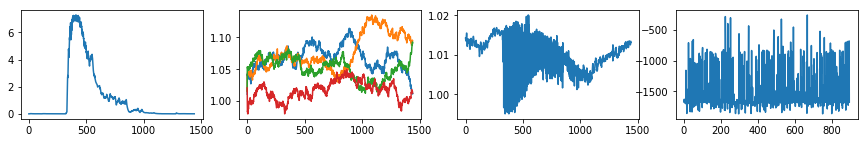

| Reward: -1669 | Episode: 895 | Qmax: -95.5063 | Action: [1.04801687 1.06038847 1.06641295 1.08279194]


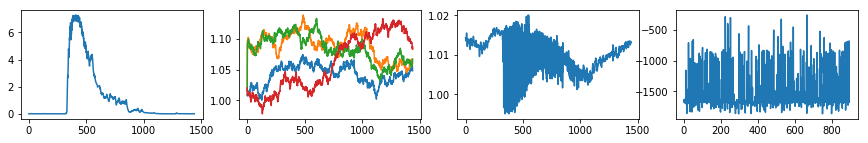

| Reward: -1738 | Episode: 896 | Qmax: -94.2603 | Action: [1.07612131 1.13000355 1.04257604 1.04632052]


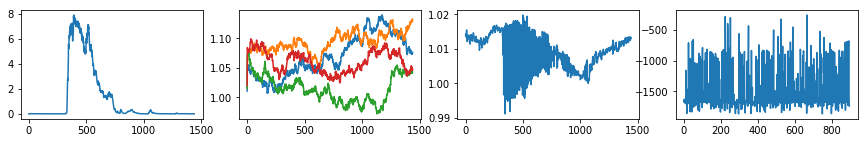

| Reward: -1677 | Episode: 897 | Qmax: -94.4529 | Action: [1.03328522 1.04972191 1.04838311 1.08032818]


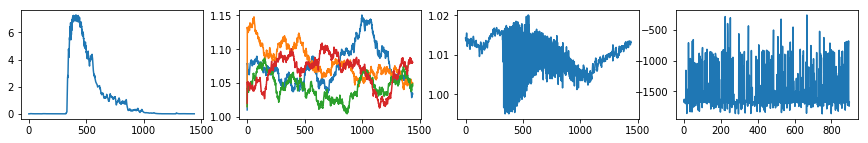

| Reward: -1710 | Episode: 898 | Qmax: -94.6224 | Action: [1.07189528 1.00665355 1.04265201 1.06164545]


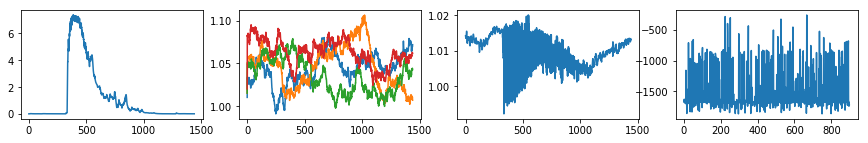

| Reward: -702 | Episode: 899 | Qmax: -95.0175 | Action: [1.06193453 1.05116063 0.93668214 0.99626586]


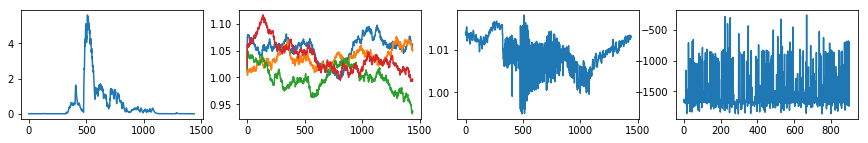

| Reward: -1296 | Episode: 900 | Qmax: -95.1090 | Action: [1.09847136 1.04374049 0.99820175 1.01976972]


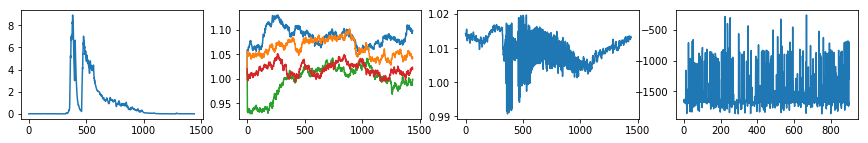

| Reward: -390 | Episode: 901 | Qmax: -95.4009 | Action: [1.04156604 1.04608951 1.02156963 1.08360381]


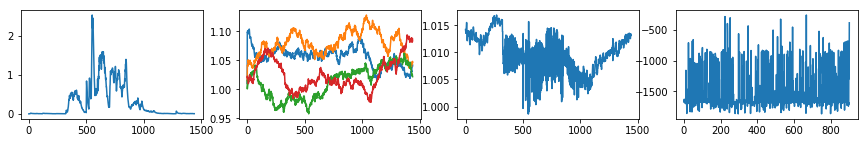

| Reward: -1673 | Episode: 902 | Qmax: -95.3410 | Action: [1.03554941 1.08729681 1.04878554 1.06062625]


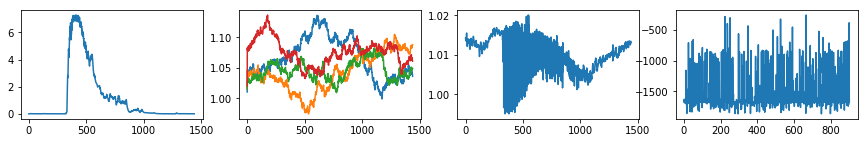

| Reward: -1670 | Episode: 903 | Qmax: -95.2801 | Action: [1.1258627  1.10598597 0.99021494 1.00395941]


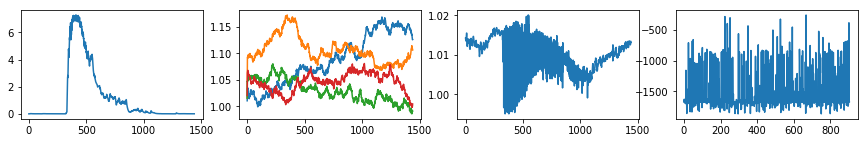

| Reward: -1266 | Episode: 904 | Qmax: -96.5820 | Action: [1.03118646 1.07601625 0.98815514 1.04639535]


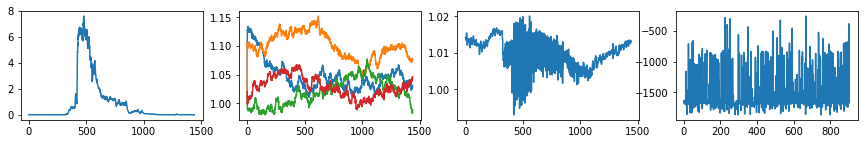

| Reward: -1647 | Episode: 905 | Qmax: -97.4902 | Action: [1.10867198 1.04940765 1.0472407  1.07403138]


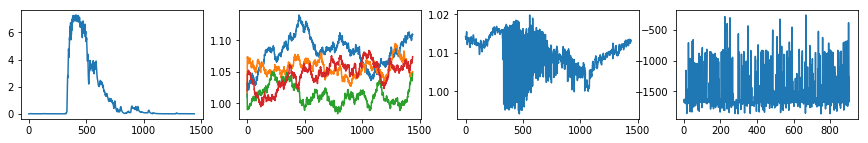

| Reward: -1124 | Episode: 906 | Qmax: -97.2829 | Action: [1.1160995  1.04814138 1.03677691 1.09611941]


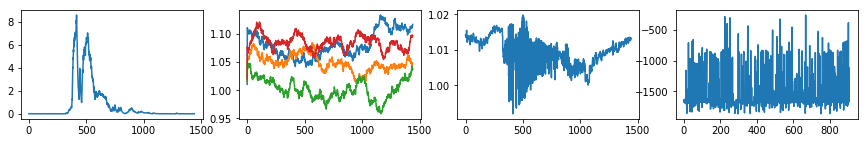

| Reward: -1440 | Episode: 907 | Qmax: -98.4362 | Action: [1.05520474 1.04235202 1.05218761 1.05282491]


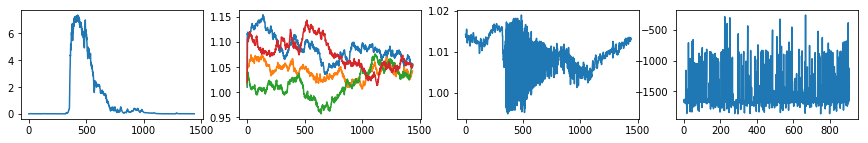

| Reward: -1559 | Episode: 908 | Qmax: -99.3554 | Action: [1.02990325 1.00412577 1.00856835 1.08302245]


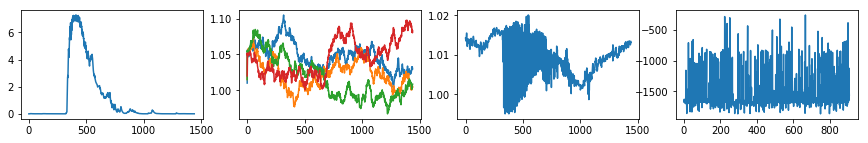

| Reward: -1672 | Episode: 909 | Qmax: -98.6337 | Action: [1.03752894 1.0089647  1.04476968 1.09757253]


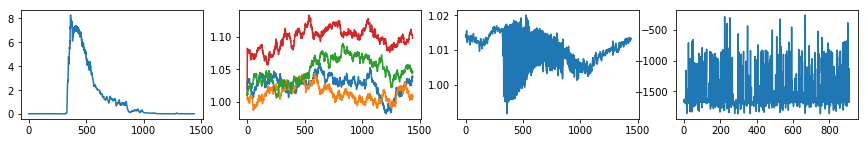

| Reward: -1669 | Episode: 910 | Qmax: -98.5772 | Action: [1.089308   1.0757649  1.02963364 1.04944627]


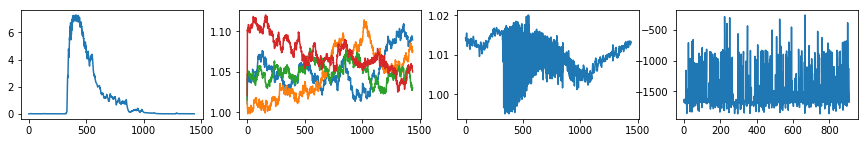

| Reward: -1669 | Episode: 911 | Qmax: -98.1610 | Action: [1.047856   0.99053981 1.0135961  1.04658029]


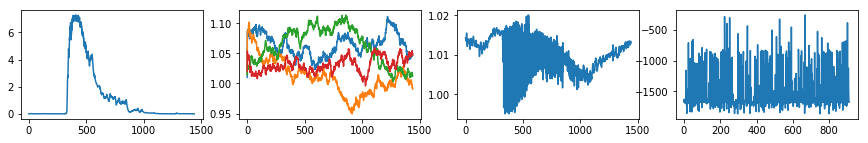

| Reward: -1605 | Episode: 912 | Qmax: -98.1657 | Action: [1.02027161 1.03087058 1.05542299 1.06252578]


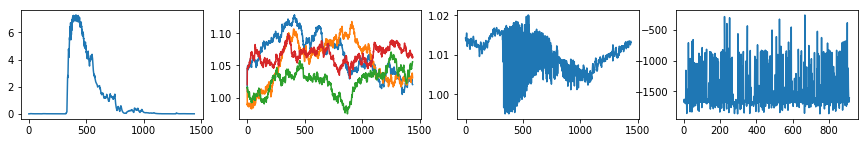

| Reward: -1446 | Episode: 913 | Qmax: -97.5888 | Action: [1.07586009 1.0732131  1.06286338 0.97979156]


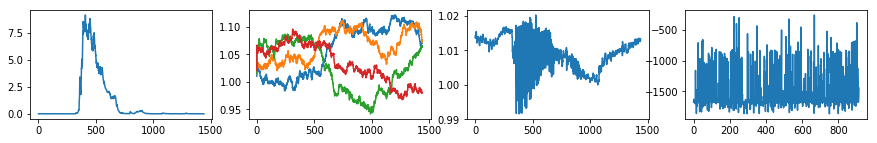

| Reward: -1799 | Episode: 914 | Qmax: -97.7224 | Action: [1.03462461 1.05861318 1.05559698 1.06816789]


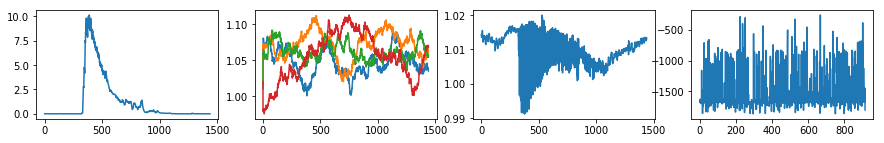

| Reward: -810 | Episode: 915 | Qmax: -98.4748 | Action: [1.00413601 0.94655066 1.0299455  1.07914419]


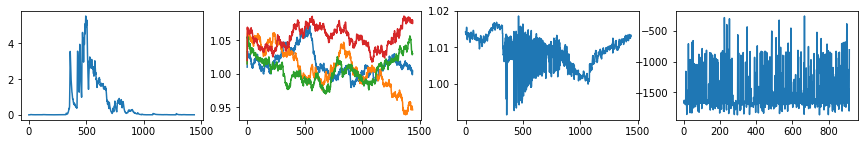

| Reward: -1609 | Episode: 916 | Qmax: -98.4489 | Action: [1.04876632 1.03478856 1.07696519 1.02906075]


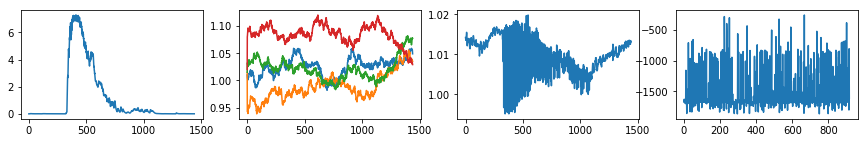

| Reward: -1669 | Episode: 917 | Qmax: -98.8757 | Action: [1.03317857 1.02922734 1.03861134 1.03619799]


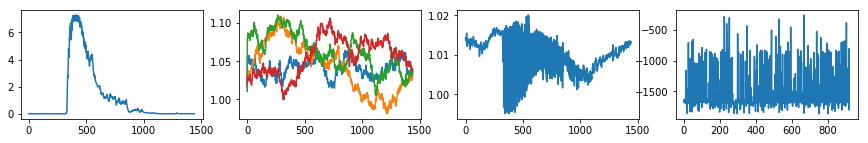

| Reward: -1444 | Episode: 918 | Qmax: -99.5380 | Action: [1.02432935 1.03932783 1.06415932 1.04557468]


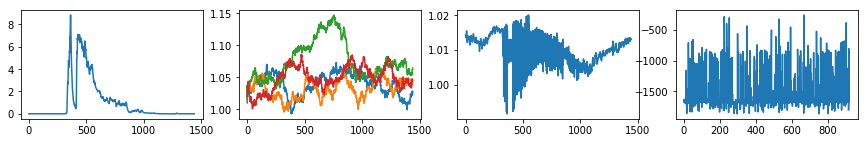

| Reward: -1661 | Episode: 919 | Qmax: -99.8909 | Action: [1.1050265  1.0403069  1.0699346  1.03647496]


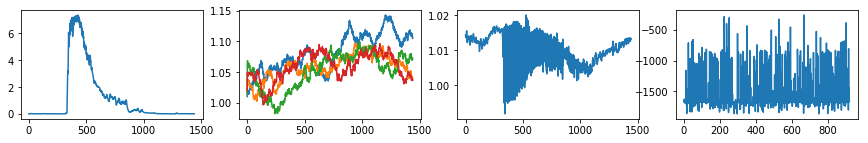

| Reward: -1669 | Episode: 920 | Qmax: -99.9293 | Action: [1.03280112 1.08532584 1.05442741 1.03618907]


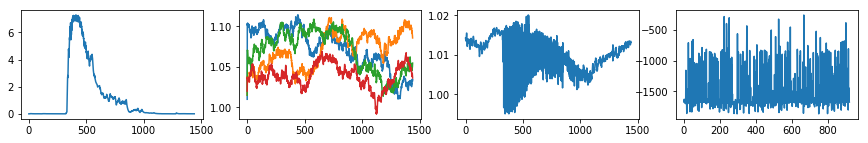

| Reward: -1669 | Episode: 921 | Qmax: -100.5649 | Action: [1.06969593 1.07326239 1.06277573 1.07430421]


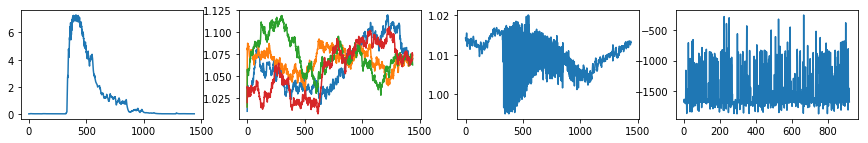

| Reward: -1669 | Episode: 922 | Qmax: -100.4688 | Action: [1.06340301 1.05229779 1.06168882 1.03177691]


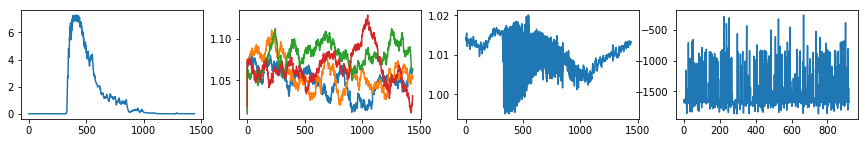

| Reward: -1705 | Episode: 923 | Qmax: -101.1585 | Action: [1.05485409 0.96606676 1.08090916 1.00247452]


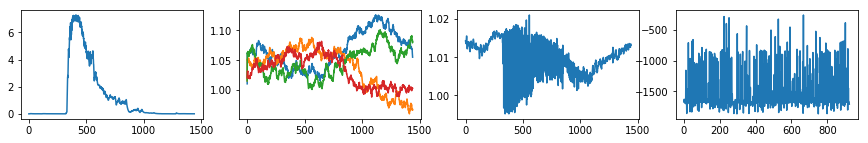

| Reward: -1564 | Episode: 924 | Qmax: -101.4283 | Action: [1.06203416 1.05629189 1.06688513 1.07603967]


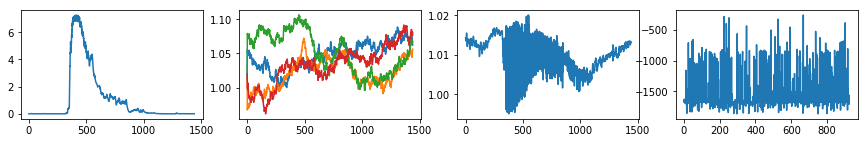

| Reward: -1671 | Episode: 925 | Qmax: -101.7472 | Action: [1.06405248 1.02077956 1.09076611 1.02830077]


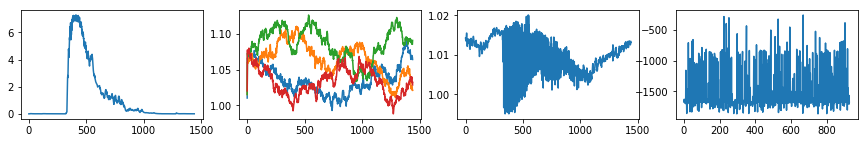

| Reward: -1550 | Episode: 926 | Qmax: -102.3389 | Action: [1.0893715  1.10395167 1.07372792 1.04530717]


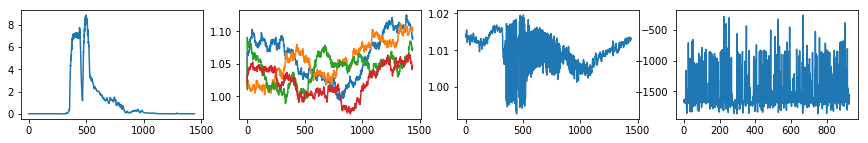

| Reward: -1720 | Episode: 927 | Qmax: -102.6352 | Action: [1.0418469  1.06897038 1.0004338  1.08536495]


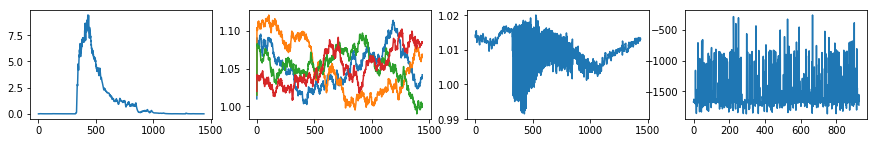

| Reward: -1073 | Episode: 928 | Qmax: -102.2744 | Action: [1.09238942 1.03376535 0.98467884 1.06505416]


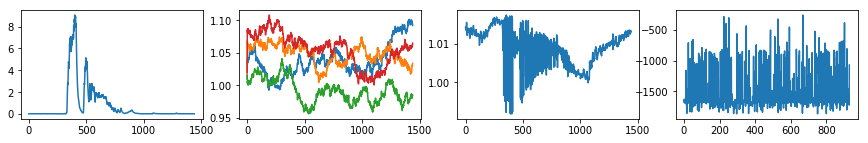

| Reward: -1730 | Episode: 929 | Qmax: -102.8287 | Action: [1.01058047 1.03744579 1.05240692 1.09783109]


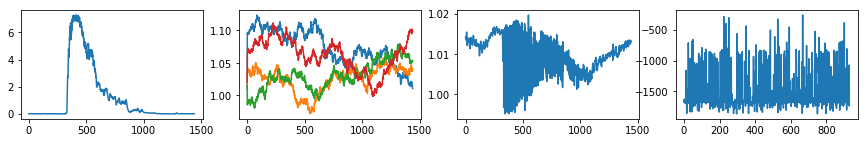

| Reward: -1673 | Episode: 930 | Qmax: -102.9923 | Action: [1.03743239 0.9917995  1.0090023  1.11534681]


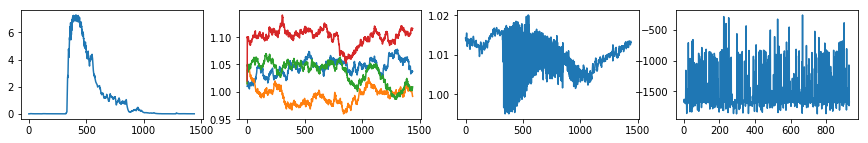

| Reward: -706 | Episode: 931 | Qmax: -101.7696 | Action: [0.99337107 1.03851718 1.02890445 1.07883361]


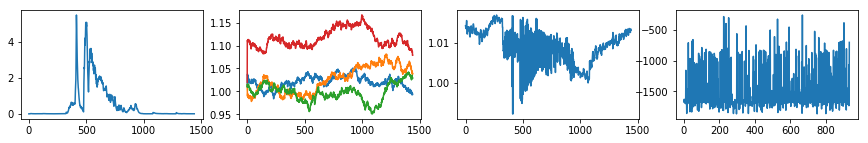

| Reward: -1504 | Episode: 932 | Qmax: -100.0786 | Action: [1.04072236 1.04633029 0.99172792 1.04535654]


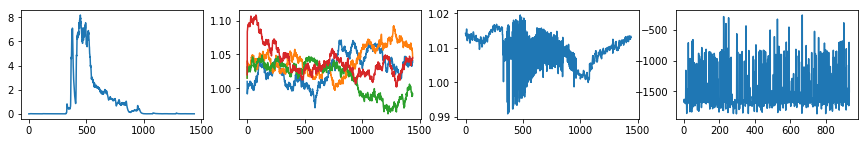

| Reward: -1133 | Episode: 933 | Qmax: -99.1002 | Action: [1.01518132 1.03094524 1.02991407 1.06430717]


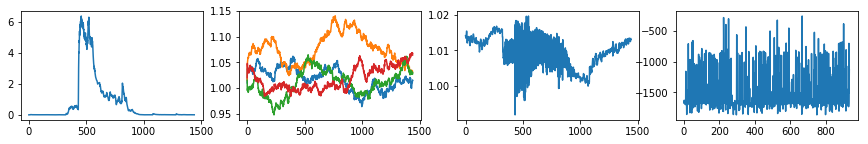

| Reward: -931 | Episode: 934 | Qmax: -98.9108 | Action: [1.01632684 1.06667742 0.96288427 1.00993061]


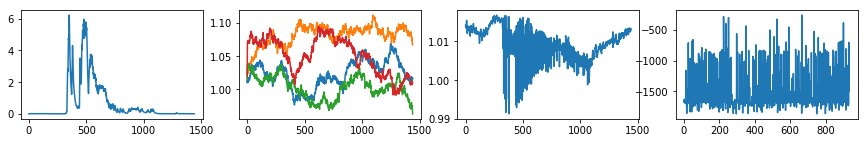

| Reward: -1699 | Episode: 935 | Qmax: -99.1489 | Action: [1.04978142 1.05604777 0.95740739 1.06040042]


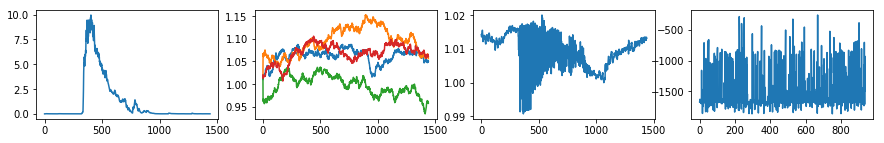

| Reward: -1739 | Episode: 936 | Qmax: -100.4718 | Action: [1.07362472 1.06210483 1.04233184 1.01041097]


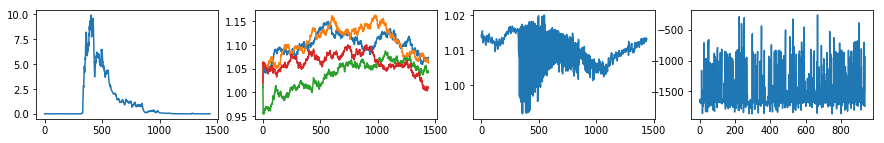

| Reward: -1669 | Episode: 937 | Qmax: -100.8481 | Action: [1.05258739 1.08812117 1.0359648  1.02465013]


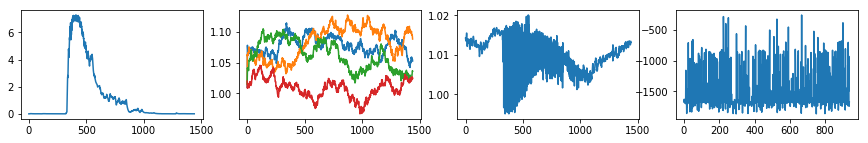

| Reward: -1493 | Episode: 938 | Qmax: -99.5754 | Action: [1.0316948  0.98965527 1.01116968 1.01316063]


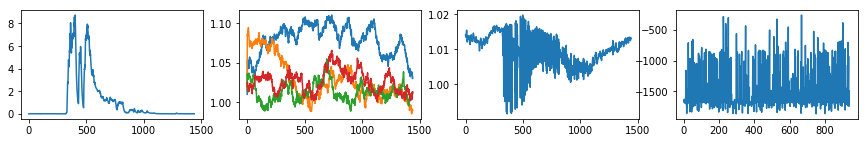

| Reward: -1728 | Episode: 939 | Qmax: -98.4855 | Action: [1.07587766 1.0496632  1.05924625 1.00582813]


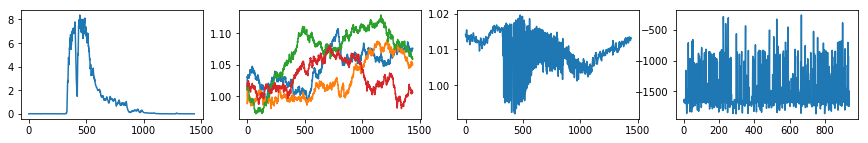

| Reward: -1768 | Episode: 940 | Qmax: -96.8090 | Action: [1.03644071 1.04010131 0.98101737 1.0427345 ]


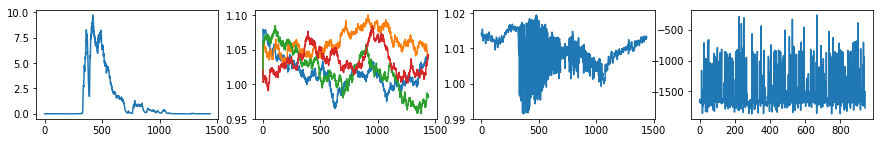

| Reward: -1689 | Episode: 941 | Qmax: -95.6511 | Action: [1.05198772 1.03971617 1.04077439 1.04295581]


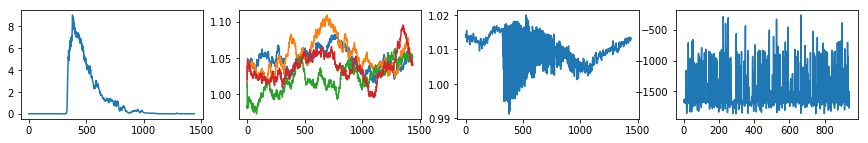

| Reward: -1635 | Episode: 942 | Qmax: -95.2867 | Action: [1.07847877 0.96354783 1.01088408 1.0437528 ]


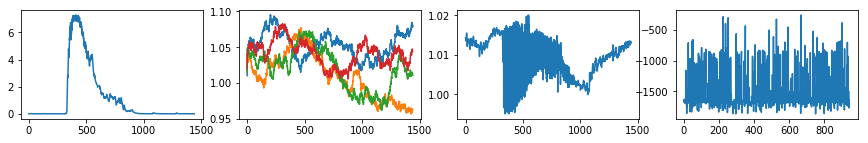

| Reward: -808 | Episode: 943 | Qmax: -96.0609 | Action: [1.06857686 1.00315844 1.07698471 1.04416539]


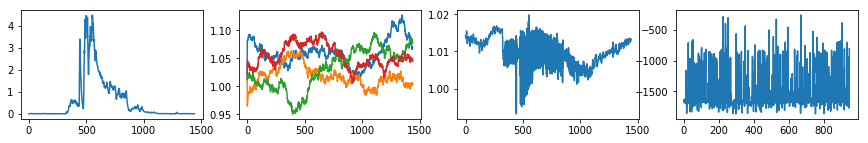

| Reward: -1095 | Episode: 944 | Qmax: -97.0054 | Action: [0.9978566  1.06737237 1.05026576 1.02655683]


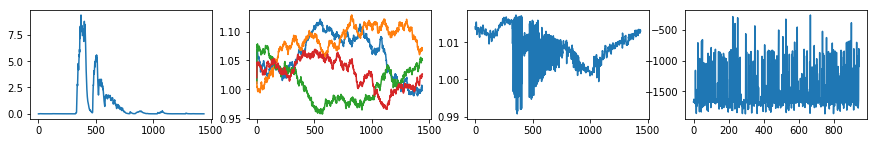

| Reward: -1461 | Episode: 945 | Qmax: -97.9033 | Action: [1.01061854 1.0764603  1.03919352 1.09199805]


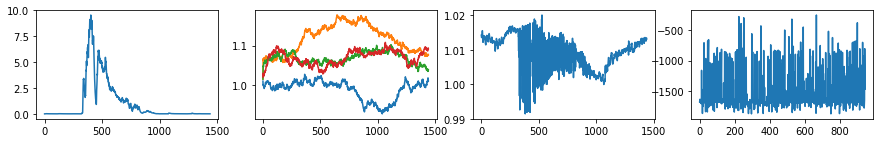

| Reward: -831 | Episode: 946 | Qmax: -98.6621 | Action: [1.05833976 1.05867577 0.99973618 1.11328858]


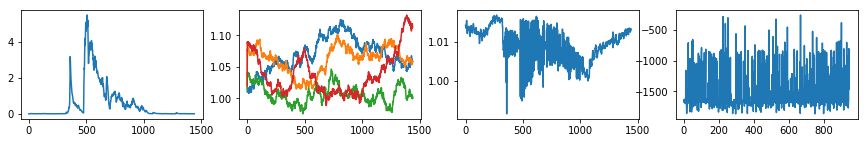

| Reward: -1612 | Episode: 947 | Qmax: -98.6364 | Action: [1.03182701 1.0091143  1.04093884 1.05186795]


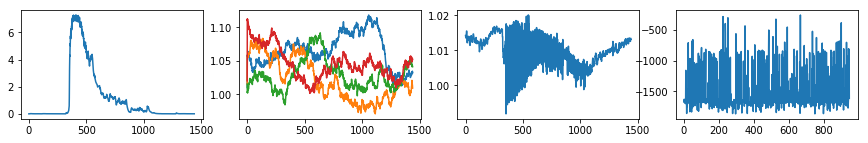

| Reward: -1669 | Episode: 948 | Qmax: -98.6833 | Action: [1.06690788 1.06611134 1.00438717 0.97446031]


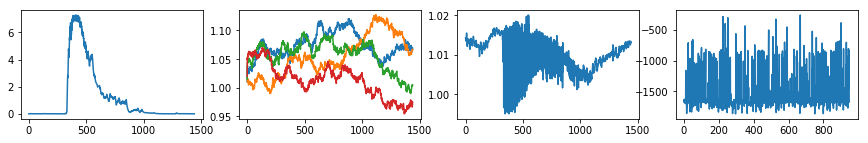

| Reward: -1610 | Episode: 949 | Qmax: -99.1196 | Action: [1.03891206 1.1395929  1.02016925 1.0590881 ]


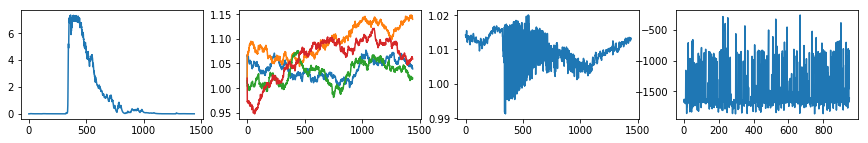

| Reward: -1634 | Episode: 950 | Qmax: -100.1851 | Action: [1.02730088 1.09255891 1.07673522 1.0347386 ]


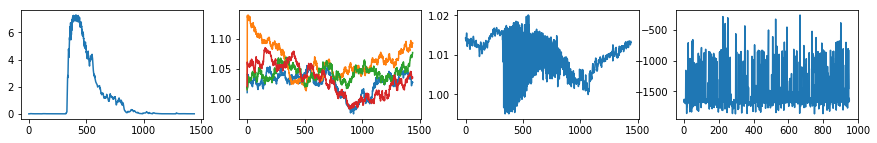

| Reward: -1310 | Episode: 951 | Qmax: -102.3560 | Action: [1.08627479 1.01914085 1.09322921 1.0007684 ]


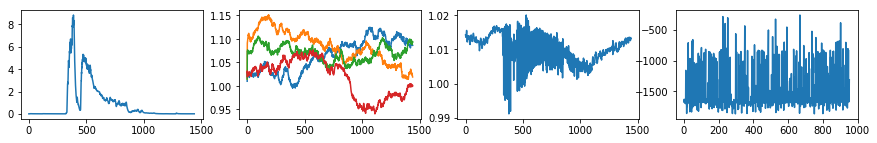

| Reward: -1669 | Episode: 952 | Qmax: -105.2298 | Action: [1.07507133 1.10371818 1.03135074 1.08056074]


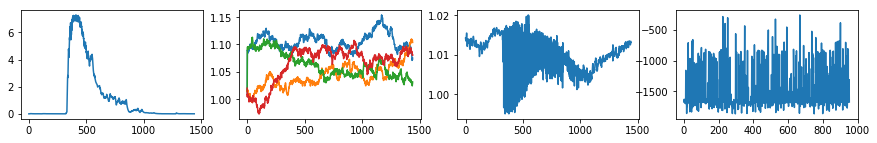

| Reward: -1669 | Episode: 953 | Qmax: -108.2859 | Action: [1.05256703 1.07795077 1.05681728 0.99194039]


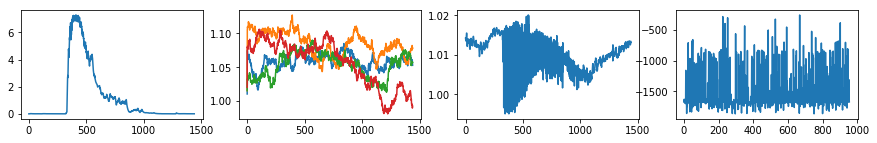

| Reward: -1904 | Episode: 954 | Qmax: -109.4588 | Action: [0.98907051 1.06462284 1.01342182 1.04269244]


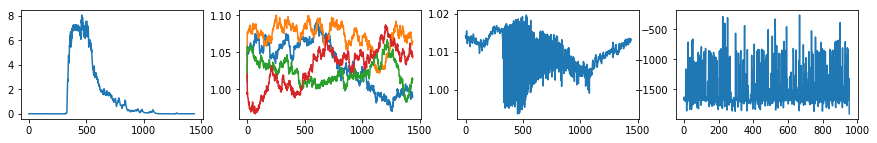

| Reward: -991 | Episode: 955 | Qmax: -109.7830 | Action: [0.96065558 1.09860928 1.00222979 1.01577264]


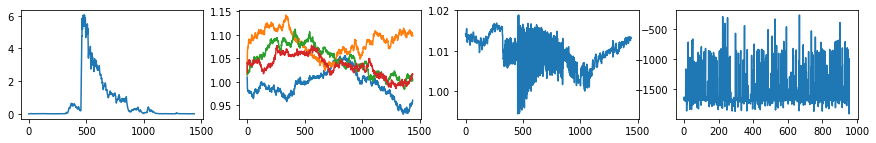

| Reward: -894 | Episode: 956 | Qmax: -109.2744 | Action: [1.08463035 1.12064449 1.0212582  1.04854786]


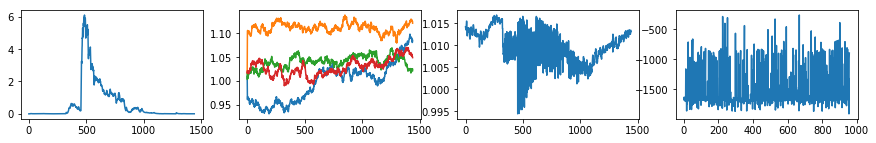

| Reward: -1679 | Episode: 957 | Qmax: -109.1493 | Action: [1.02073702 1.06054982 1.05524669 1.08257475]


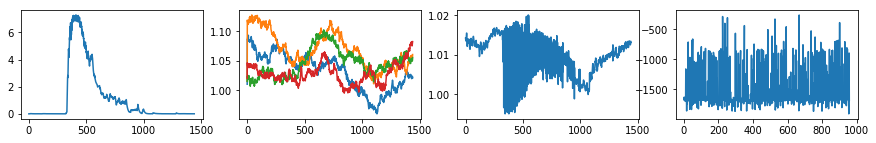

| Reward: -1776 | Episode: 958 | Qmax: -109.8940 | Action: [1.0690789  1.02444885 0.98461447 1.03833617]


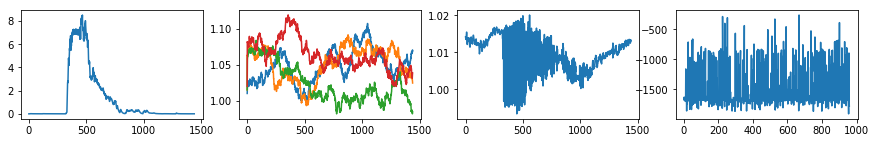

| Reward: -1693 | Episode: 959 | Qmax: -110.5959 | Action: [1.03131804 1.0546004  1.04399219 1.02391537]


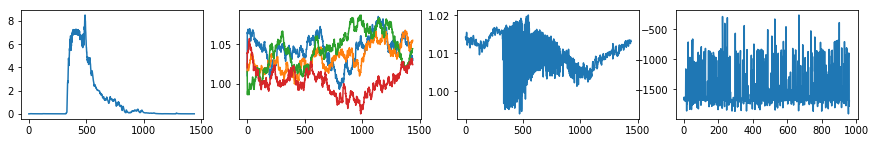

| Reward: -1647 | Episode: 960 | Qmax: -111.0330 | Action: [1.01305995 1.0486702  1.05141696 0.99720211]


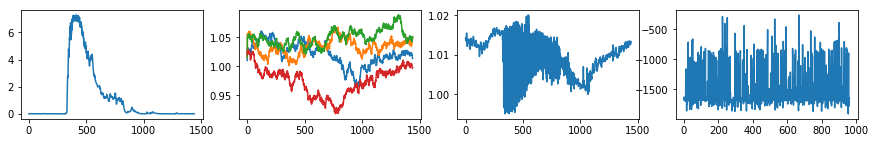

| Reward: -1594 | Episode: 961 | Qmax: -110.3580 | Action: [1.07036957 1.10274329 1.05501549 1.08637344]


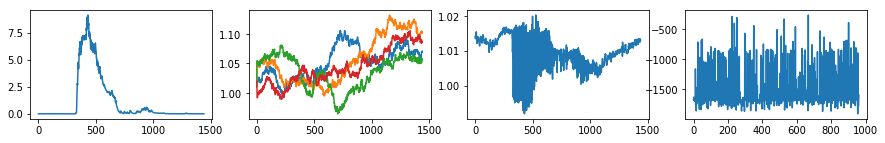

| Reward: -1673 | Episode: 962 | Qmax: -110.6637 | Action: [1.08181744 1.05591265 1.06398569 1.08074537]


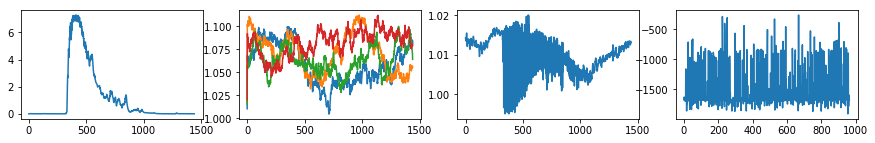

| Reward: -1687 | Episode: 963 | Qmax: -110.9814 | Action: [1.02948639 1.03166755 1.10152502 1.07863369]


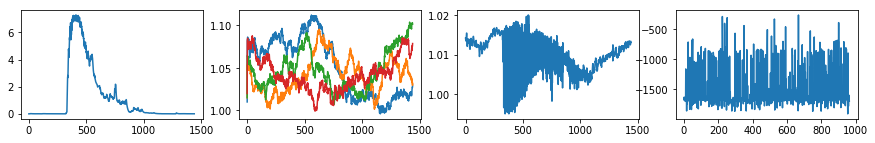

| Reward: -957 | Episode: 964 | Qmax: -110.8664 | Action: [1.00258763 1.0632627  1.05771223 1.06220897]


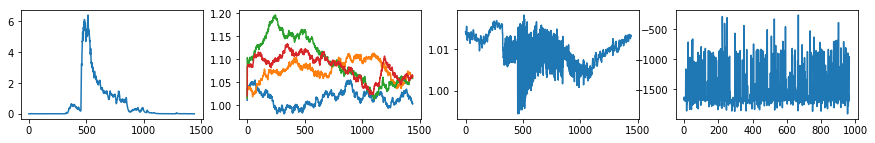

| Reward: -1673 | Episode: 965 | Qmax: -111.3285 | Action: [1.01044104 1.0615513  1.04587848 1.07421744]


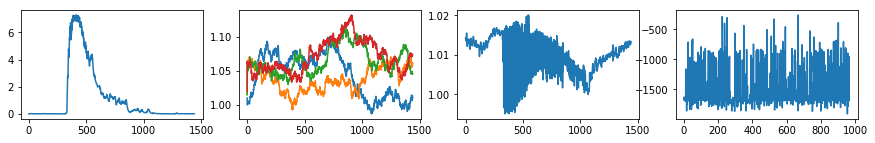

| Reward: -899 | Episode: 966 | Qmax: -111.7294 | Action: [1.04976412 1.04111183 1.10281077 1.0971683 ]


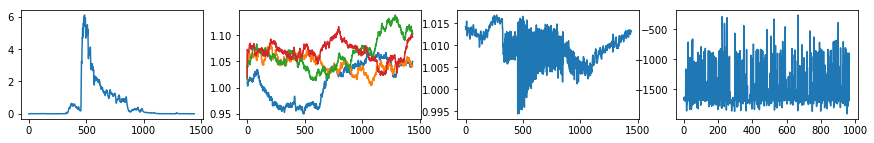

| Reward: -1669 | Episode: 967 | Qmax: -112.5388 | Action: [1.07893342 1.06173898 1.05947806 0.98772731]


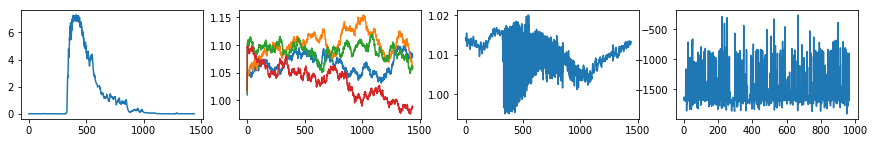

| Reward: -1674 | Episode: 968 | Qmax: -111.3628 | Action: [0.96887267 1.0543775  1.07211407 1.05322926]


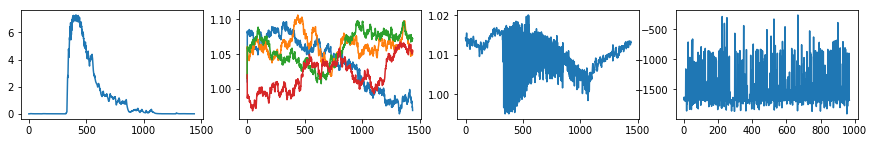

| Reward: -1669 | Episode: 969 | Qmax: -111.3922 | Action: [0.99826117 1.00825086 1.04169252 1.09128635]


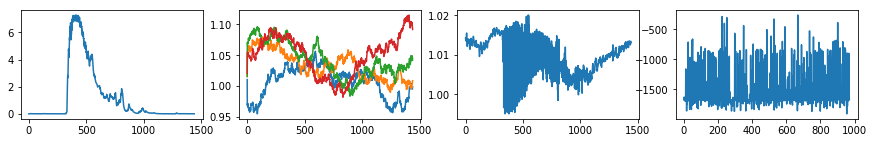

| Reward: -934 | Episode: 970 | Qmax: -113.6481 | Action: [1.03452133 1.0842251  1.07160023 1.02186757]


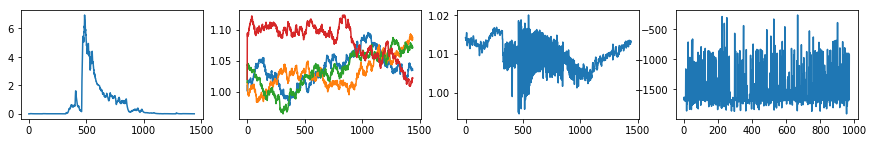

| Reward: -851 | Episode: 971 | Qmax: -115.4781 | Action: [1.10914601 1.06543637 1.09705836 1.10481227]


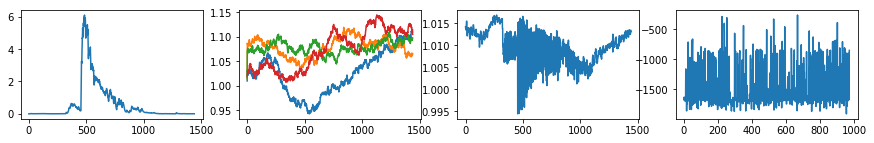

| Reward: -1669 | Episode: 972 | Qmax: -116.9493 | Action: [1.06481215 1.04566295 1.04508358 1.02697502]


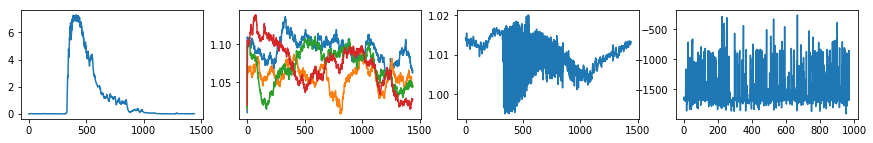

| Reward: -1465 | Episode: 973 | Qmax: -117.3186 | Action: [1.15192027 1.09939113 1.05847957 1.01774152]


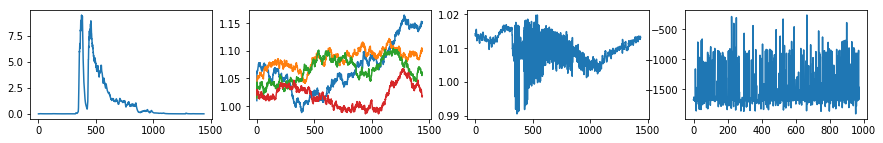

| Reward: -1669 | Episode: 974 | Qmax: -116.5863 | Action: [1.04045544 1.03494921 1.01572631 1.04998513]


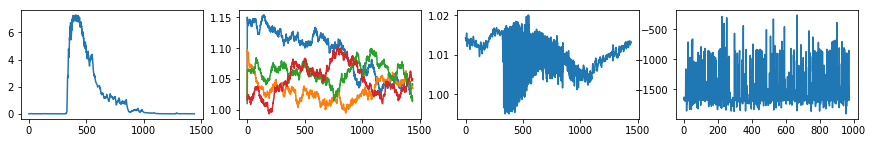

| Reward: -382 | Episode: 975 | Qmax: -114.9701 | Action: [1.06857994 1.03741158 1.04005242 1.07204224]


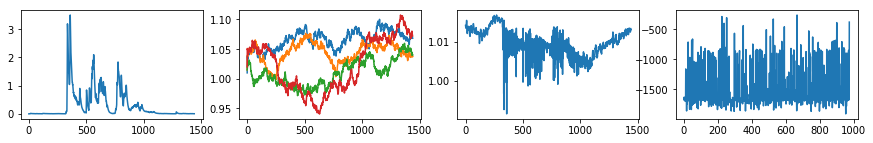

| Reward: -731 | Episode: 976 | Qmax: -115.2497 | Action: [1.05967287 1.06976401 0.99918136 1.03964752]


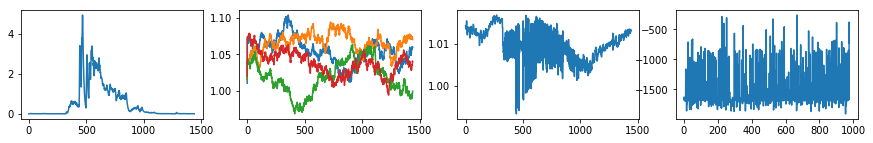

| Reward: -1604 | Episode: 977 | Qmax: -114.9095 | Action: [1.05200901 0.99253812 0.95868323 1.04545852]


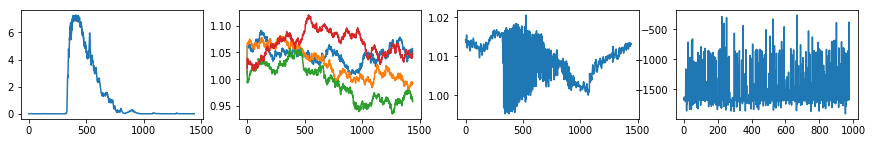

| Reward: -1685 | Episode: 978 | Qmax: -114.2212 | Action: [1.0556791  1.02540382 1.10645326 1.1017354 ]


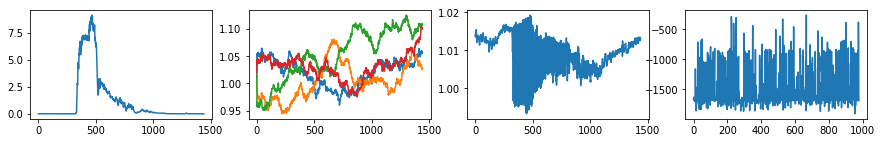

| Reward: -1663 | Episode: 979 | Qmax: -114.0707 | Action: [1.02311201 1.06445536 0.99930758 1.0183262 ]


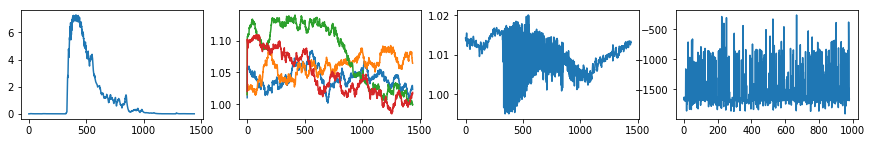

| Reward: -1743 | Episode: 980 | Qmax: -114.4284 | Action: [1.03533875 1.0323359  1.10413662 1.0757025 ]


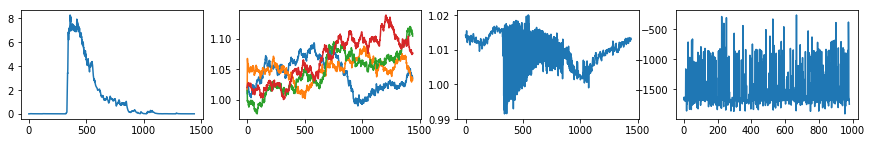

| Reward: -1669 | Episode: 981 | Qmax: -113.9444 | Action: [1.0169049  1.01484266 1.06531284 1.03553345]


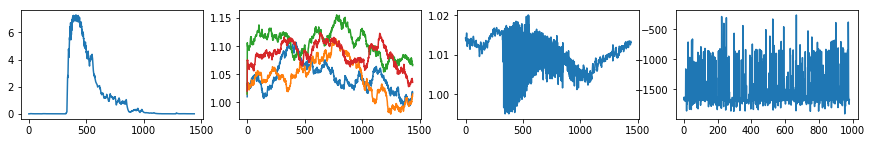

| Reward: -1669 | Episode: 982 | Qmax: -114.1463 | Action: [1.03116186 1.03567979 1.06021192 1.00143888]


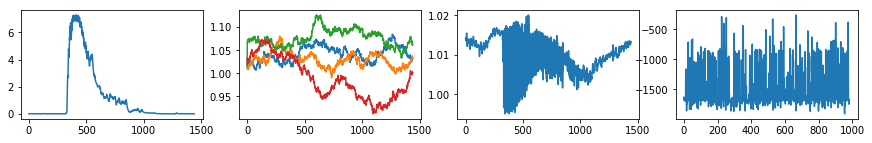

| Reward: -1669 | Episode: 983 | Qmax: -114.4677 | Action: [1.01499573 1.0588735  1.08119748 1.00788003]


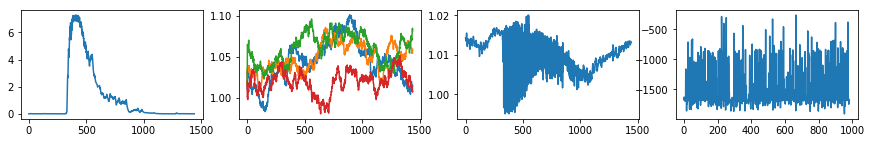

| Reward: -1721 | Episode: 984 | Qmax: -115.8329 | Action: [1.02082687 1.0407697  1.02352597 0.94999227]


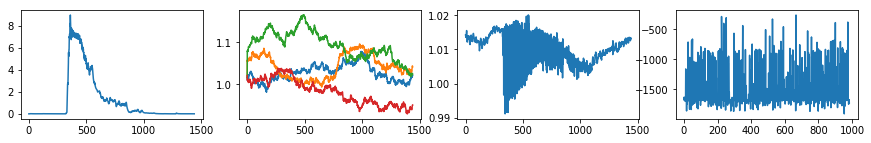

| Reward: -1669 | Episode: 985 | Qmax: -117.0662 | Action: [1.08003513 1.01288677 1.09256632 1.08796677]


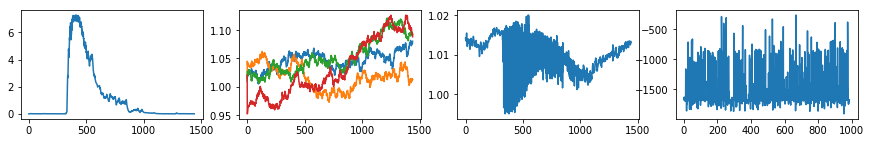

| Reward: -1669 | Episode: 986 | Qmax: -117.7782 | Action: [1.08166546 1.0812681  1.10328705 1.07799043]


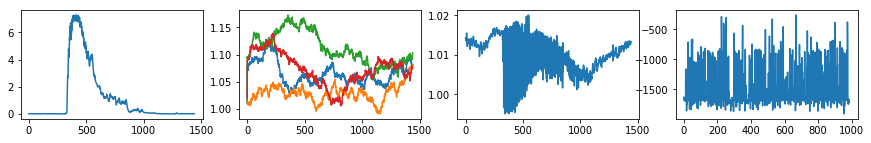

| Reward: -1623 | Episode: 987 | Qmax: -117.8629 | Action: [1.0759802  0.98486804 1.11351008 1.07521363]


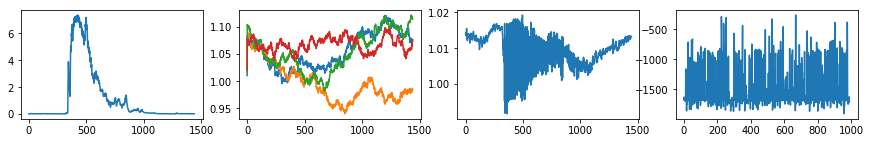

| Reward: -1669 | Episode: 988 | Qmax: -118.4314 | Action: [1.082047   0.9997736  1.07569657 0.99950597]


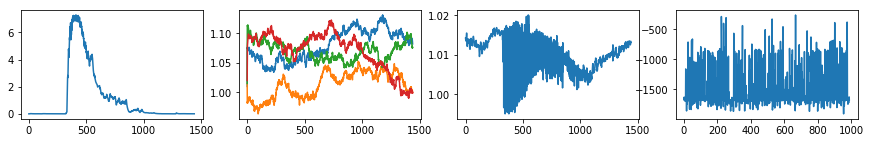

| Reward: -1669 | Episode: 989 | Qmax: -118.9627 | Action: [1.02930519 1.10638714 1.03794382 1.09563879]


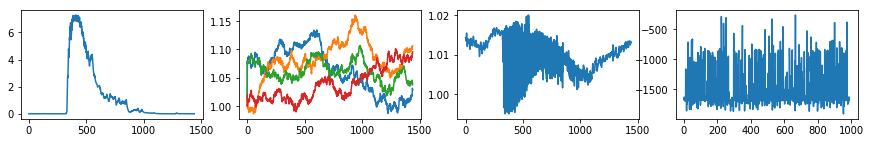

| Reward: -1669 | Episode: 990 | Qmax: -118.0683 | Action: [1.01205733 1.09316617 0.96202653 1.1041347 ]


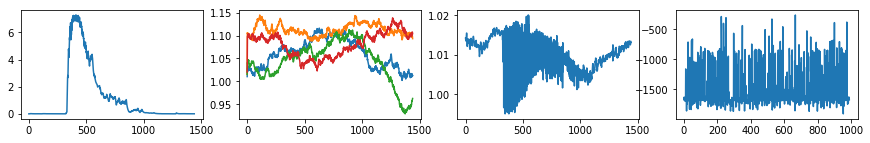

| Reward: -630 | Episode: 991 | Qmax: -116.6450 | Action: [1.01521013 1.06205196 0.98533252 1.05430993]


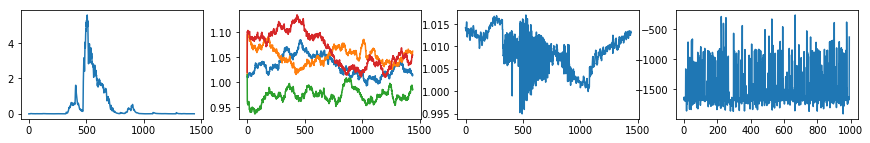

| Reward: -1096 | Episode: 992 | Qmax: -115.2957 | Action: [0.96858333 1.07190396 1.07453019 1.09440229]


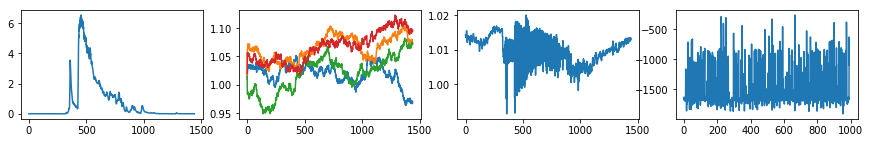

| Reward: -1681 | Episode: 993 | Qmax: -116.1976 | Action: [1.06926004 1.02922223 1.00309199 1.09252673]


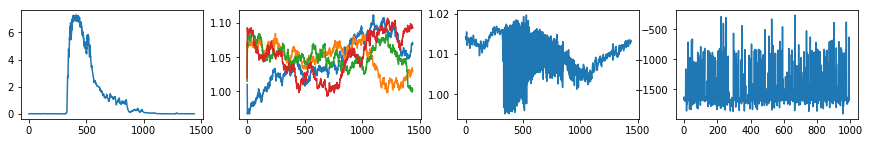

| Reward: -767 | Episode: 994 | Qmax: -117.1758 | Action: [0.99801429 1.07005303 1.02999287 1.02577985]


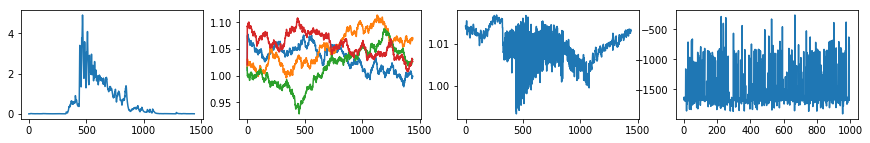

| Reward: -1703 | Episode: 995 | Qmax: -117.2120 | Action: [1.07158811 1.00015316 1.09595382 1.10438852]


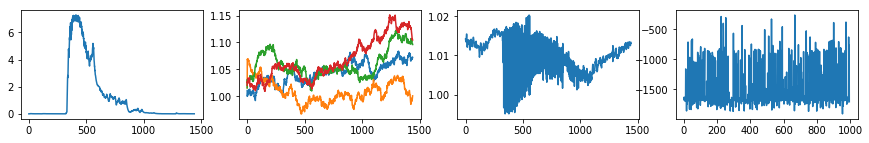

| Reward: -1669 | Episode: 996 | Qmax: -117.8092 | Action: [1.05664331 1.0390571  1.04614311 1.07493857]


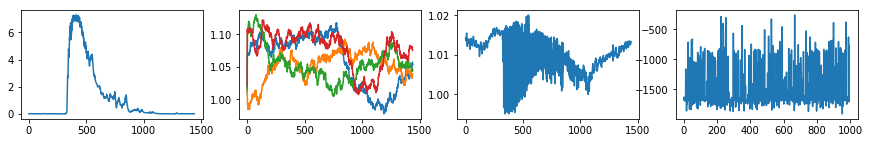

| Reward: -1669 | Episode: 997 | Qmax: -118.3079 | Action: [1.0603947  1.01634299 1.07476447 1.08024127]


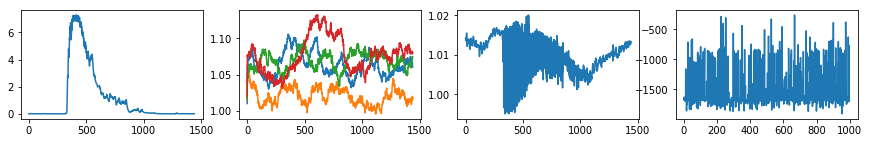

| Reward: -1669 | Episode: 998 | Qmax: -118.0384 | Action: [1.07693547 1.03681515 1.06782392 1.12520543]


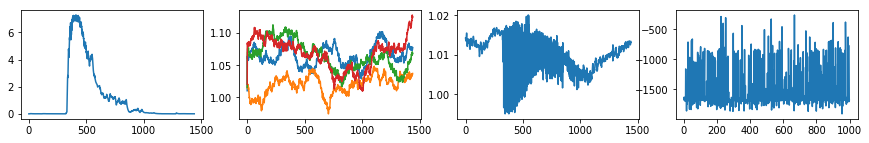

| Reward: -1669 | Episode: 999 | Qmax: -117.6736 | Action: [0.97281253 1.03109192 1.0622291  1.05618757]


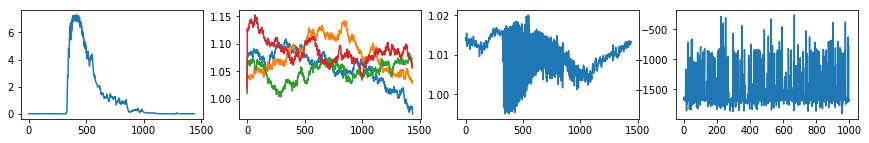

| Reward: -1848 | Episode: 1000 | Qmax: -117.6838 | Action: [1.03836644 1.03156417 1.02959762 1.02605575]


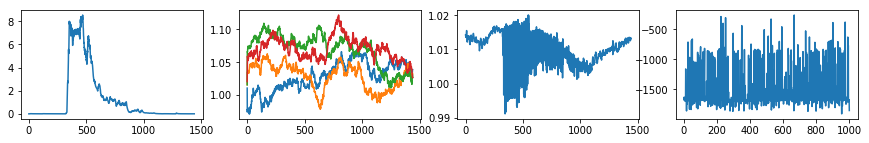

| Reward: -1669 | Episode: 1001 | Qmax: -118.1650 | Action: [1.09390723 1.05561323 1.03762119 1.03940405]


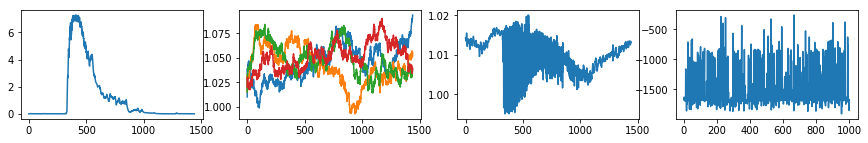

| Reward: -1669 | Episode: 1002 | Qmax: -118.7075 | Action: [1.10597608 1.06566103 1.06028846 1.02265105]


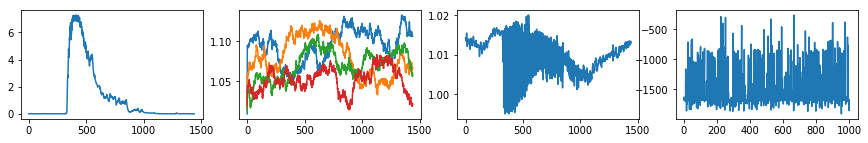

| Reward: -1814 | Episode: 1003 | Qmax: -118.6380 | Action: [1.05974244 1.08058647 1.03064061 1.03467315]


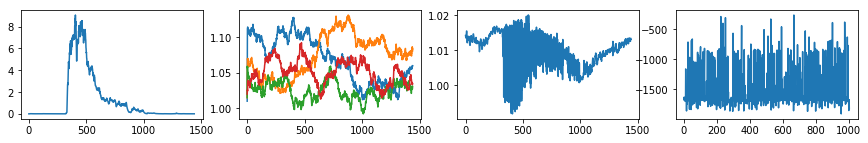

| Reward: -1877 | Episode: 1004 | Qmax: -118.4423 | Action: [1.0861445  1.10929165 1.0209966  1.00288298]


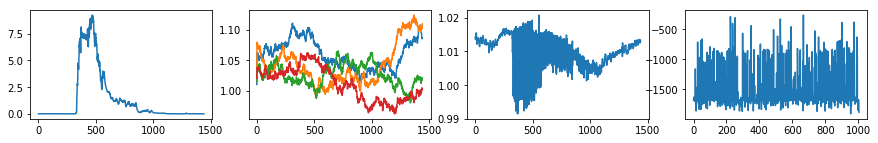

| Reward: -1666 | Episode: 1005 | Qmax: -116.7169 | Action: [0.9654824  1.02804033 0.98738658 1.05056761]


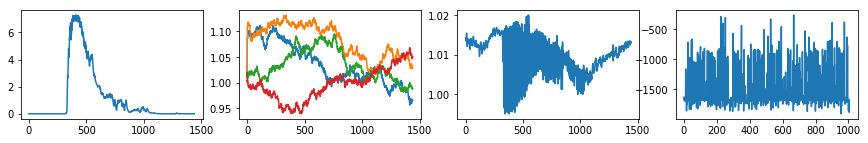

| Reward: -872 | Episode: 1006 | Qmax: -115.9503 | Action: [1.09247588 1.05715456 1.02592173 1.08285742]


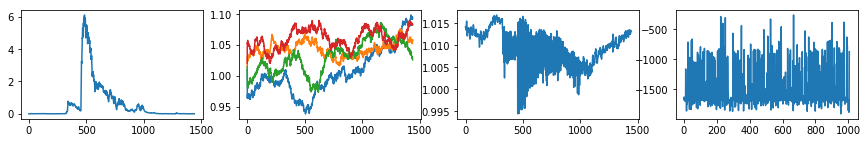

| Reward: -1669 | Episode: 1007 | Qmax: -116.3905 | Action: [1.11602926 1.057826   1.08921192 1.1268431 ]


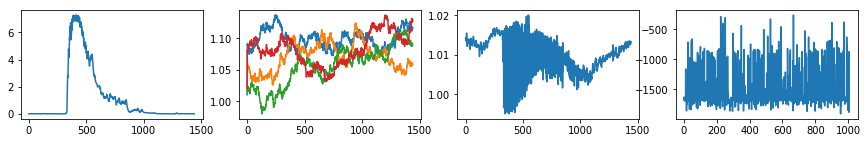

| Reward: -1669 | Episode: 1008 | Qmax: -115.4235 | Action: [1.07459071 1.04762152 1.06123008 1.01159358]


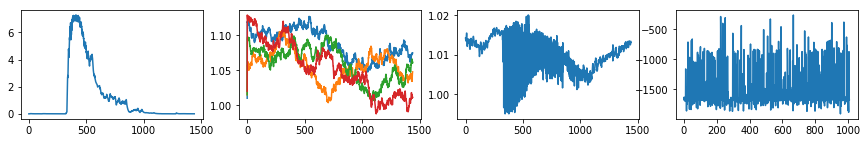

| Reward: -1669 | Episode: 1009 | Qmax: -114.4954 | Action: [1.0423812  1.06268695 1.05999102 1.08028608]


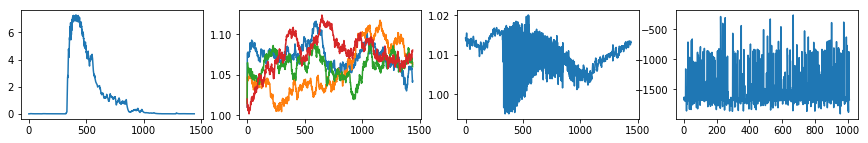

| Reward: -1669 | Episode: 1010 | Qmax: -113.5162 | Action: [1.08405693 1.04144281 1.03405697 1.01690655]


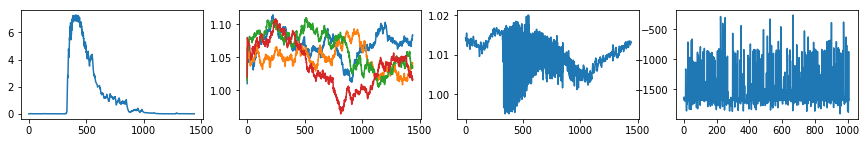

| Reward: -1669 | Episode: 1011 | Qmax: -111.5428 | Action: [1.04590865 1.03828337 1.07215738 1.02666087]


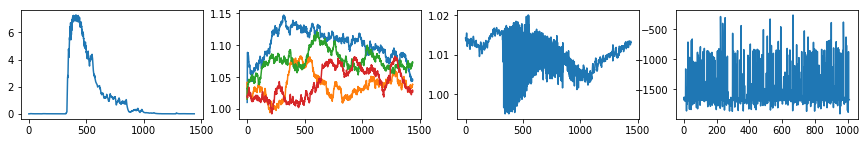

KeyboardInterrupt: 

In [16]:
import tensorflow as tf
import tflearn
import copy
args = {}
args['actor_lr'] = 0.001
args['critic_lr'] = 0.01
args['gamma'] = 0.99
args['tau'] = 0.001
args['buffer_size'] = 5000
args['minibatch_size'] = 200
args['random_seed'] = 1234
args['max_episodes'] = 10000
args['max_episode_len'] = TotalTimeSteps
args['summary_dir'] = os.getcwd()
args['random_seed'] = 1234
#in this chapter, we only want to control 1 agent, other agents have a constant VBP
#agent 
agent = 2
#init action 
allAction = copy.deepcopy(VBP[:,:,0]) #need to run simulation
main(args)

for ksim in range(TotalTimeSteps):
    ############################################################
    ###############calculate new simulation#####################
    ############################################################
    #CALCULATE NET ZIP LOADS
    for node_iter in range(NumberOfLoads):
        knode = LoadList[node_iter]
        if ksim == 0:
            PowerEachTimeStep_vqvp[knode,:] = np.array([ZIP_demand[ksim,knode,0] - SolarGeneration_vqvp[ksim,knode],
                                                        ZIP_demand[ksim,knode,1],
                                                        ZIP_demand[ksim,knode,2]])
        else:
            PowerEachTimeStep_vqvp[knode,:] = np.array([ZIP_demand[ksim,knode,0] + InverterRealPower[ksim-1,knode]
                                                         + 1j*InverterReactivePower[ksim-1,knode], 
                                                        ZIP_demand[ksim,knode,1], 
                                                        ZIP_demand[ksim,knode,2]])
    #RUN FORWARD-BACKWARD SWEEP
    V_vqvp[:,ksim],S_vqvp[:,ksim] = FBSfun(V0[ksim,0],PowerEachTimeStep_vqvp,Z,FeederMap)
    
    #RUN INVERTER FUNCTION TO OUTPUT P/Q
    if (0 < ksim < TotalTimeSteps-1):
        for node_iter in range(NumberOfLoads):
            knode = LoadList[node_iter]
            InverterReactivePower[ksim,knode],InverterRealPower[ksim,knode],FilteredVoltage[ksim,knode],FilteredVoltageCalc[ksim,knode],_, _ = inverter_VoltVarVoltWatt_model(
                FilteredVoltage[ksim-1,knode], SolarGeneration_vqvp[ksim,knode], 
                abs(V_vqvp[knode,ksim]), abs(V_vqvp[knode,ksim-1]), 
                VBP[knode,:,ksim], TimeStep, InverterLPF, 
                Sbar[knode], InverterRealPower[ksim-1,knode], 
                InverterReactivePower[ksim-1,knode], InverterRateOfChangeLimit, 
                InverterRateOfChangeActivate, ksim, Delay_VoltageSampling[knode])
    
    #RUN OBSERVER FUNCTION
    for node_iter in range(NumberOfLoads):
        knode = LoadList[node_iter]
        if (ksim > 0):
            FilteredOutput_vqvp[ksim,knode],IntermediateOutput_vqvp[ksim,knode],Epsilon_vqvp[ksim,knode] = voltage_observer(V_vqvp[knode,ksim], V_vqvp[knode,ksim-1], 
                                                        IntermediateOutput_vqvp[ksim-1,knode], Epsilon_vqvp[ksim-1,knode], 
                                                        FilteredOutput_vqvp[ksim-1,knode], HighPassFilterFrequency, 
                                                        LowPassFilterFrequency, Gain_Energy, TimeStep)        
        